In [1]:
import sys 
sys.path.append("/mnt/shared/users/wessim.omezzine/hip-analysis")
from hip.analysis.aoi import AnalysisArea
from hip.analysis.data._datasources import DATASOURCE_CONFIGS
import os
import dask
from dask.distributed import Client, progress
import rioxarray as rxr
import glob
import tqdm
import numpy as np
import matplotlib.pyplot as plt
import netCDF4 as nc
import datetime

import numpy as np
import matplotlib.pyplot as plt
import torch

import pandas as pd
import rasterio

import warnings
warnings.filterwarnings("ignore")

import s3fs
import xarray as xr
import dask
# Create a dask client to distribute (speed up) the coputation

# if dashboard.link set to default value and running behind hub, make dashboard link go via proxy
if dask.config.get("distributed.dashboard.link") == '{scheme}://{host}:{port}/status':
    jup_prefix = os.environ.get('JUPYTERHUB_SERVICE_PREFIX')
    if jup_prefix is not None:
        jup_prefix = jup_prefix.rstrip('/')
        dask.config.set({"distributed.dashboard.link": f"{jup_prefix}/proxy/{{port}}/status"})

client = Client()
client

GDAL_DATA                    = /envs/user/fix_hdc/share/gdal
GDAL_DISABLE_READDIR_ON_OPEN = EMPTY_DIR
GDAL_HTTP_MAX_RETRY          = 10
GDAL_HTTP_RETRY_DELAY        = 0.5
AWS_ACCESS_KEY_ID            = xx..xx
AWS_SECRET_ACCESS_KEY        = xx..xx
AWS_SESSION_TOKEN            = xx..xx


INFO:distributed.http.proxy:To route to workers diagnostics web server please install jupyter-server-proxy: python -m pip install jupyter-server-proxy
INFO:distributed.scheduler:State start
INFO:distributed.scheduler:  Scheduler at:     tcp://127.0.0.1:36989
INFO:distributed.scheduler:  dashboard at:  /user/wessim.omezzine/proxy/8787/status
INFO:distributed.nanny:        Start Nanny at: 'tcp://127.0.0.1:44897'
INFO:distributed.nanny:        Start Nanny at: 'tcp://127.0.0.1:39009'
INFO:distributed.nanny:        Start Nanny at: 'tcp://127.0.0.1:37845'
INFO:distributed.nanny:        Start Nanny at: 'tcp://127.0.0.1:42105'
INFO:distributed.scheduler:Register worker <WorkerState 'tcp://127.0.0.1:36183', name: 1, status: init, memory: 0, processing: 0>
INFO:distributed.scheduler:Starting worker compute stream, tcp://127.0.0.1:36183
INFO:distributed.core:Starting established connection to tcp://127.0.0.1:46078
INFO:distributed.scheduler:Register worker <WorkerState 'tcp://127.0.0.1:33349', na

Connection method: Cluster object,Cluster type: distributed.LocalCluster
Dashboard: /user/wessim.omezzine/proxy/8787/status,
Dashboard: /user/wessim.omezzine/proxy/8787/status,Workers: 4
Total threads: 4,Total memory: 15.20 GiB
Status: running,Using processes: True
Comm: tcp://127.0.0.1:36989,Workers: 4
Dashboard: /user/wessim.omezzine/proxy/8787/status,Total threads: 4
Started: Just now,Total memory: 15.20 GiB
Comm: tcp://127.0.0.1:33349,Total threads: 1
Dashboard: /user/wessim.omezzine/proxy/40379/status,Memory: 3.80 GiB
Nanny: tcp://127.0.0.1:44897,


# Jordan

In [2]:
region="Jordan"

## Import RFH CHIRPS

In [10]:
bbox = (35.595703,29.983487,41.693115,33.916013) 
area = AnalysisArea(
    bbox=bbox,
    datetime_range="1983-01-01/2023-06-30"  # change the starting date 1983  
)
ndvi_5 = area.get_dataset(["MODIS","NDVI_smoothed_5KM"])
ndvi_1 = area.get_dataset(["MODIS","mxd13a2_vim_dekad"])
ndvi_1 = ndvi_1 .rename({'y': 'latitude', 'x': 'longitude'})

In [11]:
ndvi_5 = ndvi_5.load()
ndvi_1 = ndvi_1.load()

INFO:distributed.utils_perf:full garbage collection released 2.10 GiB from 392 reference cycles (threshold: 9.54 MiB)


In [15]:
ndvi_5_near = ndvi_5.rio.reproject(ndvi_5.rio.crs, resolution=(-0.01,0.01), resampling=rasterio.enums.Resampling.nearest).rename({'y': 'latitude', 'x': 'longitude'})

In [16]:
ndvi_resample = ndvi_1.rio.reproject(ndvi_5.rio.crs, resolution=(-0.01,0.01), resampling=rasterio.enums.Resampling.nearest).rename({'y': 'latitude', 'x': 'longitude'})

In [17]:
ndvi_resample

<xarray.DataArray 'band' (time: 756, latitude: 394, longitude: 943)>
array([[[    nan,     nan,     nan, ..., -0.0248,  0.0794,     nan],
        [    nan,     nan,     nan, ..., -0.1252,  0.0318,     nan],
        [    nan,     nan,     nan, ...,  0.0169,     nan,     nan],
        ...,
        [    nan,  0.1022,  0.0905, ...,     nan,     nan,     nan],
        [    nan,     nan,     nan, ...,     nan,     nan,     nan],
        [    nan,     nan,     nan, ...,     nan,     nan,     nan]],

       [[    nan,     nan,     nan, ..., -0.0124,  0.0813,     nan],
        [    nan,     nan,     nan, ..., -0.1223,  0.0316,     nan],
        [    nan,     nan,     nan, ...,  0.0174,     nan,     nan],
        ...,
        [    nan,  0.1026,  0.0911, ...,     nan,     nan,     nan],
        [    nan,     nan,     nan, ...,     nan,     nan,     nan],
        [    nan,     nan,     nan, ...,     nan,     nan,     nan]],

       [[    nan,     nan,     nan, ...,  0.0029,  0.0838,     nan],
        [    nan,     nan,     nan, ..., -0.1185,  0.0318,     nan],
        [    nan,     nan,     nan, ...,  0.0184,     nan,     nan],
        ...,
...
        ...,
        [    nan,  0.1268,  0.1071, ...,     nan,     nan,     nan],
        [    nan,     nan,     nan, ...,     nan,     nan,     nan],
        [    nan,     nan,     nan, ...,     nan,     nan,     nan]],

       [[    nan,     nan,     nan, ...,  0.1035,  0.1453,     nan],
        [    nan,     nan,     nan, ...,  0.0105,  0.1123,     nan],
        [    nan,     nan,     nan, ...,  0.058 ,     nan,     nan],
        ...,
        [    nan,  0.1268,  0.1072, ...,     nan,     nan,     nan],
        [    nan,     nan,     nan, ...,     nan,     nan,     nan],
        [    nan,     nan,     nan, ...,     nan,     nan,     nan]],

       [[    nan,     nan,     nan, ...,  0.1051,  0.1427,     nan],
        [    nan,     nan,     nan, ...,  0.0237,  0.1094,     nan],
        [    nan,     nan,     nan, ...,  0.058 ,     nan,     nan],
        ...,
        [    nan,  0.1254,  0.107 , ...,     nan,     nan,     nan],
        [    nan,     nan,     nan, ...,     nan,     nan,     nan],
        [    nan,     nan,     nan, ...,     nan,     nan,     nan]]])
Coordinates:
  * longitude    (longitude) float64 34.1 34.11 34.12 34.13 ... 43.5 43.51 43.52
  * latitude     (latitude) float64 33.91 33.9 33.89 33.88 ... 30.0 29.99 29.98
  * time         (time) datetime64[ns] 2002-07-01 2002-07-11 ... 2023-06-21
    spatial_ref  int64 0
Attributes:
    _FillValue:  nan

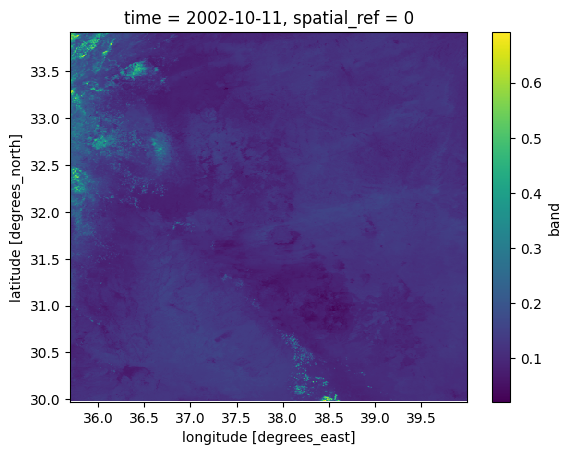

In [38]:
ndvi_resample.sel(longitude = slice(35.7,40)).isel(time = 10).plot.imshow()

In [39]:
ndvi_1_resample = ndvi_resample.sel(longitude = slice(35.7,40))
ndvi_5_near_resample =ndvi_5_near.sel(latitude = ndvi_1_resample.latitude.values[10:-10], longitude= ndvi_1_resample.longitude.values[10:-10], method = "nearest")


latitude_size, longitude_size = 32,32

ndvi_1 = ndvi_1_resample.isel(latitude=slice(0,latitude_size), longitude=slice(0,longitude_size))
ndvi_5_near  = ndvi_5_near_resample.isel(latitude=slice(0,latitude_size), longitude=slice(0,longitude_size))
# da_monthly_sum_season_near.to_netcdf(f'Data/Downscaling/Rainfall/Jordan/data/da_monthly_sum_season_near_01.nc')

In [42]:
ndvi_1.to_netcdf(f'Data/Downscaling/NDVI/{region}/data/ndvi_1.nc')
ndvi_5_near.to_netcdf(f'Data/Downscaling/NDVI/{region}/data/ndvi_5_near.nc')

## LTA

In [43]:
ndvi_1 = xr.open_dataset(f'Data/Downscaling/NDVI/{region}/data/ndvi_1.nc')
ndvi_5= xr.open_dataset(f'Data/Downscaling/NDVI/{region}/data/ndvi_5_near.nc')
# forecast_near = forecast_near.update(forecast_near*1e4) ## CHANGE!!!

In [44]:
ndvi_lta = ndvi_1.sel(time=slice("1983-02-28","2018-05-31"))
ndvi_lta  = ndvi_lta .groupby(ndvi_lta.time.dt.strftime("%m-%d")).mean()
ndvi_lta = ndvi_lta.sel(strftime=ndvi_1.time.dt.strftime("%m-%d"))

In [50]:
ndvi_lta.to_netcdf(f'Data/Downscaling/NDVI/{region}/data/ndvi_lta.nc')

In [47]:
ndvi_lta.sel(time = datetime.datetime(2020,2,21))

<xarray.Dataset>
Dimensions:      (longitude: 32, latitude: 32)
Coordinates:
  * longitude    (longitude) float64 35.7 35.71 35.72 35.73 ... 35.99 36.0 36.01
  * latitude     (latitude) float64 33.91 33.9 33.89 33.88 ... 33.62 33.61 33.6
    strftime     <U5 '02-21'
    time         datetime64[ns] 2020-02-21
Data variables:
    spatial_ref  float64 0.0
    band         (latitude, longitude) float64 0.4222 0.386 ... 0.2973 0.2852

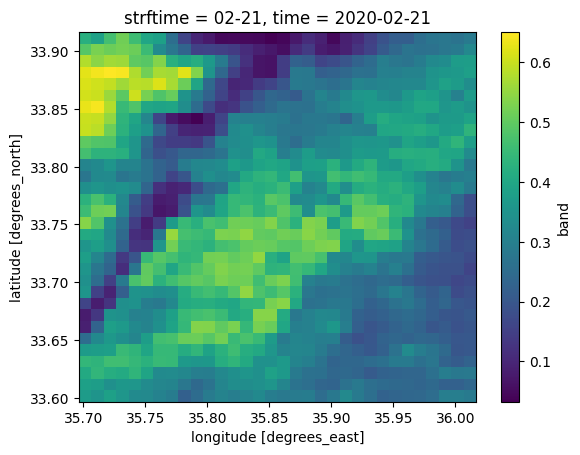

In [48]:
data = ndvi_lta.sel(time = datetime.datetime(2020,2,21))
data.band.plot.imshow()

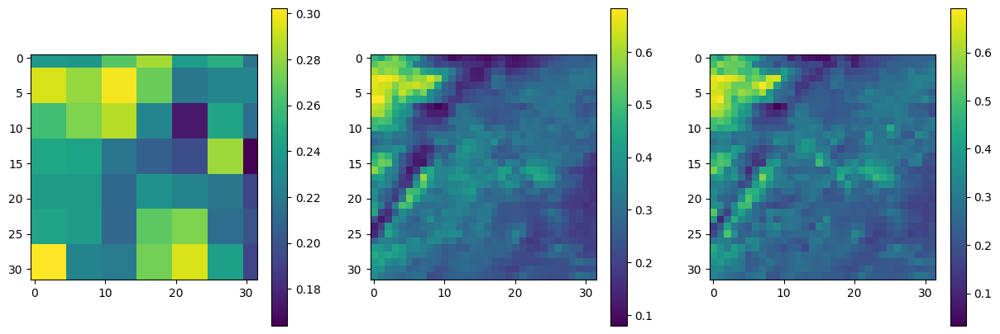

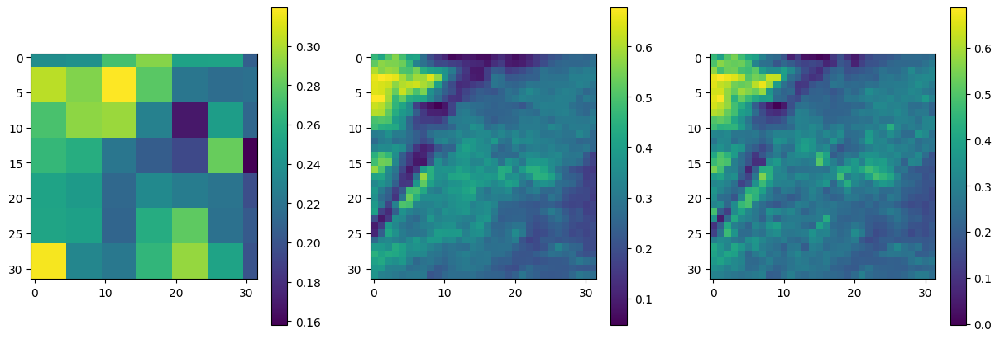

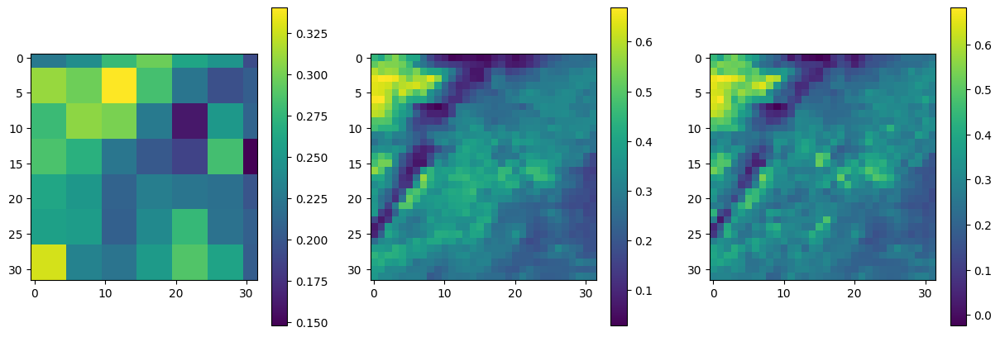

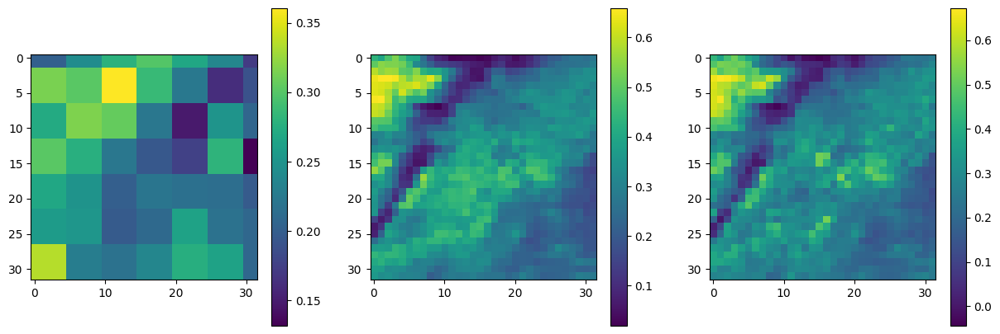

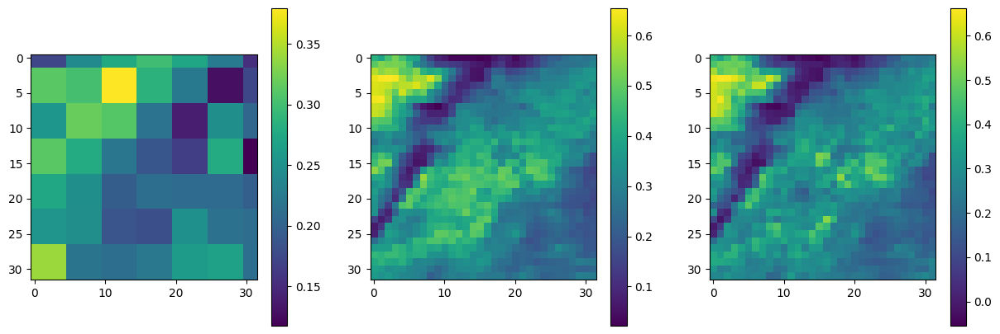

...

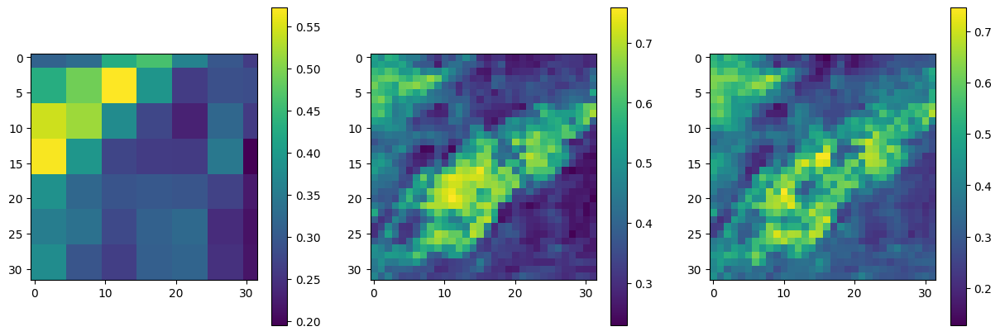

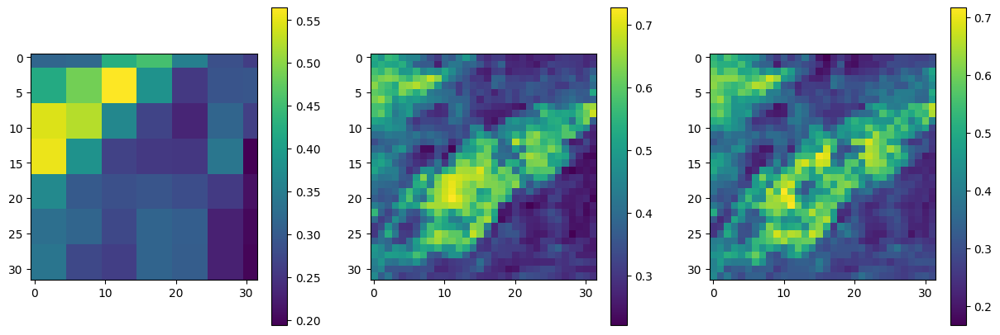

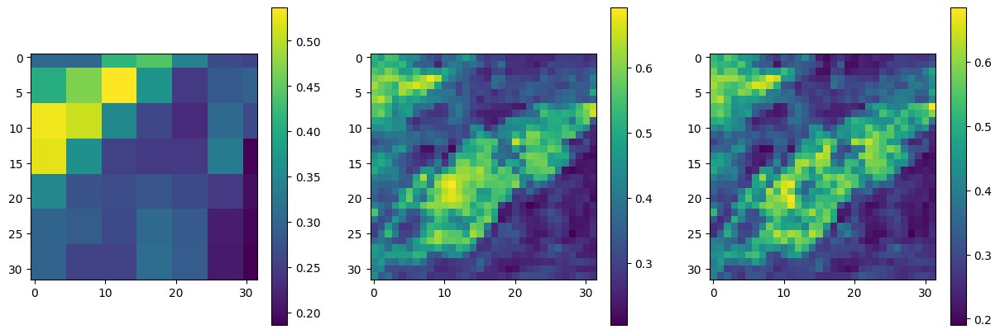

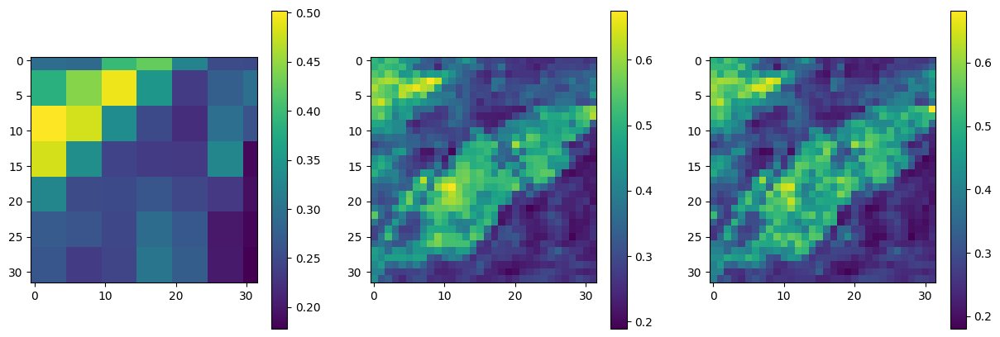

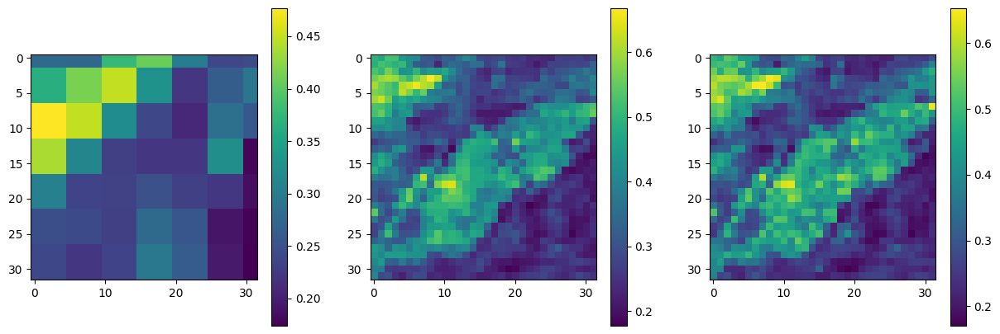

IndexError: index 18 is out of bounds for axis 0 with size 18

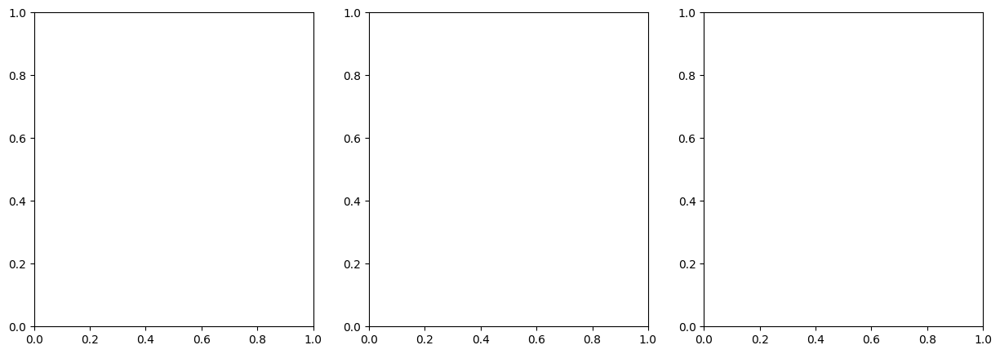

In [63]:
file_path = 'Data/Downscaling/NDVI/Jordan/data_npz/train/2003_00_inp.npz'
file_path_out = 'Data/Downscaling/NDVI/Jordan/data_npz/train/2003_00_out.npz'

# Load the NPZ file
data = np.load(file_path)
data_out = np.load(file_path_out)

# Access the individual arrays stored in the NPZ file
# For example, if the file contains arrays named 'array1' and 'array2':
for index in range(36):
    
    fig, axes = plt.subplots(1, 3, figsize=(15, 5))
    im1 = axes[0].imshow(data['ndvi_5'][index][0])

    im2 = axes[1].imshow(data['ndvi_lta'][index][0])

    im3 = axes[2].imshow(data_out['ndvi_1'][index][0])
    

    fig.colorbar(im1)
    fig.colorbar(im2)
    fig.colorbar(im3)

    plt.show()


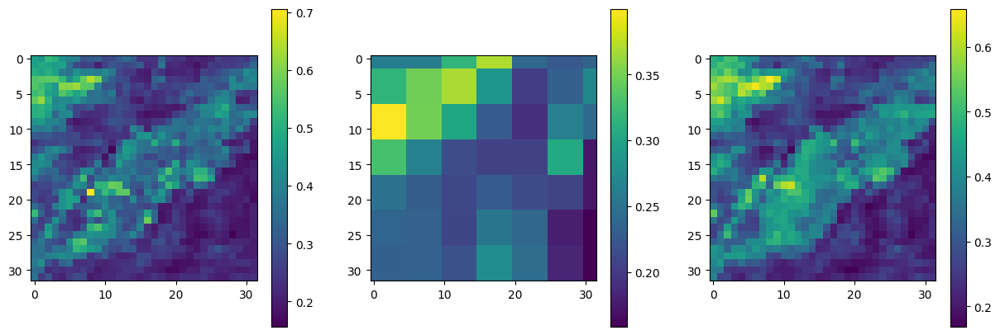

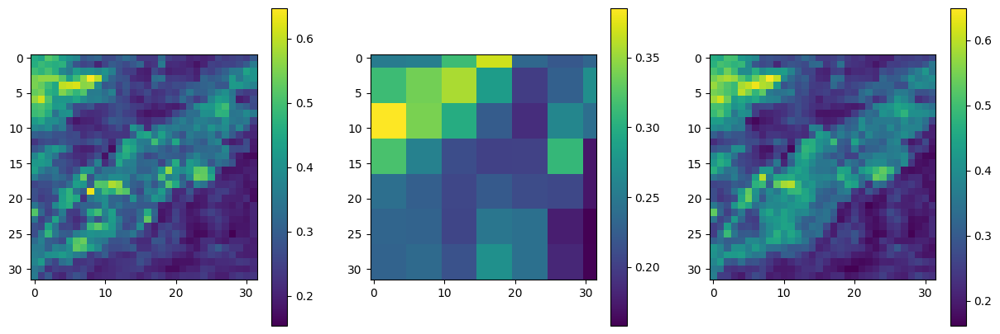

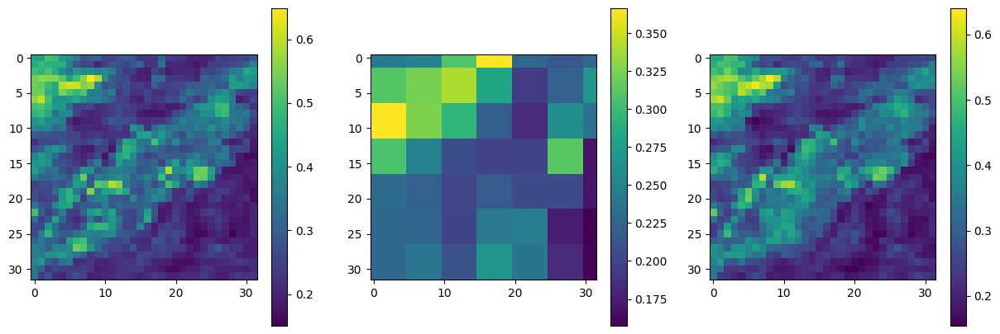

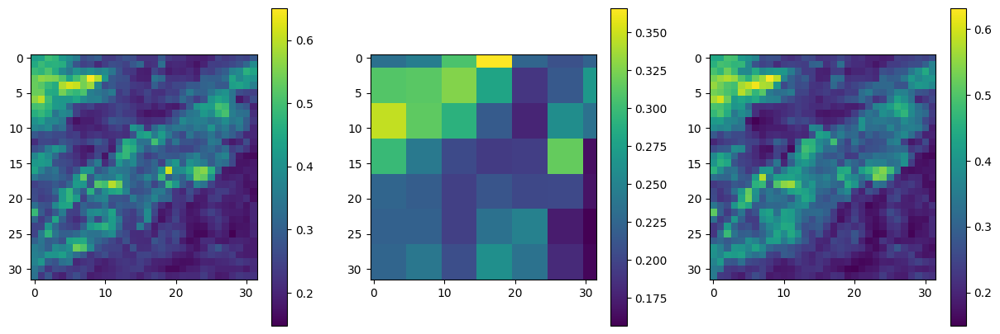

In [49]:
for index in range(4):
    fig, axes = plt.subplots(1, 3, figsize=(15, 5))
    im1 = axes[0].imshow(ndvi_1['band'][index])

    im2 = axes[1].imshow(ndvi_5['band'][index])

    im3 = axes[2].imshow(ndvi_lta['band'][index])
    

    fig.colorbar(im1)
    fig.colorbar(im2)
    fig.colorbar(im3)

    plt.show()


# Mozambique

In [104]:
region="Mozambique"

## Import RFH CHIRPS

In [107]:
bbox = (29.201660,-23.905927,39.309082,-15.072124) #Sudan
area = AnalysisArea(
    bbox=bbox,
    datetime_range="1983-01-01/2023-06-30"  # change the starting date 1983  
)
rfh = area.get_dataset(["CHIRPS","rfh_dekad"])


In [108]:
rfh = rfh.load()

### Extract Seasonality

In [109]:
start_season =2
end_season =5

### Agregation over every month

In [110]:
rfh_resample = rfh.resample(time='M').sum()

## Import ECMWF Prediction

In [111]:
path_issue = f's3://wfp-seasmon/zarr/seasonal-forecasts/0{start_season}/01'

with dask.config.set(**{'array.slicing.split_large_chunks': False}):
    ds_issue = xr.open_mfdataset(f'{path_issue}/*.zarr', chunks={"latitude":36, "longitude":70, "ensemble":-1}, engine='zarr')
ds_issue = ds_issue.sel(latitude = slice(bbox[3], bbox[1]),longitude = slice(bbox[0], bbox[2])) 

In [112]:
da_issue = ds_issue.tp.load()

In [113]:
da_issue = da_issue.mean("ensemble") #Output 1 ensemble
da_issue = da_issue.diff(dim='time', n=1).fillna(0)  # Non cumulative

In [114]:
da_issue.longitude

<xarray.DataArray 'longitude' (longitude: 10)>
array([29.5, 30.5, 31.5, 32.5, 33.5, 34.5, 35.5, 36.5, 37.5, 38.5])
Coordinates:
  * longitude    (longitude) float64 29.5 30.5 31.5 32.5 ... 35.5 36.5 37.5 38.5
    spatial_ref  int32 4326

In [115]:
# path_issue = f's3://wfp-seasmon/zarr/seasonal-forecasts/{mm}/01'

# with dask.config.set(**{'array.slicing.split_large_chunks': False}):
#     ds_issue = xr.open_mfdataset(f'{path_issue}/*.zarr', chunks={"latitude":36, "longitude":36, "ensemble":-1}, engine='zarr')
    
# ds_issue = ds_issue.sel(latitude = slice(bbox[3], bbox[1]),longitude = slice(bbox[0], bbox[2])) 
# da_issue = ds_issue.tp.load()
# da_issue = da_issue.mean("ensemble")


da_monthly_sum = da_issue.resample(time='M').sum()
da_monthly_sum_season  = da_monthly_sum.sel(time=(da_monthly_sum['time.month'] >= start_season) & (da_monthly_sum['time.month'] <= end_season), drop=True) 
da_monthly_sum_season_near = da_monthly_sum_season.rio.reproject(rfh_resample.rio.crs, 
                                                             resolution=(-0.05,0.05), 
                                                             resampling=rasterio.enums.Resampling.nearest)

da_monthly_sum_season_near = da_monthly_sum_season_near.rename({'y': 'latitude', 'x': 'longitude'})
da_monthly_sum_season_near = da_monthly_sum_season_near 

rfh_resample = rfh_resample.sel(latitude = slice(29.5, 38.5), longitude = slice(-23.5, -14.5))
da_monthly_sum_season_near_resample =da_monthly_sum_season_near.sel(latitude = rfh_resample.latitude.values, longitude= rfh_resample.longitude.values, method = "nearest")


latitude_size, longitude_size = 32,32

rfh = rfh_resample.isel(latitude=slice(0,latitude_size), longitude=slice(0,longitude_size))
da_monthly_sum_season_near  = da_monthly_sum_season_near_resample.isel(latitude=slice(0,latitude_size), longitude=slice(0,longitude_size))
# da_monthly_sum_season_near.to_netcdf(f'Data/Downscaling/Rainfall/Jordan/data/da_monthly_sum_season_near_01.nc')

In [116]:
scale_rate = 10

rfh = rfh.sel(time=(rfh['time.month'] >= start_season) & (rfh['time.month'] <= end_season), drop=True) 
scaling_factors = rfh.max() / da_monthly_sum_season_near.max()

forecast = da_monthly_sum_season_near*scaling_factors['band'].values

ValueError: numpy.nanmax raises on a.size==0 and axis=None; So Bottleneck too.

In [ ]:
forecast.to_netcdf(f'Data/Downscaling/Rainfall/{region}/data/forecast.nc')
rfh.to_netcdf(f'Data/Downscaling/Rainfall/{region}/data/rfh_monthly.nc')

## LTA

In [ ]:
forecast_near = xr.open_dataset(f'Data/Downscaling/Rainfall/{region}/data/forecast.nc')
# forecast_near = forecast_near.update(forecast_near*1e4) ## CHANGE!!!
rfh = xr.open_dataset(f'Data/Downscaling/Rainfall/{region}/data/rfh_monthly.nc')

In [ ]:
rfh_lta = rfh.sel(time=slice("1983-02-28","2018-05-31"))
rfh_lta  = rfh_lta .groupby(rfh_lta.time.dt.strftime("%m-%d")).mean()
rfh_lta = rfh_lta.sel(strftime=rfh.time.dt.strftime("%m-%d"))

In [ ]:
rfh_lta.to_netcdf(f'Data/Downscaling/Rainfall/{region}/data/rfh_lta.nc')

In [ ]:
xr.open_dataset(f'Data/Downscaling/Rainfall/{region}/data/forecast.nc')

In [ ]:
forecast_near

In [ ]:
for index in range(4):
    fig, axes = plt.subplots(1, 4, figsize=(15, 5))
    im1 = axes[0].imshow(rfh['band'][index])

    im2 = axes[1].imshow(forecast_near['tp'][index])

    im3 = axes[2].imshow(rfh_lta['band'][index])
    
    im4 = axes[3].imshow(scaled_forecast_near['tp'][index])

    fig.colorbar(im1)
    fig.colorbar(im2)
    fig.colorbar(im3)
    fig.colorbar(im4)

    plt.show()


# Niger

In [99]:
region="Niger"

## Import RFH CHIRPS

In [ ]:
bbox = (5.031738,14.157882,13.491211,20.488773) #Sudan
area = AnalysisArea(
    bbox=bbox,
    datetime_range="1983-01-01/2023-06-30"  # change the starting date 1983  
)
rfh = area.get_dataset(["CHIRPS","rfh_dekad"])


In [ ]:
rfh = rfh.load()

### Extract Seasonality

In [ ]:
start_season =2
end_season =5

### Agregation over every month

In [ ]:
rfh_resample = rfh.resample(time='M').sum()

## Import ECMWF Prediction

In [ ]:
path_issue = f's3://wfp-seasmon/zarr/seasonal-forecasts/0{start_season}/01'

with dask.config.set(**{'array.slicing.split_large_chunks': False}):
    ds_issue = xr.open_mfdataset(f'{path_issue}/*.zarr', chunks={"latitude":36, "longitude":70, "ensemble":-1}, engine='zarr')
ds_issue = ds_issue.sel(latitude = slice(bbox[3], bbox[1]),longitude = slice(bbox[0], bbox[2])) 

In [ ]:
da_issue = ds_issue.tp.load()

In [ ]:
da_issue = da_issue.mean("ensemble") #Output 1 ensemble
da_issue = da_issue.diff(dim='time', n=1).fillna(0)  # Non cumulative

In [ ]:
da_issue.longitude

In [ ]:
# path_issue = f's3://wfp-seasmon/zarr/seasonal-forecasts/{mm}/01'

# with dask.config.set(**{'array.slicing.split_large_chunks': False}):
#     ds_issue = xr.open_mfdataset(f'{path_issue}/*.zarr', chunks={"latitude":36, "longitude":36, "ensemble":-1}, engine='zarr')
    
# ds_issue = ds_issue.sel(latitude = slice(bbox[3], bbox[1]),longitude = slice(bbox[0], bbox[2])) 
# da_issue = ds_issue.tp.load()
# da_issue = da_issue.mean("ensemble")


da_monthly_sum = da_issue.resample(time='M').sum()
da_monthly_sum_season  = da_monthly_sum.sel(time=(da_monthly_sum['time.month'] >= start_season) & (da_monthly_sum['time.month'] <= end_season), drop=True) 
da_monthly_sum_season_near = da_monthly_sum_season.rio.reproject(rfh_resample.rio.crs, 
                                                             resolution=(-0.05,0.05), 
                                                             resampling=rasterio.enums.Resampling.nearest)

da_monthly_sum_season_near = da_monthly_sum_season_near.rename({'y': 'latitude', 'x': 'longitude'})
da_monthly_sum_season_near = da_monthly_sum_season_near 

rfh_resample = rfh_resample.sel(latitude = slice(5.5, 12.5), longitude = slice(14.5, 19.5))
da_monthly_sum_season_near_resample =da_monthly_sum_season_near.sel(latitude = rfh_resample.latitude.values, longitude= rfh_resample.longitude.values, method = "nearest")


latitude_size, longitude_size = 32,32

rfh = rfh_resample.isel(latitude=slice(0,latitude_size), longitude=slice(0,longitude_size))
da_monthly_sum_season_near  = da_monthly_sum_season_near_resample.isel(latitude=slice(0,latitude_size), longitude=slice(0,longitude_size))
# da_monthly_sum_season_near.to_netcdf(f'Data/Downscaling/Rainfall/Jordan/data/da_monthly_sum_season_near_01.nc')

In [92]:
scale_rate = 10

rfh = rfh.sel(time=(rfh['time.month'] >= start_season) & (rfh['time.month'] <= end_season), drop=True) 
scaling_factors = rfh.max() / da_monthly_sum_season_near.max()

forecast = da_monthly_sum_season_near*scaling_factors['band'].values

In [93]:
forecast.to_netcdf(f'Data/Downscaling/Rainfall/{region}/data/forecast.nc')
rfh.to_netcdf(f'Data/Downscaling/Rainfall/{region}/data/rfh_monthly.nc')

## LTA

In [95]:
forecast_near = xr.open_dataset(f'Data/Downscaling/Rainfall/{region}/data/forecast.nc')
# forecast_near = forecast_near.update(forecast_near*1e4) ## CHANGE!!!
rfh = xr.open_dataset(f'Data/Downscaling/Rainfall/{region}/data/rfh_monthly.nc')

In [96]:
rfh_lta = rfh.sel(time=slice("1983-02-28","2018-05-31"))
rfh_lta  = rfh_lta .groupby(rfh_lta.time.dt.strftime("%m-%d")).mean()
rfh_lta = rfh_lta.sel(strftime=rfh.time.dt.strftime("%m-%d"))

In [97]:
rfh_lta.to_netcdf(f'Data/Downscaling/Rainfall/{region}/data/rfh_lta.nc')

In [98]:
xr.open_dataset(f'Data/Downscaling/Rainfall/{region}/data/forecast.nc')

<xarray.Dataset>
Dimensions:      (longitude: 32, latitude: 32, time: 172)
Coordinates:
  * longitude    (longitude) float64 36.52 36.57 36.62 ... 37.98 38.02 38.07
  * latitude     (latitude) float64 32.48 32.43 32.38 ... 31.03 30.98 30.93
  * time         (time) datetime64[ns] 1981-02-28 1981-03-31 ... 2023-05-31
    spatial_ref  int64 ...
Data variables:
    tp           (time, latitude, longitude) float32 ...

In [99]:
forecast_near

<xarray.Dataset>
Dimensions:      (longitude: 32, latitude: 32, time: 172)
Coordinates:
  * longitude    (longitude) float64 36.52 36.57 36.62 ... 37.98 38.02 38.07
  * latitude     (latitude) float64 32.48 32.43 32.38 ... 31.03 30.98 30.93
  * time         (time) datetime64[ns] 1981-02-28 1981-03-31 ... 2023-05-31
    spatial_ref  int64 ...
Data variables:
    tp           (time, latitude, longitude) float32 ...

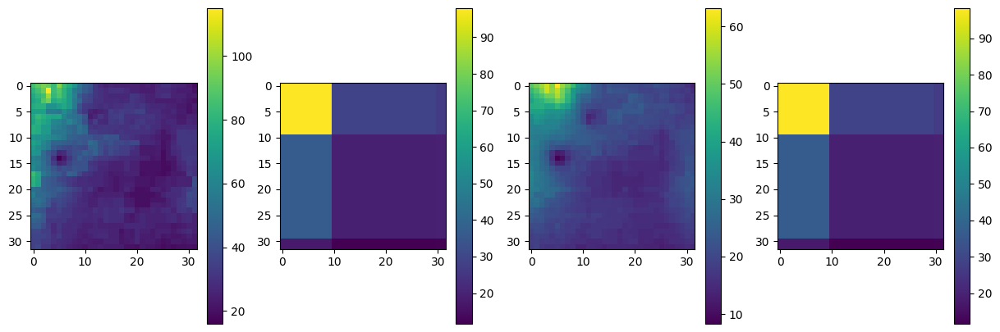

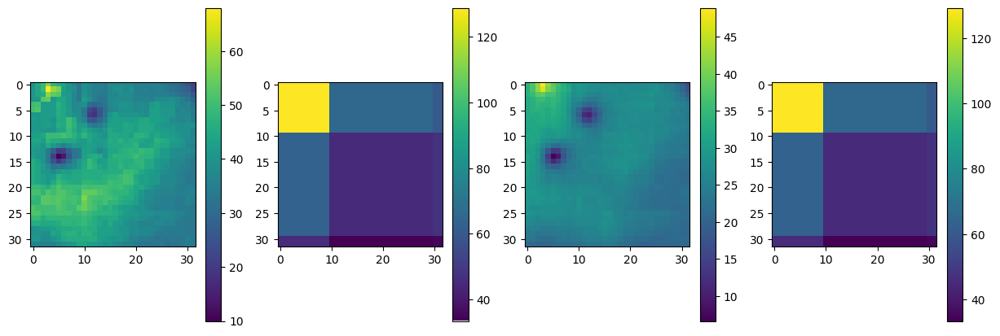

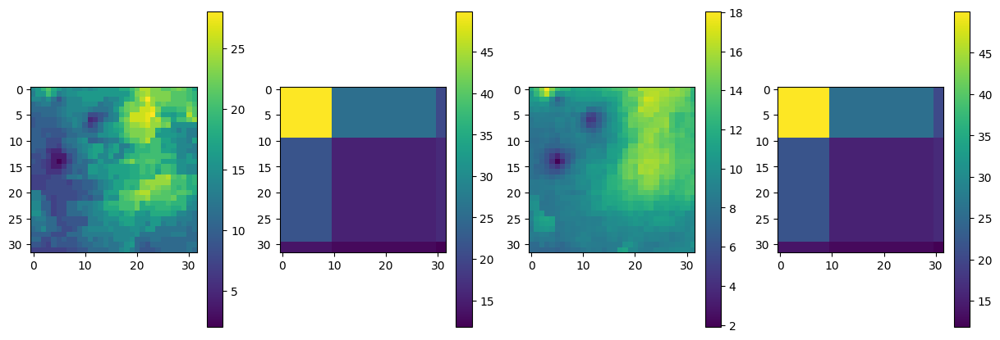

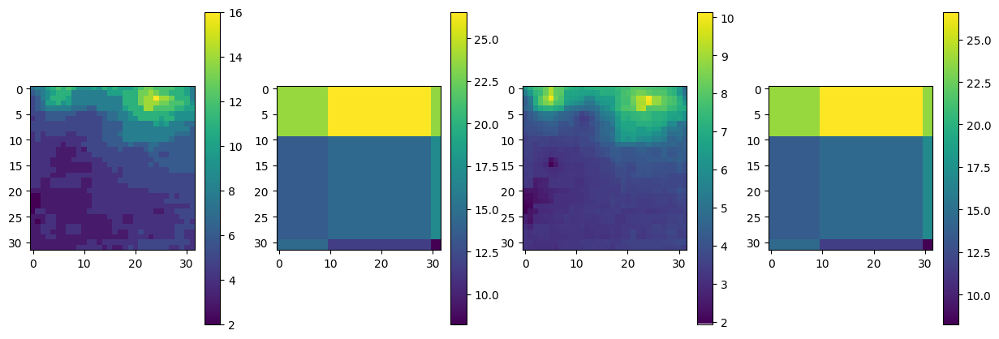

In [100]:
for index in range(4):
    fig, axes = plt.subplots(1, 4, figsize=(15, 5))
    im1 = axes[0].imshow(rfh['band'][index])

    im2 = axes[1].imshow(forecast_near['tp'][index])

    im3 = axes[2].imshow(rfh_lta['band'][index])
    
    im4 = axes[3].imshow(scaled_forecast_near['tp'][index])

    fig.colorbar(im1)
    fig.colorbar(im2)
    fig.colorbar(im3)
    fig.colorbar(im4)

    plt.show()


# Cuba

In [100]:
region="Cuba"

## Import RFH CHIRPS

In [4]:
bbox = (-76.113281,-3.513421,-63.852539,6.795535) #Sudan
area = AnalysisArea(
    bbox=bbox,
    datetime_range="1983-01-01/2023-06-30"  # change the starting date 1983  
)
rfh = area.get_dataset(["CHIRPS","rfh_dekad"])


In [5]:
rfh = rfh.load()

### Extract Seasonality

In [6]:
start_season =2
end_season =5

### Agregation over every month

In [7]:
rfh_resample = rfh.resample(time='M').sum()

## Import ECMWF Prediction

In [21]:
path_issue = f's3://wfp-seasmon/zarr/seasonal-forecasts/0{start_season}/01'

with dask.config.set(**{'array.slicing.split_large_chunks': False}):
    ds_issue = xr.open_mfdataset(f'{path_issue}/*.zarr', chunks={"latitude":36, "longitude":70, "ensemble":-1}, engine='zarr')
ds_issue = ds_issue.sel(latitude = slice(bbox[3], bbox[1]),longitude = slice(bbox[0], bbox[2])) 

In [22]:
da_issue = ds_issue.tp.load()

In [23]:
da_issue = da_issue.mean("ensemble") #Output 1 ensemble
da_issue = da_issue.diff(dim='time', n=1).fillna(0)  # Non cumulative

In [24]:
da_issue.longitude

<xarray.DataArray 'longitude' (longitude: 6)>
array([36.5, 37.5, 38.5, 39.5, 40.5, 41.5])
Coordinates:
  * longitude    (longitude) float64 36.5 37.5 38.5 39.5 40.5 41.5
    spatial_ref  int32 4326

In [66]:
# path_issue = f's3://wfp-seasmon/zarr/seasonal-forecasts/{mm}/01'

# with dask.config.set(**{'array.slicing.split_large_chunks': False}):
#     ds_issue = xr.open_mfdataset(f'{path_issue}/*.zarr', chunks={"latitude":36, "longitude":36, "ensemble":-1}, engine='zarr')
    
# ds_issue = ds_issue.sel(latitude = slice(bbox[3], bbox[1]),longitude = slice(bbox[0], bbox[2])) 
# da_issue = ds_issue.tp.load()
# da_issue = da_issue.mean("ensemble")


da_monthly_sum = da_issue.resample(time='M').sum()
da_monthly_sum_season  = da_monthly_sum.sel(time=(da_monthly_sum['time.month'] >= start_season) & (da_monthly_sum['time.month'] <= end_season), drop=True) 
da_monthly_sum_season_near = da_monthly_sum_season.rio.reproject(rfh_resample.rio.crs, 
                                                             resolution=(-0.05,0.05), 
                                                             resampling=rasterio.enums.Resampling.nearest)

da_monthly_sum_season_near = da_monthly_sum_season_near.rename({'y': 'latitude', 'x': 'longitude'})
da_monthly_sum_season_near = da_monthly_sum_season_near 

rfh_resample = rfh_resample.sel(latitude = slice(-75.5, -63.5), longitude = slice(-3.5, 6.5))
da_monthly_sum_season_near_resample =da_monthly_sum_season_near.sel(latitude = rfh_resample.latitude.values, longitude= rfh_resample.longitude.values, method = "nearest")


latitude_size, longitude_size = 32,32

rfh = rfh_resample.isel(latitude=slice(0,latitude_size), longitude=slice(0,longitude_size))
da_monthly_sum_season_near  = da_monthly_sum_season_near_resample.isel(latitude=slice(0,latitude_size), longitude=slice(0,longitude_size))
# da_monthly_sum_season_near.to_netcdf(f'Data/Downscaling/Rainfall/Jordan/data/da_monthly_sum_season_near_01.nc')

In [92]:
scale_rate = 10

rfh = rfh.sel(time=(rfh['time.month'] >= start_season) & (rfh['time.month'] <= end_season), drop=True) 
scaling_factors = rfh.max() / da_monthly_sum_season_near.max()

forecast = da_monthly_sum_season_near*scaling_factors['band'].values

In [93]:
forecast.to_netcdf(f'Data/Downscaling/Rainfall/{region}/data/forecast.nc')
rfh.to_netcdf(f'Data/Downscaling/Rainfall/{region}/data/rfh_monthly.nc')

## LTA

In [95]:
forecast_near = xr.open_dataset(f'Data/Downscaling/Rainfall/{region}/data/forecast.nc')
# forecast_near = forecast_near.update(forecast_near*1e4) ## CHANGE!!!
rfh = xr.open_dataset(f'Data/Downscaling/Rainfall/{region}/data/rfh_monthly.nc')

In [96]:
rfh_lta = rfh.sel(time=slice("1983-02-28","2018-05-31"))
rfh_lta  = rfh_lta .groupby(rfh_lta.time.dt.strftime("%m-%d")).mean()
rfh_lta = rfh_lta.sel(strftime=rfh.time.dt.strftime("%m-%d"))

In [97]:
rfh_lta.to_netcdf(f'Data/Downscaling/Rainfall/{region}/data/rfh_lta.nc')

In [98]:
xr.open_dataset(f'Data/Downscaling/Rainfall/{region}/data/forecast.nc')

<xarray.Dataset>
Dimensions:      (longitude: 32, latitude: 32, time: 172)
Coordinates:
  * longitude    (longitude) float64 36.52 36.57 36.62 ... 37.98 38.02 38.07
  * latitude     (latitude) float64 32.48 32.43 32.38 ... 31.03 30.98 30.93
  * time         (time) datetime64[ns] 1981-02-28 1981-03-31 ... 2023-05-31
    spatial_ref  int64 ...
Data variables:
    tp           (time, latitude, longitude) float32 ...

In [99]:
forecast_near

<xarray.Dataset>
Dimensions:      (longitude: 32, latitude: 32, time: 172)
Coordinates:
  * longitude    (longitude) float64 36.52 36.57 36.62 ... 37.98 38.02 38.07
  * latitude     (latitude) float64 32.48 32.43 32.38 ... 31.03 30.98 30.93
  * time         (time) datetime64[ns] 1981-02-28 1981-03-31 ... 2023-05-31
    spatial_ref  int64 ...
Data variables:
    tp           (time, latitude, longitude) float32 ...

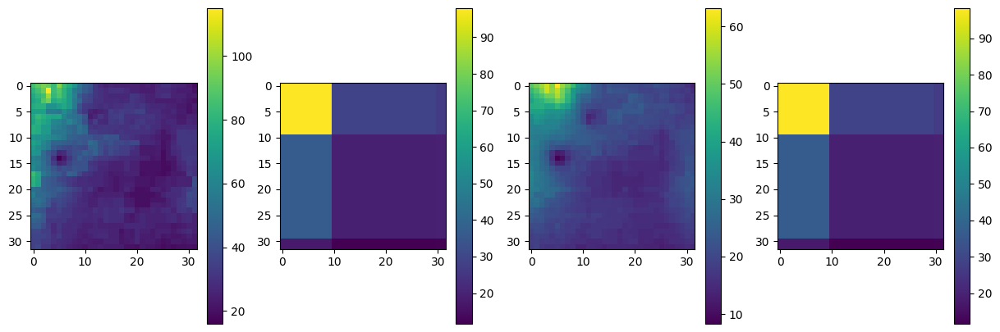

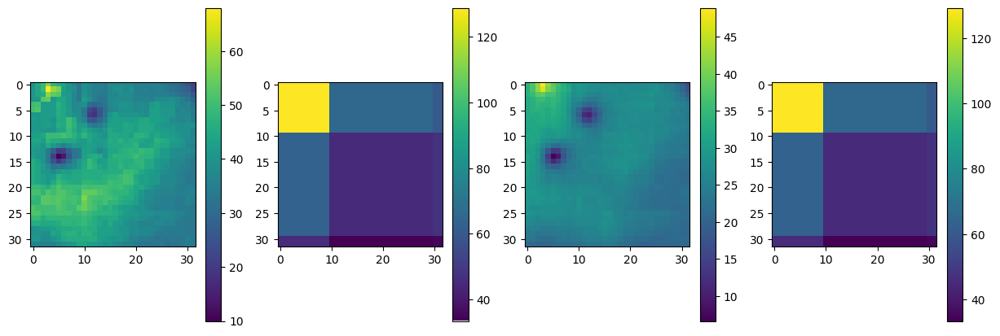

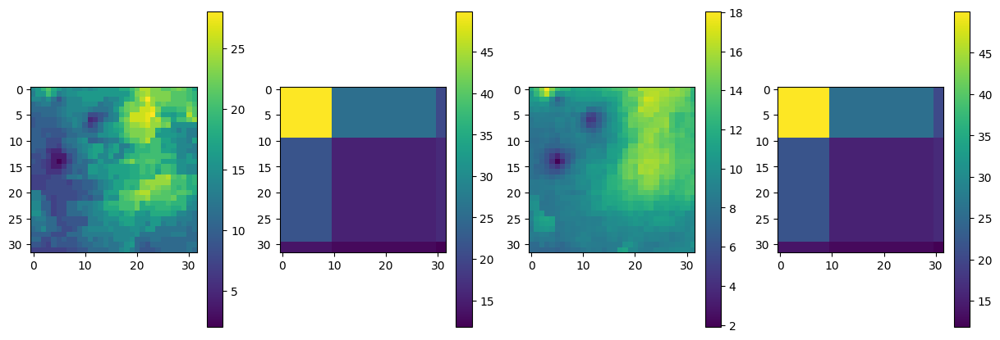

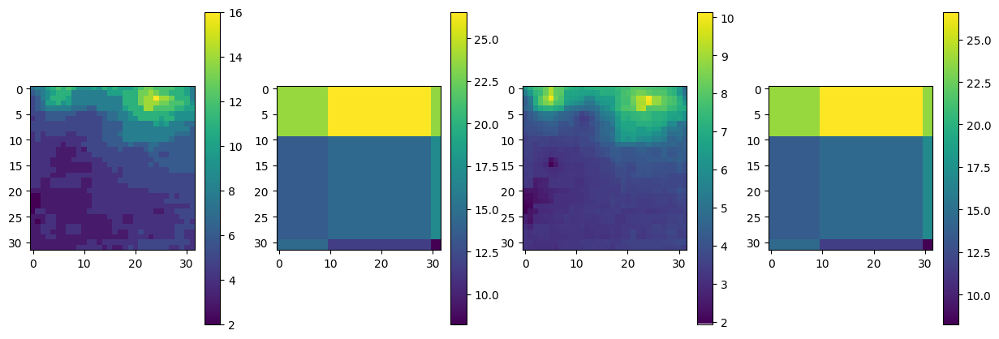

In [100]:
for index in range(4):
    fig, axes = plt.subplots(1, 4, figsize=(15, 5))
    im1 = axes[0].imshow(rfh['band'][index])

    im2 = axes[1].imshow(forecast_near['tp'][index])

    im3 = axes[2].imshow(rfh_lta['band'][index])
    
    im4 = axes[3].imshow(scaled_forecast_near['tp'][index])

    fig.colorbar(im1)
    fig.colorbar(im2)
    fig.colorbar(im3)
    fig.colorbar(im4)

    plt.show()


# Indonesie

In [103]:
region="Indonesie"

## Import RFH CHIRPS

In [4]:
bbox = (110.412598,-2.723583,115.971680,1.076597) #Sudan
area = AnalysisArea(
    bbox=bbox,
    datetime_range="1983-01-01/2023-06-30"  # change the starting date 1983  
)
rfh = area.get_dataset(["CHIRPS","rfh_dekad"])


In [5]:
rfh = rfh.load()

### Extract Seasonality

In [6]:
start_season =2
end_season =5

### Agregation over every month

In [7]:
rfh_resample = rfh.resample(time='M').sum()

## Import ECMWF Prediction

In [21]:
path_issue = f's3://wfp-seasmon/zarr/seasonal-forecasts/0{start_season}/01'

with dask.config.set(**{'array.slicing.split_large_chunks': False}):
    ds_issue = xr.open_mfdataset(f'{path_issue}/*.zarr', chunks={"latitude":36, "longitude":70, "ensemble":-1}, engine='zarr')
ds_issue = ds_issue.sel(latitude = slice(bbox[3], bbox[1]),longitude = slice(bbox[0], bbox[2])) 

In [22]:
da_issue = ds_issue.tp.load()

In [23]:
da_issue = da_issue.mean("ensemble") #Output 1 ensemble
da_issue = da_issue.diff(dim='time', n=1).fillna(0)  # Non cumulative

In [24]:
da_issue.longitude

<xarray.DataArray 'longitude' (longitude: 6)>
array([36.5, 37.5, 38.5, 39.5, 40.5, 41.5])
Coordinates:
  * longitude    (longitude) float64 36.5 37.5 38.5 39.5 40.5 41.5
    spatial_ref  int32 4326

In [66]:
# path_issue = f's3://wfp-seasmon/zarr/seasonal-forecasts/{mm}/01'

# with dask.config.set(**{'array.slicing.split_large_chunks': False}):
#     ds_issue = xr.open_mfdataset(f'{path_issue}/*.zarr', chunks={"latitude":36, "longitude":36, "ensemble":-1}, engine='zarr')
    
# ds_issue = ds_issue.sel(latitude = slice(bbox[3], bbox[1]),longitude = slice(bbox[0], bbox[2])) 
# da_issue = ds_issue.tp.load()
# da_issue = da_issue.mean("ensemble")


da_monthly_sum = da_issue.resample(time='M').sum()
da_monthly_sum_season  = da_monthly_sum.sel(time=(da_monthly_sum['time.month'] >= start_season) & (da_monthly_sum['time.month'] <= end_season), drop=True) 
da_monthly_sum_season_near = da_monthly_sum_season.rio.reproject(rfh_resample.rio.crs, 
                                                             resolution=(-0.05,0.05), 
                                                             resampling=rasterio.enums.Resampling.nearest)

da_monthly_sum_season_near = da_monthly_sum_season_near.rename({'y': 'latitude', 'x': 'longitude'})
da_monthly_sum_season_near = da_monthly_sum_season_near 

rfh_resample = rfh_resample.sel(latitude = slice(110.5, 115.5), longitude = slice(-2.5, 0.5))
da_monthly_sum_season_near_resample =da_monthly_sum_season_near.sel(latitude = rfh_resample.latitude.values, longitude= rfh_resample.longitude.values, method = "nearest")


latitude_size, longitude_size = 32,32

rfh = rfh_resample.isel(latitude=slice(0,latitude_size), longitude=slice(0,longitude_size))
da_monthly_sum_season_near  = da_monthly_sum_season_near_resample.isel(latitude=slice(0,latitude_size), longitude=slice(0,longitude_size))
# da_monthly_sum_season_near.to_netcdf(f'Data/Downscaling/Rainfall/Jordan/data/da_monthly_sum_season_near_01.nc')

In [92]:
scale_rate = 10

rfh = rfh.sel(time=(rfh['time.month'] >= start_season) & (rfh['time.month'] <= end_season), drop=True) 
scaling_factors = rfh.max() / da_monthly_sum_season_near.max()

forecast = da_monthly_sum_season_near*scaling_factors['band'].values

In [93]:
forecast.to_netcdf(f'Data/Downscaling/Rainfall/{region}/data/forecast.nc')
rfh.to_netcdf(f'Data/Downscaling/Rainfall/{region}/data/rfh_monthly.nc')

## LTA

In [95]:
forecast_near = xr.open_dataset(f'Data/Downscaling/Rainfall/{region}/data/forecast.nc')
# forecast_near = forecast_near.update(forecast_near*1e4) ## CHANGE!!!
rfh = xr.open_dataset(f'Data/Downscaling/Rainfall/{region}/data/rfh_monthly.nc')

In [96]:
rfh_lta = rfh.sel(time=slice("1983-02-28","2018-05-31"))
rfh_lta  = rfh_lta .groupby(rfh_lta.time.dt.strftime("%m-%d")).mean()
rfh_lta = rfh_lta.sel(strftime=rfh.time.dt.strftime("%m-%d"))

In [97]:
rfh_lta.to_netcdf(f'Data/Downscaling/Rainfall/{region}/data/rfh_lta.nc')

In [98]:
xr.open_dataset(f'Data/Downscaling/Rainfall/{region}/data/forecast.nc')

<xarray.Dataset>
Dimensions:      (longitude: 32, latitude: 32, time: 172)
Coordinates:
  * longitude    (longitude) float64 36.52 36.57 36.62 ... 37.98 38.02 38.07
  * latitude     (latitude) float64 32.48 32.43 32.38 ... 31.03 30.98 30.93
  * time         (time) datetime64[ns] 1981-02-28 1981-03-31 ... 2023-05-31
    spatial_ref  int64 ...
Data variables:
    tp           (time, latitude, longitude) float32 ...

In [99]:
forecast_near

<xarray.Dataset>
Dimensions:      (longitude: 32, latitude: 32, time: 172)
Coordinates:
  * longitude    (longitude) float64 36.52 36.57 36.62 ... 37.98 38.02 38.07
  * latitude     (latitude) float64 32.48 32.43 32.38 ... 31.03 30.98 30.93
  * time         (time) datetime64[ns] 1981-02-28 1981-03-31 ... 2023-05-31
    spatial_ref  int64 ...
Data variables:
    tp           (time, latitude, longitude) float32 ...

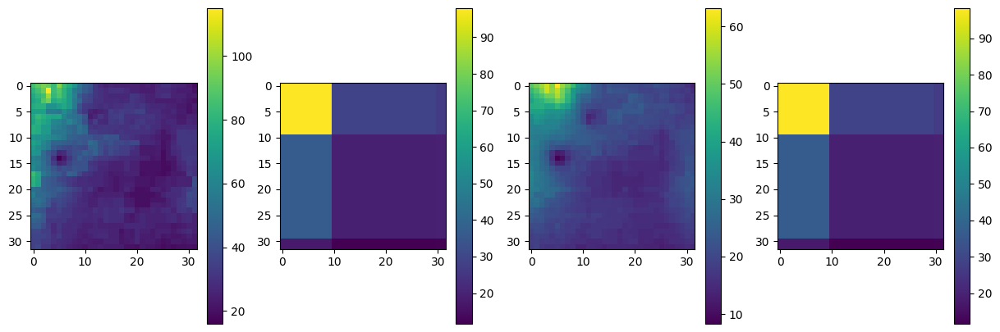

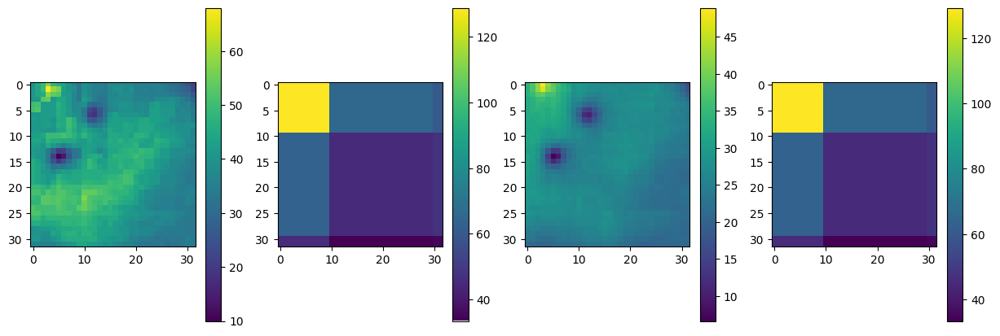

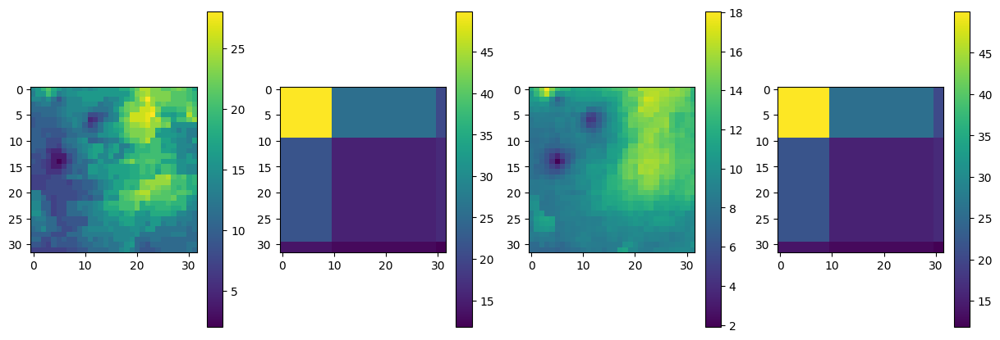

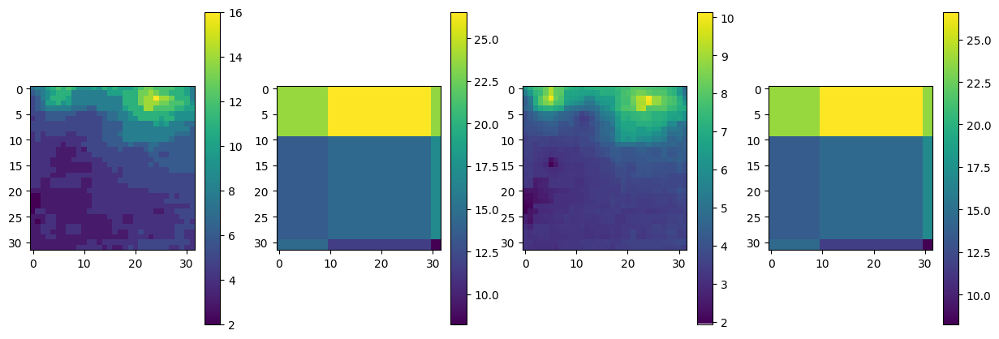

In [100]:
for index in range(4):
    fig, axes = plt.subplots(1, 4, figsize=(15, 5))
    im1 = axes[0].imshow(rfh['band'][index])

    im2 = axes[1].imshow(forecast_near['tp'][index])

    im3 = axes[2].imshow(rfh_lta['band'][index])
    
    im4 = axes[3].imshow(scaled_forecast_near['tp'][index])

    fig.colorbar(im1)
    fig.colorbar(im2)
    fig.colorbar(im3)
    fig.colorbar(im4)

    plt.show()


# Bilinear interpolation 

In [1]:
def bilinear_interpolate (forecast,verbose=False):
    new_height = forecast.shape[1]
    new_width = forecast.shape[2]
    forecast_resample=forecast[0]
    image_tensor  = forecast_resample[:30:5,:30:5]
    
    rescaled_image = F.interpolate(image_tensor.unsqueeze(0).unsqueeze(0), size=(new_height, new_width), mode='bilinear', align_corners=False)[0]
    
    if verbose:
        
        plt.imshow(rescaled_image)
        plt.show()
        
    
    
    return rescaled_image

# Weighted Mask

In [2]:
import numpy as np
# Define a custom weighting function (e.g., higher weights in center)
def custom_weight_function_mean(square):
    normalized_weights = square/np.mean(square)
    return normalized_weights

def custom_weight_function(square):
    local_std = np.std(square)
    normalized_weights = local_std / np.mean(square)
    
    
    return normalized_weights

def Downscale_Weight(rfh_lta,forecast, verbose=False):

    # Initialize an empty weight mask
    weight_mask = np.zeros_like(forecast)

    # Compute weights and apply them
    
    step = 10
    for row in range(0,30,step):
        for col in range(0,60,10):
            rfh_lta_square = rfh_lta[row:row + step, col:col + step]
            weights = custom_weight_function_mean(rfh_lta_square)
            weight_mask[row:row + step, col:col + step] = weights
            
    
    for row in range(0,32,step):
            rfh_lta_square = rfh_lta[row:row + step, 60:]
            weights = custom_weight_function_mean(rfh_lta_square)
            weight_mask[row:row + step, 60:] = weights
        
        
    for col in range(0,64,step):
            rfh_lta_square = rfh_lta[30:, col:col + step]
            weights = custom_weight_function_mean(rfh_lta_square)
            weight_mask[30:, col:col + step] = weights



    # Apply the weight mask to forecast
    weighted_forecast = forecast * weight_mask


    if verbose:
        fig, axes = plt.subplots(1, 4, figsize=(15, 5))
        axes[0].imshow(forecast)
        axes[1].imshow(rfh_lta)
        axes[2].imshow(weighted_forecast)
        axes[3].imshow(weighted_forecast-rfh_lta)

        axes[0].set_title(f"forecastKm", fontsize='xx-large')
        axes[1].set_title(f"rfh_lta", fontsize='xx-large')
        axes[2].set_title(f"NDVI_Downscaled_det", fontsize='xx-large')
        axes[3].set_title(f"Bias", fontsize='xx-large')
        plt.show()

    return weighted_forecast

In [3]:
path_ecmwf = f"/mnt/shared/users/wessim.omezzine/ClimaX/Data/Downscaling/Rainfall/{region}/data/"
path_chirps = f"/mnt/shared/users/wessim.omezzine/ClimaX/Data/Downscaling/Rainfall/{region}/data/"
save_dir = f"/mnt/shared/users/wessim.omezzine/ClimaX/Data/Downscaling/Rainfall/{region}/data_npz/" 

NameError: name 'region' is not defined

In [4]:
rfh = xr.open_dataset(path_chirps+"rfh_monthly.nc").fillna(0)    
rfh_lta = xr.open_dataset(path_chirps+"rfh_lta.nc").fillna(0)
forecast = xr.open_dataset(path_ecmwf+"forecast.nc").fillna(0)


##### TO CHANGE!!!!
dimensions_lat = 32
dimensions_lon = 64
# ndvi_1 = select_shape(ndvi_1, dimensions, dimensions, True )
# ndvi_1_lta = select_shape(ndvi_1_lta, dimensions, dimensions, True )
# ndvi_5 = select_shape(ndvi_5, ndvi_5.dims["latitude"], ndvi_5.dims["longitude"], True)



variables = {
"rfh": rfh,
"rfh_lta": rfh_lta,
"forecast": forecast,

}
   
variables['rfh'].sel(time=variables['rfh'].time.dt.year == 1983)


NameError: name 'xr' is not defined

# ClimaX

In [ ]:
! python src/data_preprocessing/nc2np_equally_ecmwf_downscaling.py

In [ ]:
ClimaX/Data/Downscaling/Rainfall/data/rfh_monthly.nc

In [ ]:
np.load('Data/Downscaling/Rainfall/data_npz/normalize_std.npz')['rfh_lta']

# Metrics

In [5]:
def lat_weighted_mse_val(pred, y, transform, lat):
    """Latitude weighted mean squared error
    Args:
        y: [B, V, H, W]
        pred: [B, V, H, W]
        vars: list of variable names
        lat: H
    """
    
    print("pred.device", pred.device)
    print("y.device", y.device)

    error = (pred - y) ** 2  # [B, V, H, W]

    # lattitude weights
    w_lat = np.cos(np.deg2rad(lat))

    w_lat = w_lat / w_lat.mean()  # (H, )
    w_lat = torch.from_numpy(w_lat).unsqueeze(0).unsqueeze(-1).to(dtype=error.dtype, device=error.device)  # (1, H, 1)

    loss_dict = {}
    with torch.no_grad(): 
        
            res =  (error * w_lat).mean()
    return res

In [6]:
def lat_weighted_rmse(pred, y, transform, lat ):
    """Latitude weighted root mean squared error

    Args:
        y: [B, V, H, W]
        pred: [B, V, H, W]
        vars: list of variable names
        lat: H
    """

    pred = transform(pred)
    y = transform(y)

    error = (pred - y) ** 2  # [B, V, H, W]

    # lattitude weights
    w_lat = np.cos(np.deg2rad(lat))
    w_lat = w_lat / w_lat.mean()  # (H, )
    w_lat = torch.from_numpy(w_lat).unsqueeze(0).unsqueeze(-1).to(dtype=error.dtype, device=error.device)

    with torch.no_grad():
        res = torch.mean(
                torch.sqrt(torch.mean(error * w_lat, dim=(-2, -1)))
            )

    return res



In [10]:

def remove_nans(pred: torch.Tensor, gt: torch.Tensor):
    # pred and gt are two flattened arrays
    pred_nan_ids = torch.isnan(pred) | torch.isinf(pred)
    pred = pred[~pred_nan_ids]
    gt = gt[~pred_nan_ids]

    gt_nan_ids = torch.isnan(gt) | torch.isinf(gt)
    pred = pred[~gt_nan_ids]
    gt = gt[~gt_nan_ids]

    return pred, gt


def pearson(pred, y, transform,lat):
    """
    y: [N, T, 3, H, W]
    pred: [N, T, 3, H, W]
    vars: list of variable names
    lat: H
    """

    pred = transform(pred)
    y = transform(y)

    loss_dict = {}
    with torch.no_grad():
        pred_, y_ = pred.flatten(), y.flatten()
        pred_, y_ = remove_nans(pred_, y_)
        res = stats.pearsonr(pred_.cpu().numpy(), y_.cpu().numpy())[0]

    return res

def spearman(pred, y, transform,lat):
    """
    y: [N, T, 3, H, W]
    pred: [N, T, 3, H, W]
    vars: list of variable names
    lat: H
    """

    pred = transform(pred)
    y = transform(y)

    loss_dict = {}
    with torch.no_grad():
        pred_, y_ = pred.flatten(), y.flatten()
        pred_, y_ = remove_nans(pred_, y_)
        res = stats.spearmanr(pred_.cpu().numpy(), y_.cpu().numpy())[0]

    return res

def mean_bias(pred, y, transform,lat):
    """
    y: [B, V, H, W]
    pred: [B, V, H, W]
    vars: list of variable names
    lat: H
    """

    pred = transform(pred)
    y = transform(y)

    loss_dict = {}
    with torch.no_grad():
        pred_, y_ = pred.flatten(), y.flatten()
        pred_, y_ = remove_nans(pred_, y_)
        res= pred_.mean() - y_.mean()

    return res





# Results

In [11]:
import sys
sys.path.append('/mnt/shared/users/wessim.omezzine/ClimaX/src/climax')
sys.path.append('/mnt/shared/users/wessim.omezzine/ClimaX/src/')
import torch 
import os
import random
import numpy as np
import torch
import matplotlib.pyplot as plt
from datetime import datetime
from torchvision.transforms import transforms
import torch.nn.functional as F
from prettytable import PrettyTable
from scipy import stats


from skimage.metrics import structural_similarity as ssim


from climax.climate_downscaling.module import ClimateDownscalingModule
from climax.climate_downscaling.datamodule import ClimateDownscalingDataModule
from pytorch_lightning.cli import LightningCLI
from pytorch_lightning import Trainer
from climax.arch import ClimaX


TASK_TO_RANGE = {
    '0 days' : 0,
    '10 days' : 1,
    '40 days': 4,
    '50 days': 5,
    '60 days': 6,
    '20 days': 2,
    '30 days': 3,
}

In [12]:
def plot_pred(tensors, var_name, pred_task, time):
    
    index = 0
    fig, axes = plt.subplots(1, 4, figsize=(28, 3), squeeze = False)
    
    
    
    image1_np = tensors[0][time].detach().squeeze().cpu().numpy()
    image2_np = tensors[1][time].detach().squeeze().cpu().numpy()
    image3_np = tensors[2][time].detach().squeeze().cpu().numpy()
    vmin = min(np.min(image2_np), np.min(image3_np))
    vmax = max(np.max(image2_np), np.max(image3_np))
    
    
    
    for i, tensor in enumerate(tensors):
        ax = axes[index][i]
        if i==1 or i==2 : 
            im = ax.imshow(tensor[time].detach().squeeze().cpu().numpy(),vmin=vmin, vmax=vmax)

        else : 
            im = ax.imshow(tensor[time].detach().squeeze().cpu().numpy())
            
            
        im.set_cmap(cmap=plt.cm.RdBu)
        fig.colorbar(im, ax=ax)
        ax.tick_params(
            axis='x',          # changes apply to the x-axis
            which='both',      # both major and minor ticks are affected
            bottom=False,      # ticks along the bottom edge are off
            top=False,         # ticks along the top edge are off
            labelbottom=False
        ) # labels along the bottom edge are off
        ax.tick_params(
            axis='y',          # changes apply to the x-axis
            which='both',      # both major and minor ticks are affected
            left=False,      # ticks along the bottom edge are off
            right=False,        # ticks along the top edge are off
            labelleft=False
        ) # labels along the bottom edge are off



        axes[index][0].text(-10, 64, var_name, fontsize=28, rotation=90, va='center', ha='center')
        axes[index][0].set_title(f"Initial condition", fontsize='xx-large')
        axes[index][1].set_title(f"Ground truth", fontsize='xx-large')
        axes[index][2].set_title(f"Downscaled", fontsize='xx-large')
        axes[index][3].set_title(f"Bias", fontsize='xx-large')

    plt.show()


def plot_inputs(tensors, var_name, pred_task,time):
    index = 0
    fig, axes = plt.subplots(1, 2, figsize=(28, 2), squeeze = False)
    
    timesteps = tensors[0].shape[0]
    
    
    for i, tensor in enumerate(tensors):
        ax = axes[index][i]
        im = ax.imshow(tensor[time].detach().squeeze().cpu().numpy())
        im.set_cmap(cmap=plt.cm.RdBu)
        fig.colorbar(im, ax=ax)
        ax.tick_params(
            axis='x',          # changes apply to the x-axis
            which='both',      # both major and minor ticks are affected
            bottom=False,      # ticks along the bottom edge are off
            top=False,         # ticks along the top edge are off
            labelbottom=False
        ) # labels along the bottom edge are off
        ax.tick_params(
            axis='y',          # changes apply to the x-axis
            which='both',      # both major and minor ticks are affected
            left=False,      # ticks along the bottom edge are off
            right=False,        # ticks along the top edge are off
            labelleft=False
        ) # labels along the bottom edge are off



    axes[index][0].text(-10, 64, "Inputs", fontsize=28, rotation=90, va='center', ha='center')
    axes[index][0].set_title(f"NDVI_5", fontsize='xx-large')
    axes[index][1].set_title(f"NDVI_LTA", fontsize='xx-large')



    plt.show()
    
    

    


In [13]:
def visualize_downscale(model_module, data_module,mean_norm, std_norm, pred_task, var_name, var_id,data_path=None, save_path = None, desired_batch_index = 25):
    
    model_module.eval()
    
    if torch.cuda.is_available():
         model_module.cuda()
    else:
         model_module.cpu()
    

    dataloader = data_module.test_dataloader()
    
   

    for batch_idx, batch_data in enumerate(dataloader, 1):        
        if batch_idx == desired_batch_index:
            # Process the nth batch (e.g., 10th batch)
            x, y, lead_times, in_vars, out_vars = batch_data
            
    
#     print("x.shape", x.shape)
#     print("y.shape", y.shape)
    
    
    if torch.cuda.is_available():
        lead_times = lead_times.cuda()
    else:
        lead_times = lead_times.cpu()

            
    if data_path!=None:
        x_input, y_input, norm_x, norm_y = preprocess(pred_task,model_module, data_module,mean_norm, std_norm,var_id,data_path, verbose=False)
        x = norm_x
        y = norm_y
    
    if torch.cuda.is_available():
        x = x.cuda()
        y = y.cuda()
    else:
        x = x.cpu()
        y = y.cpu()
    
    with torch.no_grad():
        _, pred = model_module.net.forward(x, y, lead_times, in_vars, out_vars, None, model_module.lat)
    
    inv_normalize = model_module.denormalization
    
    
    if data_path!=None:
        tensors = [x_input[:,0],x_input[:,1], x_input[:,2]]

    else:
        tensors = [inv_normalize(x[:,0]), inv_normalize(x[:,1])]
        init_condition = inv_normalize(x[:,0])
    
    
    
    x = x[:, var_id,:]
    gt = inv_normalize(y)
    pred = inv_normalize(pred)
    bias = pred - gt
    tensors_pred = [init_condition, gt, pred, bias]
    
    
    
    
    # plt.imshow(pred.detach().squeeze().cpu().numpy())
    # plt.show()
    
        
    del x
    del y
    return gt,pred,tensors,var_name, pred_task,tensors_pred

In [14]:
def compare_results(gt, forecast, pred, bilinear_interp, weighted_mask, model,t):
    
    # Create a table with three columns
    table = PrettyTable(["","Coarse", "ClimaX", "Bilinear Interpolation", "Weighted Mask"])
    
    transform = model.denormalization
    lat = model.lat
    

    for method in [lat_weighted_mse_val, lat_weighted_rmse, spearman,mean_bias, pearson]:
        
        coarse = method(gt[0],forecast[t].unsqueeze(0), transform, lat).item()
        climax = method(pred[t], gt[t], transform, lat).item()
        bilinear = method(bilinear_interp, gt[t], transform, lat).item()
        mask = method(torch.Tensor(weighted_mask).unsqueeze(0).to('cuda:0'), gt[t], transform, lat).item()

        table.add_row([method.__name__,coarse, climax, bilinear, mask])
        


    # Set the style of the table (optional)
    table.border = True  # Add a border around the table
    table.align = "l"    # Align columns to the left

    # Print the table
    print(table)

def plot_compare(gt,coarse, pred, bilinear_inter, weighted_mask,t ):
    fig, axes = plt.subplots(2, 4, figsize=(12, 6))

    # Plot the first figure on the left subplot
    im1 = axes[0,0].imshow(coarse.cpu().numpy()[t], cmap=plt.cm.RdBu)  # You can change the colormap as needed
    axes[0,0].set_title('ClimaX')
    
    im2 = axes[0,1].imshow(pred.cpu().numpy()[t][0], cmap=plt.cm.RdBu)  # You can change the colormap as needed
    axes[0,1].set_title('ClimaX')

    # Plot the second figure on the right subplot
    im3 = axes[0,2].imshow(bilinear_inter.cpu().numpy()[0], cmap=plt.cm.RdBu)  # You can change the colormap as needed
    axes[0,2].set_title('Bilinear Interpolation')
    
    im4 = axes[0,3].imshow(weighted_mask, cmap=plt.cm.RdBu)  # You can change the colormap as needed
    axes[0,3].set_title('Weighted Mask')
    
    fig.colorbar(im1)
    fig.colorbar(im2)
    fig.colorbar(im3)
    fig.colorbar(im4)
    
    axes[1,0].hist((coarse.cpu().numpy()[t] - gt.cpu().numpy()[t][0]).ravel(), bins=50, color='b', alpha=0.7) # You can change the colormap as needed
    axes[1,0].set_title('Coarse')

    # Plot the second figure on the right subplot
    axes[1,1].hist((pred.cpu().numpy()[0] - gt.cpu().numpy()[t][0]).ravel(), bins=50, color='g', alpha=0.7)
    axes[1,1].set_title('ClimaX')
    
    axes[1,2].hist((bilinear_inter.cpu().numpy() - gt.cpu().numpy()[t][0]).ravel(), bins=50, color='r', alpha=0.7)
    axes[1,2].set_title('Bilinear Interpolation')
    
    axes[1,3].hist((weighted_mask - gt.cpu().numpy()[t][0]).ravel(), bins=50, color='r', alpha=0.7)
    axes[1,3].set_title('Weighted mask')
    
   

    # Adjust spacing between subplots
    plt.tight_layout()

    # Show the plot
    plt.show()

    

Loading pre-trained checkpoint from: ClimaX/exps/downscale/checkpoints/epoch_027-v1.ckpt
<All keys matched successfully>
self.var_map=== {'ndvi_1': 0, 'ndvi_5': 1, 'ndvi_lta': 2}
self.var_map=== {'ndvi_1': 0, 'ndvi_5': 1, 'ndvi_lta': 2}
Time step 0
tensor(0.0602, device='cuda:0')


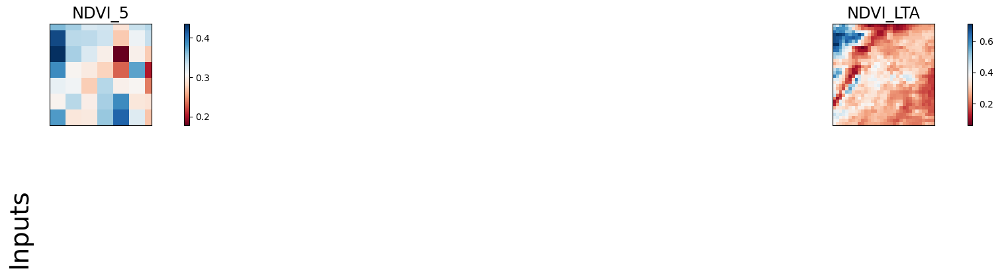

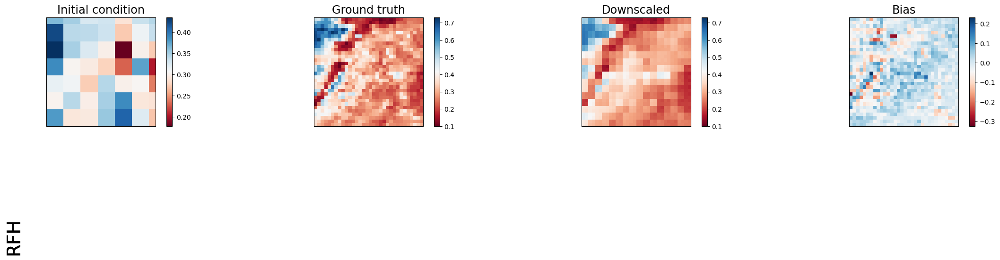

/mnt/shared/users/wessim.omezzine/.local/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3464: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/mnt/shared/users/wessim.omezzine/.local/lib/python3.10/site-packages/numpy/core/_methods.py:192: RuntimeWarning: invalid value encountered in divide
  ret = ret.dtype.type(ret / rcount)


pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+------------------------+------------------------+------------------------+-----------------------+
|                      | Coarse                 | ClimaX                 | Bilinear Interpolation | Weighted Mask         |
+----------------------+------------------------+------------------------+------------------------+-----------------------+
| lat_weighted_mse_val | 0.011904004961252213   | 0.0033638994209468365  | 0.01199145894497633    | 0.006538428831845522  |
| lat_weighted_rmse    | 0.014227084815502167   | 0.007562942337244749   | 0.014279249124228954   | 0.010544016025960445  |
| spearman             | 0.20852025788038056    | 0.7672149400974014     | 0.14072451022697527    | 0.6406124543233828    |
| mean_bias            | -0.0009809434413909912 | -0.0006723999977111816 | 0.001120239496231079   | 0.00112235546112

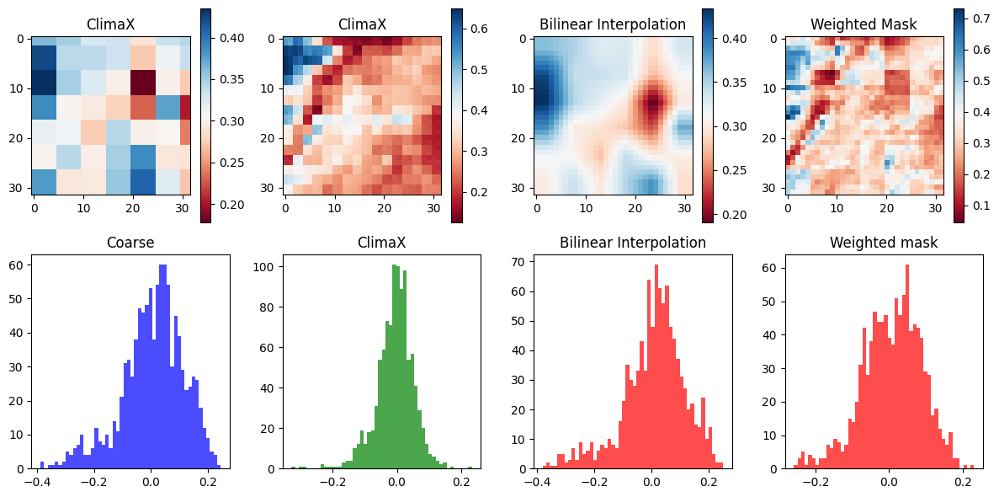

Time step 1
tensor(0.0255, device='cuda:0')


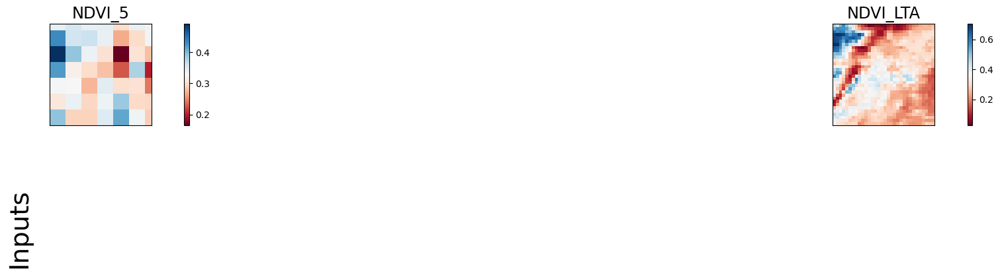

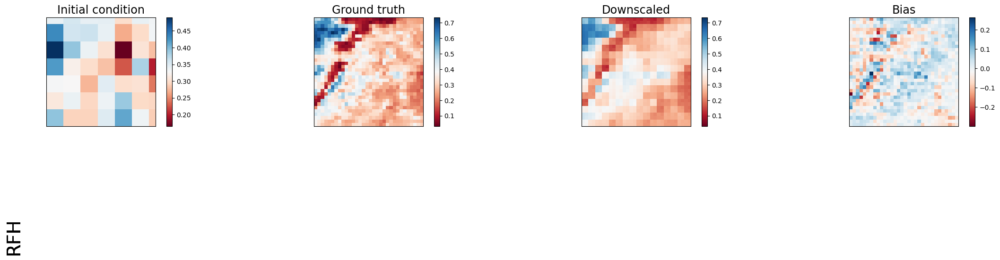

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+------------------------+-----------------------+------------------------+-----------------------+
|                      | Coarse                 | ClimaX                | Bilinear Interpolation | Weighted Mask         |
+----------------------+------------------------+-----------------------+------------------------+-----------------------+
| lat_weighted_mse_val | 0.01219828613102436    | 0.0038722283206880093 | 0.015728212893009186   | 0.007736906409263611  |
| lat_weighted_rmse    | 0.014401866123080254   | 0.008114278316497803  | 0.016353437677025795   | 0.011469725519418716  |
| spearman             | 0.19679361758633138    | 0.7816616089024144    | 0.07899799333376813    | 0.6495020416992704    |
| mean_bias            | -0.0017988085746765137 | 5.862116813659668e-05 | 0.0021570324897766113  | 0.0020508766174316406 |

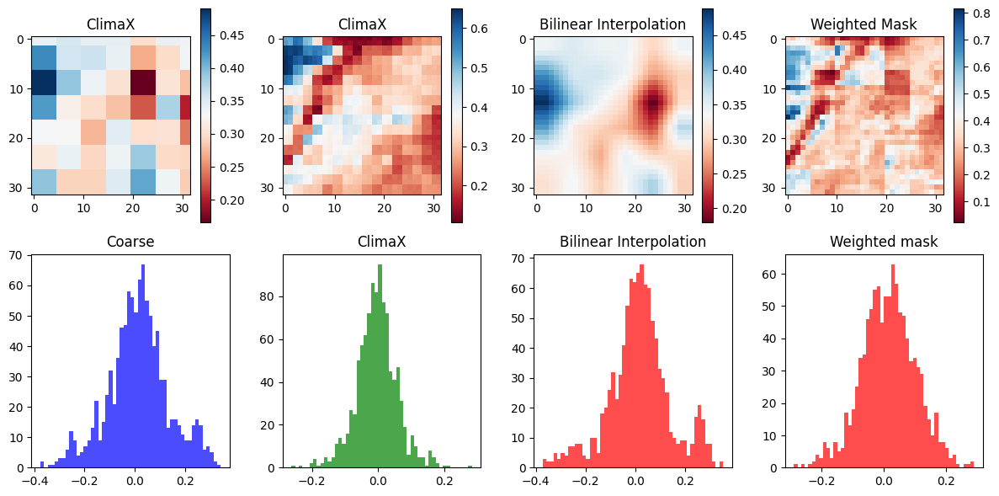

Time step 2
tensor(0.0046, device='cuda:0')


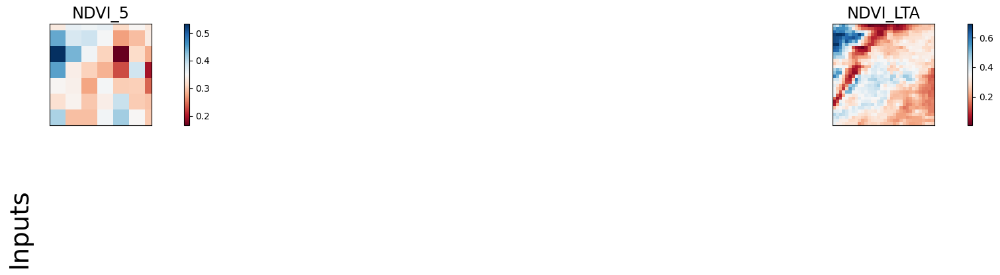

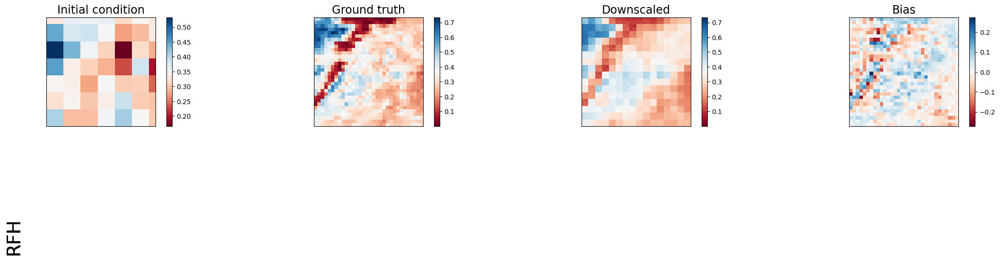

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+-----------------------+------------------------+------------------------+-----------------------+
|                      | Coarse                | ClimaX                 | Bilinear Interpolation | Weighted Mask         |
+----------------------+-----------------------+------------------------+------------------------+-----------------------+
| lat_weighted_mse_val | 0.012908965349197388  | 0.004359099082648754   | 0.01917083188891411    | 0.009452812373638153  |
| lat_weighted_rmse    | 0.014815458096563816  | 0.008609297685325146   | 0.01805468276143074    | 0.012677974998950958  |
| spearman             | 0.1877142300637232    | 0.7952207495974916     | 0.019150605417903827   | 0.6560806157357328    |
| mean_bias            | -0.003072589635848999 | 0.00022029876708984375 | 0.0030388832092285156  | 0.0027272701263427734 |

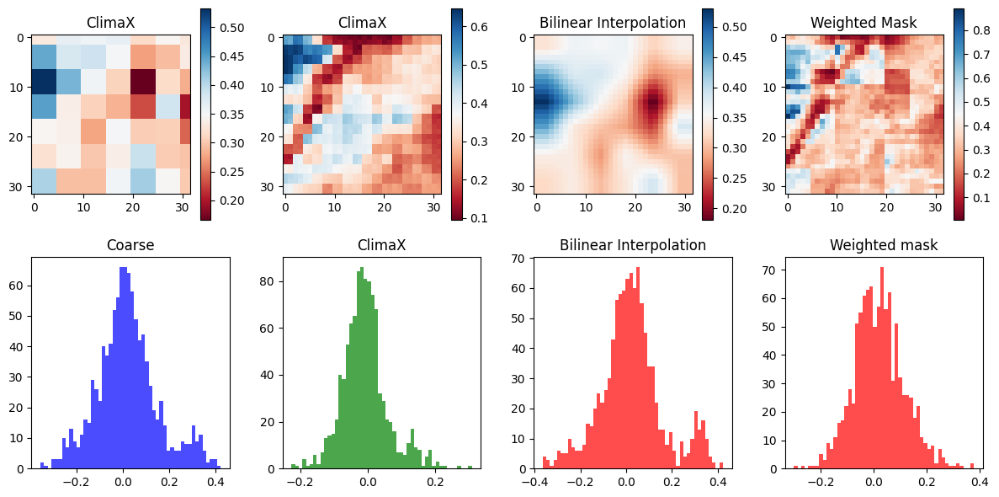

Time step 3
tensor(-0.0047, device='cuda:0')


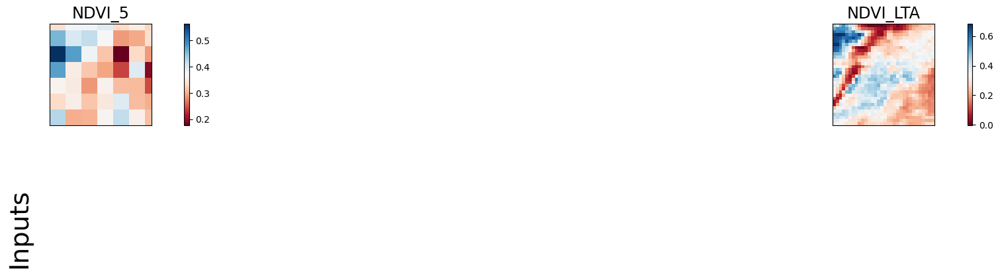

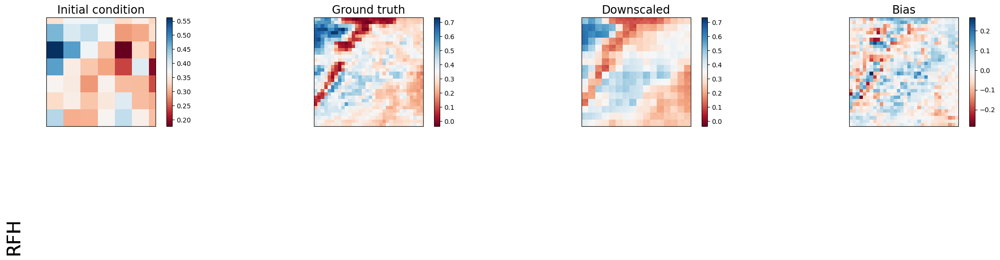

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+-----------------------+------------------------+------------------------+----------------------+
|                      | Coarse                | ClimaX                 | Bilinear Interpolation | Weighted Mask        |
+----------------------+-----------------------+------------------------+------------------------+----------------------+
| lat_weighted_mse_val | 0.014045513235032558  | 0.004785540979355574   | 0.021325169131159782   | 0.01106498297303915  |
| lat_weighted_rmse    | 0.015453903004527092  | 0.009020588360726833   | 0.019042136147618294   | 0.013716544955968857 |
| spearman             | 0.19992314284276574   | 0.8007833837976024     | -0.009424663820348907  | 0.6648264750463919   |
| mean_bias            | -0.004823118448257446 | -3.102421760559082e-05 | 0.0038673579692840576  | 0.00327262282371521  |
| pear

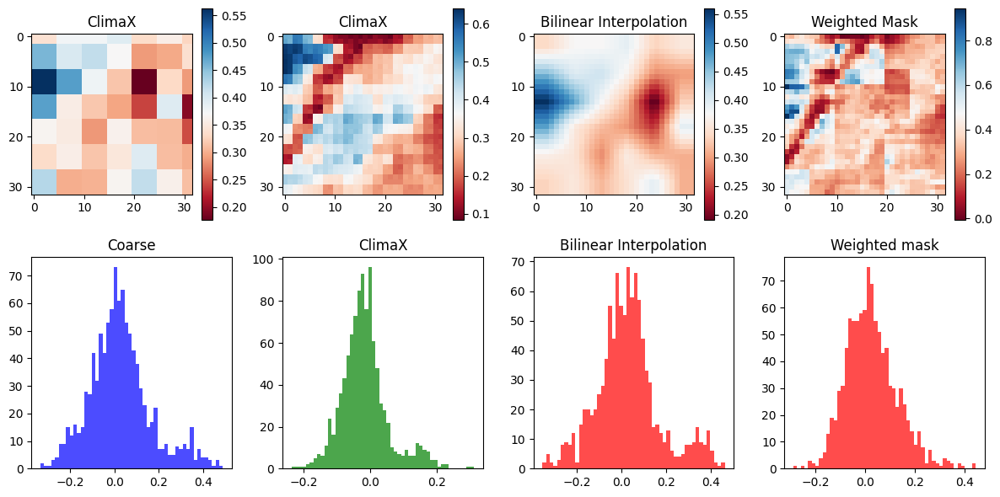

Time step 4
tensor(-0.0021, device='cuda:0')


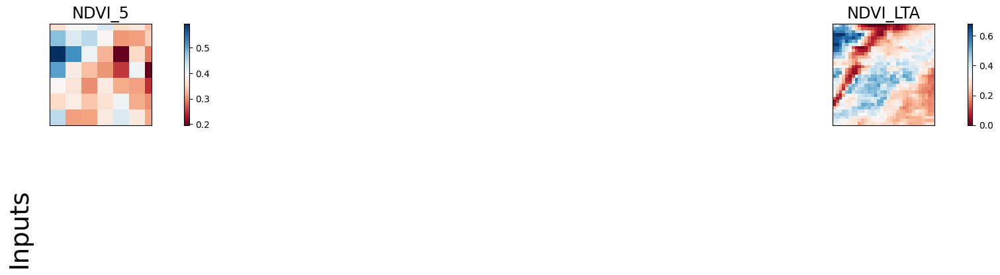

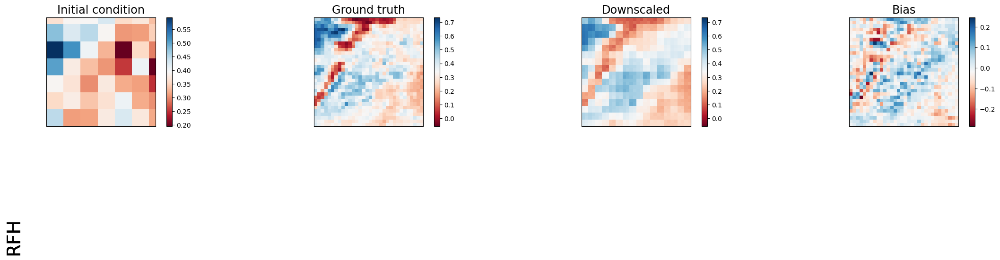

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+-----------------------+------------------------+------------------------+----------------------+
|                      | Coarse                | ClimaX                 | Bilinear Interpolation | Weighted Mask        |
+----------------------+-----------------------+------------------------+------------------------+----------------------+
| lat_weighted_mse_val | 0.015833359211683273  | 0.005063317716121674   | 0.021995319053530693   | 0.012305728159844875 |
| lat_weighted_rmse    | 0.016408011317253113  | 0.009278696030378342   | 0.019339023157954216   | 0.014465154148638248 |
| spearman             | 0.20515733768225344   | 0.8051764768152241     | -0.008814878786384648  | 0.6725717652577926   |
| mean_bias            | -0.007043629884719849 | -0.0004468262195587158 | 0.004634588956832886   | 0.003731966018676758 |
| pear

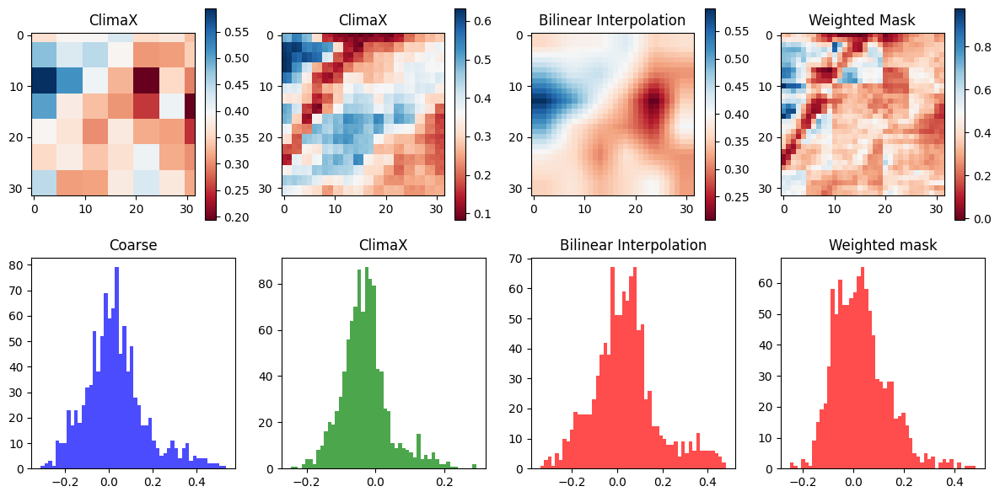

Time step 5
tensor(0.0097, device='cuda:0')


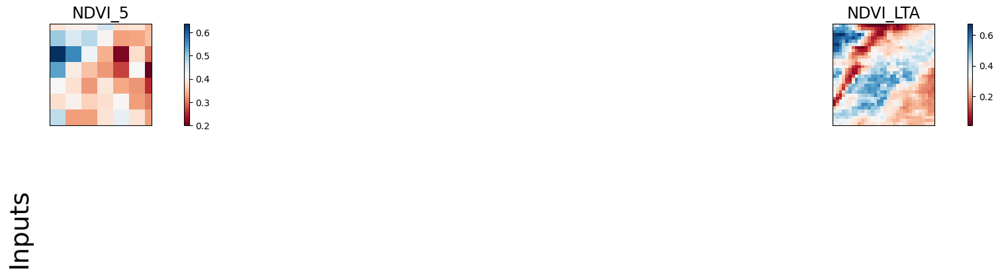

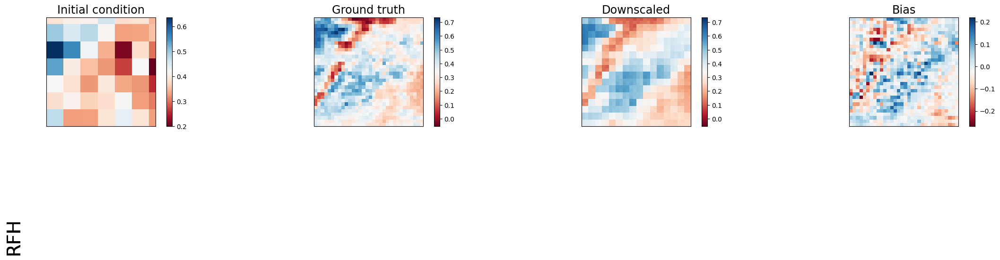

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+-----------------------+-----------------------+------------------------+----------------------+
|                      | Coarse                | ClimaX                | Bilinear Interpolation | Weighted Mask        |
+----------------------+-----------------------+-----------------------+------------------------+----------------------+
| lat_weighted_mse_val | 0.018781628459692     | 0.005222740117460489  | 0.022077089175581932   | 0.013363202102482319 |
| lat_weighted_rmse    | 0.017870472744107246  | 0.009423638693988323  | 0.01937493495643139    | 0.015073866583406925 |
| spearman             | 0.23843418250000392   | 0.8100117856984055    | 0.000729848659656205   | 0.681911687409893    |
| mean_bias            | -0.009725481271743774 | -0.000948101282119751 | 0.005333751440048218   | 0.004159450531005859 |
| pearson    

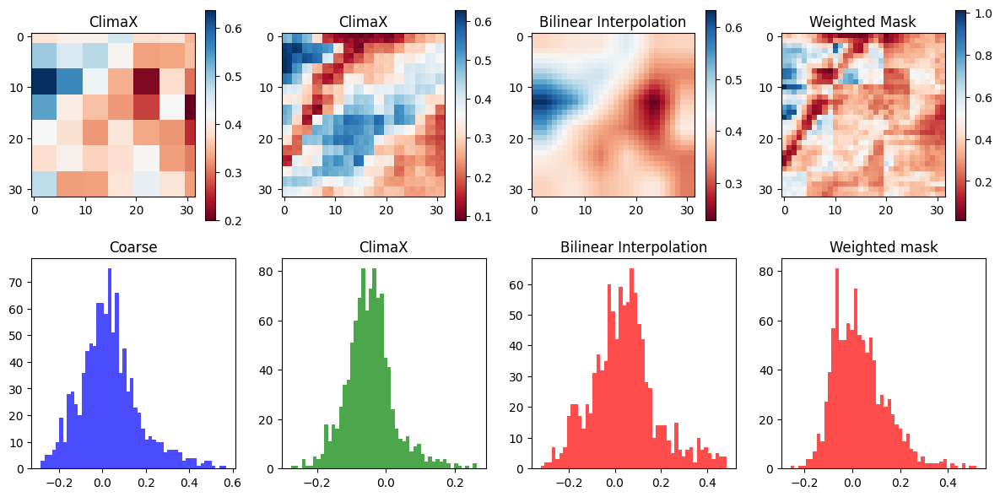

Time step 6
tensor(0.0333, device='cuda:0')


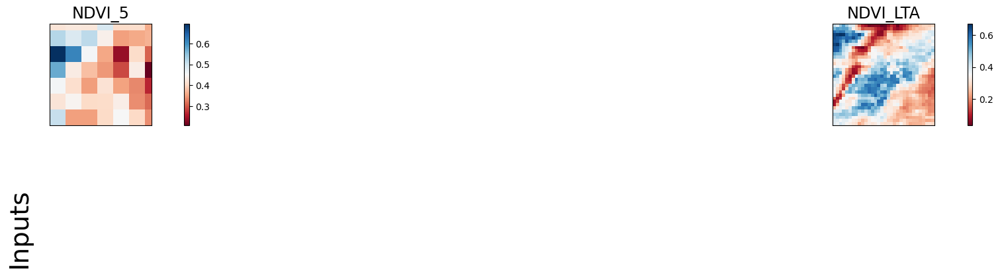

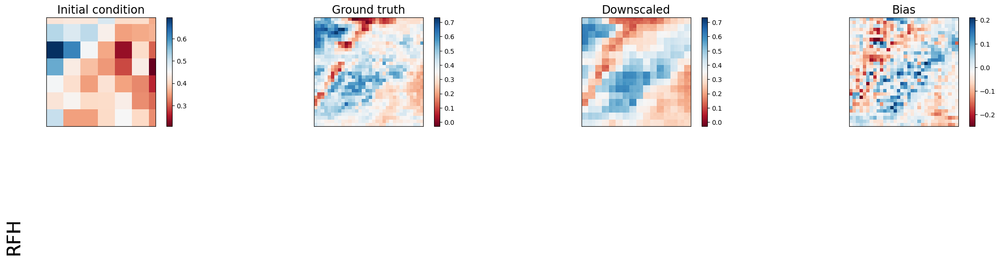

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+-----------------------+-----------------------+------------------------+-----------------------+
|                      | Coarse                | ClimaX                | Bilinear Interpolation | Weighted Mask         |
+----------------------+-----------------------+-----------------------+------------------------+-----------------------+
| lat_weighted_mse_val | 0.023660944774746895  | 0.0053614843636751175 | 0.02234586700797081    | 0.014612741768360138  |
| lat_weighted_rmse    | 0.02005789615213871   | 0.009547988884150982  | 0.01949252001941204    | 0.015762867406010628  |
| spearman             | 0.2655918128523365    | 0.8127679343540685    | 0.023399865765034028   | 0.692539123843002     |
| mean_bias            | -0.012992709875106812 | -0.001508861780166626 | 0.006123006343841553   | 0.0047286152839660645 |
| pear

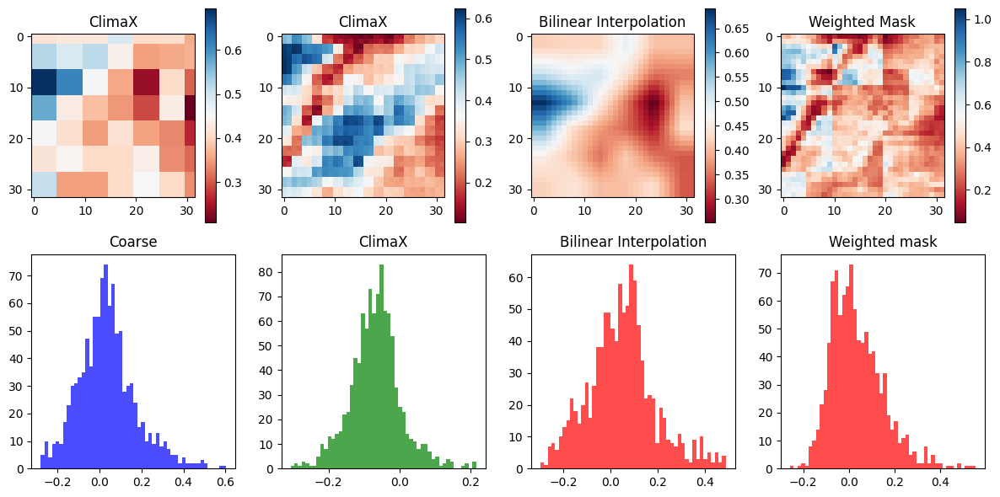

Time step 7
tensor(0.0645, device='cuda:0')


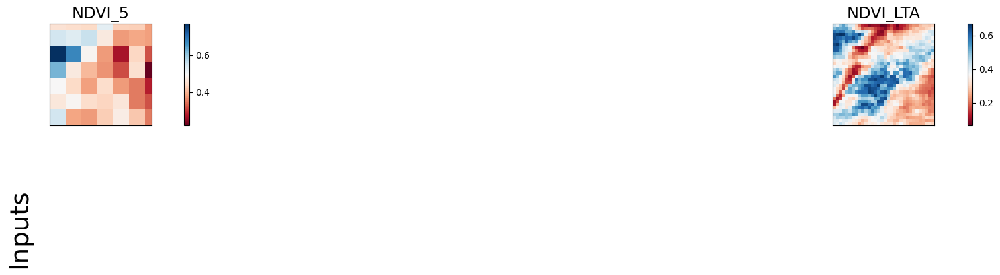

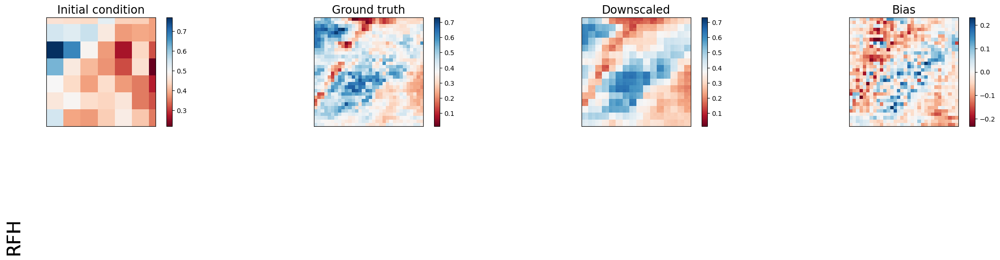

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+-----------------------+----------------------+------------------------+----------------------+
|                      | Coarse                | ClimaX               | Bilinear Interpolation | Weighted Mask        |
+----------------------+-----------------------+----------------------+------------------------+----------------------+
| lat_weighted_mse_val | 0.031573615968227386  | 0.005492933094501495 | 0.02361711487174034    | 0.016471227630972862 |
| lat_weighted_rmse    | 0.023170294240117073  | 0.009664325974881649 | 0.020039312541484833   | 0.0167352557182312   |
| spearman             | 0.295532431989816     | 0.8109819137734952   | 0.050023904162092354   | 0.702544192093053    |
| mean_bias            | -0.016961127519607544 | -0.00208476185798645 | 0.007141977548599243   | 0.005575507879257202 |
| pearson           

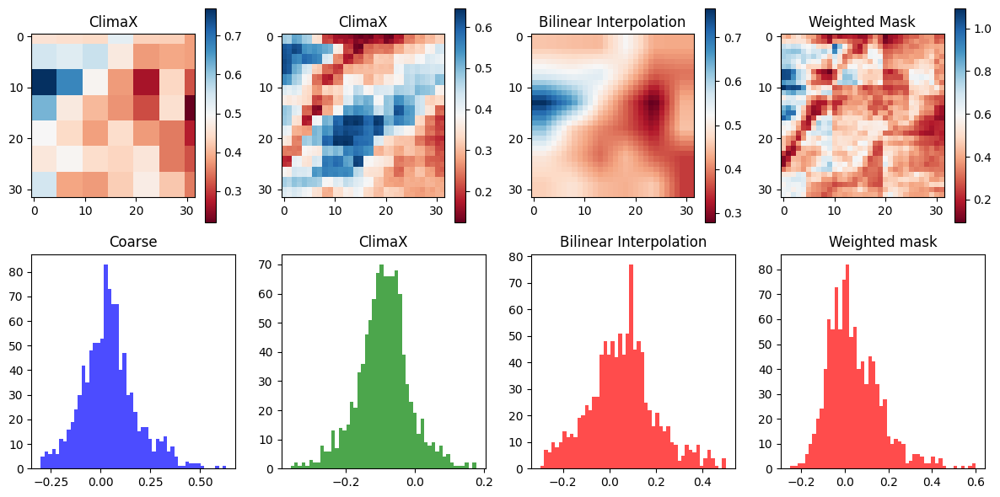

Time step 8
tensor(0.1015, device='cuda:0')


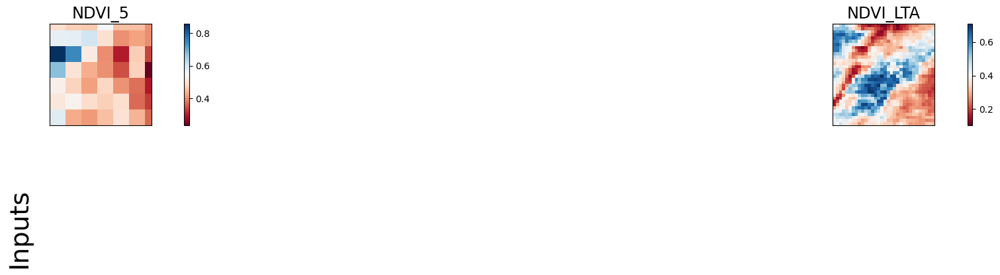

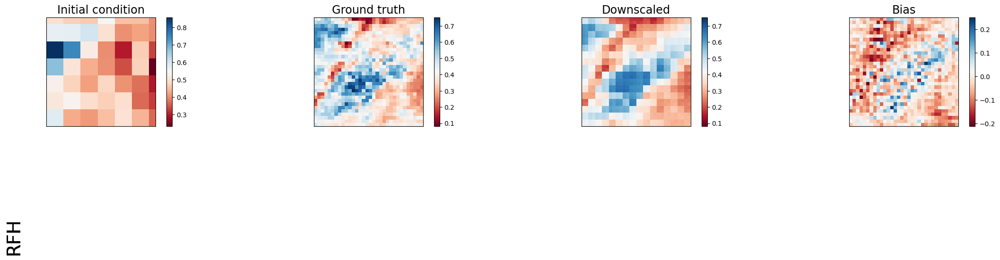

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+-----------------------+-----------------------+------------------------+----------------------+
|                      | Coarse                | ClimaX                | Bilinear Interpolation | Weighted Mask        |
+----------------------+-----------------------+-----------------------+------------------------+----------------------+
| lat_weighted_mse_val | 0.042983971536159515  | 0.005459168925881386  | 0.026026953011751175   | 0.0189958568662405   |
| lat_weighted_rmse    | 0.027034766972064972  | 0.009634577669203281  | 0.021036865189671516   | 0.017972100526094437 |
| spearman             | 0.30862168521795247   | 0.8080542747765331    | 0.07118788753284414    | 0.7122649958299513   |
| mean_bias            | -0.021385937929153442 | -0.002404719591140747 | 0.008332610130310059   | 0.006652951240539551 |
| pearson    

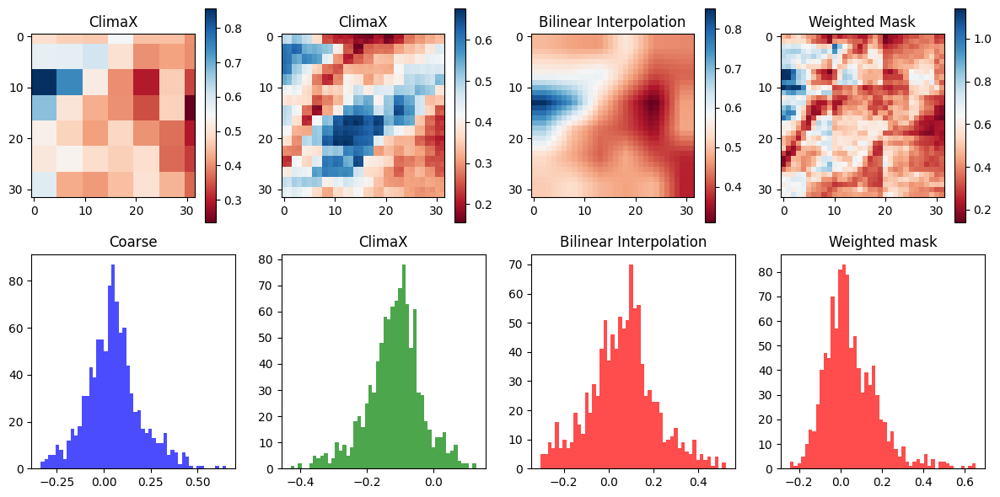

Time step 9
tensor(0.1401, device='cuda:0')


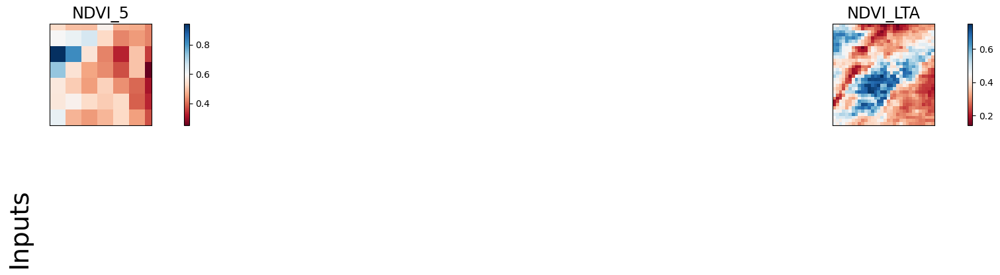

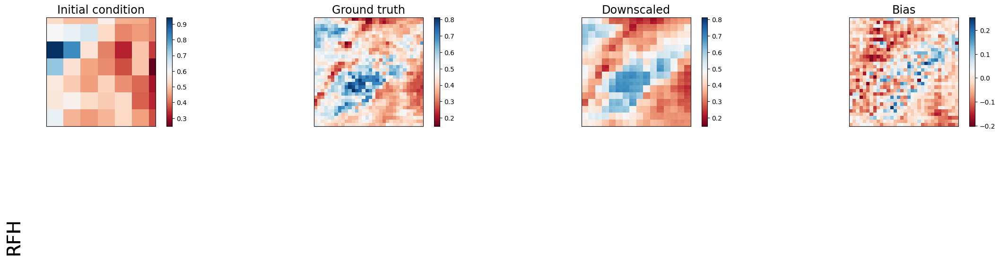

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+-----------------------+------------------------+------------------------+----------------------+
|                      | Coarse                | ClimaX                 | Bilinear Interpolation | Weighted Mask        |
+----------------------+-----------------------+------------------------+------------------------+----------------------+
| lat_weighted_mse_val | 0.056611884385347366  | 0.00536346435546875    | 0.02900850772857666    | 0.02172069624066353  |
| lat_weighted_rmse    | 0.031025812029838562  | 0.009549750946462154   | 0.022209156304597855   | 0.01921791397035122  |
| spearman             | 0.3206939929723183    | 0.8050371236096372     | 0.09333241344405167    | 0.7216370083016233   |
| mean_bias            | -0.025677114725112915 | -0.0025724470615386963 | 0.009473979473114014   | 0.007735103368759155 |
| pear

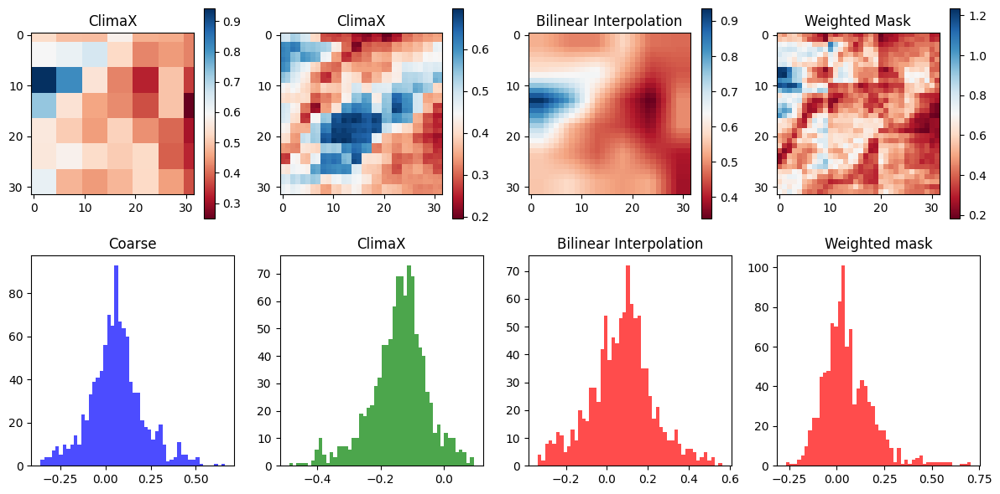

Time step 10
tensor(0.1766, device='cuda:0')


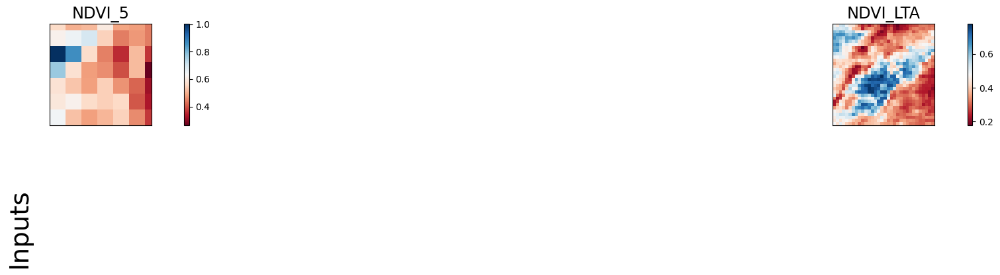

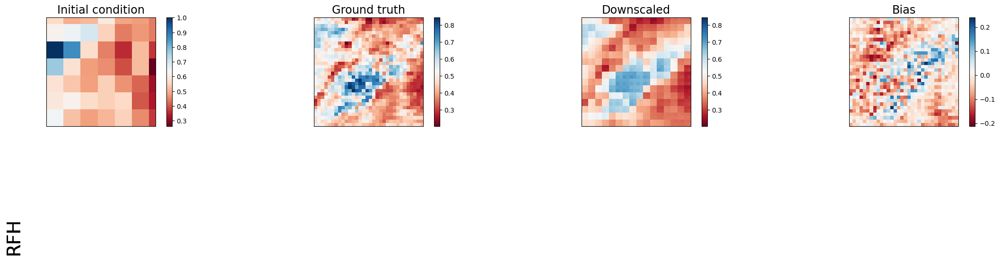

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+----------------------+-----------------------+------------------------+----------------------+
|                      | Coarse               | ClimaX                | Bilinear Interpolation | Weighted Mask        |
+----------------------+----------------------+-----------------------+------------------------+----------------------+
| lat_weighted_mse_val | 0.0689418613910675   | 0.005329927429556847  | 0.03112906776368618    | 0.023472860455513    |
| lat_weighted_rmse    | 0.03423819690942764  | 0.0095198480412364    | 0.023006601259112358   | 0.01997801847755909  |
| spearman             | 0.31809867199953196  | 0.802111103664314     | 0.11847554183064928    | 0.7330005053820191   |
| mean_bias            | -0.02904611825942993 | -0.002742171287536621 | 0.010328441858291626   | 0.008551537990570068 |
| pearson           

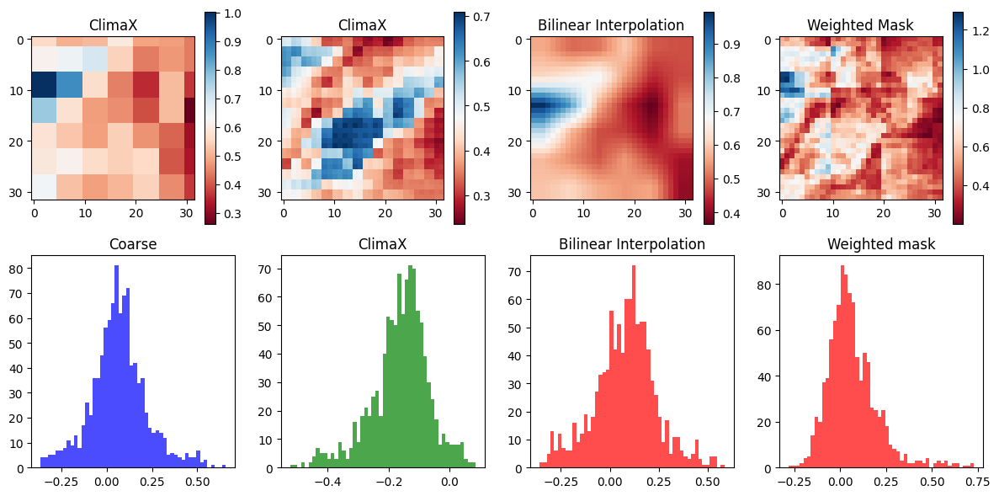

Time step 11
tensor(0.2105, device='cuda:0')


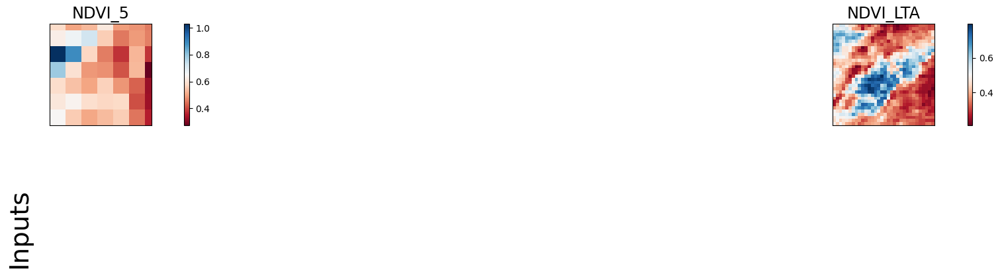

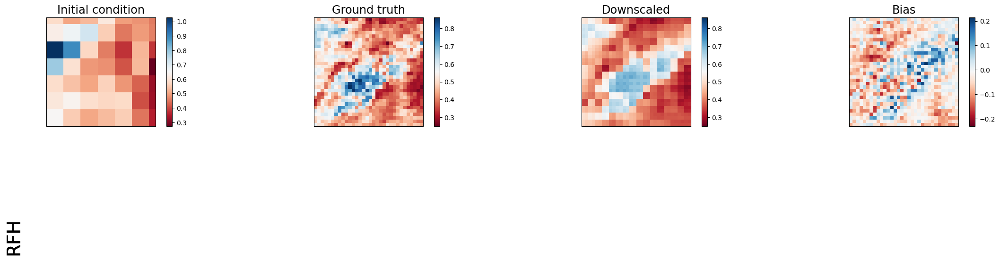

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+-----------------------+------------------------+------------------------+----------------------+
|                      | Coarse                | ClimaX                 | Bilinear Interpolation | Weighted Mask        |
+----------------------+-----------------------+------------------------+------------------------+----------------------+
| lat_weighted_mse_val | 0.0768059715628624    | 0.0052679600194096565  | 0.031501807272434235   | 0.023465830832719803 |
| lat_weighted_rmse    | 0.036138225346803665  | 0.009464345872402191   | 0.023143930360674858   | 0.019975027069449425 |
| spearman             | 0.31437650373825293   | 0.8055812744518049     | 0.143384513888716      | 0.7497031551894028   |
| mean_bias            | -0.031039953231811523 | -0.0028733909130096436 | 0.010730922222137451   | 0.008906304836273193 |
| pear

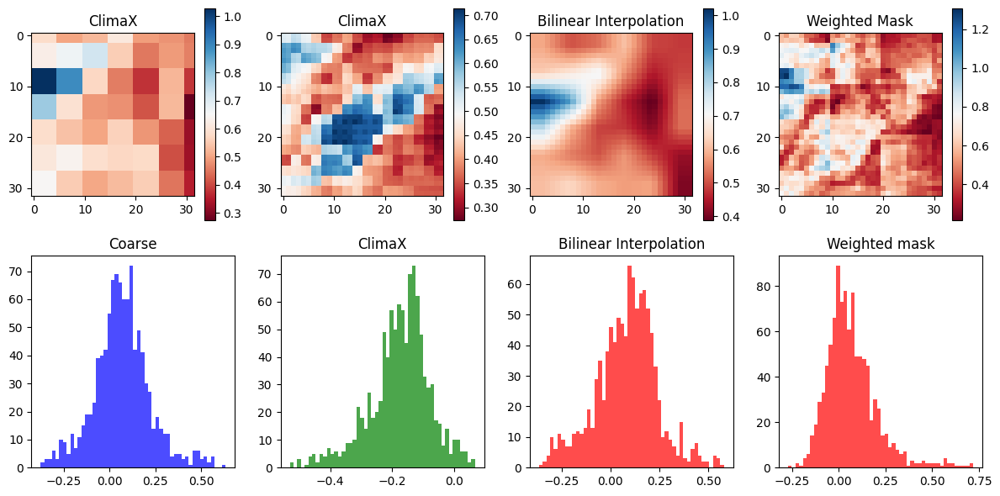

Time step 12
tensor(0.2204, device='cuda:0')


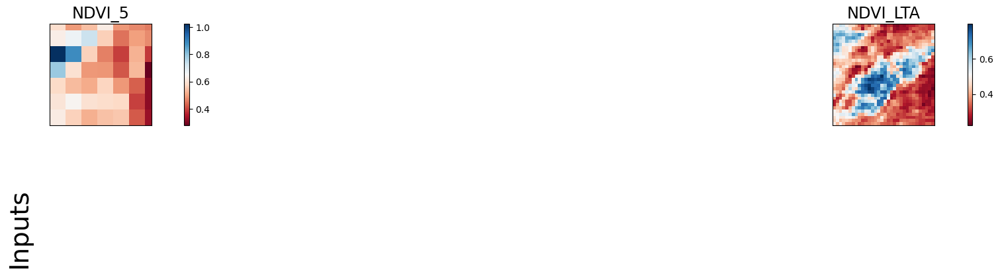

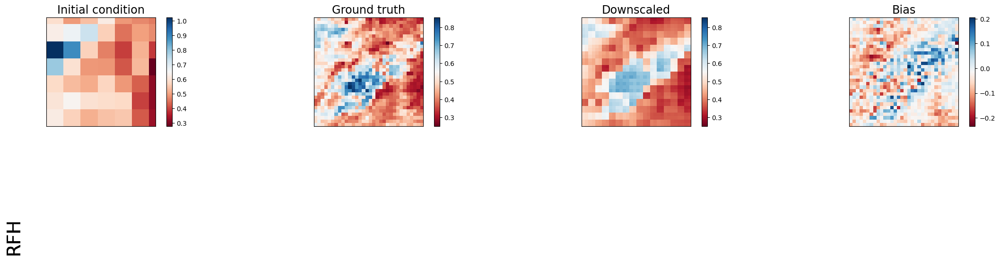

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+----------------------+-----------------------+------------------------+----------------------+
|                      | Coarse               | ClimaX                | Bilinear Interpolation | Weighted Mask        |
+----------------------+----------------------+-----------------------+------------------------+----------------------+
| lat_weighted_mse_val | 0.07702122628688812  | 0.0050788456574082375 | 0.030036304146051407   | 0.021591484546661377 |
| lat_weighted_rmse    | 0.03618883714079857  | 0.009292912669479847  | 0.022599175572395325   | 0.019160667434334755 |
| spearman             | 0.31233051823349206  | 0.8121988887839062    | 0.16065705884493714    | 0.7683116729050079   |
| mean_bias            | -0.03107514977455139 | -0.002874016761779785 | 0.010444223880767822   | 0.008513927459716797 |
| pearson           

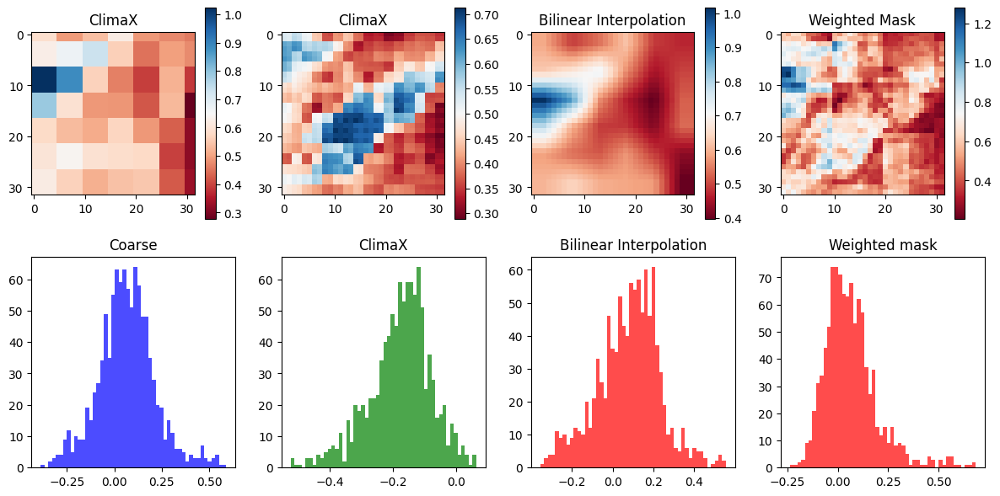

Time step 13
tensor(0.2211, device='cuda:0')


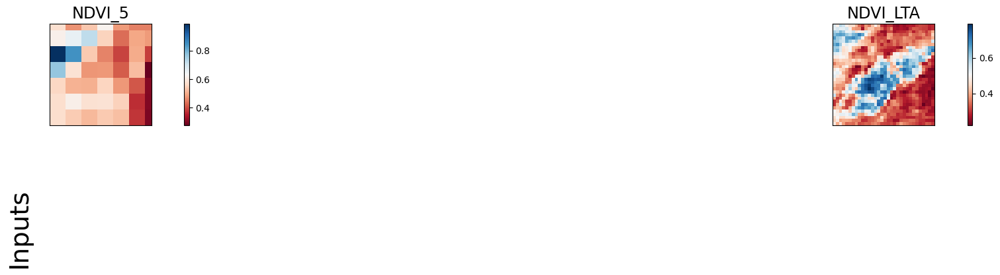

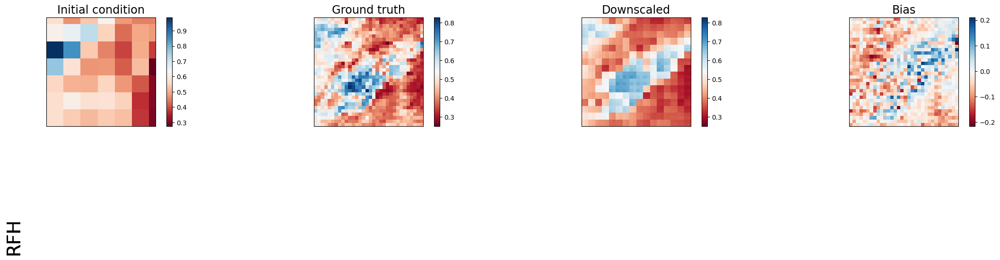

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+-----------------------+------------------------+------------------------+----------------------+
|                      | Coarse                | ClimaX                 | Bilinear Interpolation | Weighted Mask        |
+----------------------+-----------------------+------------------------+------------------------+----------------------+
| lat_weighted_mse_val | 0.06859488785266876   | 0.004695132374763489   | 0.027089091017842293   | 0.018293768167495728 |
| lat_weighted_rmse    | 0.03415192663669586   | 0.008934973739087582   | 0.02146182209253311    | 0.017636848613619804 |
| spearman             | 0.29047711590597      | 0.8260688377376271     | 0.16586586770538367    | 0.7851953843198719   |
| mean_bias            | -0.028844207525253296 | -0.0026682615280151367 | 0.009348899126052856   | 0.007234454154968262 |
| pear

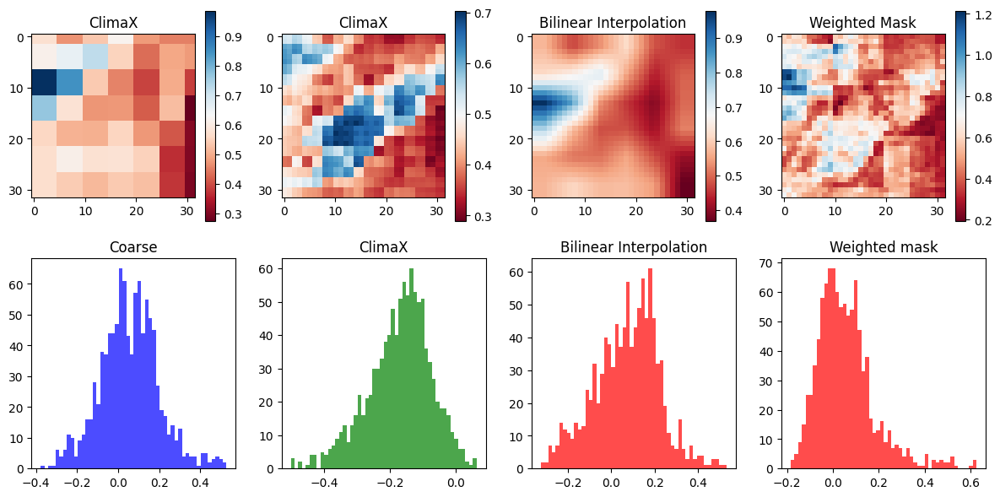

Time step 14
tensor(0.2117, device='cuda:0')


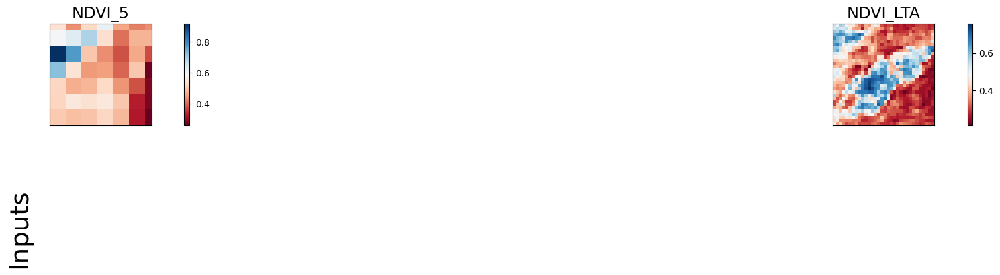

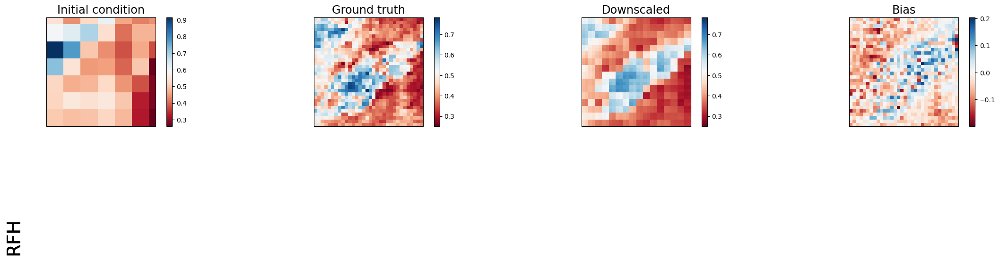

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+----------------------+-----------------------+------------------------+----------------------+
|                      | Coarse               | ClimaX                | Bilinear Interpolation | Weighted Mask        |
+----------------------+----------------------+-----------------------+------------------------+----------------------+
| lat_weighted_mse_val | 0.053507838398218155 | 0.004178243223577738  | 0.022938042879104614   | 0.014156109653413296 |
| lat_weighted_rmse    | 0.030163247138261795 | 0.00842880830168724   | 0.01974911242723465    | 0.015514628030359745 |
| spearman             | 0.2648826362514458   | 0.8393096536337629    | 0.16391442445722643    | 0.7932546203526224   |
| mean_bias            | -0.02444744110107422 | -0.002315908670425415 | 0.007486969232559204   | 0.005192369222640991 |
| pearson           

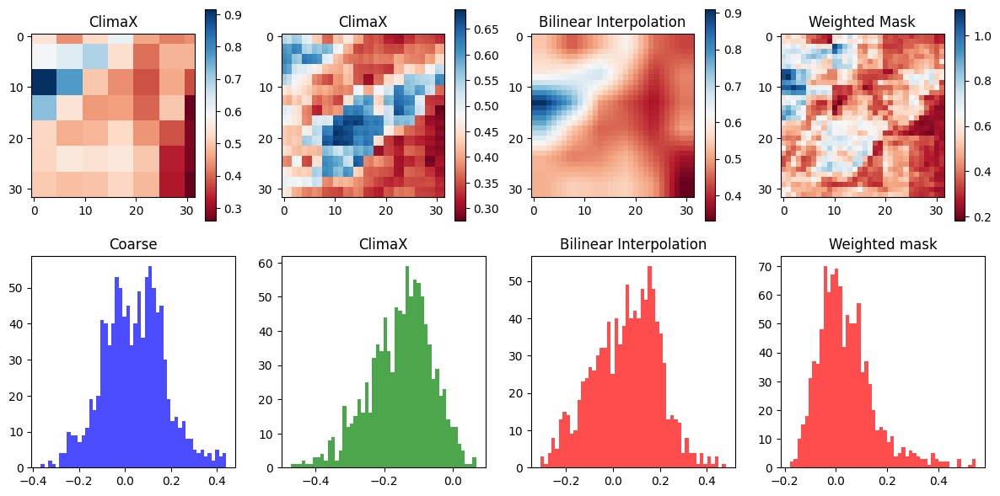

Time step 15
tensor(0.1942, device='cuda:0')


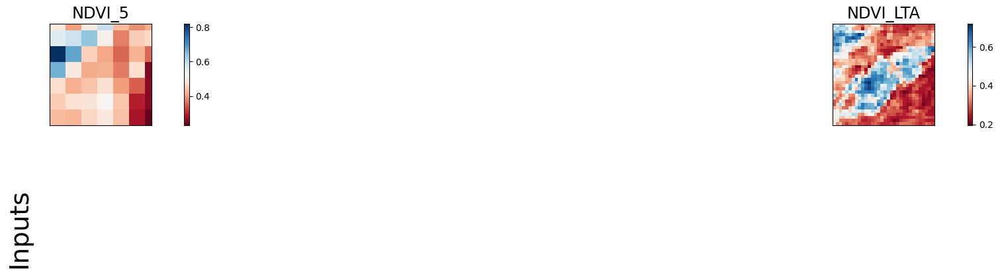

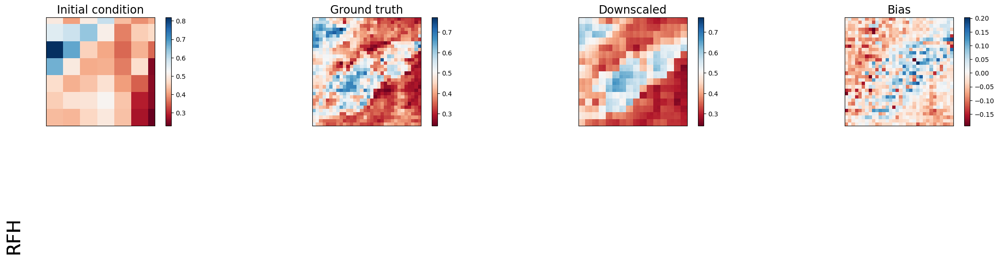

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+----------------------+-----------------------+------------------------+-----------------------+
|                      | Coarse               | ClimaX                | Bilinear Interpolation | Weighted Mask         |
+----------------------+----------------------+-----------------------+------------------------+-----------------------+
| lat_weighted_mse_val | 0.03779159486293793  | 0.0038096739444881678 | 0.018771862611174583   | 0.010621592402458191  |
| lat_weighted_rmse    | 0.025349361822009087 | 0.008048469200730324  | 0.017865825444459915   | 0.013438914902508259  |
| spearman             | 0.2188499788319075   | 0.8446477873403749    | 0.16092319982838854    | 0.7866233991845918    |
| mean_bias            | -0.01896563172340393 | -0.001994997262954712 | 0.005348086357116699   | 0.0030018985271453857 |
| pearson    

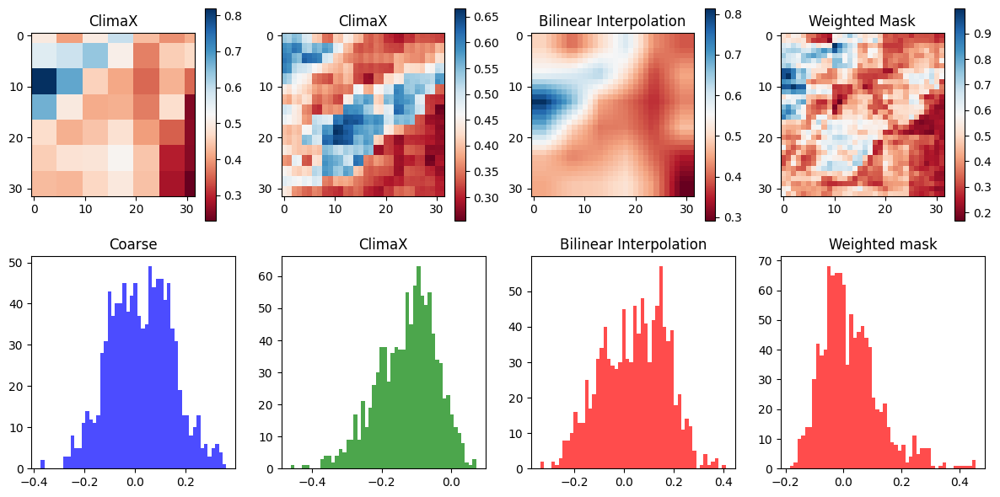

Time step 16
tensor(0.1779, device='cuda:0')


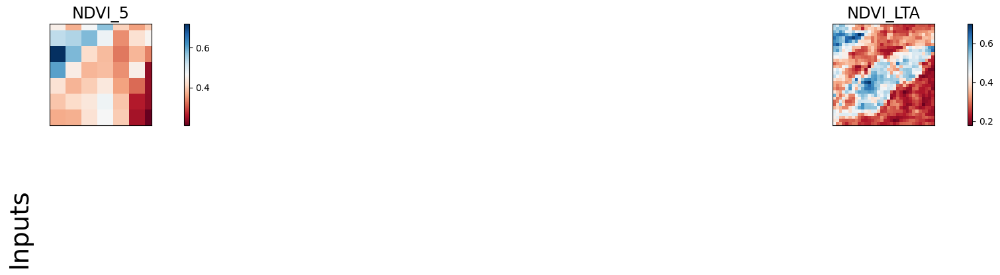

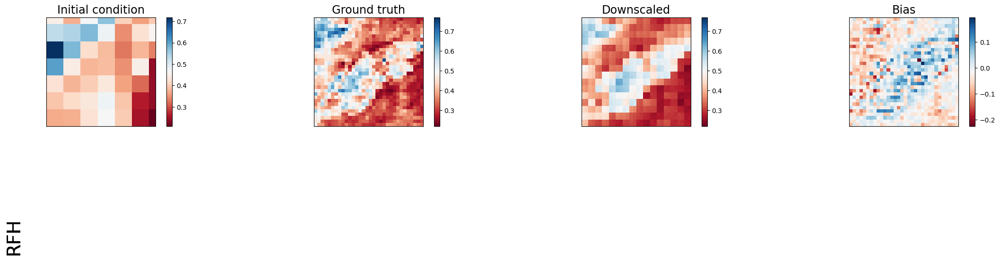

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+-----------------------+------------------------+------------------------+----------------------+
|                      | Coarse                | ClimaX                 | Bilinear Interpolation | Weighted Mask        |
+----------------------+-----------------------+------------------------+------------------------+----------------------+
| lat_weighted_mse_val | 0.0259286817163229    | 0.003411925630643964   | 0.015602956525981426   | 0.008333923295140266 |
| lat_weighted_rmse    | 0.02099711261689663   | 0.007616739720106125   | 0.016288189217448235   | 0.011904032900929451 |
| spearman             | 0.18884149130360559   | 0.8515790349197895     | 0.15161388495808384    | 0.7695445773641888   |
| mean_bias            | -0.013582438230514526 | -0.0016270279884338379 | 0.0033999979496002197  | 0.001162886619567871 |
| pear

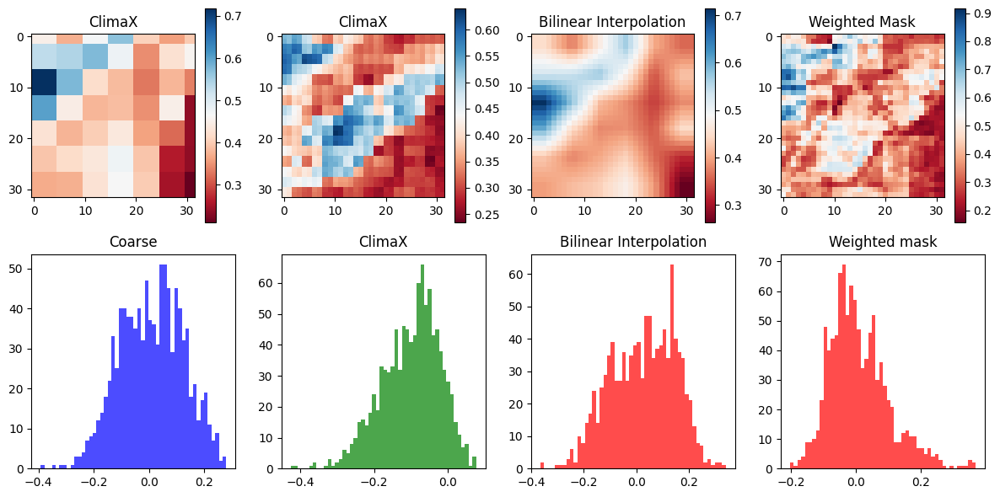

Time step 17
tensor(0.1652, device='cuda:0')


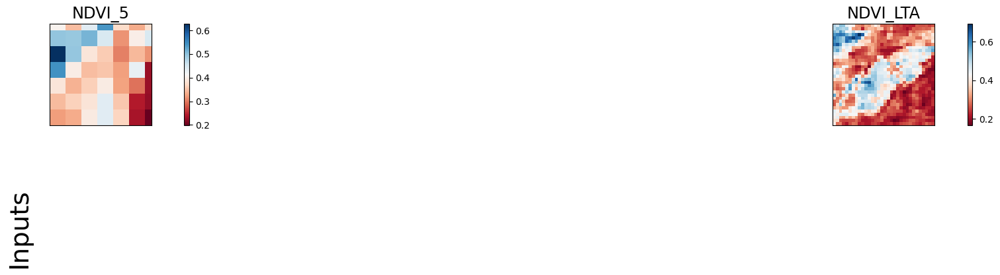

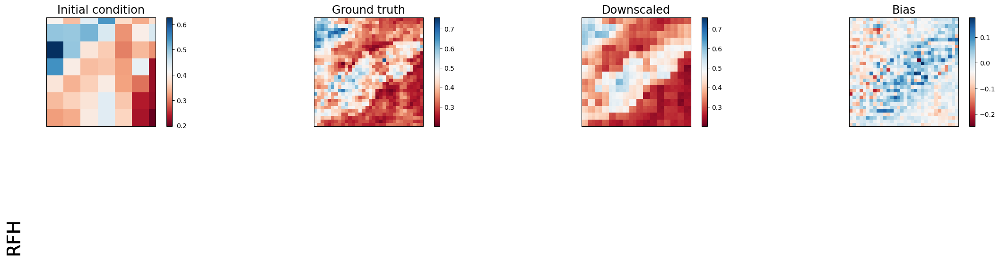

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+-----------------------+------------------------+------------------------+------------------------+
|                      | Coarse                | ClimaX                 | Bilinear Interpolation | Weighted Mask          |
+----------------------+-----------------------+------------------------+------------------------+------------------------+
| lat_weighted_mse_val | 0.0184190534055233    | 0.003151931334286928   | 0.013592712581157684   | 0.00712226890027523    |
| lat_weighted_rmse    | 0.017697136849164963  | 0.007320786360651255   | 0.015202760696411133   | 0.011004709638655186   |
| spearman             | 0.17450653990075482   | 0.8563841181884172     | 0.13799928232771985    | 0.7457152417157229     |
| mean_bias            | -0.008706480264663696 | -0.0014529526233673096 | 0.0017586350440979004  | -0.00024533271789

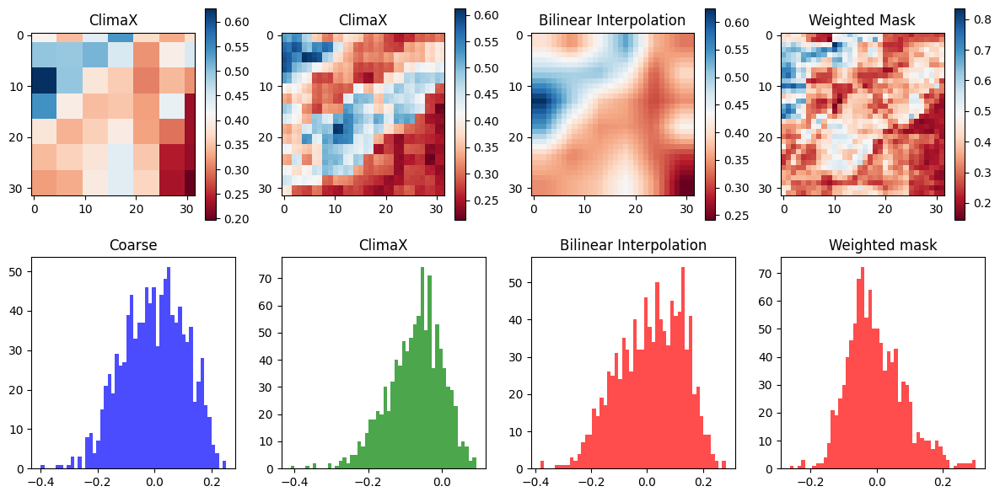

Time step 18
tensor(0.1560, device='cuda:0')


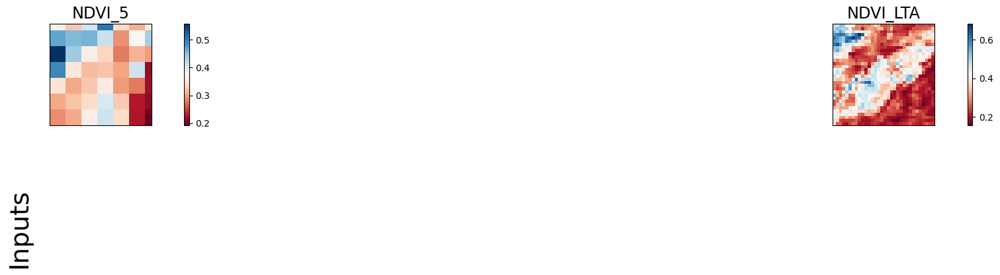

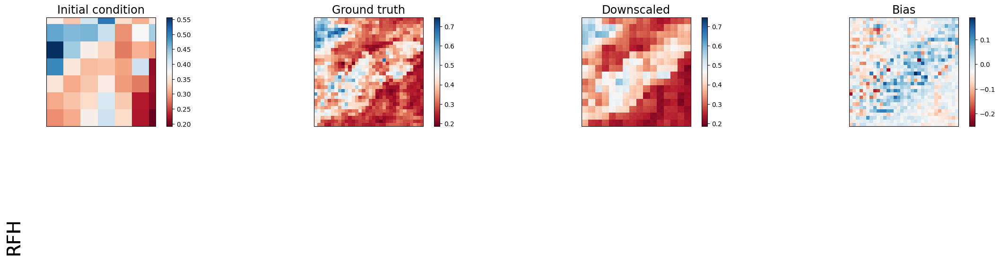

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+-----------------------+------------------------+------------------------+-----------------------+
|                      | Coarse                | ClimaX                 | Bilinear Interpolation | Weighted Mask         |
+----------------------+-----------------------+------------------------+------------------------+-----------------------+
| lat_weighted_mse_val | 0.01461146492511034   | 0.0029905824922025204  | 0.01262049563229084    | 0.006622562184929848  |
| lat_weighted_rmse    | 0.015762178227305412  | 0.007130947429686785   | 0.014648986980319023   | 0.010611636564135551  |
| spearman             | 0.16496377292931128   | 0.8604434790465764     | 0.1149855619190202     | 0.7174214974655189    |
| mean_bias            | -0.004709154367446899 | -0.0015680789947509766 | 0.000527501106262207   | -0.001194596290588379 |

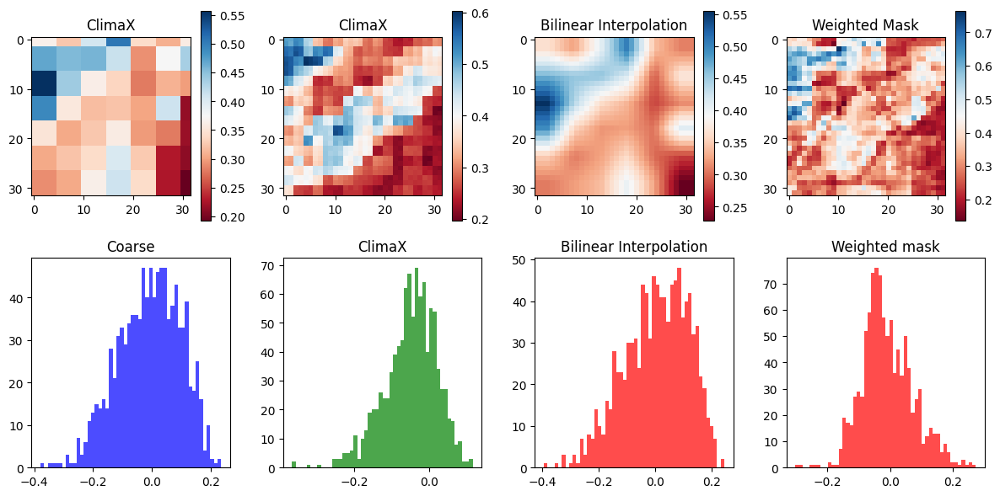

Time step 19
tensor(0.1480, device='cuda:0')


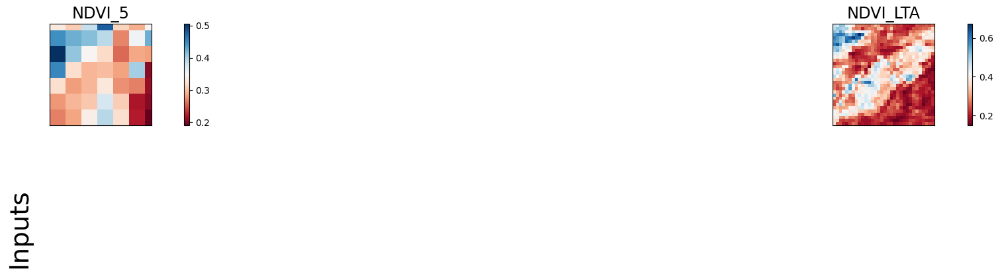

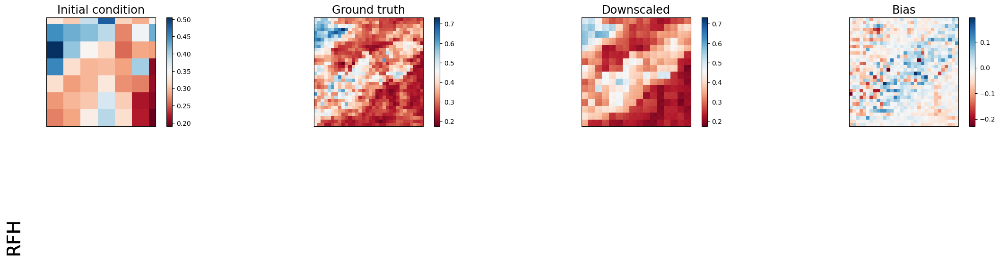

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+------------------------+------------------------+------------------------+------------------------+
|                      | Coarse                 | ClimaX                 | Bilinear Interpolation | Weighted Mask          |
+----------------------+------------------------+------------------------+------------------------+------------------------+
| lat_weighted_mse_val | 0.013186018913984299   | 0.00291573372669518    | 0.012322233989834785   | 0.006425363011658192   |
| lat_weighted_rmse    | 0.014973597601056099   | 0.0070411451160907745  | 0.014474849216639996   | 0.010452451184391975   |
| spearman             | 0.16178276800850117    | 0.861571219439557      | 0.08533548876521502    | 0.6928187179215193     |
| mean_bias            | -0.0016789734363555908 | -0.0017194747924804688 | -0.0002751350402832031 | -0.0017432

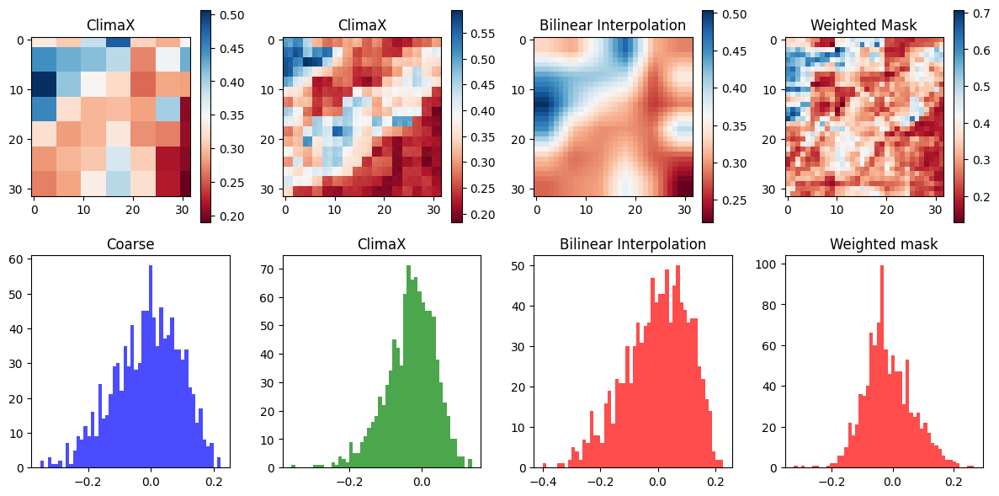

Time step 20
tensor(0.1405, device='cuda:0')


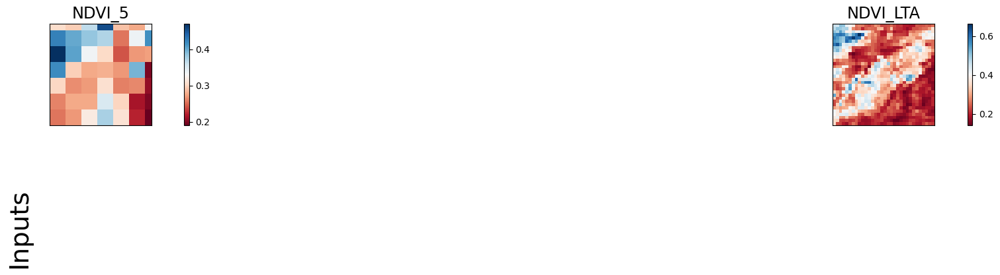

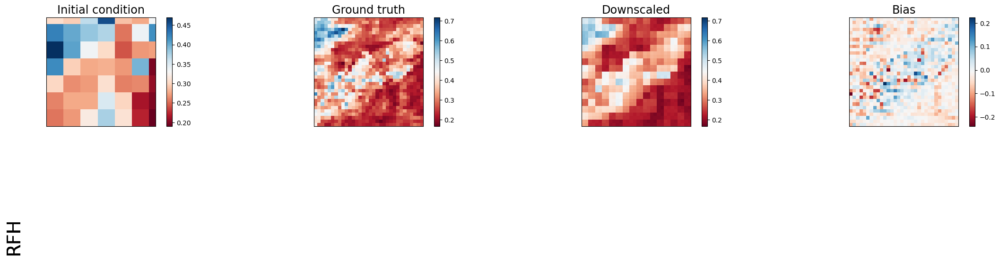

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+-----------------------+-----------------------+------------------------+------------------------+
|                      | Coarse                | ClimaX                | Bilinear Interpolation | Weighted Mask          |
+----------------------+-----------------------+-----------------------+------------------------+------------------------+
| lat_weighted_mse_val | 0.013036798685789108  | 0.0029369147960096598 | 0.012475015595555305   | 0.0064337849617004395  |
| lat_weighted_rmse    | 0.01488863117992878   | 0.007066672667860985  | 0.01456431020051241    | 0.010459300130605698   |
| spearman             | 0.14868484717335148   | 0.860856643121068     | 0.05088243805573293    | 0.6689803698428948     |
| mean_bias            | 0.0005168020725250244 | -0.001871645450592041 | -0.0007115006446838379 | -0.0019992589950561523 |

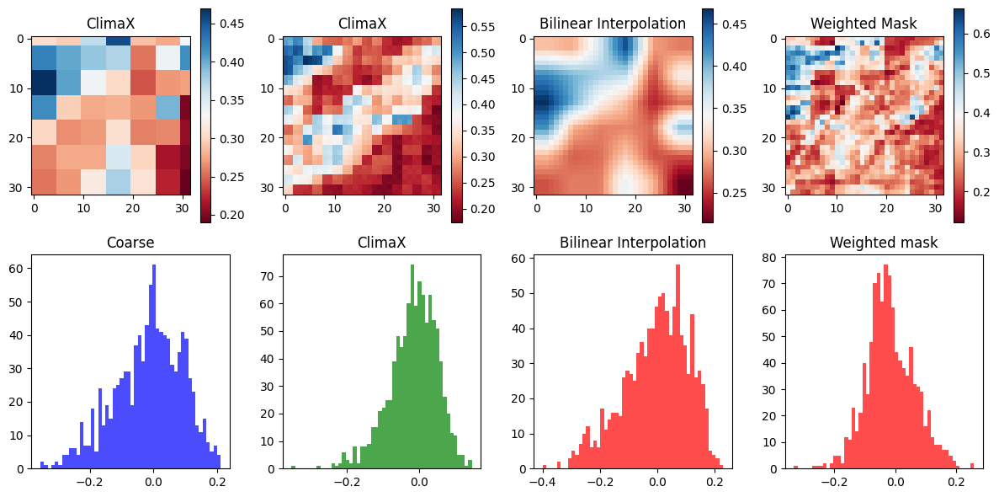

Time step 21
tensor(0.1351, device='cuda:0')


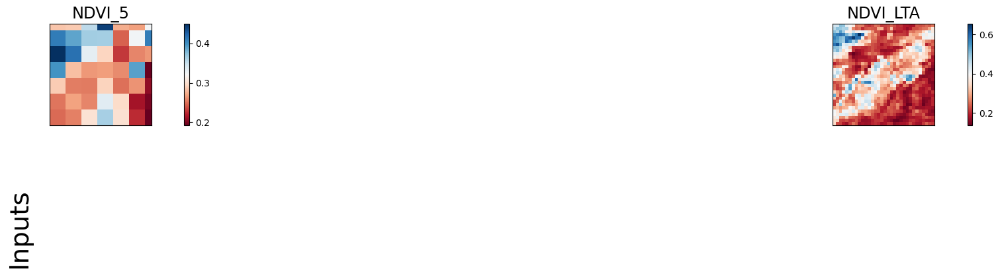

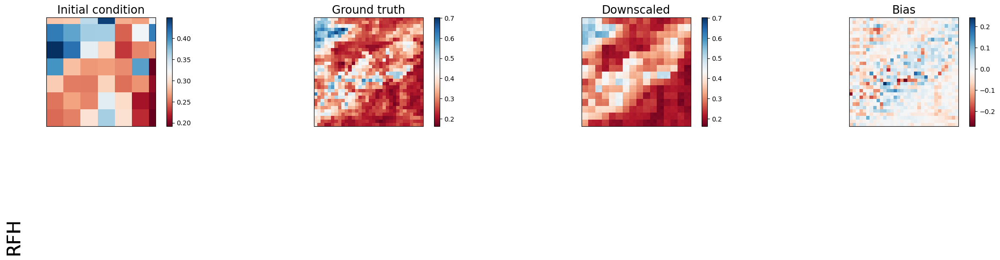

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+----------------------+-----------------------+------------------------+-----------------------+
|                      | Coarse               | ClimaX                | Bilinear Interpolation | Weighted Mask         |
+----------------------+----------------------+-----------------------+------------------------+-----------------------+
| lat_weighted_mse_val | 0.013459018431603909 | 0.003030942752957344  | 0.012941224500536919   | 0.006608480587601662  |
| lat_weighted_rmse    | 0.015127811580896378 | 0.007178905885666609  | 0.014833959750831127   | 0.010600348934531212  |
| spearman             | 0.11763408597393164  | 0.8580400985969902    | 0.01562268933543187    | 0.6498417983101485    |
| mean_bias            | 0.001836627721786499 | -0.001979261636734009 | -0.0008228421211242676 | -0.002040266990661621 |
| pearson    

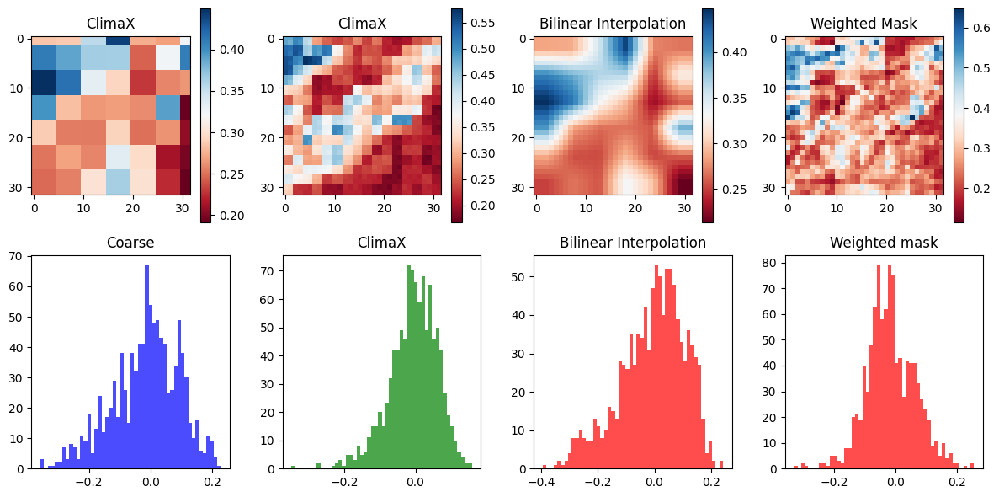

Time step 22
tensor(0.1316, device='cuda:0')


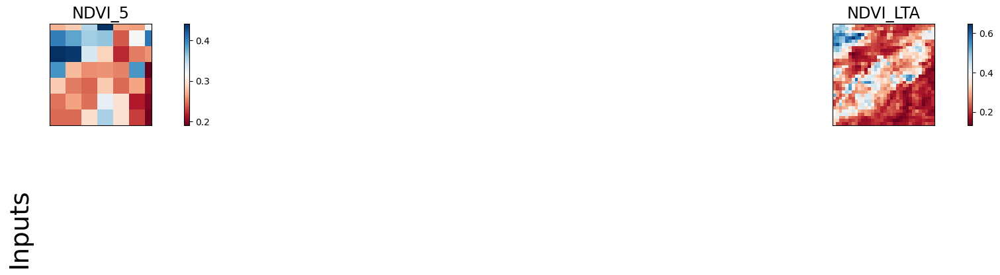

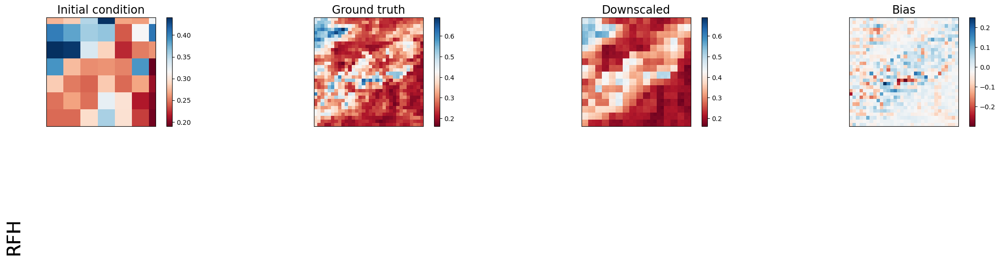

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+----------------------+-----------------------+------------------------+-----------------------+
|                      | Coarse               | ClimaX                | Bilinear Interpolation | Weighted Mask         |
+----------------------+----------------------+-----------------------+------------------------+-----------------------+
| lat_weighted_mse_val | 0.013988334685564041 | 0.0031360227148979902 | 0.01352945901453495    | 0.006871659308671951  |
| lat_weighted_rmse    | 0.015422413125634193 | 0.007302288431674242  | 0.01516734529286623    | 0.010809366591274738  |
| spearman             | 0.10699866155653812  | 0.8555065099215616    | -0.016723791990210752  | 0.6383792098615659    |
| mean_bias            | 0.002439171075820923 | -0.002081155776977539 | -0.0007281899452209473 | -0.001975834369659424 |
| pearson    

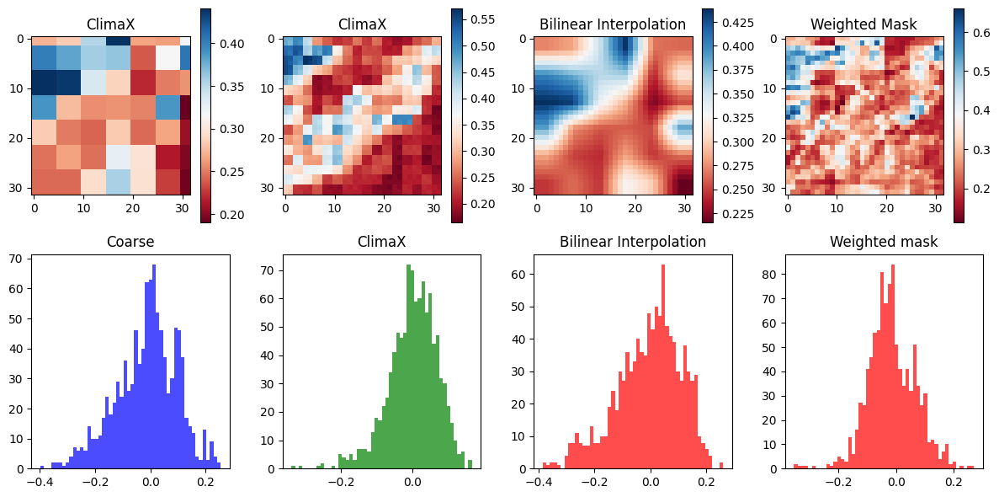

Time step 23
tensor(0.1292, device='cuda:0')


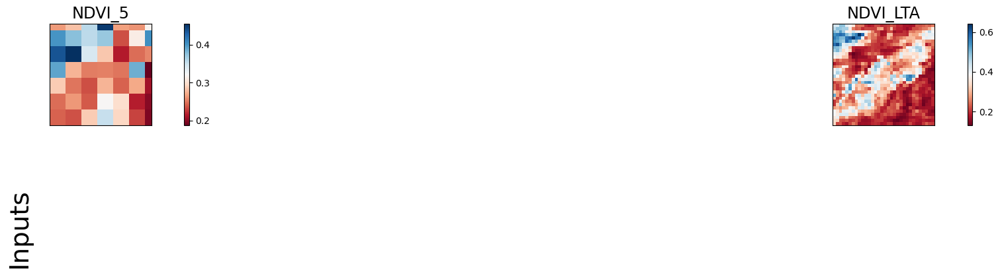

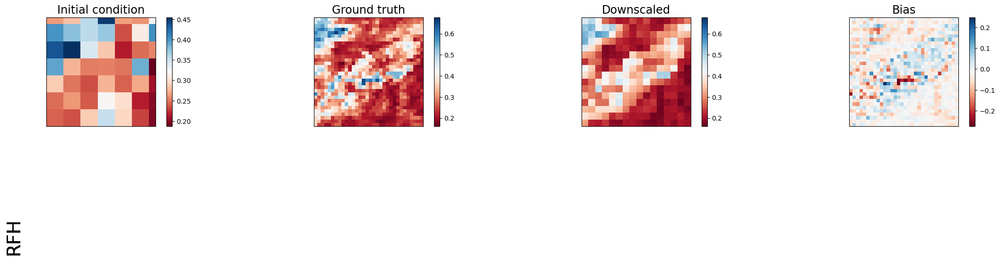

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+-----------------------+------------------------+------------------------+------------------------+
|                      | Coarse                | ClimaX                 | Bilinear Interpolation | Weighted Mask          |
+----------------------+-----------------------+------------------------+------------------------+------------------------+
| lat_weighted_mse_val | 0.014507193118333817  | 0.003208512905985117   | 0.014171656221151352   | 0.007212841883301735   |
| lat_weighted_rmse    | 0.015705836936831474  | 0.007386204320937395   | 0.015523144975304604   | 0.011074461042881012   |
| spearman             | 0.1032335945074947    | 0.8548243130611967     | -0.04266820997129649   | 0.6320433640316072     |
| mean_bias            | 0.0026528537273406982 | -0.0021760165691375732 | -0.0005556941032409668 | -0.00191372632980

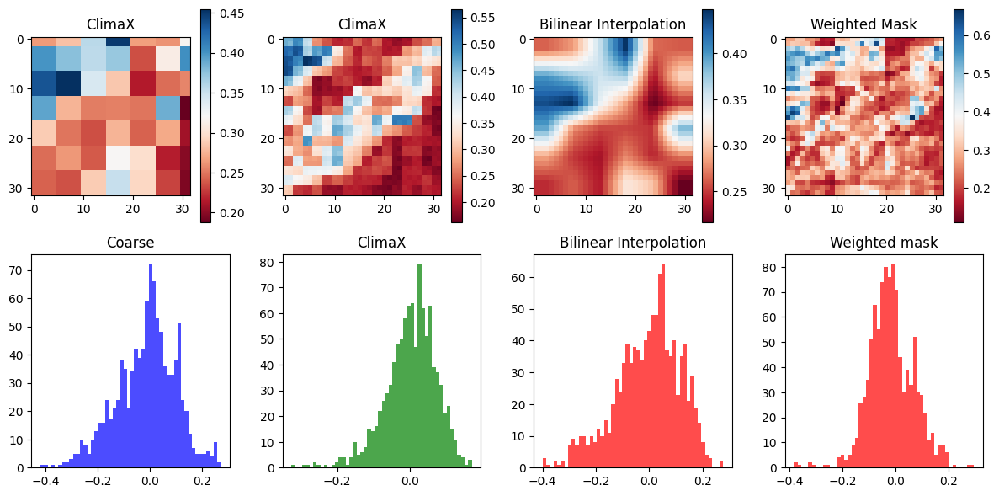

Time step 24
tensor(0.1275, device='cuda:0')


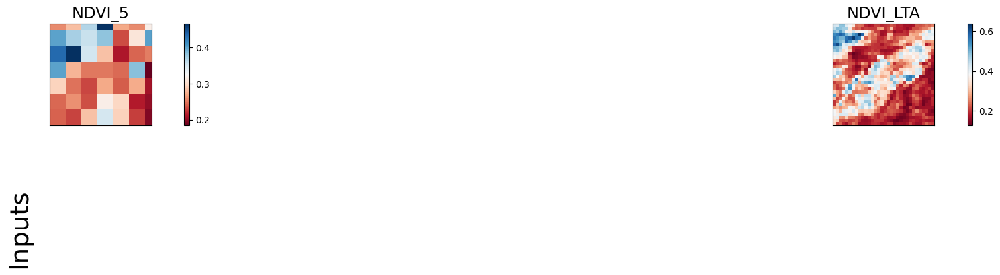

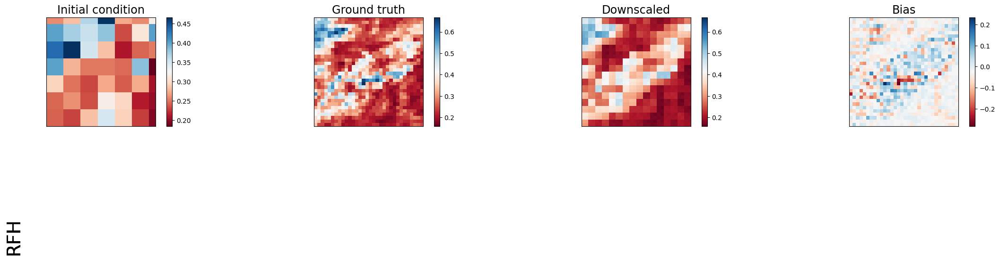

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+----------------------+-----------------------+------------------------+------------------------+
|                      | Coarse               | ClimaX                | Bilinear Interpolation | Weighted Mask          |
+----------------------+----------------------+-----------------------+------------------------+------------------------+
| lat_weighted_mse_val | 0.014968478120863438 | 0.0032730940729379654 | 0.014978486113250256   | 0.007711236365139484   |
| lat_weighted_rmse    | 0.015953581780195236 | 0.00746016763150692   | 0.015958912670612335   | 0.011450682766735554   |
| spearman             | 0.10270583541183465  | 0.8566664018913981    | -0.06059215133193934   | 0.6282309569724706     |
| mean_bias            | 0.002682596445083618 | -0.002225130796432495 | -0.0004514157772064209 | -0.0019702911376953125 |
| pear

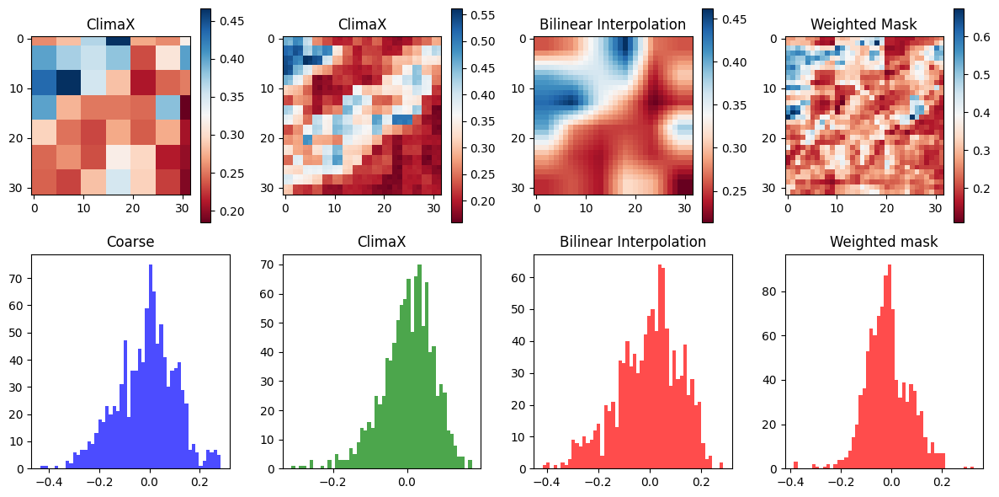

Time step 25
tensor(0.1264, device='cuda:0')


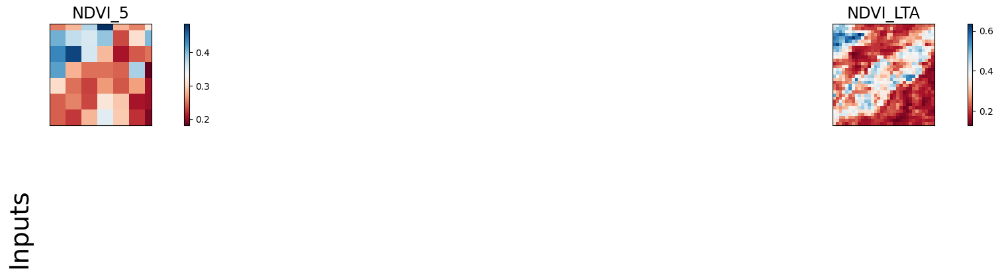

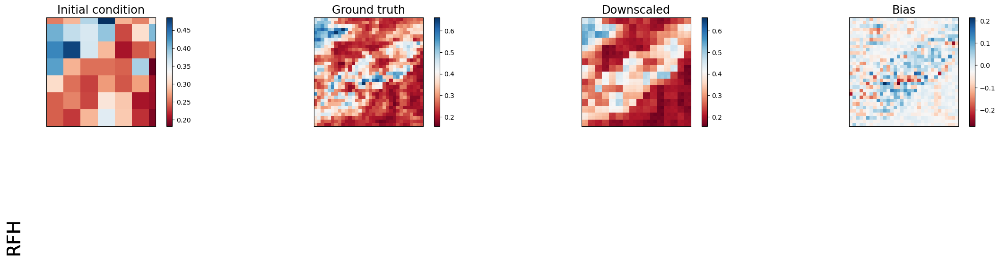

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+-----------------------+------------------------+------------------------+-----------------------+
|                      | Coarse                | ClimaX                 | Bilinear Interpolation | Weighted Mask         |
+----------------------+-----------------------+------------------------+------------------------+-----------------------+
| lat_weighted_mse_val | 0.015360603109002113  | 0.0033849249593913555  | 0.01596296951174736    | 0.00837278738617897   |
| lat_weighted_rmse    | 0.016161197796463966  | 0.007586543448269367   | 0.016475031152367592   | 0.01193175744265318   |
| spearman             | 0.10546168518629846   | 0.8575939447516496     | -0.06869763099885791   | 0.6251933065546895    |
| mean_bias            | 0.0025974512100219727 | -0.0022930502891540527 | -0.0004242360591888428 | -0.002111375331878662 |

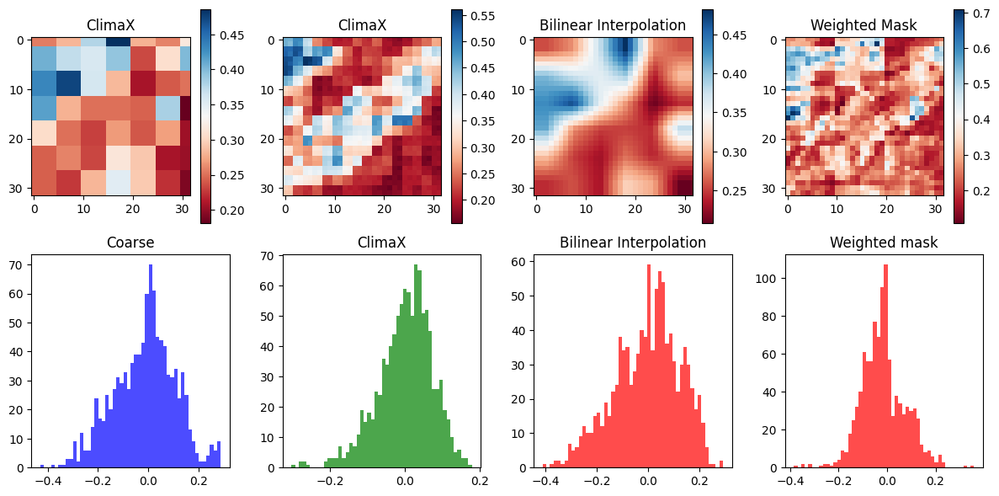

Time step 26
tensor(0.1261, device='cuda:0')


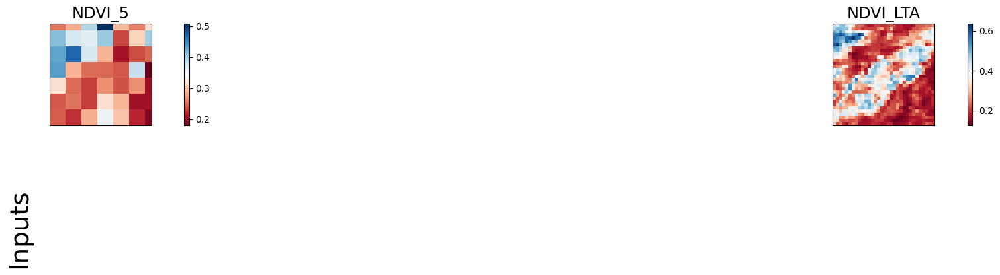

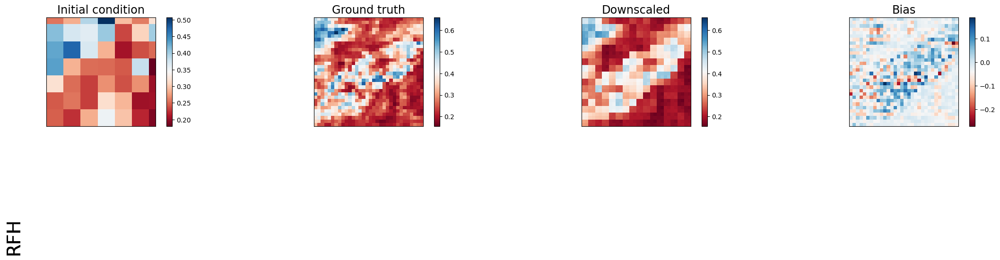

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+-----------------------+------------------------+------------------------+------------------------+
|                      | Coarse                | ClimaX                 | Bilinear Interpolation | Weighted Mask          |
+----------------------+-----------------------+------------------------+------------------------+------------------------+
| lat_weighted_mse_val | 0.015649572014808655  | 0.0035621407441794872  | 0.017100103199481964   | 0.009141242131590843   |
| lat_weighted_rmse    | 0.016312504187226295  | 0.007782603148370981   | 0.01705174148082733    | 0.012467287480831146   |
| spearman             | 0.10631400092712903   | 0.8588034691858046     | -0.07135817792434226   | 0.6224733768410556     |
| mean_bias            | 0.0023187100887298584 | -0.0024234652519226074 | -0.0004081130027770996 | -0.00224298238754

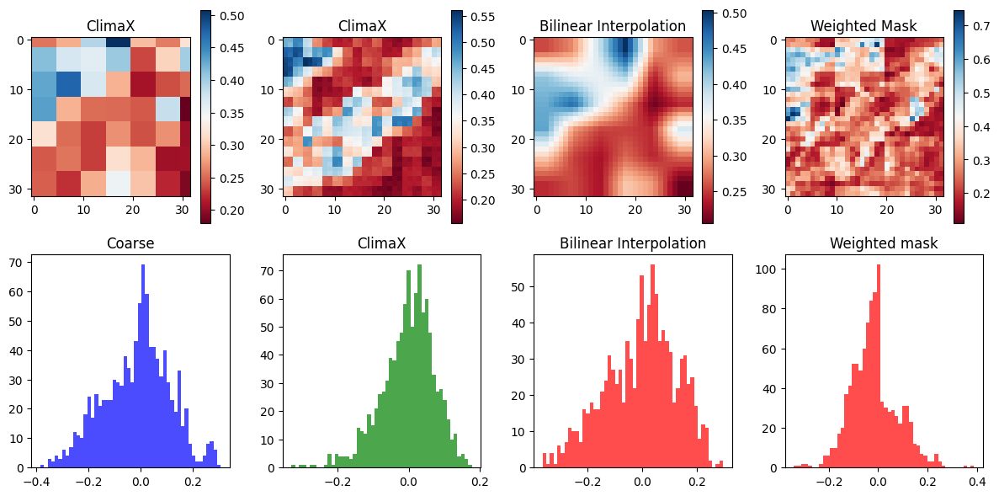

Time step 27
tensor(0.1266, device='cuda:0')


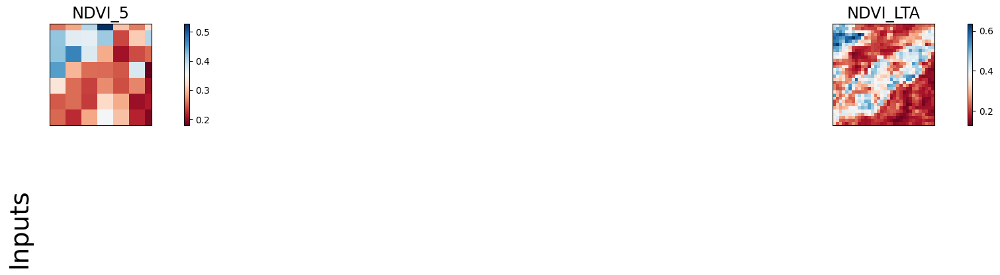

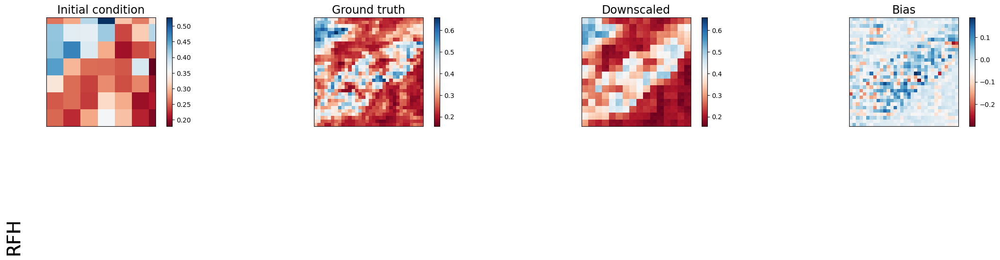

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+----------------------+-----------------------+-------------------------+------------------------+
|                      | Coarse               | ClimaX                | Bilinear Interpolation  | Weighted Mask          |
+----------------------+----------------------+-----------------------+-------------------------+------------------------+
| lat_weighted_mse_val | 0.0157729871571064   | 0.003704279428347945  | 0.018098752945661545    | 0.009794783778488636   |
| lat_weighted_rmse    | 0.01637669838964939  | 0.007936358451843262  | 0.017542589455842972    | 0.012905261479318142   |
| spearman             | 0.10555160301657526  | 0.8612288626019922    | -0.0710237364152798     | 0.6199648053385484     |
| mean_bias            | 0.001813054084777832 | -0.002549111843109131 | -0.00035521388053894043 | -0.0022755861282348633 |

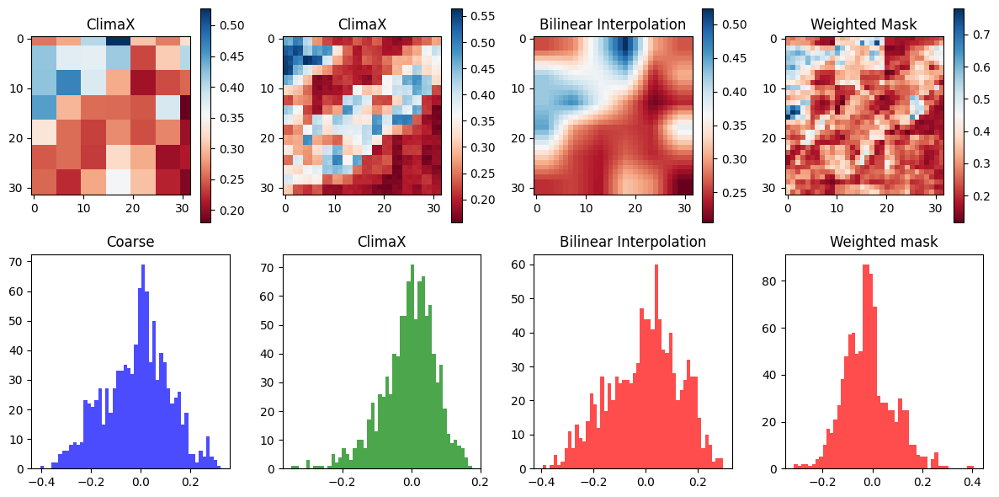

Time step 28
tensor(0.1284, device='cuda:0')


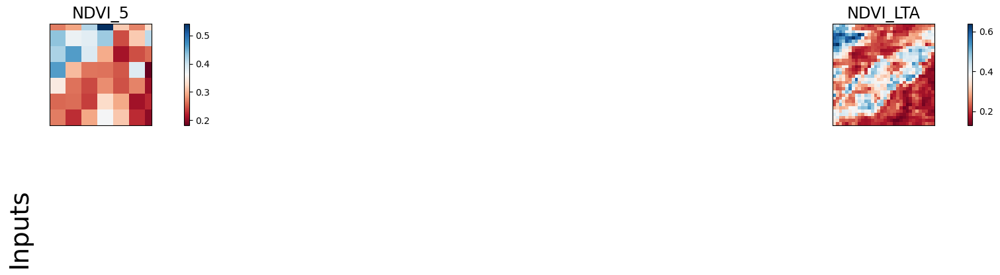

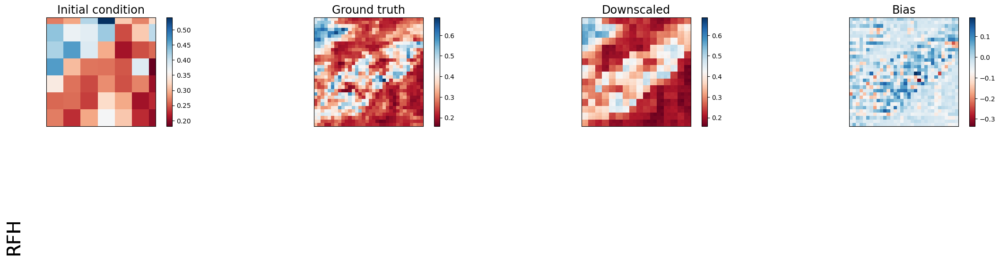

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+-----------------------+-----------------------+------------------------+------------------------+
|                      | Coarse                | ClimaX                | Bilinear Interpolation | Weighted Mask          |
+----------------------+-----------------------+-----------------------+------------------------+------------------------+
| lat_weighted_mse_val | 0.015641454607248306  | 0.0036644022911787033 | 0.018396729603409767   | 0.009966450743377209   |
| lat_weighted_rmse    | 0.016308268532156944  | 0.007893524132668972  | 0.01768640987575054    | 0.013017862103879452   |
| spearman             | 0.09950186257732117   | 0.863674064351105     | -0.06761666551795656   | 0.6173696031058091     |
| mean_bias            | 0.0010067224502563477 | -0.002586275339126587 | -0.0002275407314300537 | -0.0021168291568756104 |

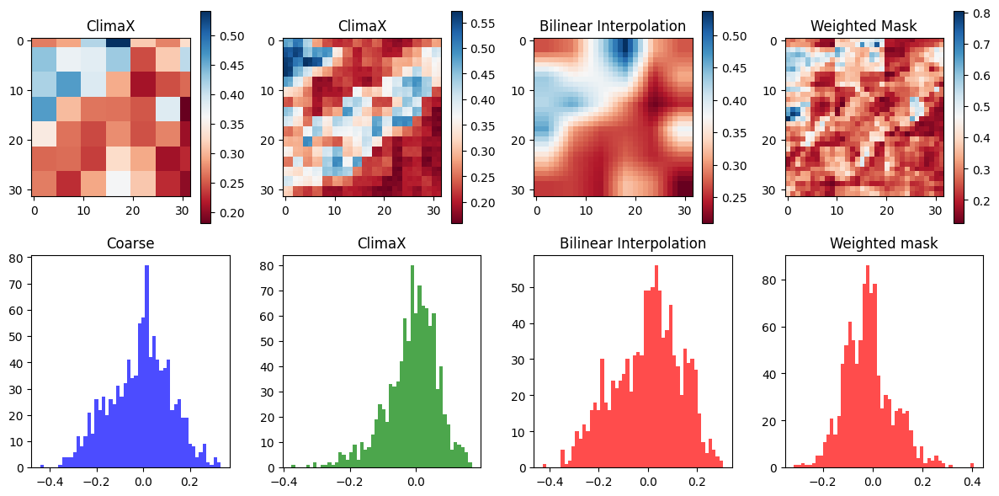

Time step 29
tensor(0.1318, device='cuda:0')


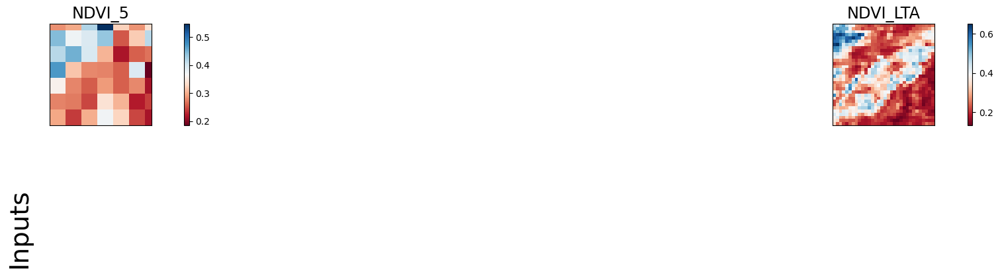

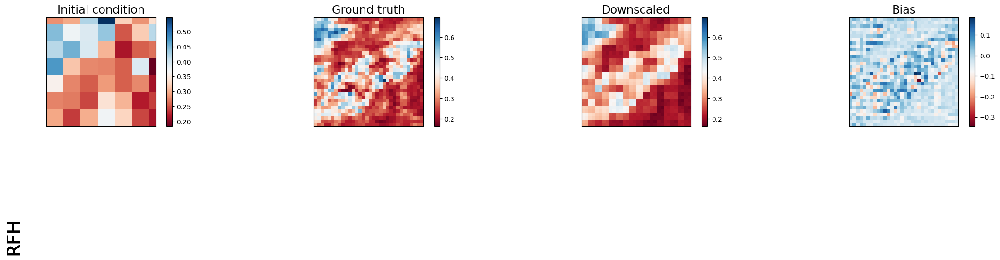

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+------------------------+-----------------------+------------------------+-----------------------+
|                      | Coarse                 | ClimaX                | Bilinear Interpolation | Weighted Mask         |
+----------------------+------------------------+-----------------------+------------------------+-----------------------+
| lat_weighted_mse_val | 0.015278801321983337   | 0.003467281349003315  | 0.017796441912651062   | 0.009527826681733131  |
| lat_weighted_rmse    | 0.016118107363581657   | 0.007678280118852854  | 0.017395460978150368   | 0.012728179804980755  |
| spearman             | 0.1012283233452627     | 0.8643889468754026    | -0.06402220873432332   | 0.6167927481857759    |
| mean_bias            | -0.0003180205821990967 | -0.002561420202255249 | 4.774332046508789e-05  | -0.001673579216003418 |

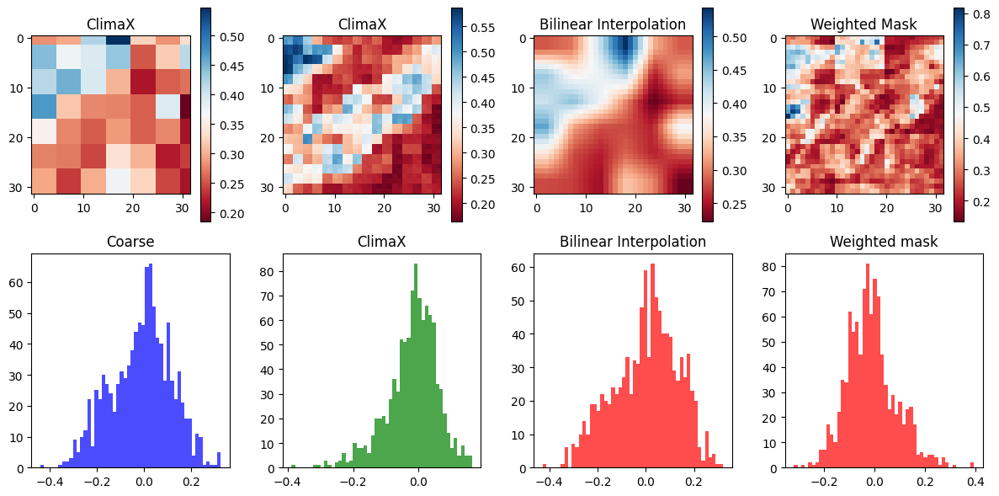

Time step 30
tensor(0.1370, device='cuda:0')


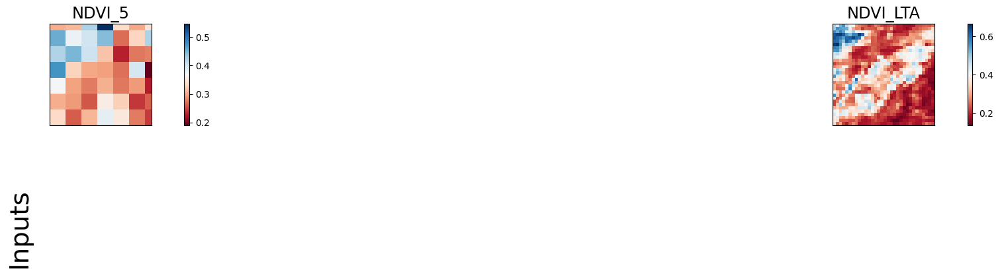

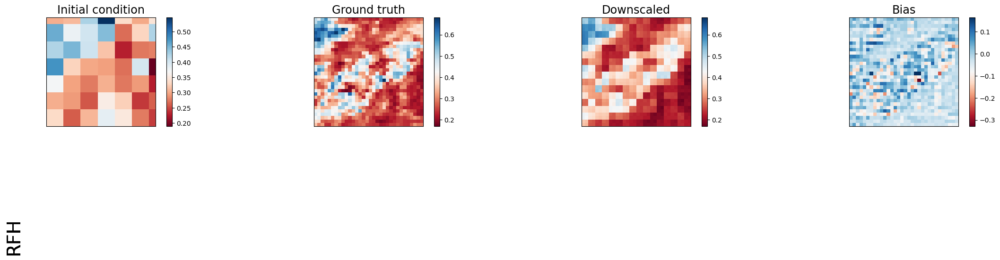

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+------------------------+------------------------+------------------------+------------------------+
|                      | Coarse                 | ClimaX                 | Bilinear Interpolation | Weighted Mask          |
+----------------------+------------------------+------------------------+------------------------+------------------------+
| lat_weighted_mse_val | 0.014959372580051422   | 0.0032779620960354805  | 0.01646805927157402    | 0.008671395480632782   |
| lat_weighted_rmse    | 0.01594872958958149    | 0.007465714123100042   | 0.016733646392822266   | 0.012142661027610302   |
| spearman             | 0.12198961012178465    | 0.862442748507245      | -0.05796900436658247   | 0.6173190998221827     |
| mean_bias            | -0.0021989643573760986 | -0.0026077330112457275 | 0.0005039870738983154  | -0.0009305

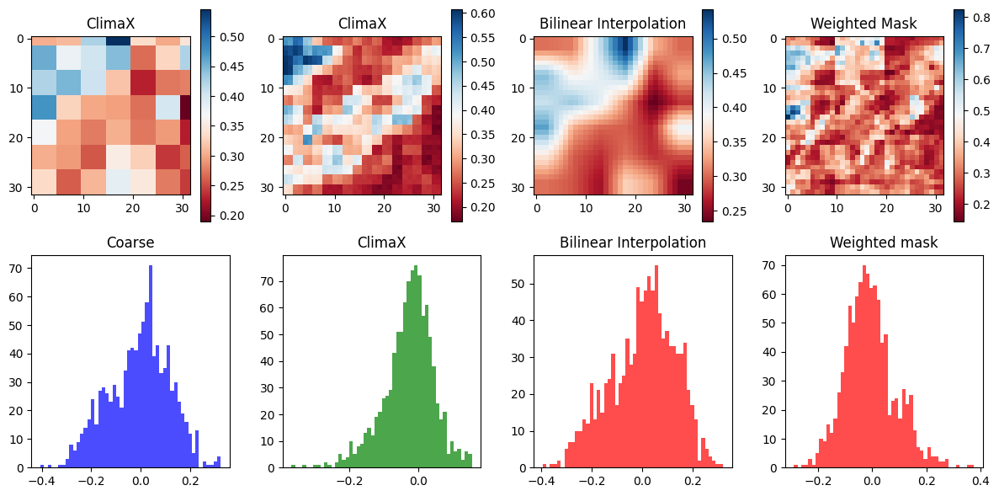

Time step 31
tensor(0.1435, device='cuda:0')


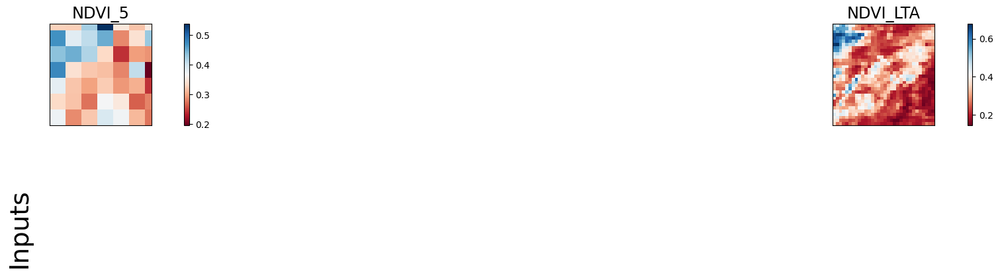

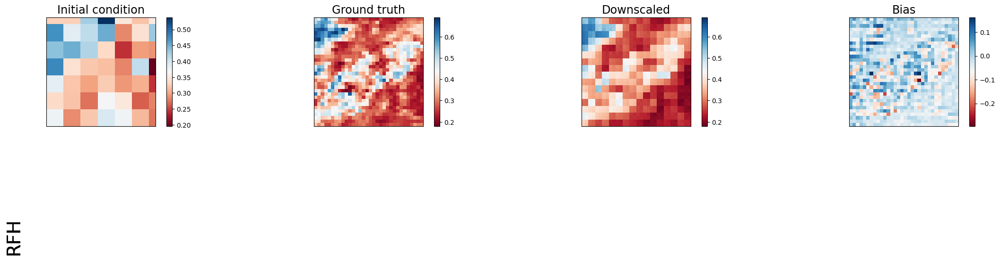

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+-----------------------+-----------------------+------------------------+------------------------+
|                      | Coarse                | ClimaX                | Bilinear Interpolation | Weighted Mask          |
+----------------------+-----------------------+-----------------------+------------------------+------------------------+
| lat_weighted_mse_val | 0.015006253495812416  | 0.003179796040058136  | 0.014703825116157532   | 0.0076924096792936325  |
| lat_weighted_rmse    | 0.01597370021045208   | 0.007353075779974461  | 0.015811918303370476   | 0.011436696164309978   |
| spearman             | 0.14777392382867452   | 0.8543282083537614    | -0.042863490417826514  | 0.616120939149225      |
| mean_bias            | -0.004355251789093018 | -0.002715378999710083 | 0.0010960400104522705  | -4.291534423828125e-06 |

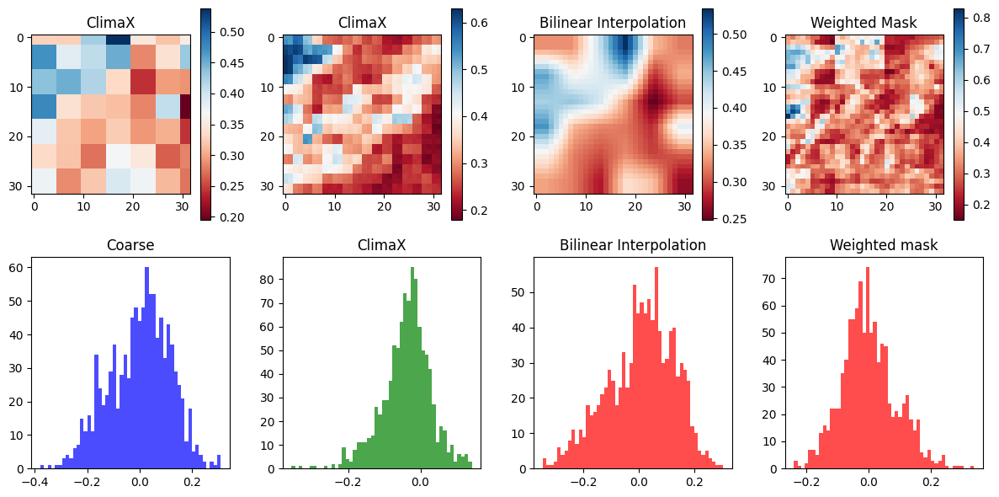

Time step 32
tensor(0.1490, device='cuda:0')


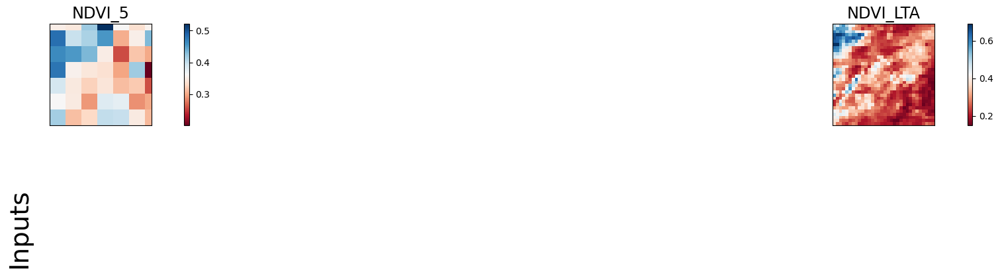

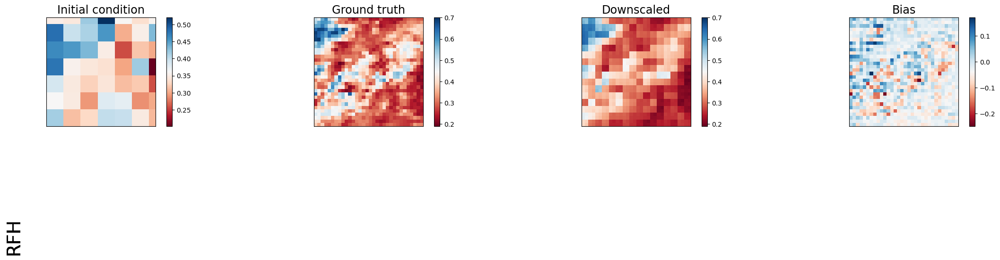

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+------------------------+-----------------------+------------------------+----------------------+
|                      | Coarse                 | ClimaX                | Bilinear Interpolation | Weighted Mask        |
+----------------------+------------------------+-----------------------+------------------------+----------------------+
| lat_weighted_mse_val | 0.015531862154603004   | 0.0031046196818351746 | 0.012789960950613022   | 0.006808333098888397 |
| lat_weighted_rmse    | 0.01625104248523712    | 0.007265635300427675  | 0.014747010543942451   | 0.010759442113339901 |
| spearman             | 0.17650924233846854    | 0.8395872408600209    | -0.016225953081000586  | 0.6206284777893941   |
| mean_bias            | -0.0065393149852752686 | -0.002805173397064209 | 0.0017828941345214844  | 0.001009225845336914 |
| pear

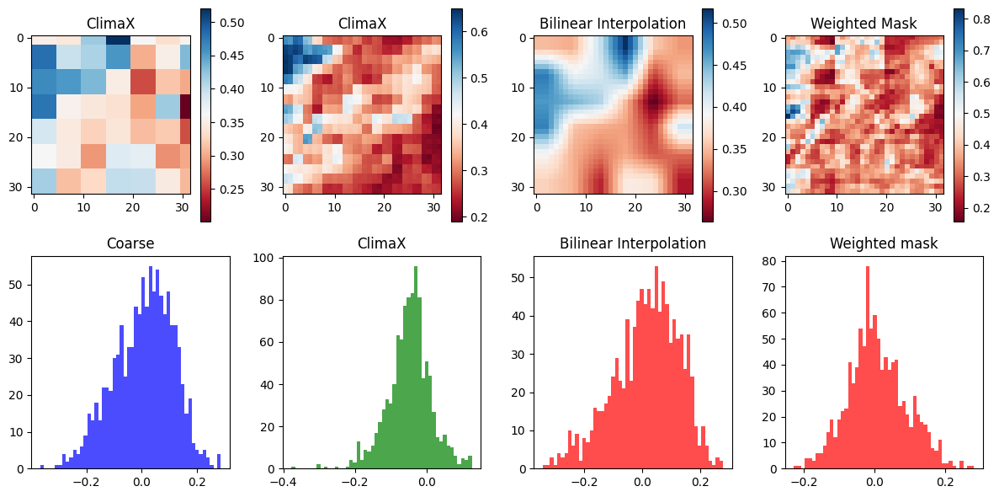

Time step 33
tensor(0.1521, device='cuda:0')


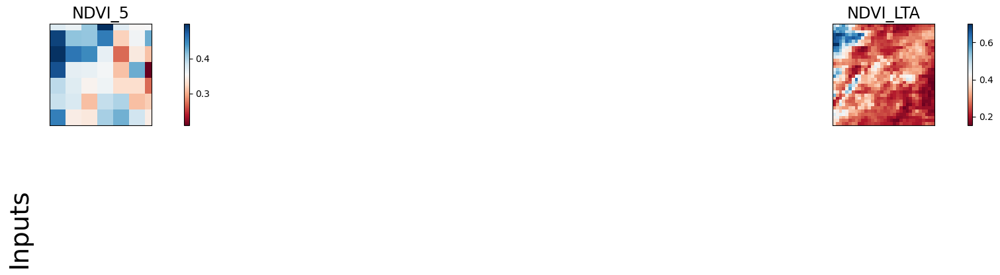

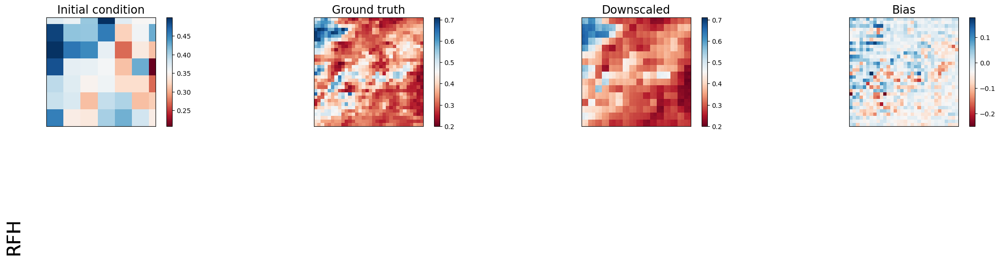

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+-----------------------+------------------------+------------------------+-----------------------+
|                      | Coarse                | ClimaX                 | Bilinear Interpolation | Weighted Mask         |
+----------------------+-----------------------+------------------------+------------------------+-----------------------+
| lat_weighted_mse_val | 0.016574006527662277  | 0.0030206094961613417  | 0.011350076645612717   | 0.0063930898904800415 |
| lat_weighted_rmse    | 0.016787389293313026  | 0.007166658062487841   | 0.013892128132283688   | 0.010426169261336327  |
| spearman             | 0.2233446852239796    | 0.8210746714601105     | 0.026483171832126017   | 0.6395522872106048    |
| mean_bias            | -0.008576273918151855 | -0.0028141140937805176 | 0.002510637044906616   | 0.0020389556884765625 |

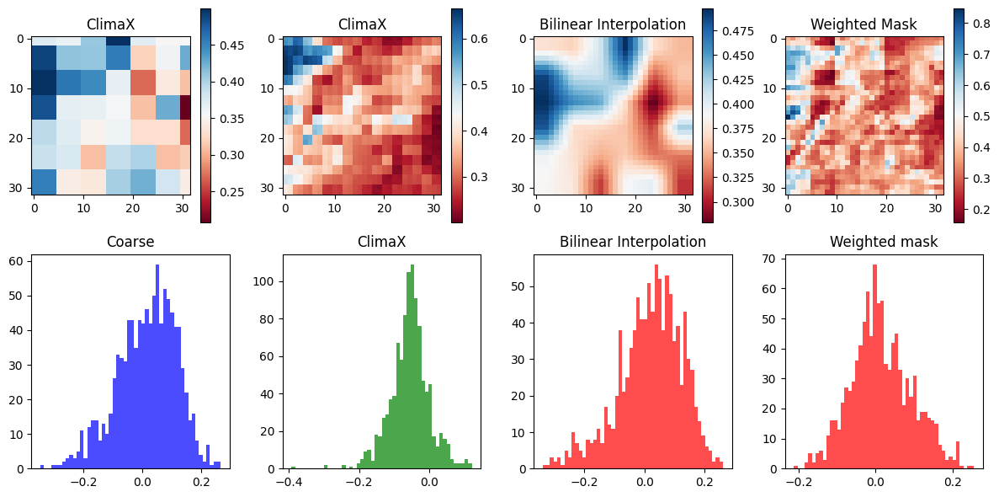

Time step 34
tensor(0.1373, device='cuda:0')


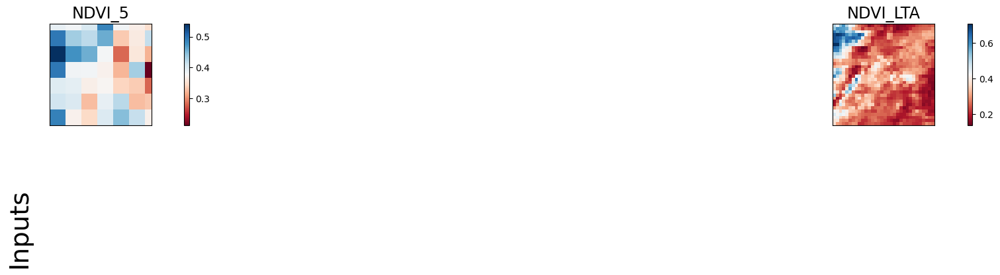

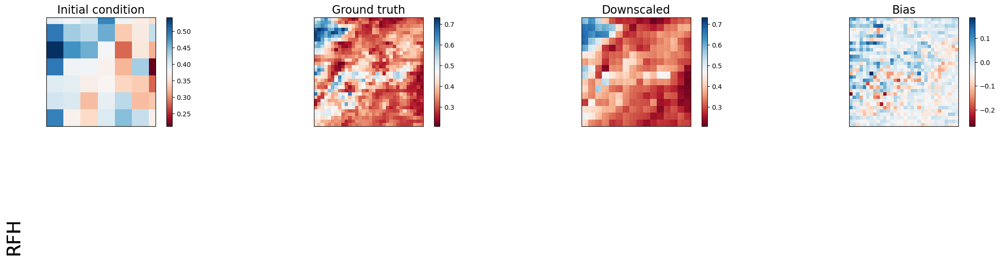

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+-----------------------+-----------------------+------------------------+-----------------------+
|                      | Coarse                | ClimaX                | Bilinear Interpolation | Weighted Mask         |
+----------------------+-----------------------+-----------------------+------------------------+-----------------------+
| lat_weighted_mse_val | 0.01823517307639122   | 0.0030048436019569635 | 0.011055365204811096   | 0.006886603776365519  |
| lat_weighted_rmse    | 0.017608577385544777  | 0.007147930562496185  | 0.013710583560168743   | 0.010821113362908363  |
| spearman             | 0.25742691252426847   | 0.8100937194368975    | 0.06844018422739405    | 0.6653030089491666    |
| mean_bias            | -0.010443359613418579 | -0.002683103084564209 | 0.003262162208557129   | 0.0030041933059692383 |
| pear

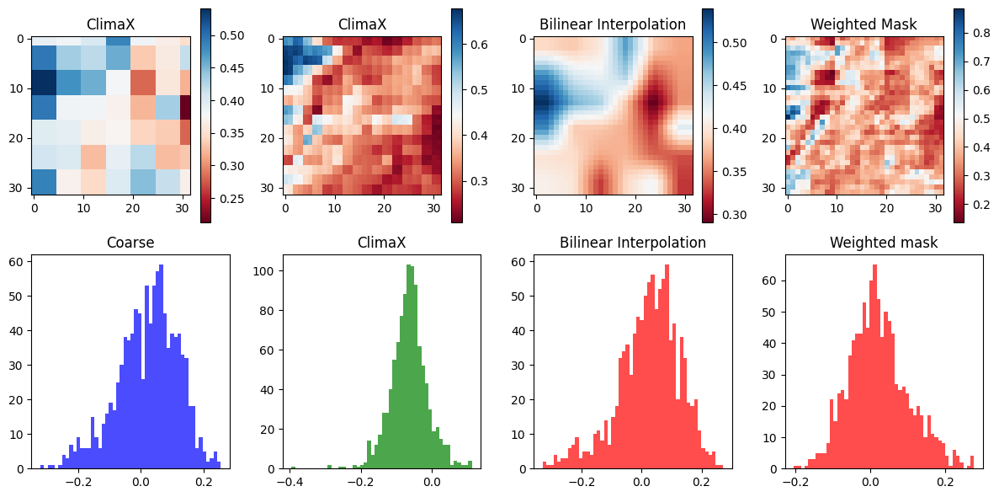

Time step 35
tensor(0.1023, device='cuda:0')


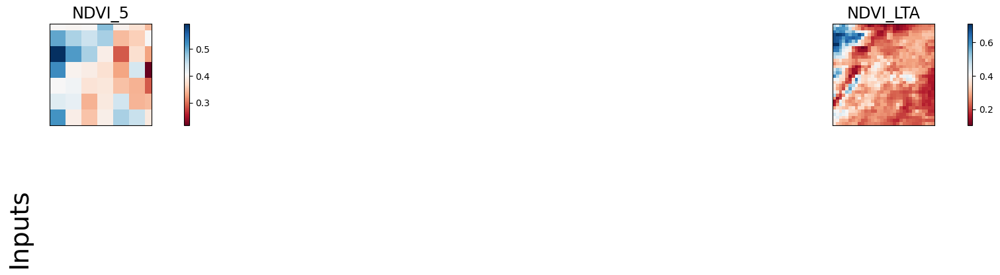

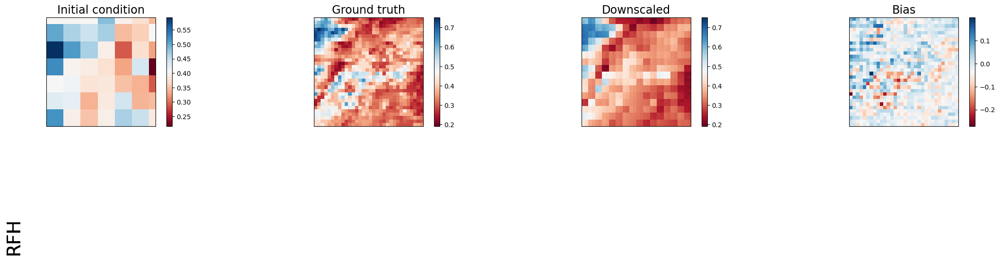

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+-----------------------+-----------------------+------------------------+----------------------+
|                      | Coarse                | ClimaX                | Bilinear Interpolation | Weighted Mask        |
+----------------------+-----------------------+-----------------------+------------------------+----------------------+
| lat_weighted_mse_val | 0.02063809335231781   | 0.003112768055871129  | 0.012341665104031563   | 0.008731883950531483 |
| lat_weighted_rmse    | 0.018732862547039986  | 0.007275163196027279  | 0.014486259780824184   | 0.012184937484562397 |
| spearman             | 0.2753704548137949    | 0.8093034339177342    | 0.07038747777968572    | 0.6720725322066496   |
| mean_bias            | -0.012207448482513428 | -0.002369791269302368 | 0.004097193479537964   | 0.003916054964065552 |
| pearson    

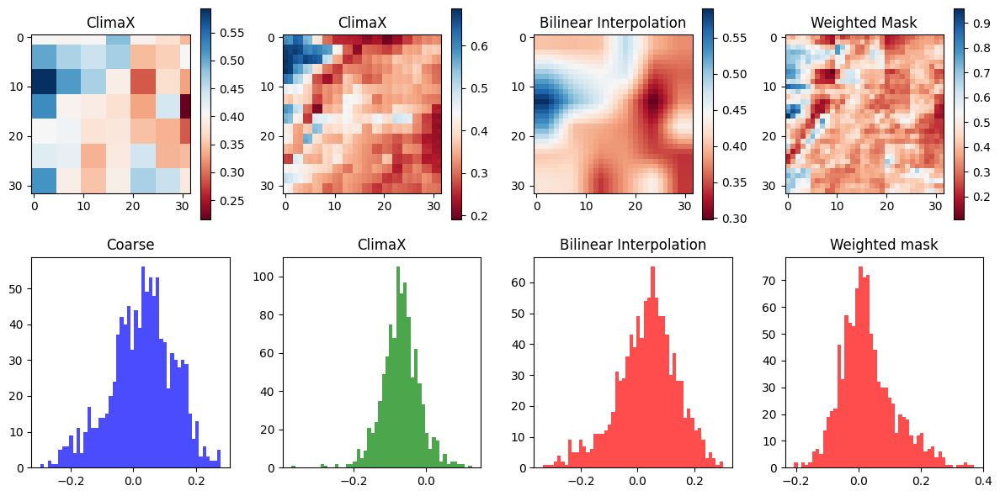

Time step 36
tensor(0.0602, device='cuda:0')


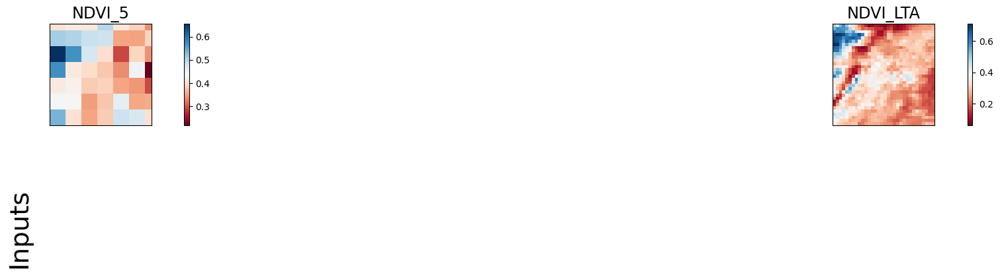

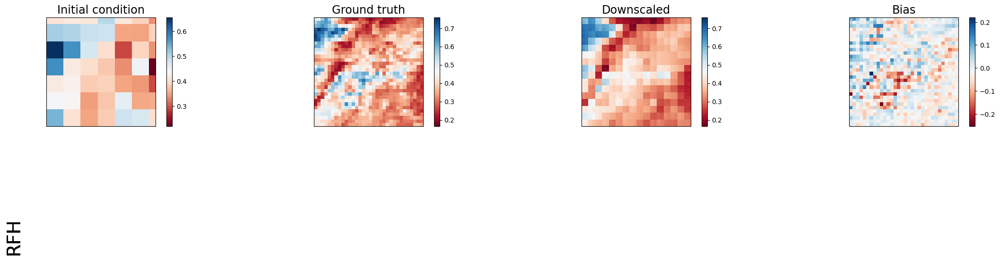

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+-----------------------+------------------------+------------------------+----------------------+
|                      | Coarse                | ClimaX                 | Bilinear Interpolation | Weighted Mask        |
+----------------------+-----------------------+------------------------+------------------------+----------------------+
| lat_weighted_mse_val | 0.024059396237134933  | 0.0033549549989402294  | 0.016238216310739517   | 0.01296293269842863  |
| lat_weighted_rmse    | 0.02022607997059822   | 0.007552881725132465   | 0.01661645993590355    | 0.014846393838524818 |
| spearman             | 0.27846642717078      | 0.8291210727278512     | 0.0017792251754592352  | 0.6482819697682086   |
| mean_bias            | -0.013890951871871948 | -0.0018753409385681152 | 0.005123317241668701   | 0.004809290170669556 |
| pear

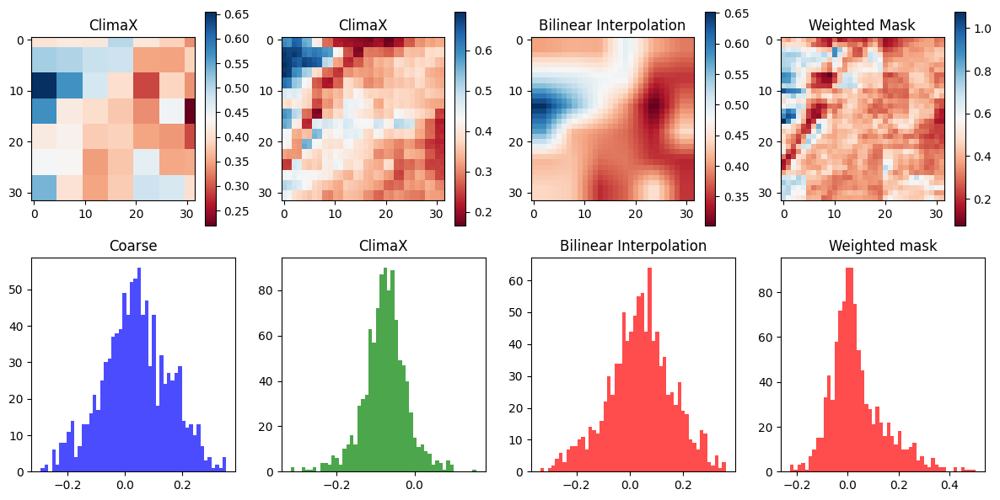

Time step 37
tensor(0.0255, device='cuda:0')


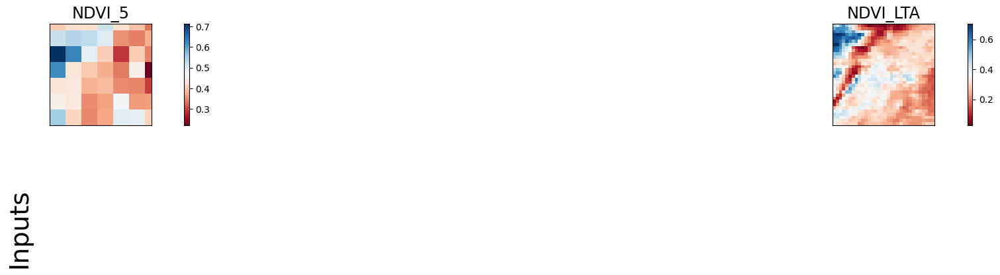

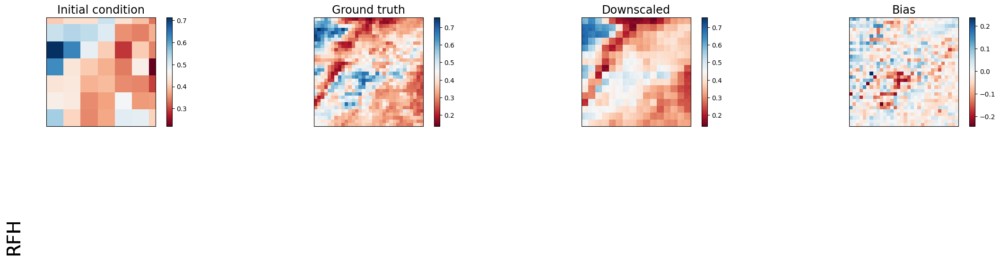

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+-----------------------+------------------------+------------------------+----------------------+
|                      | Coarse                | ClimaX                 | Bilinear Interpolation | Weighted Mask        |
+----------------------+-----------------------+------------------------+------------------------+----------------------+
| lat_weighted_mse_val | 0.028199387714266777  | 0.0036766021512448788  | 0.022084876894950867   | 0.019276734441518784 |
| lat_weighted_rmse    | 0.02189723215997219   | 0.007906653918325901   | 0.019378354772925377   | 0.01810448057949543  |
| spearman             | 0.2717118384523892    | 0.8497453686009399     | -0.07603595475004513   | 0.619015763247262    |
| mean_bias            | -0.015432983636856079 | -0.0015259385108947754 | 0.0061408281326293945  | 0.005557447671890259 |
| pear

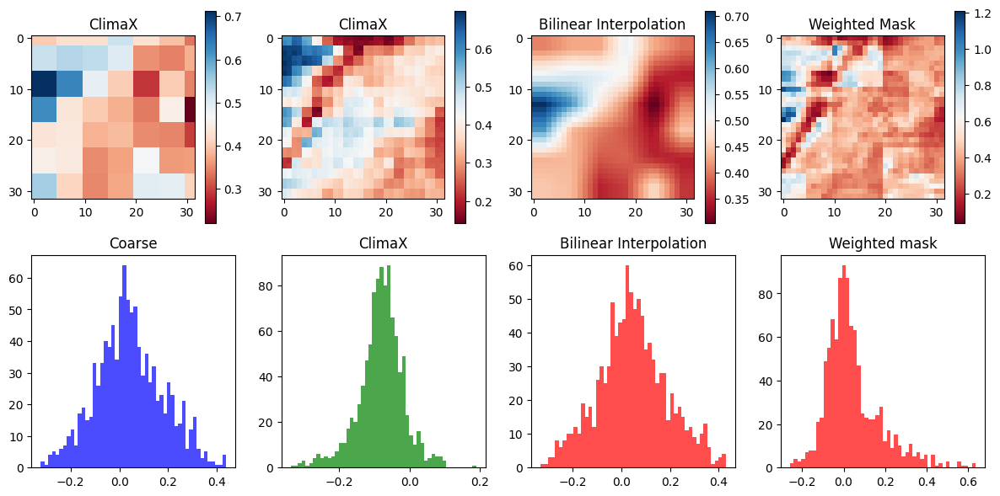

Time step 38
tensor(0.0046, device='cuda:0')


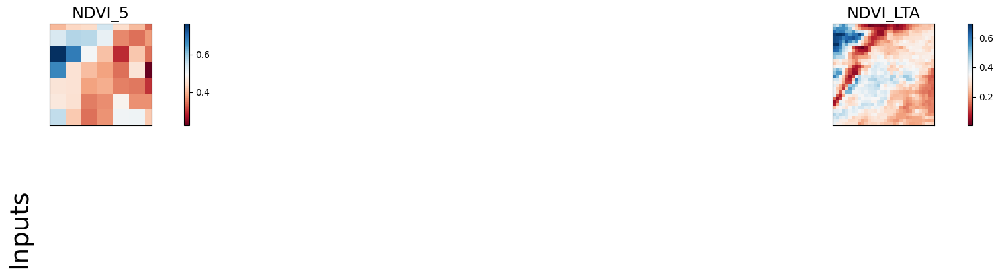

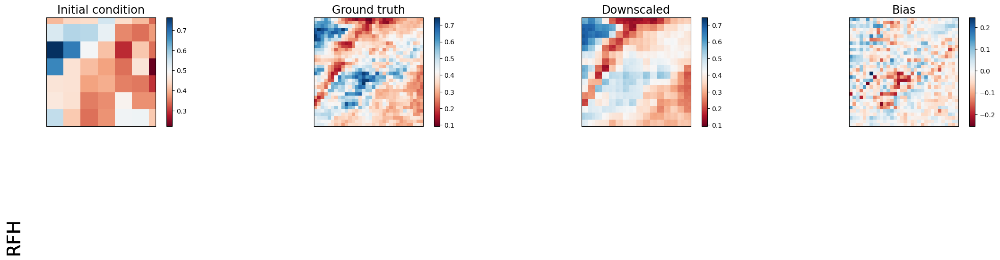

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+-----------------------+------------------------+------------------------+----------------------+
|                      | Coarse                | ClimaX                 | Bilinear Interpolation | Weighted Mask        |
+----------------------+-----------------------+------------------------+------------------------+----------------------+
| lat_weighted_mse_val | 0.03301025927066803   | 0.003951052203774452   | 0.027857348322868347   | 0.026250537484884262 |
| lat_weighted_rmse    | 0.02369157038629055   | 0.008196449838578701   | 0.021764026954770088   | 0.02112703211605549  |
| spearman             | 0.257076274725455     | 0.864850476062903      | -0.13163847073567775   | 0.6009543446566844   |
| mean_bias            | -0.017116039991378784 | -0.0014286339282989502 | 0.007105380296707153   | 0.006217777729034424 |
| pear

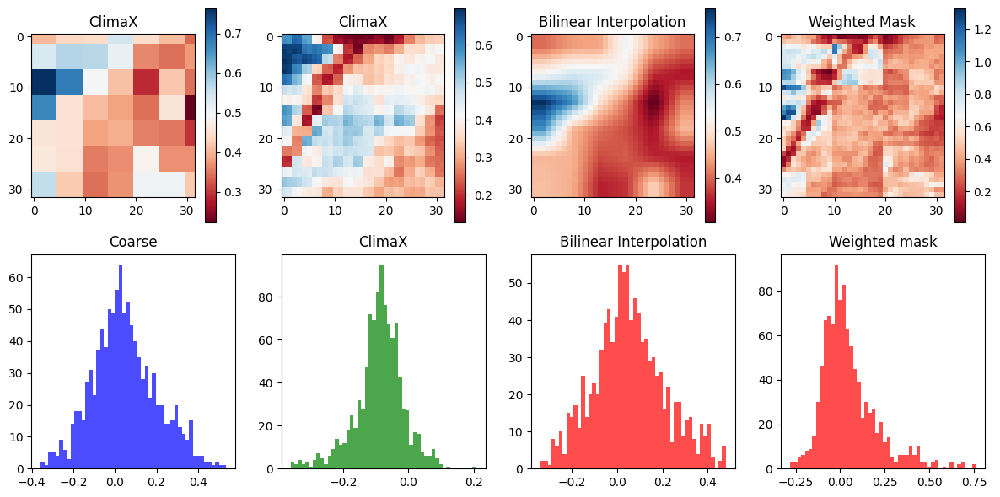

Time step 39
tensor(-0.0047, device='cuda:0')


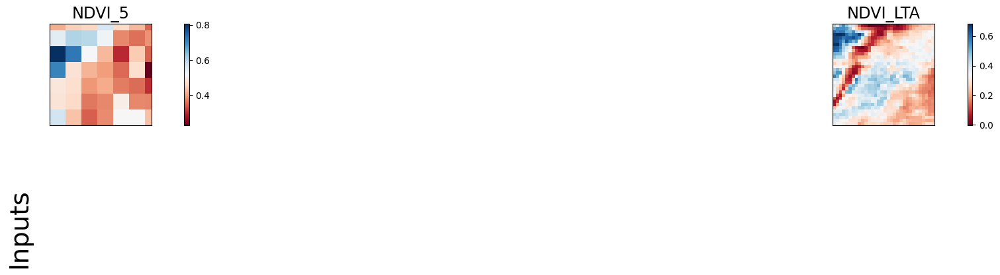

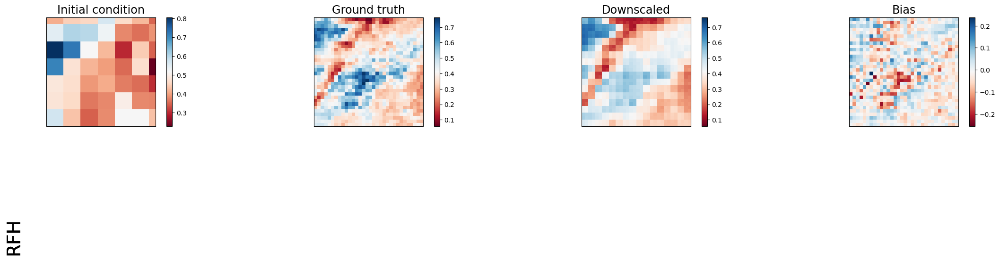

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+-----------------------+------------------------+------------------------+----------------------+
|                      | Coarse                | ClimaX                 | Bilinear Interpolation | Weighted Mask        |
+----------------------+-----------------------+------------------------+------------------------+----------------------+
| lat_weighted_mse_val | 0.03843921795487404   | 0.004146940540522337   | 0.032477423548698425   | 0.03258819878101349  |
| lat_weighted_rmse    | 0.02556563727557659   | 0.008397175930440426   | 0.023499583825469017   | 0.023539626970887184 |
| spearman             | 0.2607362911977757    | 0.8739042410468094     | -0.1629115497852813    | 0.587654102023117    |
| mean_bias            | -0.019061237573623657 | -0.0015539824962615967 | 0.008059442043304443   | 0.006935477256774902 |
| pear

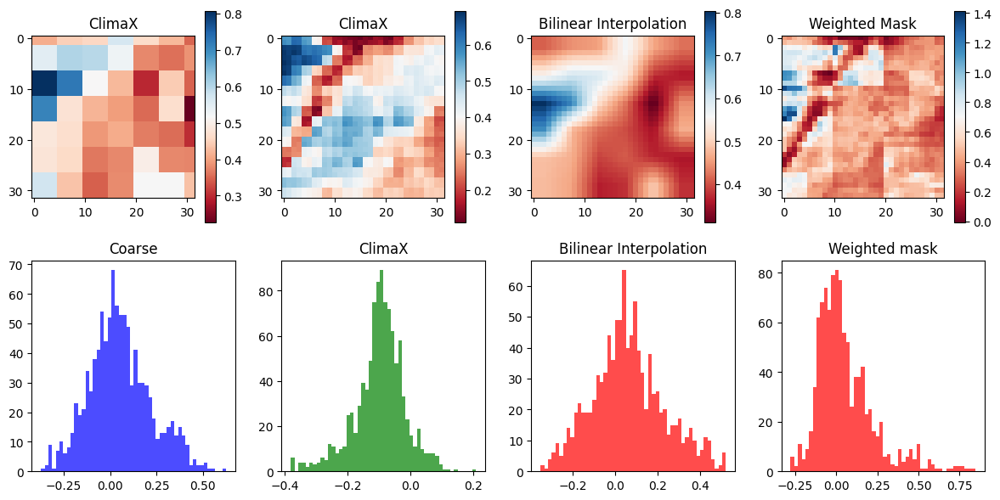

Time step 40
tensor(-0.0021, device='cuda:0')


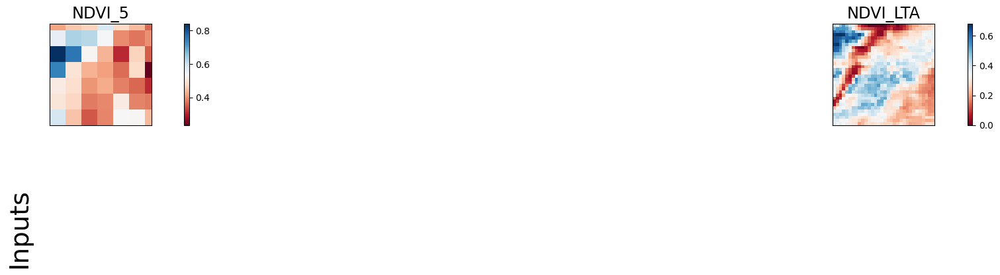

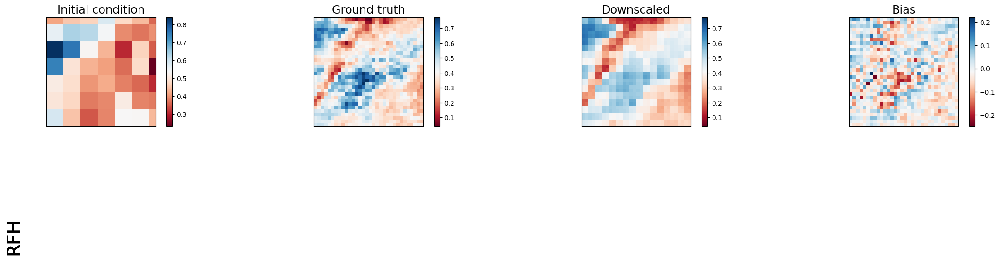

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+-----------------------+------------------------+------------------------+----------------------+
|                      | Coarse                | ClimaX                 | Bilinear Interpolation | Weighted Mask        |
+----------------------+-----------------------+------------------------+------------------------+----------------------+
| lat_weighted_mse_val | 0.04424595460295677   | 0.004170738160610199   | 0.03608422353863716    | 0.03638594597578049  |
| lat_weighted_rmse    | 0.0274287611246109    | 0.008421235717833042   | 0.024770116433501244   | 0.024873459711670876 |
| spearman             | 0.260913564181615     | 0.878833067636026      | -0.18679972352171786   | 0.5757284883975272   |
| mean_bias            | -0.021155744791030884 | -0.0017333626747131348 | 0.009073019027709961   | 0.007795929908752441 |
| pear

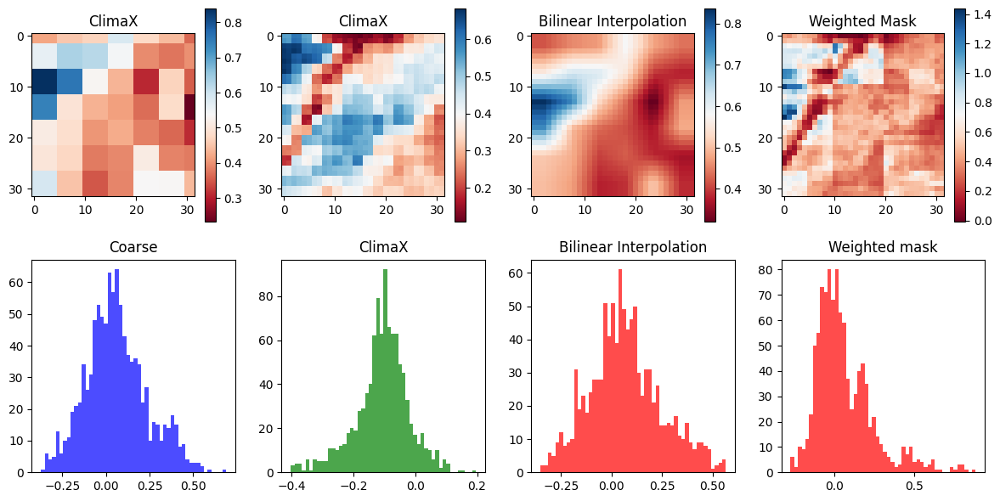

Time step 41
tensor(0.0097, device='cuda:0')


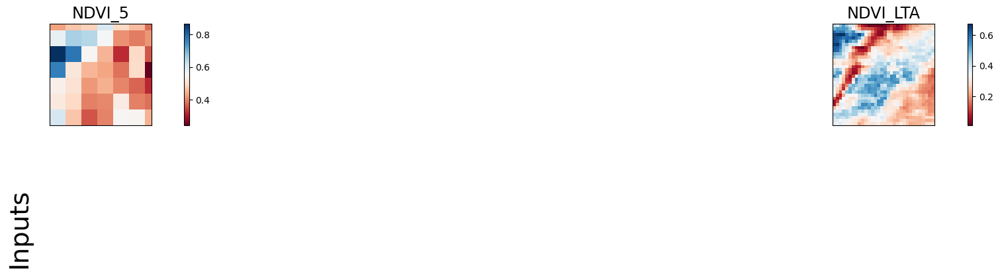

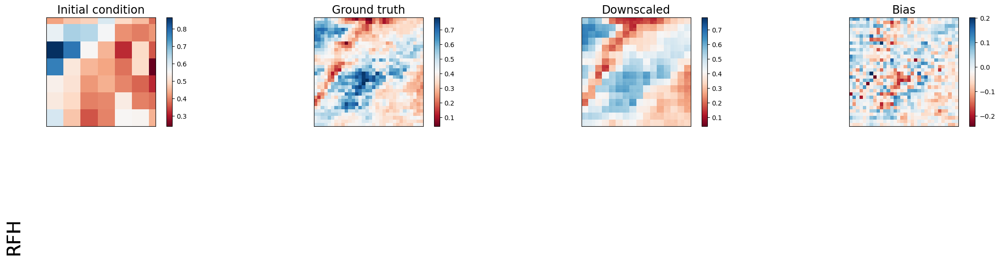

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+-----------------------+------------------------+------------------------+----------------------+
|                      | Coarse                | ClimaX                 | Bilinear Interpolation | Weighted Mask        |
+----------------------+-----------------------+------------------------+------------------------+----------------------+
| lat_weighted_mse_val | 0.05040348693728447   | 0.0040815104730427265  | 0.038862645626068115   | 0.03769257292151451  |
| lat_weighted_rmse    | 0.029275184497237206  | 0.008330668322741985   | 0.025706063956022263   | 0.025316128507256508 |
| spearman             | 0.2690817567702526    | 0.8829931861601137     | -0.2025474596298408    | 0.5672918443371059   |
| mean_bias            | -0.023306548595428467 | -0.0019442737102508545 | 0.010115891695022583   | 0.008737146854400635 |
| pear

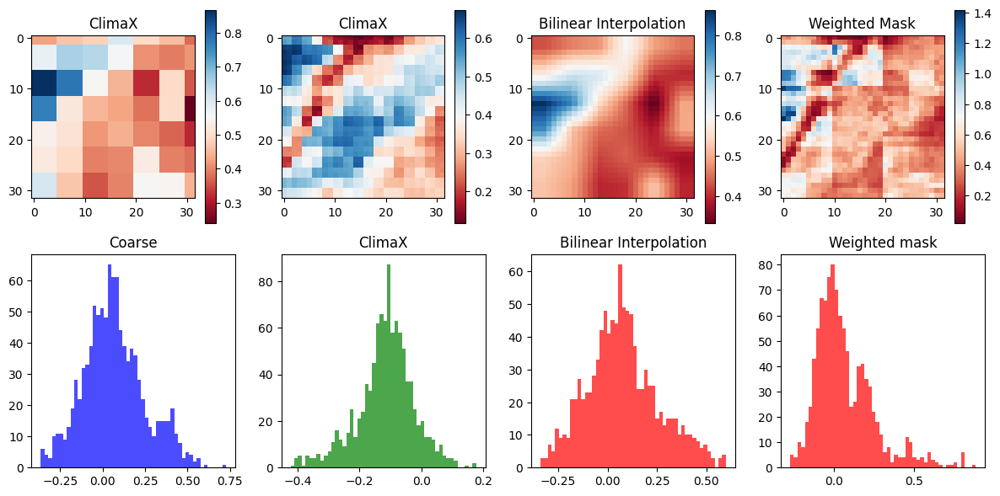

Time step 42
tensor(0.0333, device='cuda:0')


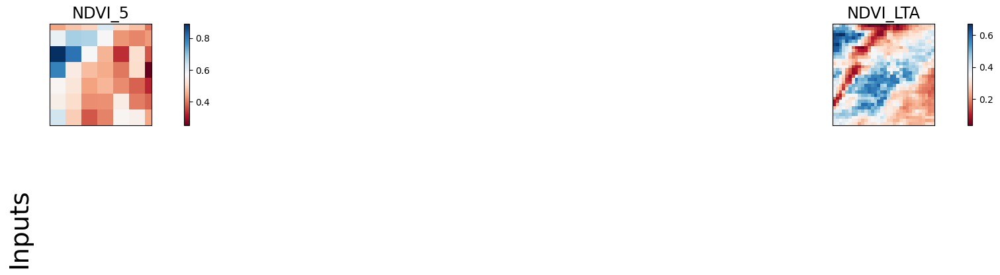

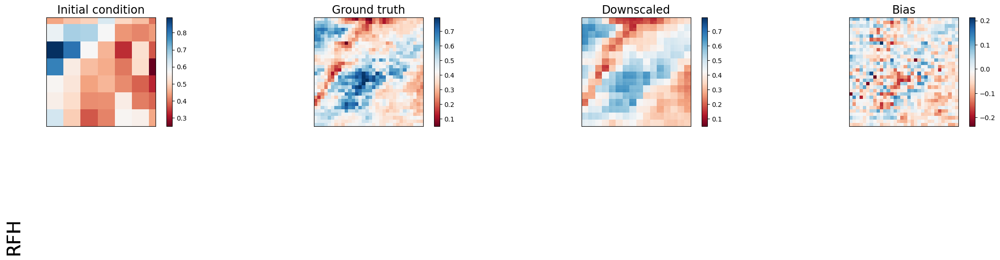

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+----------------------+------------------------+------------------------+----------------------+
|                      | Coarse               | ClimaX                 | Bilinear Interpolation | Weighted Mask        |
+----------------------+----------------------+------------------------+------------------------+----------------------+
| lat_weighted_mse_val | 0.05783921852707863  | 0.003987982403486967   | 0.04082895442843437    | 0.037653613835573196 |
| lat_weighted_rmse    | 0.03136032819747925  | 0.008234665729105473   | 0.026348356157541275   | 0.02530304342508316  |
| spearman             | 0.28489916742445326  | 0.8842082043196736     | -0.20614797031435889   | 0.563195036735404    |
| mean_bias            | -0.02576419711112976 | -0.0022453665733337402 | 0.011216044425964355   | 0.00975063443183899  |
| pearson    

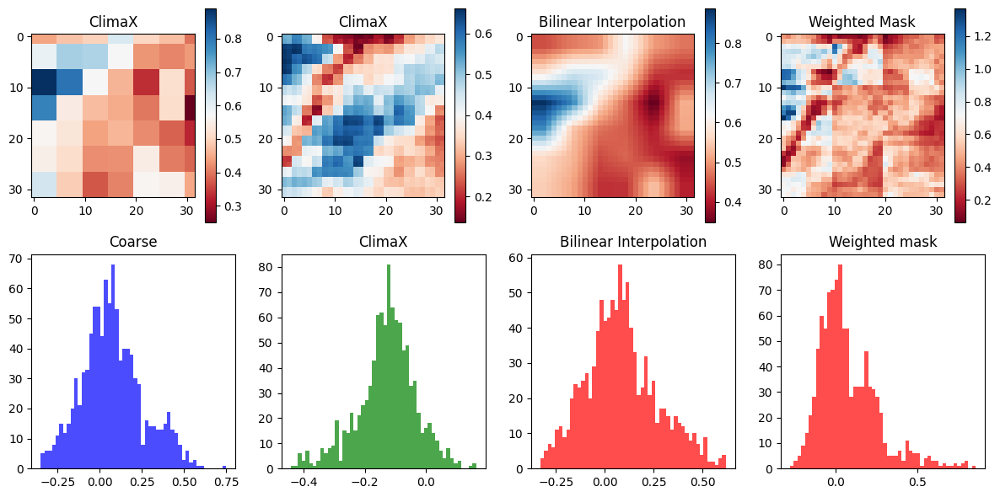

Time step 43
tensor(0.0645, device='cuda:0')


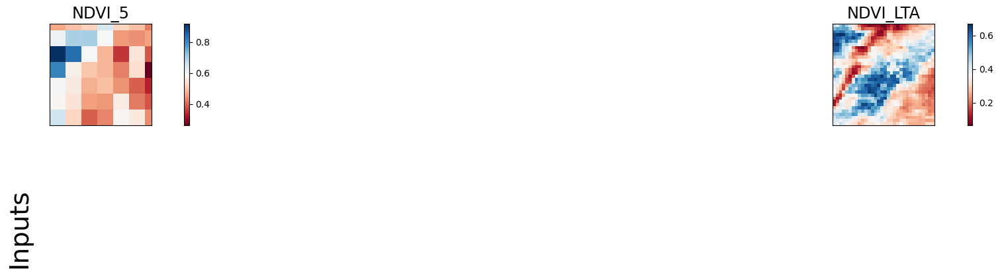

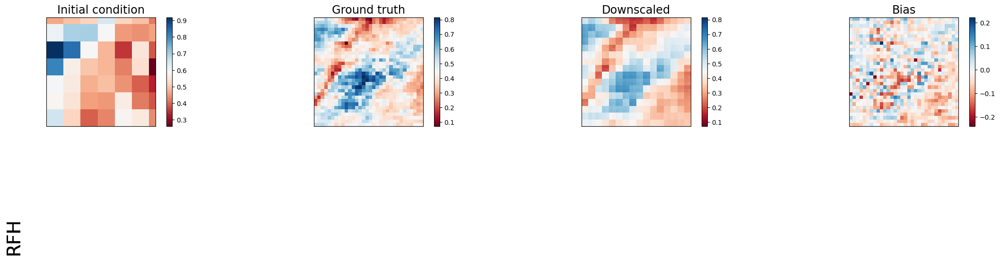

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+-----------------------+------------------------+------------------------+----------------------+
|                      | Coarse                | ClimaX                 | Bilinear Interpolation | Weighted Mask        |
+----------------------+-----------------------+------------------------+------------------------+----------------------+
| lat_weighted_mse_val | 0.06752128154039383   | 0.003934449981898069   | 0.04276512563228607    | 0.0374508760869503   |
| lat_weighted_rmse    | 0.03388361260294914   | 0.008179211057722569   | 0.026965860277414322   | 0.025234831497073174 |
| spearman             | 0.2946562485976926    | 0.8813036831391365     | -0.20292136311311473   | 0.5655181779956316   |
| mean_bias            | -0.028664469718933105 | -0.0024927854537963867 | 0.012467026710510254   | 0.010884404182434082 |
| pear

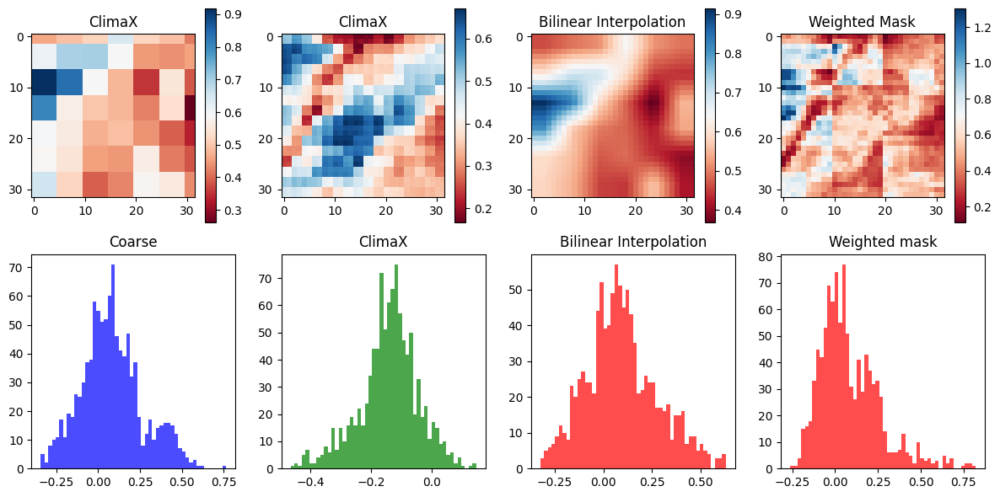

Time step 44
tensor(0.1015, device='cuda:0')


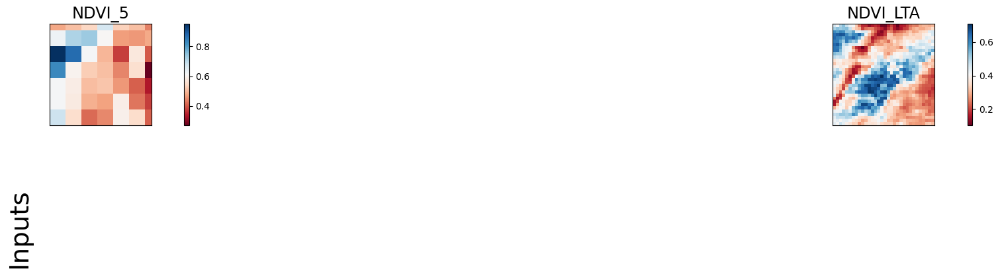

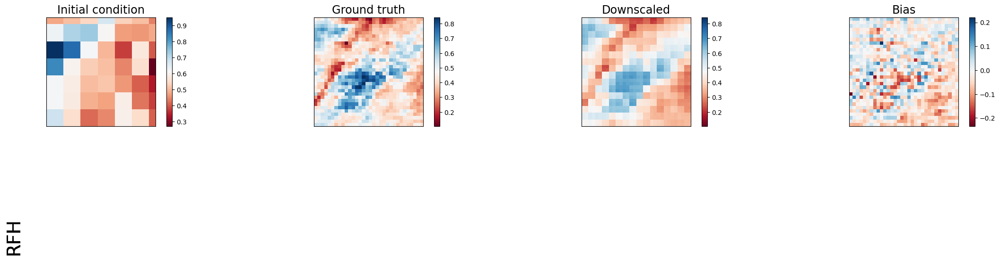

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+-----------------------+-----------------------+------------------------+----------------------+
|                      | Coarse                | ClimaX                | Bilinear Interpolation | Weighted Mask        |
+----------------------+-----------------------+-----------------------+------------------------+----------------------+
| lat_weighted_mse_val | 0.07856933772563934   | 0.003905106335878372  | 0.04507284611463547    | 0.037825606763362885 |
| lat_weighted_rmse    | 0.03655071556568146   | 0.00814865343272686   | 0.02768387459218502    | 0.02536076307296753  |
| spearman             | 0.29762126052997956   | 0.8747742020534804    | -0.1951352828585006    | 0.5701425594340571   |
| mean_bias            | -0.031591981649398804 | -0.002344578504562378 | 0.013714224100112915   | 0.01196742057800293  |
| pearson    

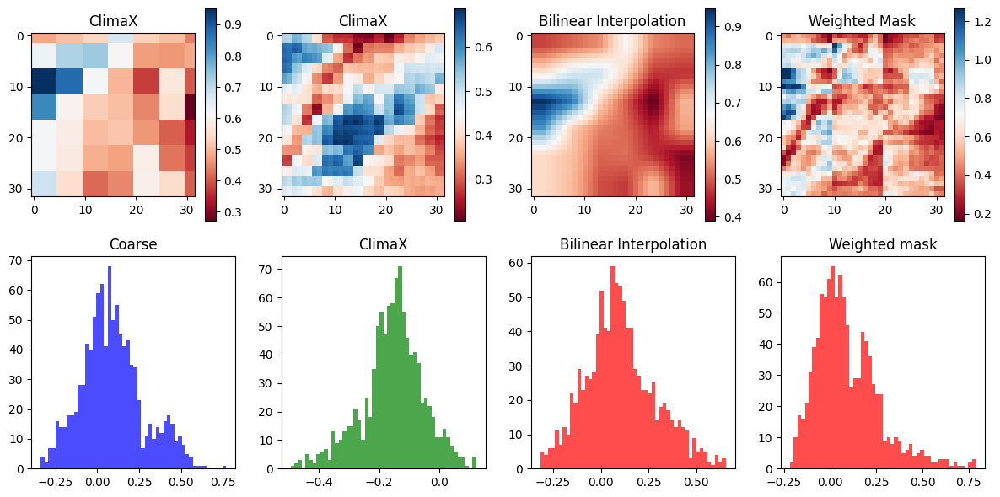

Time step 45
tensor(0.1401, device='cuda:0')


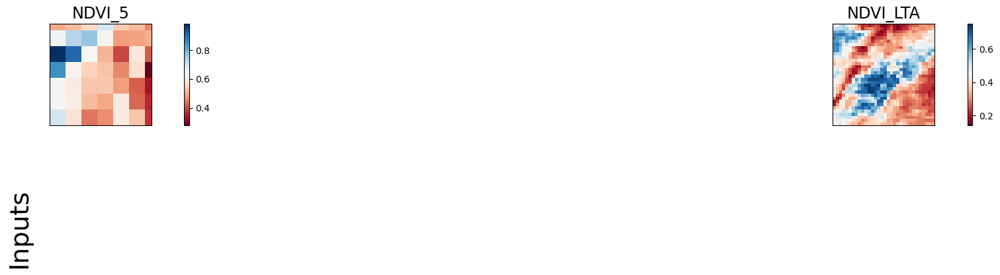

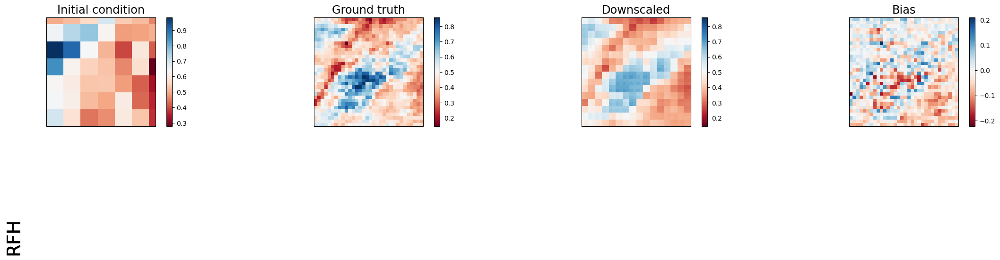

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+----------------------+------------------------+------------------------+----------------------+
|                      | Coarse               | ClimaX                 | Bilinear Interpolation | Weighted Mask        |
+----------------------+----------------------+------------------------+------------------------+----------------------+
| lat_weighted_mse_val | 0.08774145692586899  | 0.003851955756545067   | 0.04650425910949707    | 0.03798327222466469  |
| lat_weighted_rmse    | 0.03862529247999191  | 0.008093008771538734   | 0.028120027855038643   | 0.02541356533765793  |
| spearman             | 0.3146197728093335   | 0.8664574611509409     | -0.1833227875546298    | 0.5746809619667218   |
| mean_bias            | -0.03377971053123474 | -0.0019976794719696045 | 0.014587730169296265   | 0.012623429298400879 |
| pearson    

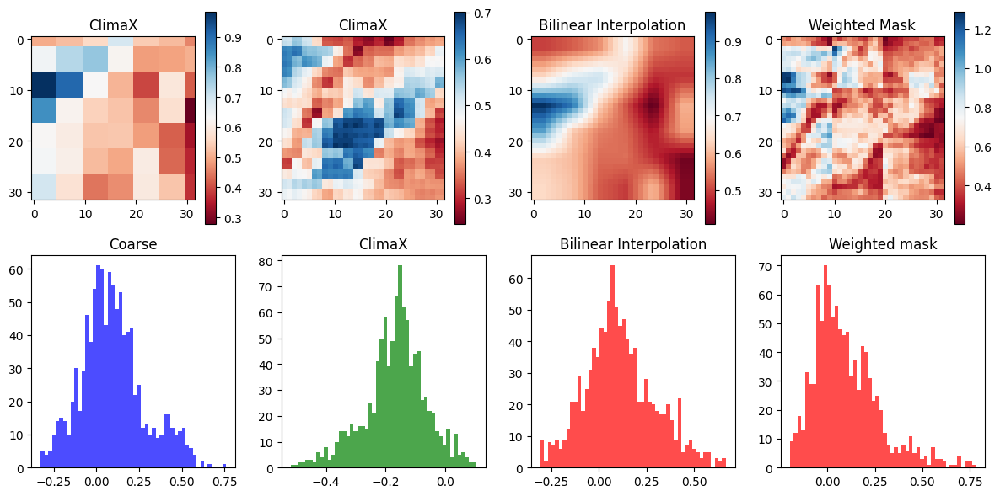

Time step 46
tensor(0.1766, device='cuda:0')


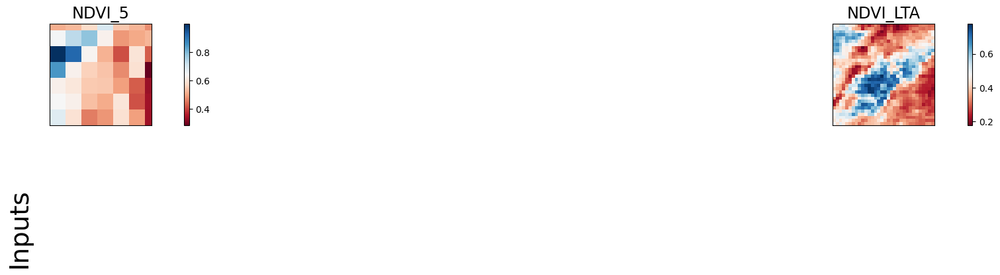

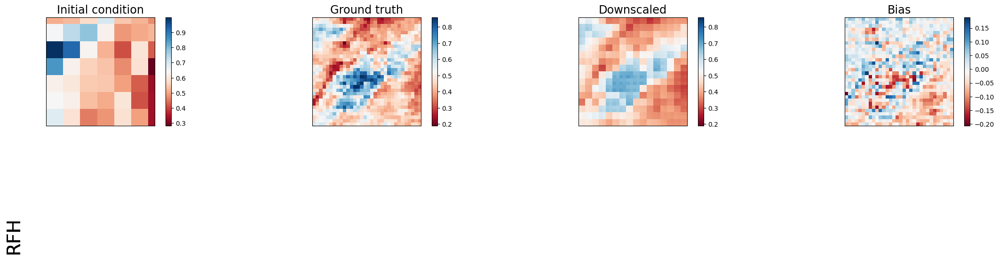

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+-----------------------+-----------------------+------------------------+----------------------+
|                      | Coarse                | ClimaX                | Bilinear Interpolation | Weighted Mask        |
+----------------------+-----------------------+-----------------------+------------------------+----------------------+
| lat_weighted_mse_val | 0.09083934873342514   | 0.0036678987089544535 | 0.04587282985448837    | 0.036520082503557205 |
| lat_weighted_rmse    | 0.039301250129938126  | 0.007897289469838142  | 0.027928469702601433   | 0.024919265881180763 |
| spearman             | 0.31366542113930973   | 0.857207652937643     | -0.16628854868800716   | 0.5882473085245478   |
| mean_bias            | -0.034435927867889404 | -0.001612335443496704 | 0.014767110347747803   | 0.012536019086837769 |
| pearson    

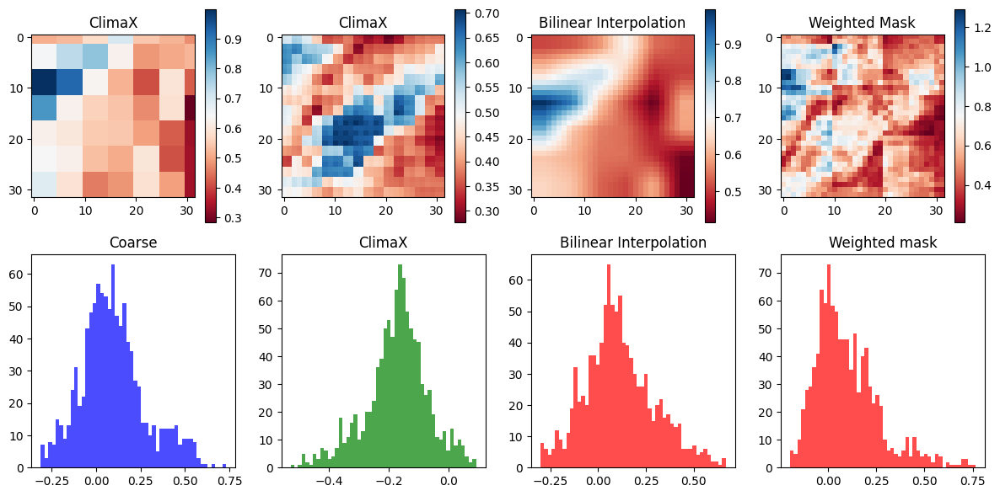

Time step 47
tensor(0.2105, device='cuda:0')


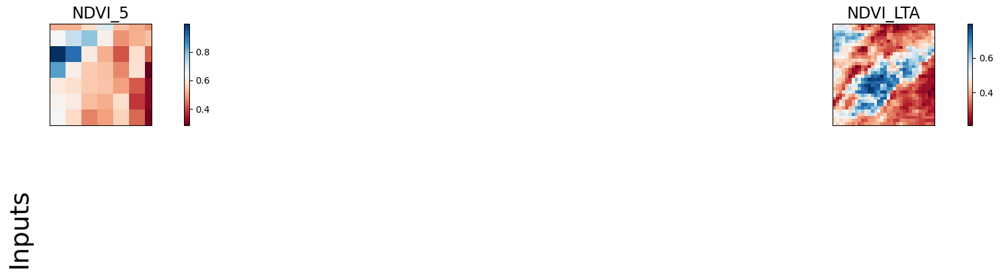

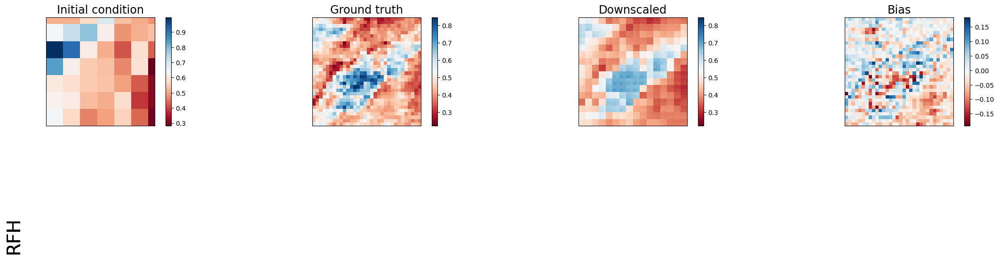

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+----------------------+------------------------+------------------------+----------------------+
|                      | Coarse               | ClimaX                 | Bilinear Interpolation | Weighted Mask        |
+----------------------+----------------------+------------------------+------------------------+----------------------+
| lat_weighted_mse_val | 0.08588343113660812  | 0.003357809269800782   | 0.042920056730508804   | 0.03286116570234299  |
| lat_weighted_rmse    | 0.03821413591504097  | 0.007556093856692314   | 0.027014661580324173   | 0.023638008162379265 |
| spearman             | 0.30973389999959633  | 0.8496811944323126     | -0.13453444235725062   | 0.6164495032690651   |
| mean_bias            | -0.03318110108375549 | -0.0011291205883026123 | 0.014108359813690186   | 0.011564910411834717 |
| pearson    

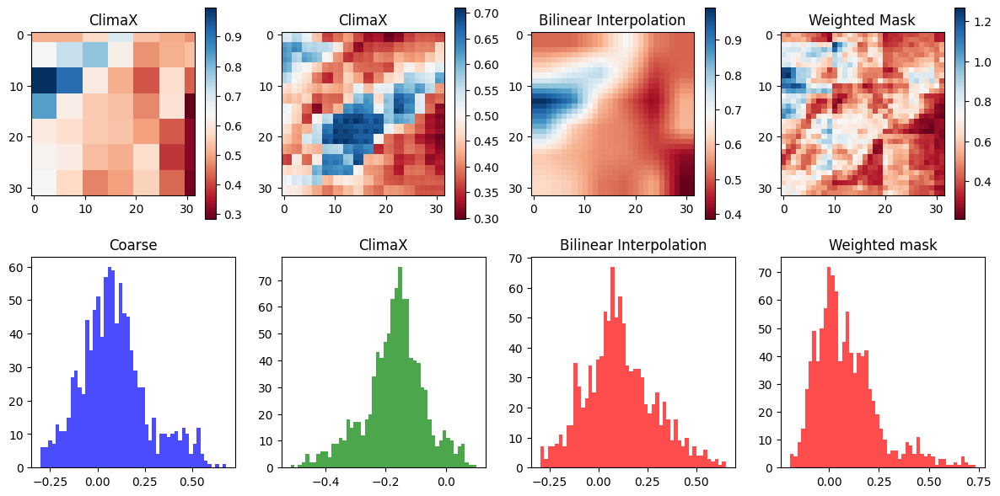

Time step 48
tensor(0.2204, device='cuda:0')


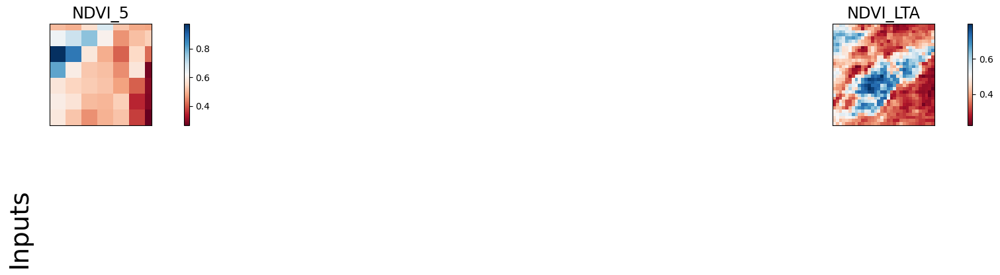

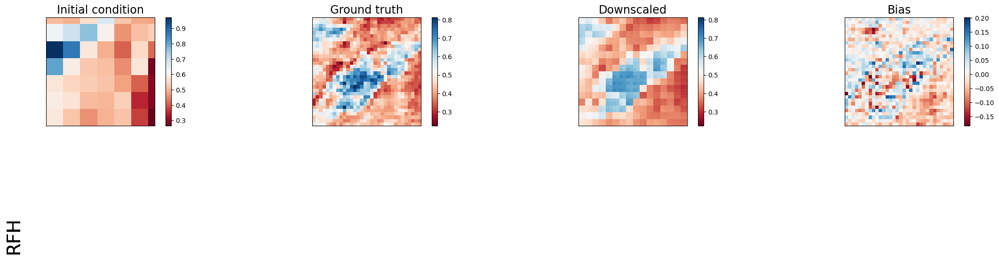

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+----------------------+------------------------+------------------------+----------------------+
|                      | Coarse               | ClimaX                 | Bilinear Interpolation | Weighted Mask        |
+----------------------+----------------------+------------------------+------------------------+----------------------+
| lat_weighted_mse_val | 0.07325725257396698  | 0.0030594458803534508  | 0.03789377212524414    | 0.027399005368351936 |
| lat_weighted_rmse    | 0.03529350459575653  | 0.00721258157864213    | 0.025383606553077698   | 0.021584240719676018 |
| spearman             | 0.2889942829577559   | 0.844258004320023      | -0.090860117794942     | 0.6566010963484764   |
| mean_bias            | -0.02992469072341919 | -0.0005295872688293457 | 0.01257428526878357    | 0.009760171175003052 |
| pearson    

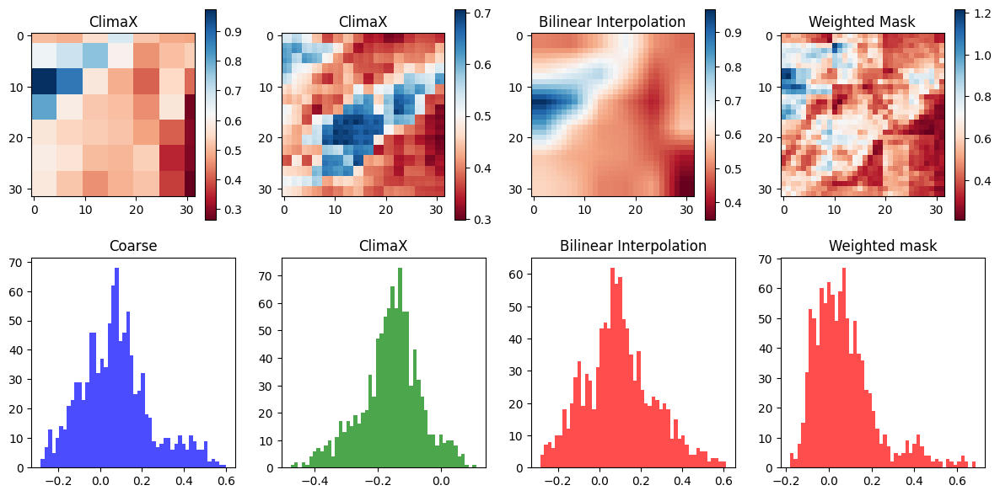

Time step 49
tensor(0.2211, device='cuda:0')


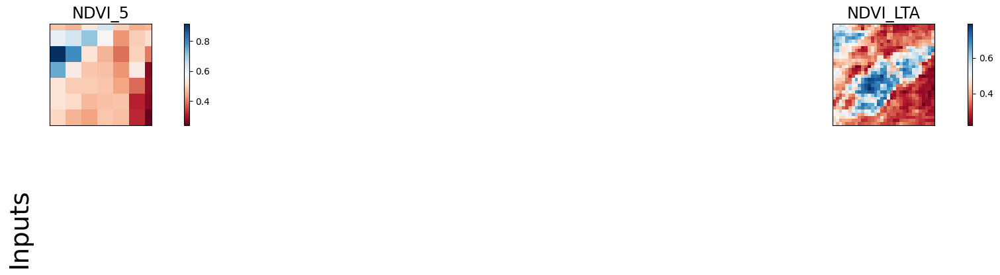

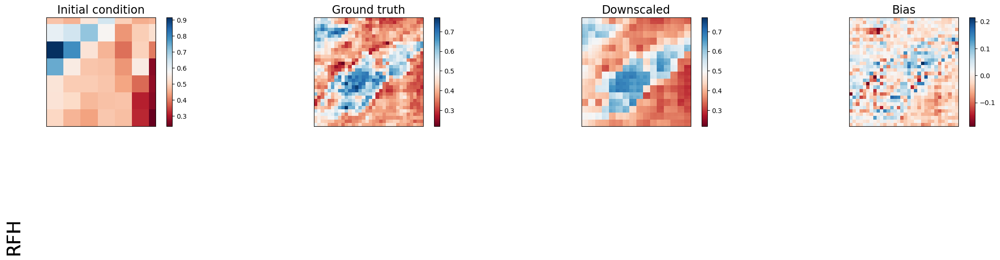

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+-----------------------+-----------------------+------------------------+----------------------+
|                      | Coarse                | ClimaX                | Bilinear Interpolation | Weighted Mask        |
+----------------------+-----------------------+-----------------------+------------------------+----------------------+
| lat_weighted_mse_val | 0.05506357550621033   | 0.0029545901343226433 | 0.030774693936109543   | 0.020474646240472794 |
| lat_weighted_rmse    | 0.030598601326346397  | 0.00708790635690093   | 0.02287527173757553    | 0.018658537417650223 |
| spearman             | 0.26494444168358916   | 0.847620823015325     | -0.039514930066157625  | 0.6982906306673324   |
| mean_bias            | -0.024741023778915405 | 7.897615432739258e-05 | 0.010173767805099487   | 0.00729784369468689  |
| pearson    

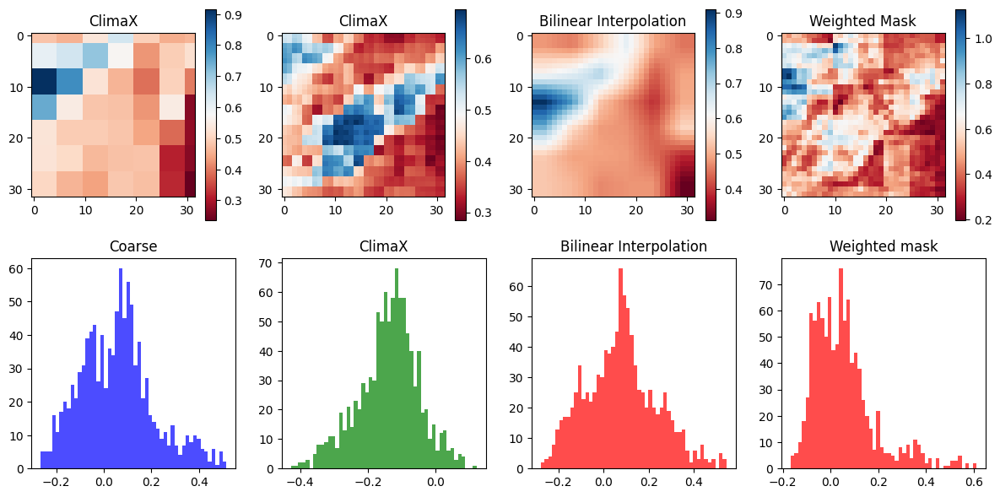

Time step 50
tensor(0.2117, device='cuda:0')


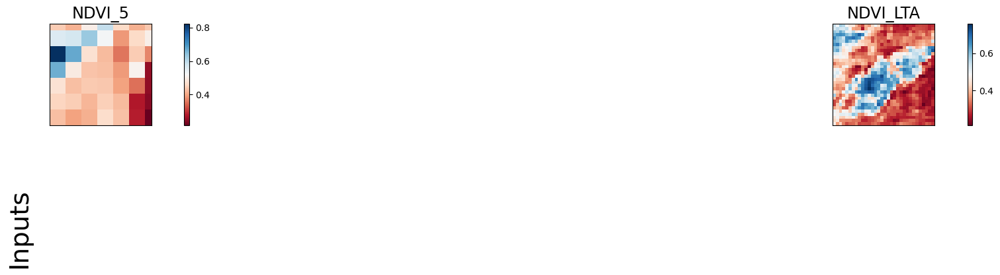

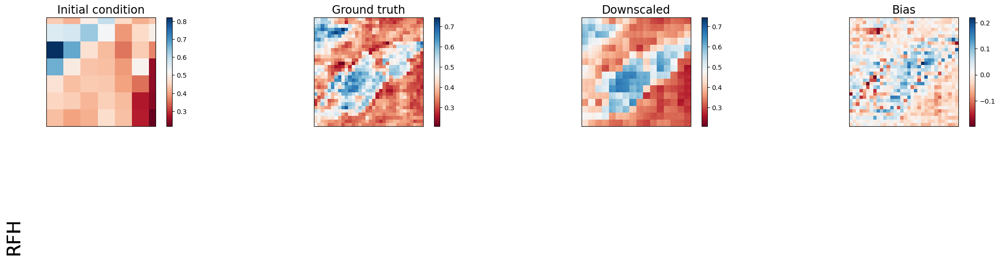

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+-----------------------+------------------------+------------------------+----------------------+
|                      | Coarse                | ClimaX                 | Bilinear Interpolation | Weighted Mask        |
+----------------------+-----------------------+------------------------+------------------------+----------------------+
| lat_weighted_mse_val | 0.03651653230190277   | 0.0031297989189624786  | 0.02317020669579506    | 0.013771293684840202 |
| lat_weighted_rmse    | 0.024918055161833763  | 0.007295039016753435   | 0.01984880492091179    | 0.01530230138450861  |
| spearman             | 0.21457352141582398   | 0.8506239808971838     | 0.00019720459924127683 | 0.7283171672132278   |
| mean_bias            | -0.018256008625030518 | 0.00046131014823913574 | 0.00724637508392334    | 0.004544645547866821 |
| pear

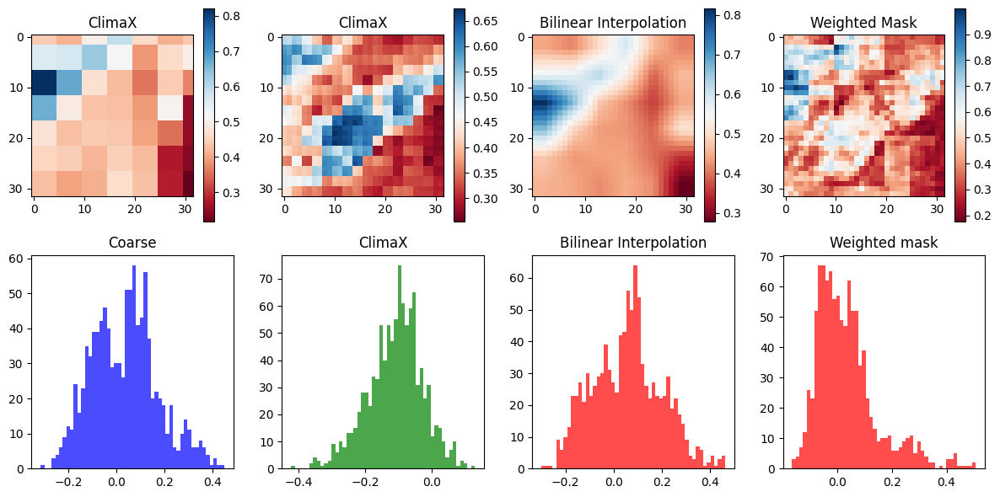

Time step 51
tensor(0.1942, device='cuda:0')


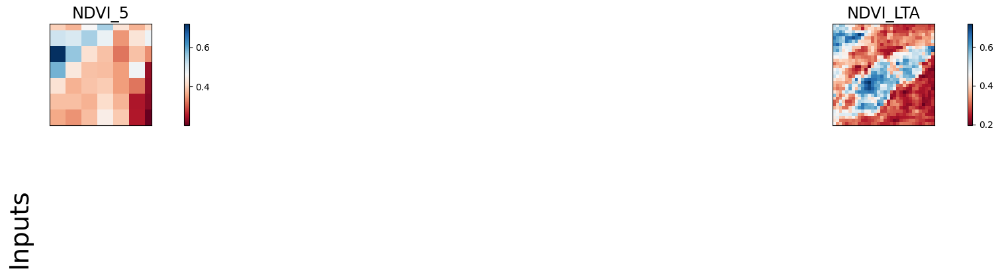

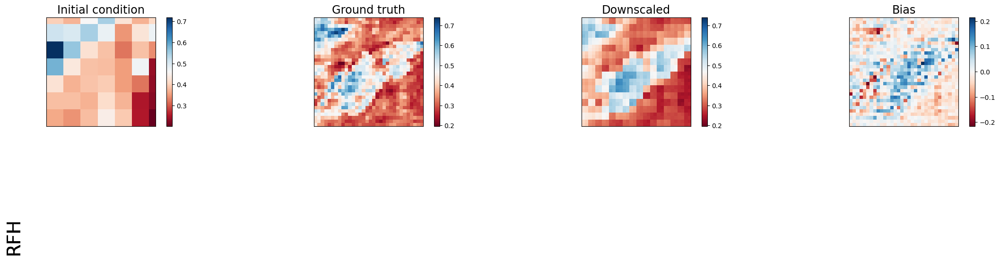

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+-----------------------+-----------------------+------------------------+----------------------+
|                      | Coarse                | ClimaX                | Bilinear Interpolation | Weighted Mask        |
+----------------------+-----------------------+-----------------------+------------------------+----------------------+
| lat_weighted_mse_val | 0.023496439680457115  | 0.0034255865029990673 | 0.01766522228717804    | 0.009463246911764145 |
| lat_weighted_rmse    | 0.0199880450963974    | 0.007631974294781685  | 0.017331212759017944   | 0.01268497109413147  |
| spearman             | 0.1726744044839074    | 0.8510198229460145    | 0.02879993796925252    | 0.7325002249148497   |
| mean_bias            | -0.011915713548660278 | 0.0004121363162994385 | 0.004485428333282471   | 0.002098947763442993 |
| pearson    

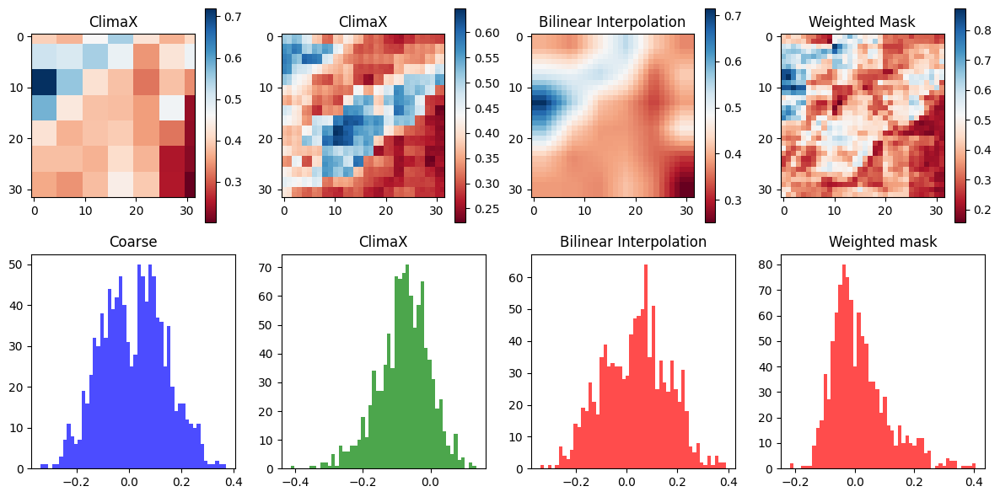

Time step 52
tensor(0.1779, device='cuda:0')


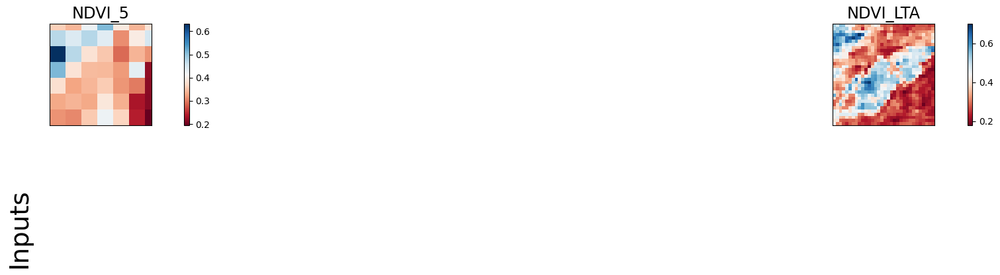

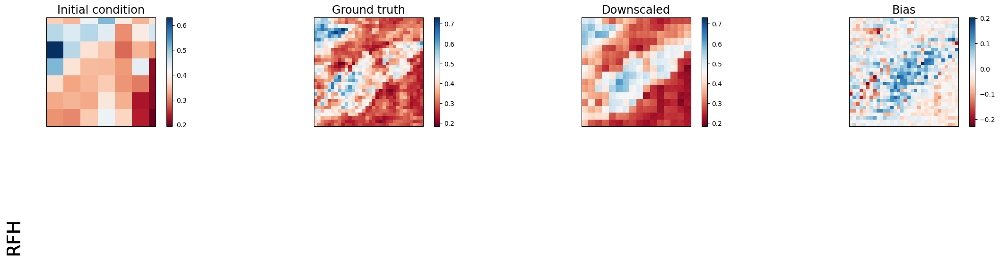

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+-----------------------+-----------------------+------------------------+------------------------+
|                      | Coarse                | ClimaX                | Bilinear Interpolation | Weighted Mask          |
+----------------------+-----------------------+-----------------------+------------------------+------------------------+
| lat_weighted_mse_val | 0.01678525283932686   | 0.003479430917650461  | 0.014690594747662544   | 0.007486121263355017   |
| lat_weighted_rmse    | 0.016894031316041946  | 0.00769172003492713   | 0.015804802998900414   | 0.011282304301857948   |
| spearman             | 0.14262371954502234   | 0.851966375739929     | 0.041269573606626905   | 0.7191098837974792     |
| mean_bias            | -0.006747603416442871 | 0.0001646876335144043 | 0.0023247599601745605  | 0.00030678510665893555 |

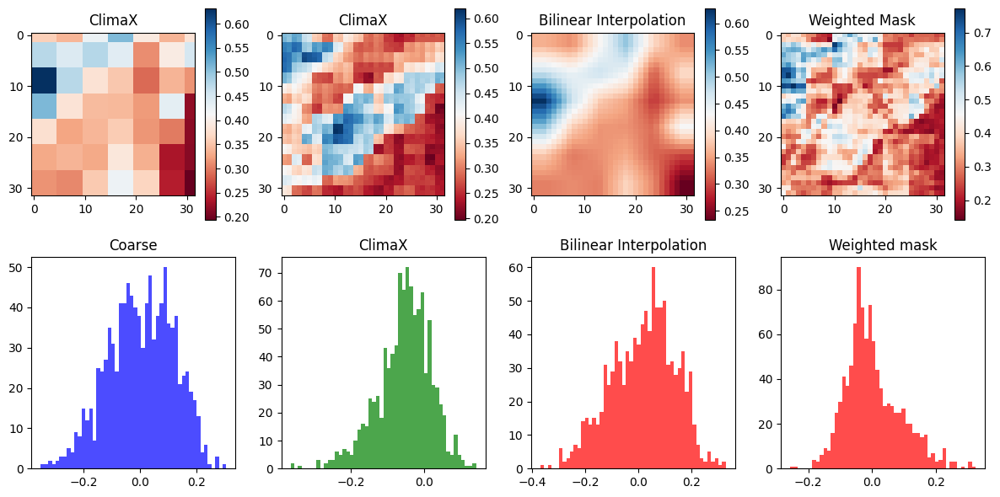

Time step 53
tensor(0.1652, device='cuda:0')


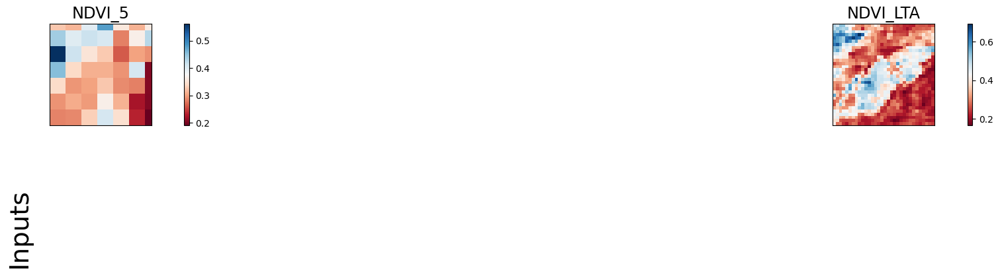

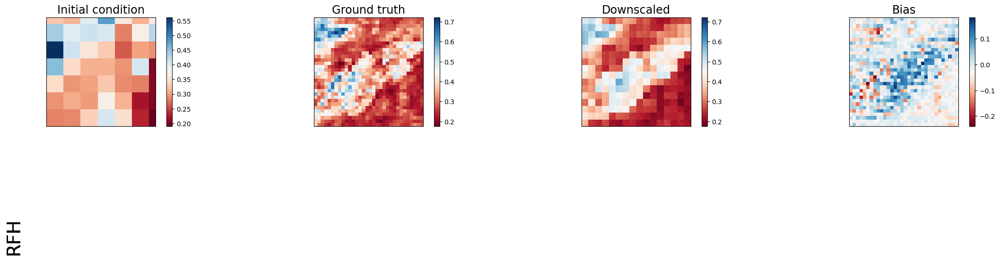

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+------------------------+-------------------------+------------------------+------------------------+
|                      | Coarse                 | ClimaX                  | Bilinear Interpolation | Weighted Mask          |
+----------------------+------------------------+-------------------------+------------------------+------------------------+
| lat_weighted_mse_val | 0.014014814049005508   | 0.0033728352282196283   | 0.013242840766906738   | 0.006750413216650486   |
| lat_weighted_rmse    | 0.01543700322508812    | 0.007572982460260391    | 0.015005826950073242   | 0.010713579133152962   |
| spearman             | 0.1246572136952009     | 0.8517297556842334      | 0.03808295815788349    | 0.694579461595889      |
| mean_bias            | -0.0027197301387786865 | -0.00025403499603271484 | 0.0007656216621398926  | -0.

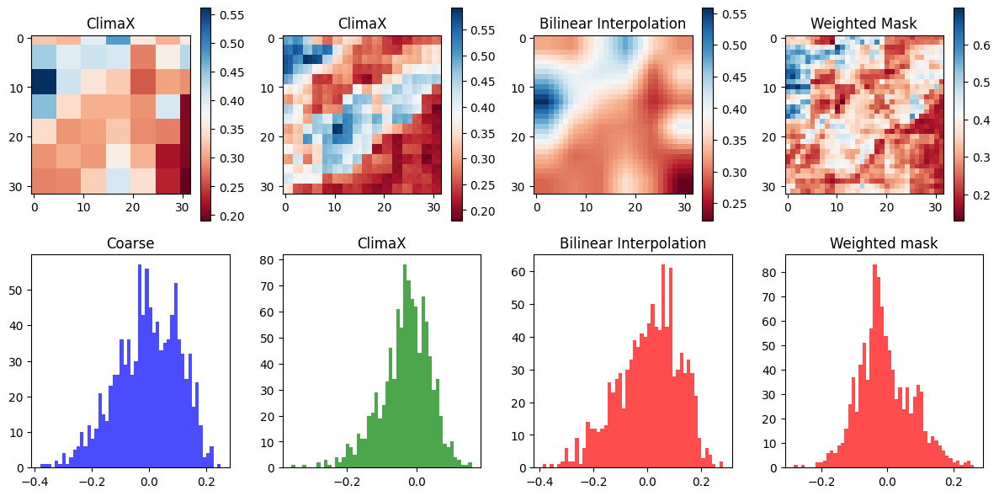

Time step 54
tensor(0.1560, device='cuda:0')


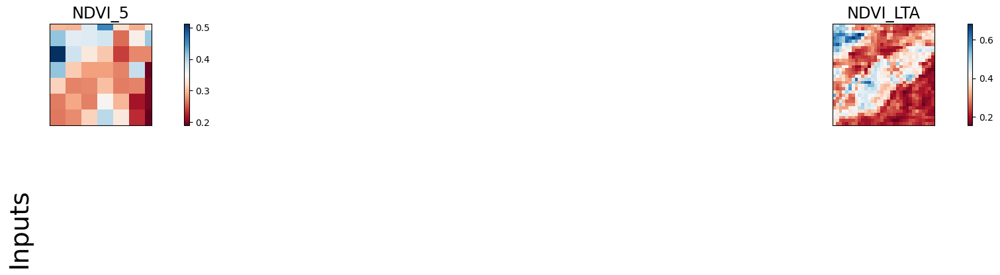

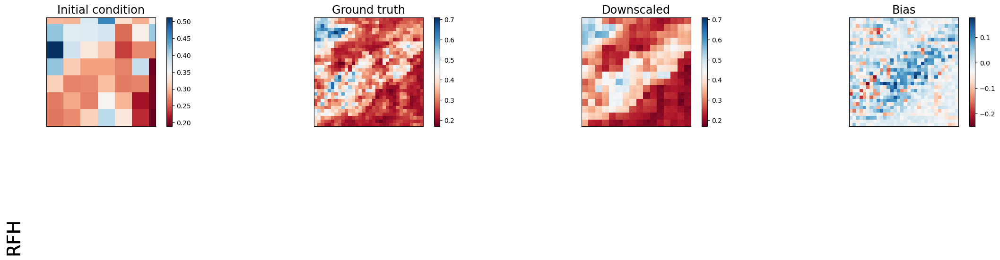

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+-----------------------+------------------------+-------------------------+------------------------+
|                      | Coarse                | ClimaX                 | Bilinear Interpolation  | Weighted Mask          |
+----------------------+-----------------------+------------------------+-------------------------+------------------------+
| lat_weighted_mse_val | 0.013381237164139748  | 0.003154569771140814   | 0.012619666755199432    | 0.00658638309687376    |
| lat_weighted_rmse    | 0.015084035694599152  | 0.00732385041192174    | 0.014648506417870522    | 0.010582610964775085   |
| spearman             | 0.11655597497850921   | 0.8533553113865607     | 0.020882454915692888    | 0.6647219318642178     |
| mean_bias            | 0.0001596212387084961 | -0.0007142722606658936 | -0.00023728609085083008 | -0.0015690

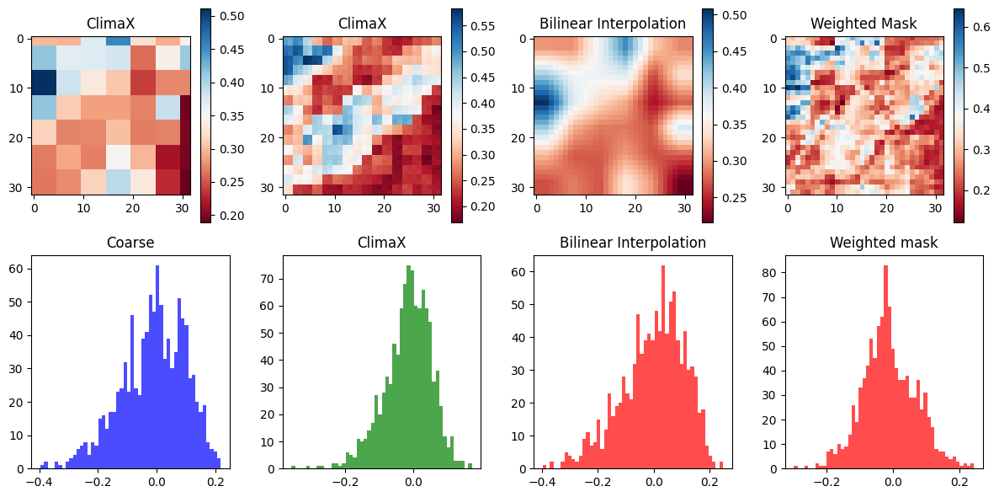

Time step 55
tensor(0.1480, device='cuda:0')


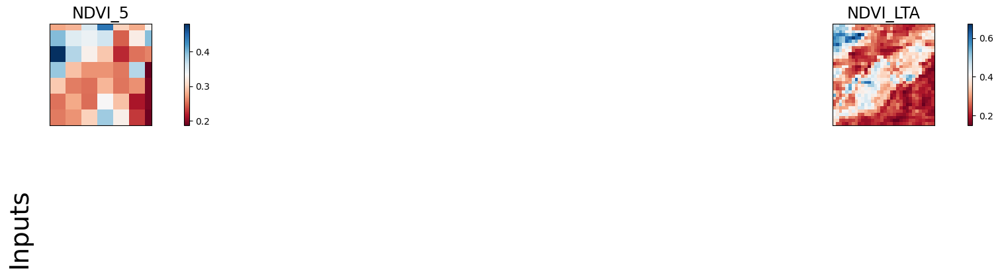

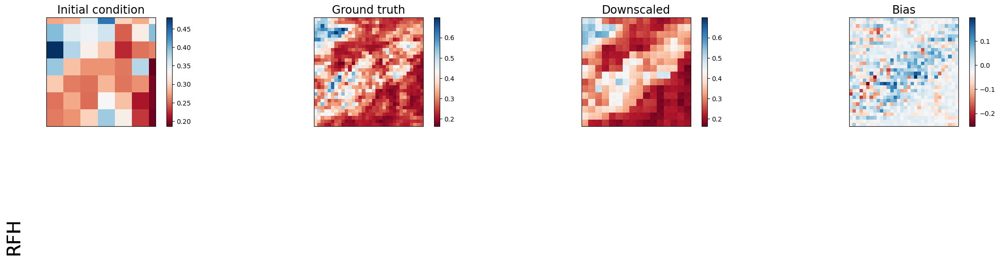

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+----------------------+-----------------------+------------------------+------------------------+
|                      | Coarse               | ClimaX                | Bilinear Interpolation | Weighted Mask          |
+----------------------+----------------------+-----------------------+------------------------+------------------------+
| lat_weighted_mse_val | 0.013612044043838978 | 0.002966837491840124  | 0.012457828968763351   | 0.006568335462361574   |
| lat_weighted_rmse    | 0.01521356776356697  | 0.007102582603693008  | 0.014554274268448353   | 0.010568101890385151   |
| spearman             | 0.11352251085456617  | 0.8559040378545035    | -0.0057041961288723025 | 0.6388817222729246     |
| mean_bias            | 0.002012580633163452 | -0.001036137342453003 | -0.0007714927196502686 | -0.0018833577632904053 |
| pear

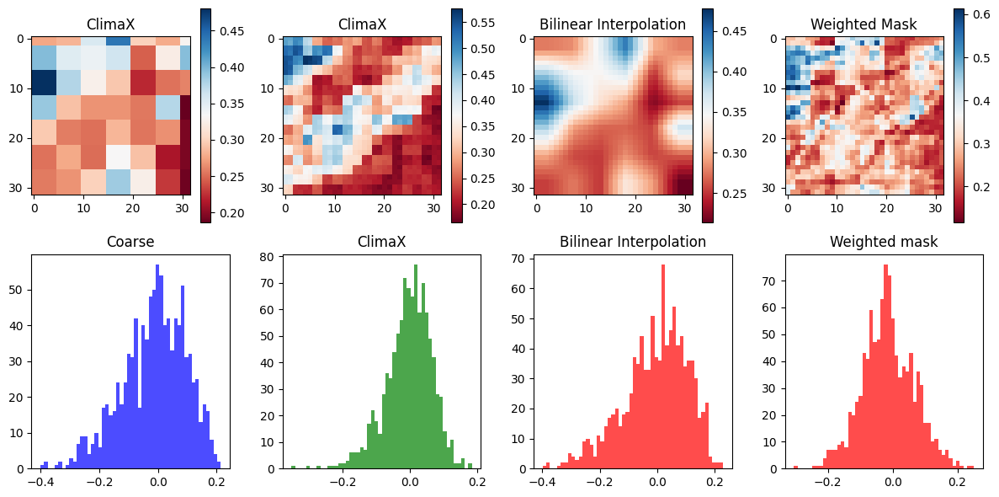

Time step 56
tensor(0.1405, device='cuda:0')


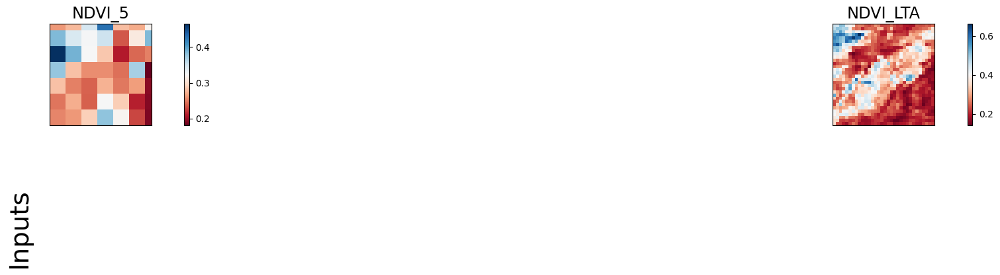

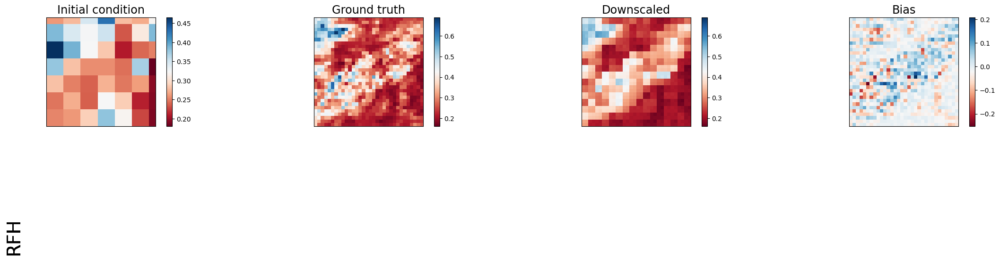

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+----------------------+------------------------+------------------------+------------------------+
|                      | Coarse               | ClimaX                 | Bilinear Interpolation | Weighted Mask          |
+----------------------+----------------------+------------------------+------------------------+------------------------+
| lat_weighted_mse_val | 0.01407231017947197  | 0.002869469579309225   | 0.012635464780032635   | 0.006670498289167881   |
| lat_weighted_rmse    | 0.015468638390302658 | 0.006985062267631292   | 0.014657671563327312   | 0.010649974457919598   |
| spearman             | 0.09902897600382439  | 0.8581221566517924     | -0.03866787369167967   | 0.6154932875651017     |
| mean_bias            | 0.003088921308517456 | -0.0012355148792266846 | -0.0009628832340240479 | -0.0019664764404296875 |

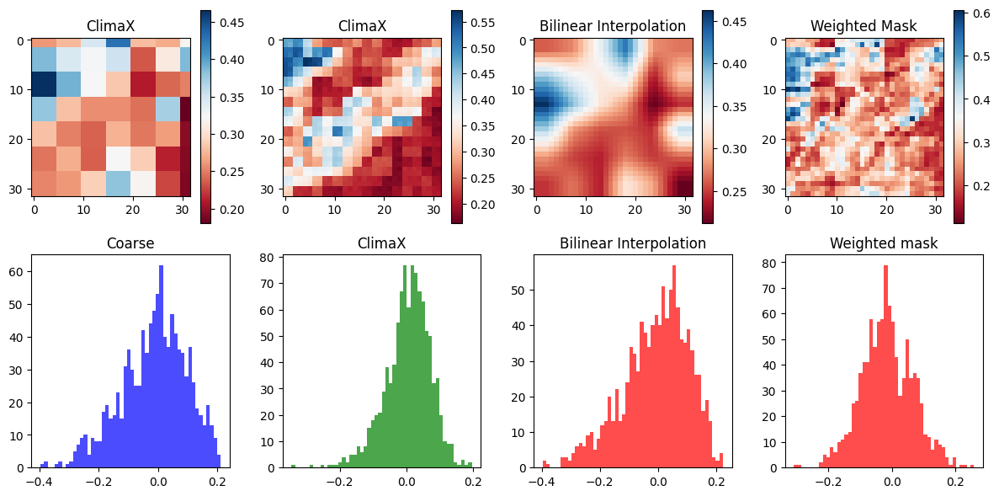

Time step 57
tensor(0.1351, device='cuda:0')


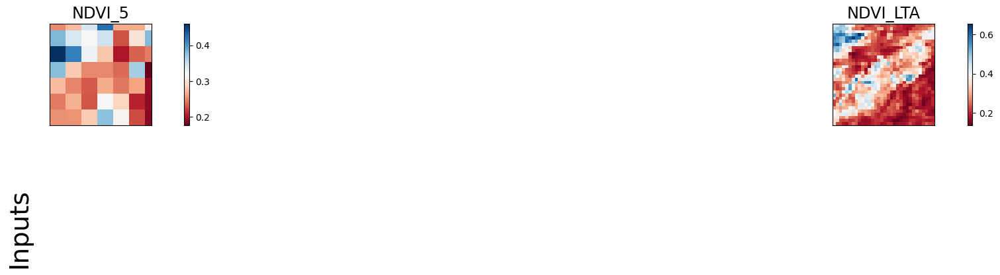

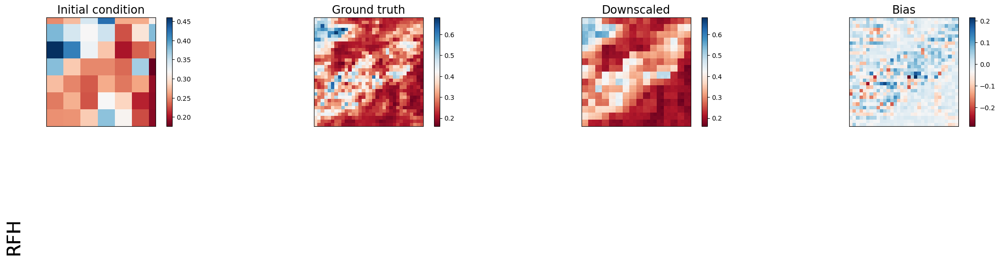

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+----------------------+-----------------------+------------------------+------------------------+
|                      | Coarse               | ClimaX                | Bilinear Interpolation | Weighted Mask          |
+----------------------+----------------------+-----------------------+------------------------+------------------------+
| lat_weighted_mse_val | 0.014501446858048439 | 0.002912779338657856  | 0.013120102696120739   | 0.006919779349118471   |
| lat_weighted_rmse    | 0.01570272631943226  | 0.007037576287984848  | 0.01493612676858902    | 0.010847145691514015   |
| spearman             | 0.11148472141851966  | 0.8570763989266261    | -0.06050128867824191   | 0.6030513303792138     |
| mean_bias            | 0.003592938184738159 | -0.001355201005935669 | -0.0009610950946807861 | -0.0019721686840057373 |
| pear

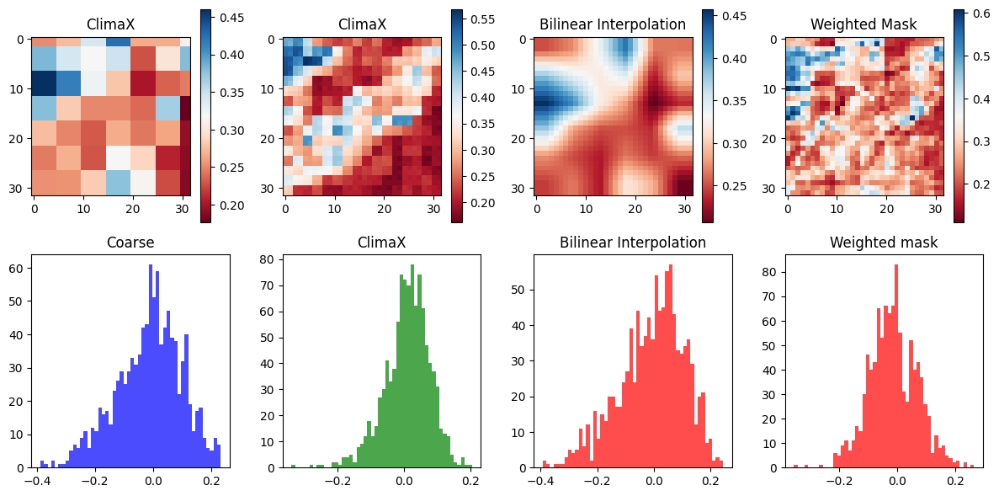

Time step 58
tensor(0.1316, device='cuda:0')


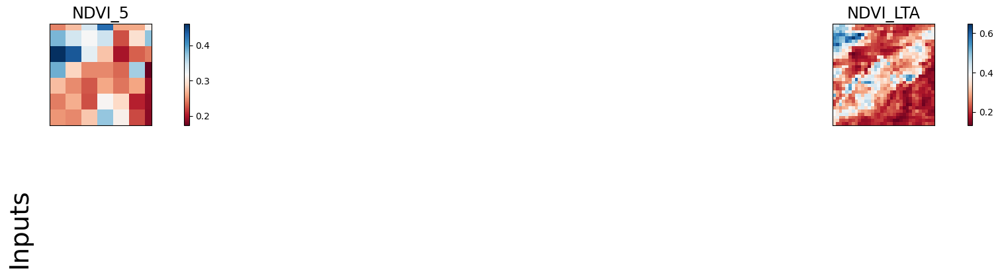

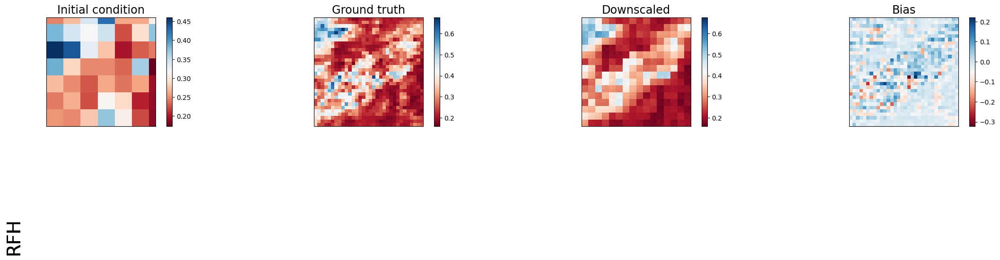

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+----------------------+------------------------+------------------------+-----------------------+
|                      | Coarse               | ClimaX                 | Bilinear Interpolation | Weighted Mask         |
+----------------------+----------------------+------------------------+------------------------+-----------------------+
| lat_weighted_mse_val | 0.014834090135991573 | 0.0030295001342892647  | 0.013817866332828999   | 0.007306929677724838  |
| lat_weighted_rmse    | 0.015881802886724472 | 0.007177196908742189   | 0.01532815396785736    | 0.011146456934511662  |
| spearman             | 0.11452330711140757  | 0.856982397727089      | -0.0711843351448955    | 0.5987247333242041    |
| mean_bias            | 0.003758460283279419 | -0.0014448165893554688 | -0.0008967816829681396 | -0.001994609832763672 |
| pear

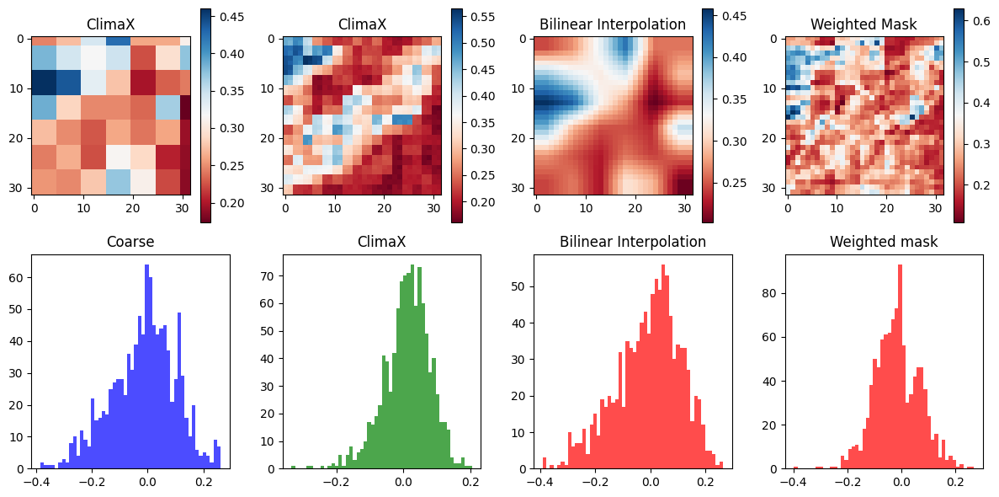

Time step 59
tensor(0.1292, device='cuda:0')


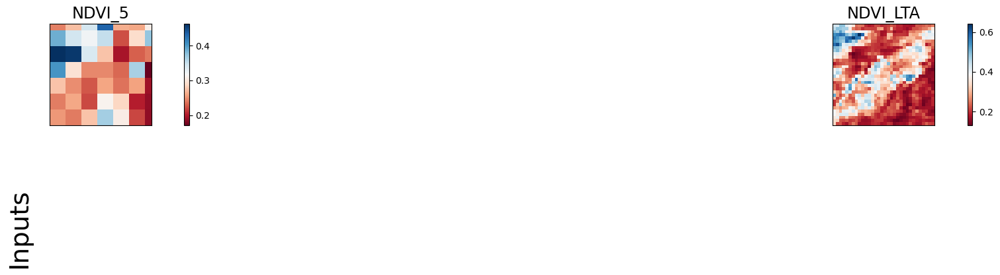

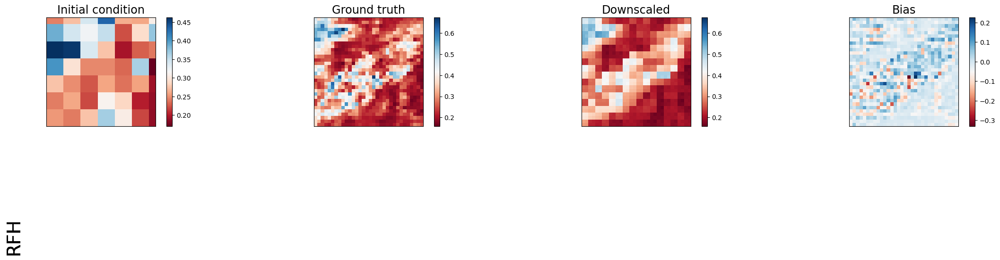

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+----------------------+-----------------------+------------------------+------------------------+
|                      | Coarse               | ClimaX                | Bilinear Interpolation | Weighted Mask          |
+----------------------+----------------------+-----------------------+------------------------+------------------------+
| lat_weighted_mse_val | 0.015111630782485008 | 0.003156389808282256  | 0.014700920321047306   | 0.007823601365089417   |
| lat_weighted_rmse    | 0.016029685735702515 | 0.0073259626515209675 | 0.01581035740673542    | 0.011533808894455433   |
| spearman             | 0.11158851167610523  | 0.8584988443127813    | -0.07627728676207493   | 0.6017766838944205     |
| mean_bias            | 0.003732234239578247 | -0.001553952693939209 | -0.0008164644241333008 | -0.0020592808723449707 |
| pear

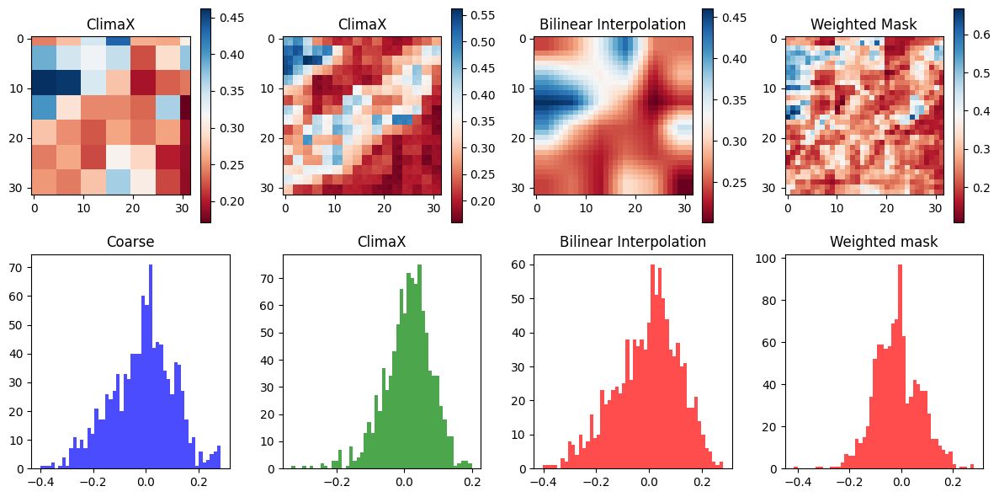

Time step 60
tensor(0.1275, device='cuda:0')


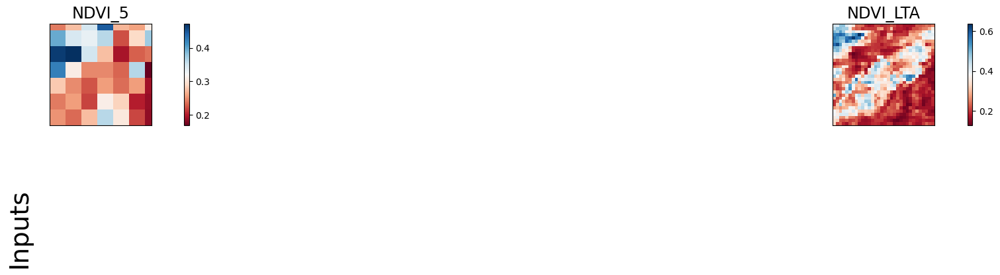

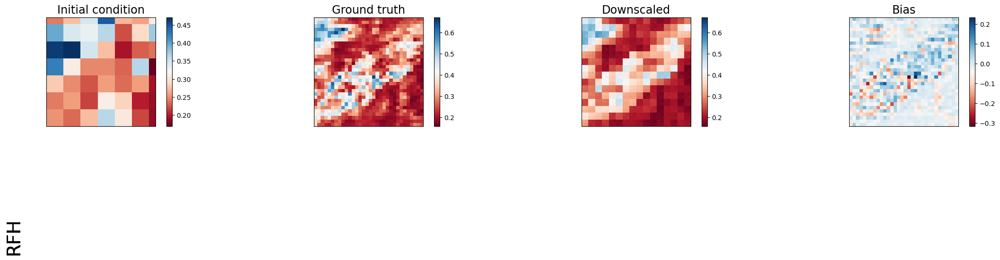

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+-----------------------+------------------------+------------------------+------------------------+
|                      | Coarse                | ClimaX                 | Bilinear Interpolation | Weighted Mask          |
+----------------------+-----------------------+------------------------+------------------------+------------------------+
| lat_weighted_mse_val | 0.015363985672593117  | 0.003295627888292074   | 0.015738271176815033   | 0.00846894085407257    |
| lat_weighted_rmse    | 0.016162974759936333  | 0.0074858046136796474  | 0.016358667984604836   | 0.012000073678791523   |
| spearman             | 0.10366811161651893   | 0.8593634525577478     | -0.08157808243358113   | 0.6044809124344391     |
| mean_bias            | 0.0035046041011810303 | -0.0017056167125701904 | -0.0007056593894958496 | -0.00212445855140

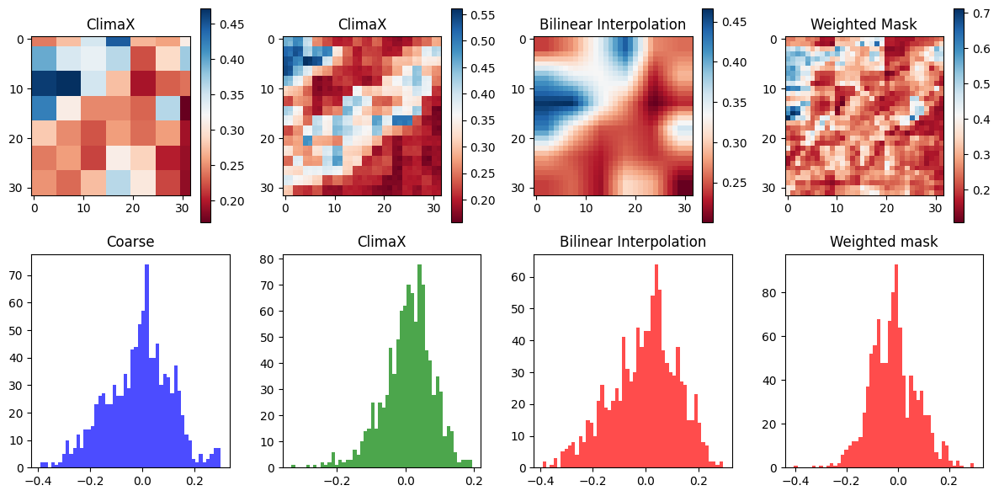

Time step 61
tensor(0.1264, device='cuda:0')


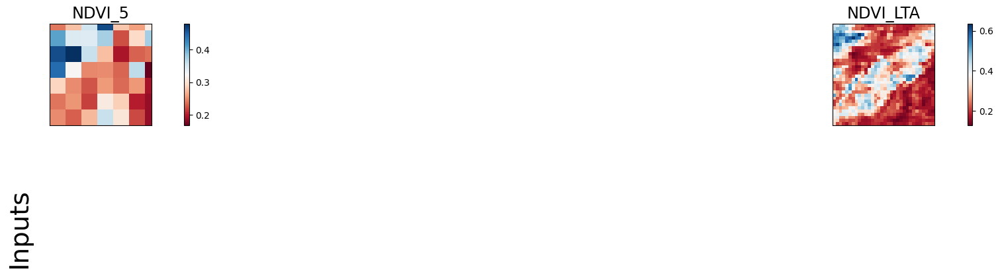

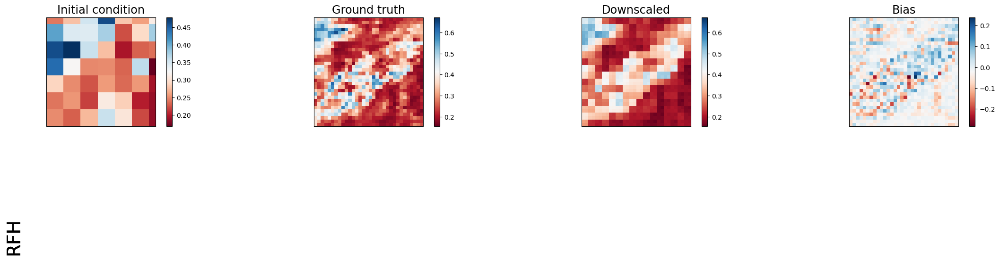

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+-----------------------+------------------------+------------------------+------------------------+
|                      | Coarse                | ClimaX                 | Bilinear Interpolation | Weighted Mask          |
+----------------------+-----------------------+------------------------+------------------------+------------------------+
| lat_weighted_mse_val | 0.015624076128005981  | 0.0034503410570323467  | 0.016827993094921112   | 0.009182239882647991   |
| lat_weighted_rmse    | 0.016299212351441383  | 0.007659498136490583   | 0.01691552624106407    | 0.012495212256908417   |
| spearman             | 0.09479485393453715   | 0.859633377451414      | -0.0923978524629693    | 0.599907582669491      |
| mean_bias            | 0.0031635165214538574 | -0.0018734335899353027 | -0.0005533695220947266 | -0.00214487314224

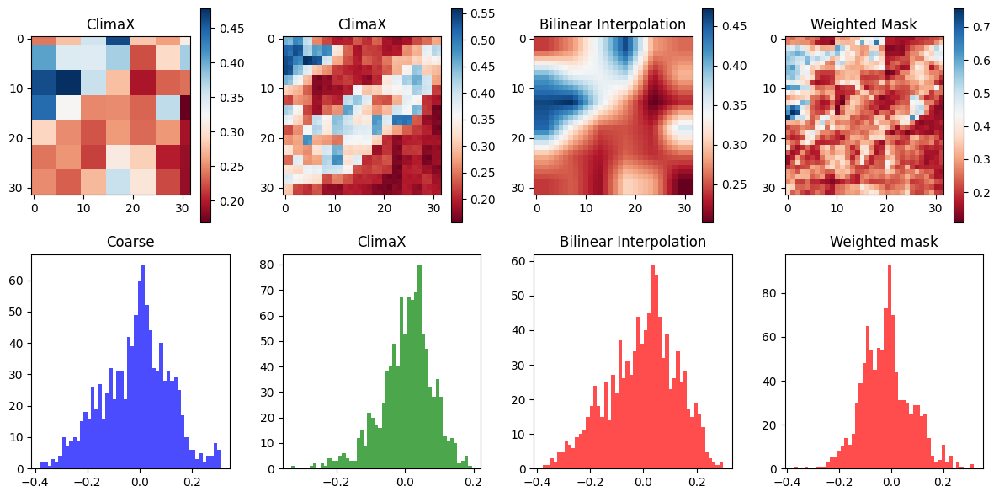

Time step 62
tensor(0.1261, device='cuda:0')


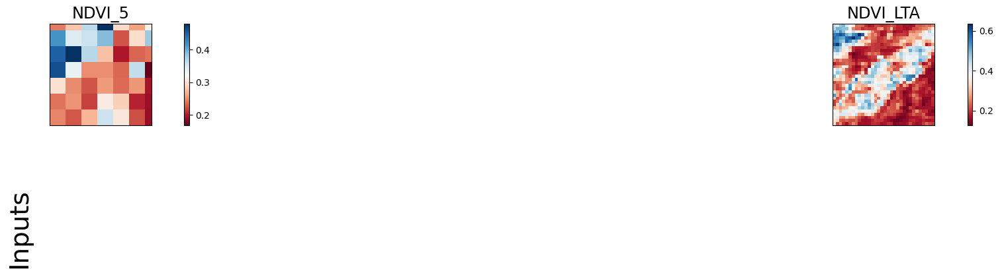

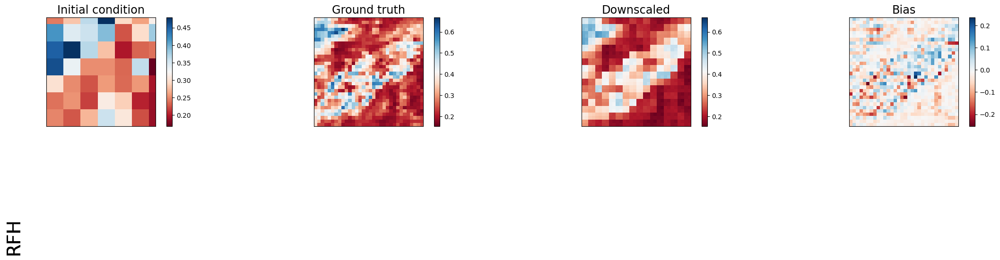

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+-----------------------+------------------------+-------------------------+-----------------------+
|                      | Coarse                | ClimaX                 | Bilinear Interpolation  | Weighted Mask         |
+----------------------+-----------------------+------------------------+-------------------------+-----------------------+
| lat_weighted_mse_val | 0.015903178602457047  | 0.003597420174628496   | 0.01786196231842041     | 0.009876785799860954  |
| lat_weighted_rmse    | 0.016444144770503044  | 0.007821048609912395   | 0.017427455633878708    | 0.012959172017872334  |
| spearman             | 0.08507919137202323   | 0.8604519923419541     | -0.1057541520935463     | 0.5901533389508667    |
| mean_bias            | 0.0028007924556732178 | -0.0020020902156829834 | -0.00035578012466430664 | -0.0020934045314

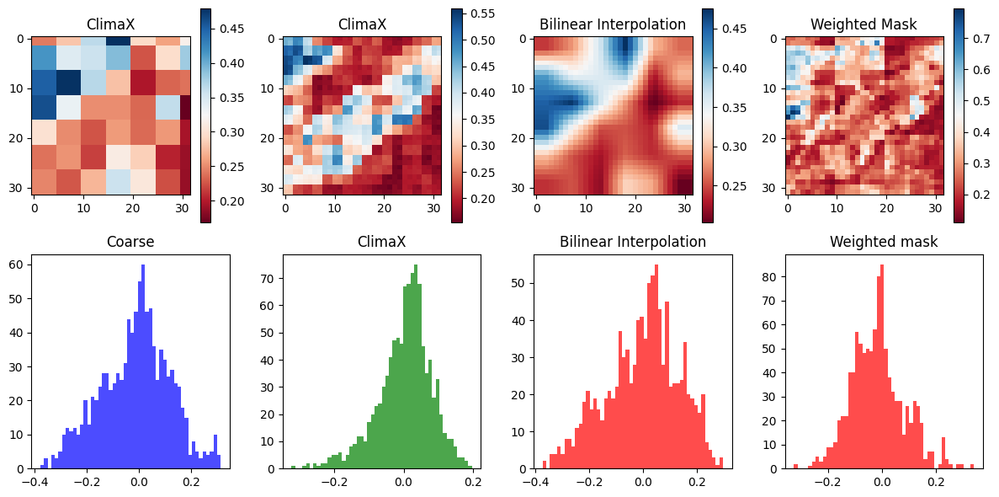

Time step 63
tensor(0.1266, device='cuda:0')


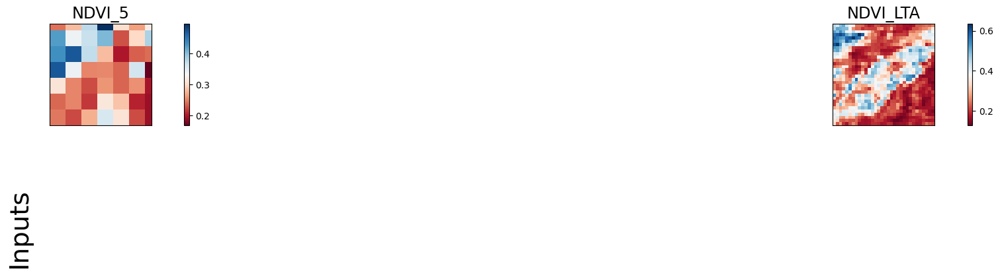

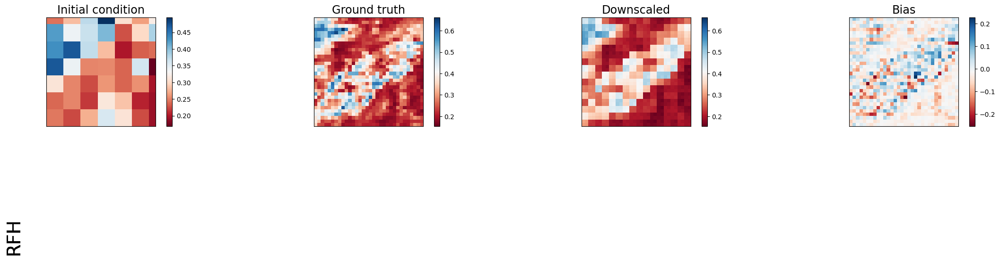

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+----------------------+-----------------------+-------------------------+------------------------+
|                      | Coarse               | ClimaX                | Bilinear Interpolation  | Weighted Mask          |
+----------------------+----------------------+-----------------------+-------------------------+------------------------+
| lat_weighted_mse_val | 0.01617184840142727  | 0.0036453506909310818 | 0.018533218652009964    | 0.010321330279111862   |
| lat_weighted_rmse    | 0.016582468524575233 | 0.007872977294027805  | 0.017751896753907204    | 0.013247600756585598   |
| spearman             | 0.07835090601144916  | 0.8608725260257842    | -0.11984331970831284    | 0.5779431140982773     |
| mean_bias            | 0.002531677484512329 | -0.001981288194656372 | -0.00017449259757995605 | -0.0020031630992889404 |

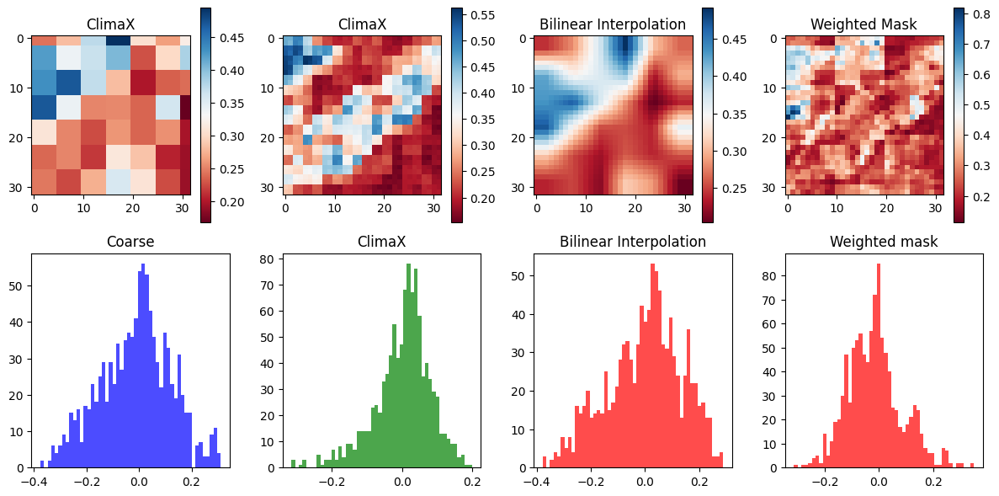

Time step 64
tensor(0.1284, device='cuda:0')


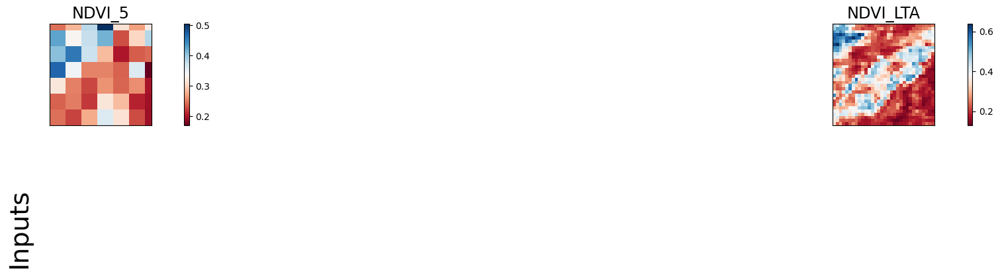

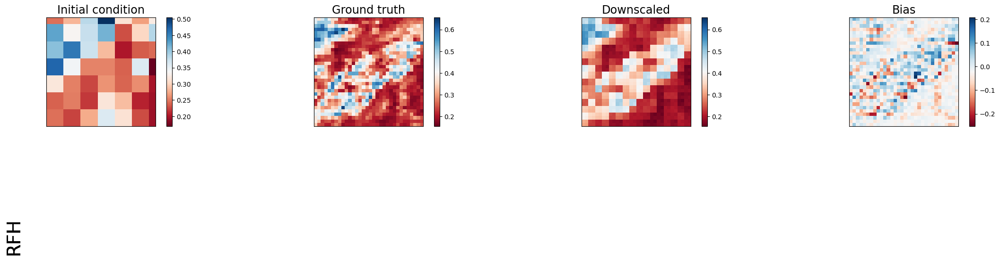

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+-----------------------+------------------------+-------------------------+------------------------+
|                      | Coarse                | ClimaX                 | Bilinear Interpolation  | Weighted Mask          |
+----------------------+-----------------------+------------------------+-------------------------+------------------------+
| lat_weighted_mse_val | 0.016341686248779297  | 0.0035408935509622097  | 0.018558550626039505    | 0.010360421612858772   |
| lat_weighted_rmse    | 0.016669318079948425  | 0.0077593582682311535  | 0.017764028161764145    | 0.01327266450971365    |
| spearman             | 0.07461663648131668   | 0.860868529941618      | -0.12977217935977223    | 0.5665804551265717     |
| mean_bias            | 0.0023859739303588867 | -0.0017115771770477295 | -3.8623809814453125e-05 | -0.0018717

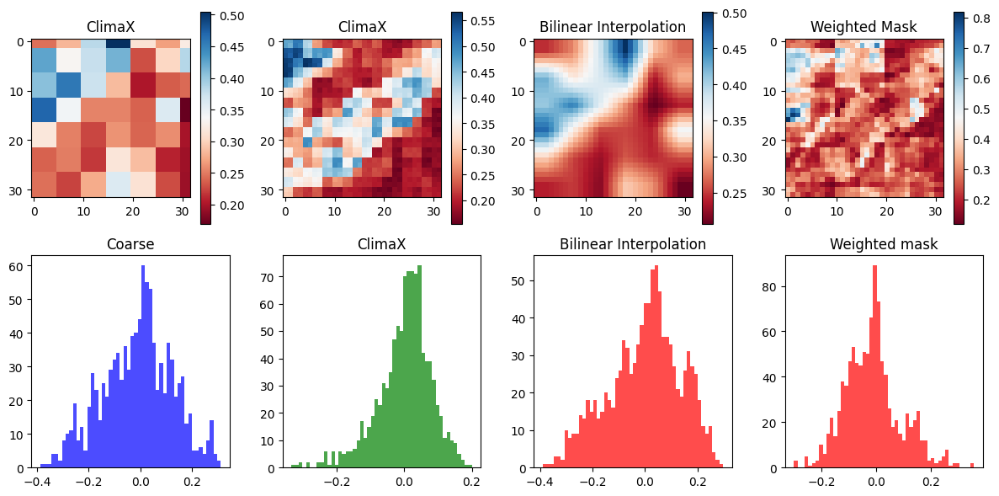

Time step 65
tensor(0.1318, device='cuda:0')


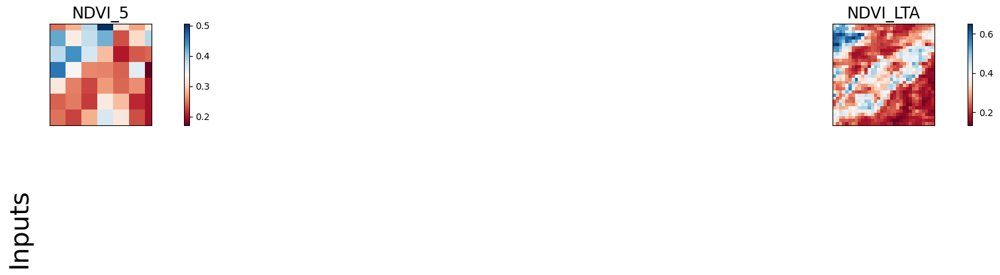

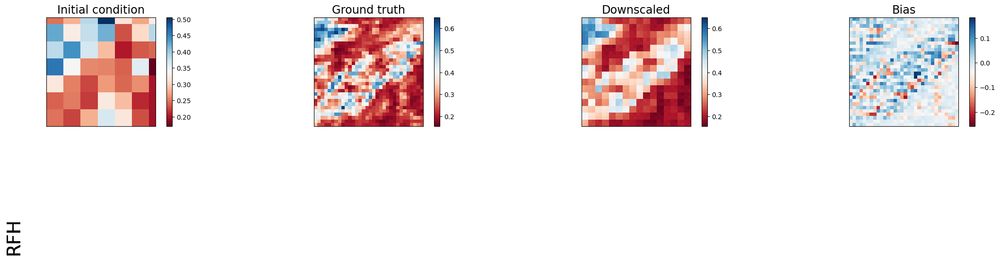

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+-----------------------+------------------------+------------------------+-----------------------+
|                      | Coarse                | ClimaX                 | Bilinear Interpolation | Weighted Mask         |
+----------------------+-----------------------+------------------------+------------------------+-----------------------+
| lat_weighted_mse_val | 0.01629599556326866   | 0.0033175621647387743  | 0.017725851386785507   | 0.009886378422379494  |
| lat_weighted_rmse    | 0.016645995900034904  | 0.007510674186050892   | 0.017360925674438477   | 0.012965463101863861  |
| spearman             | 0.068783484445684     | 0.8577179600002588     | -0.13042533239944182   | 0.5586225091092671    |
| mean_bias            | 0.0023654699325561523 | -0.0012285113334655762 | 7.867813110351562e-06  | -0.001705259084701538 |

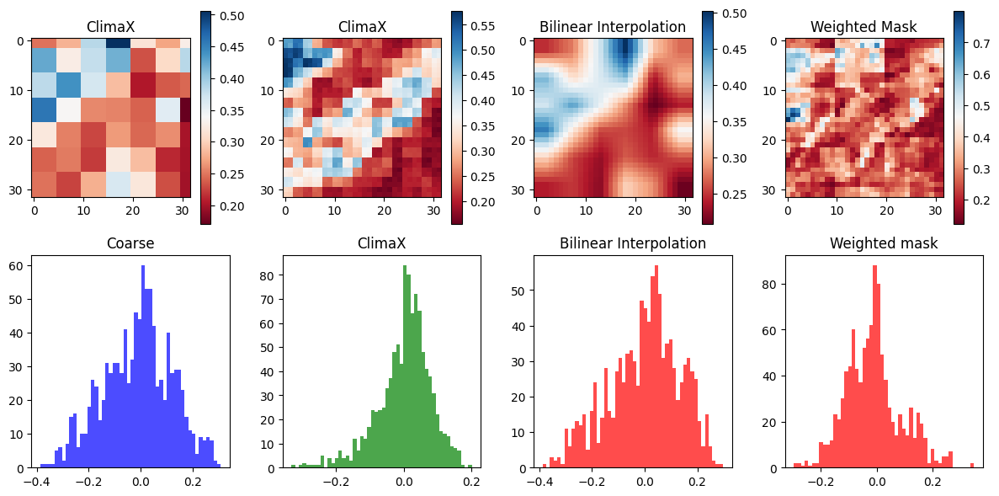

Time step 66
tensor(0.1370, device='cuda:0')


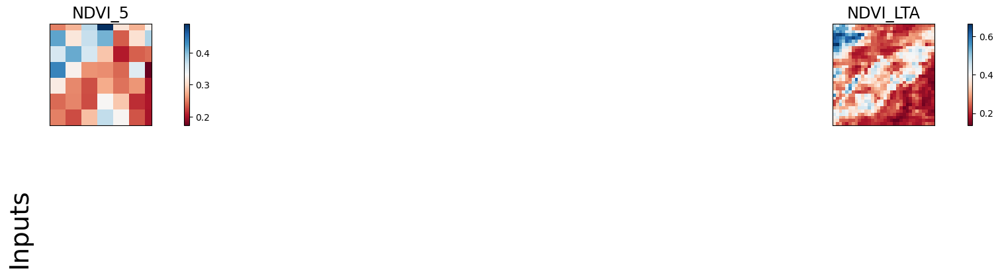

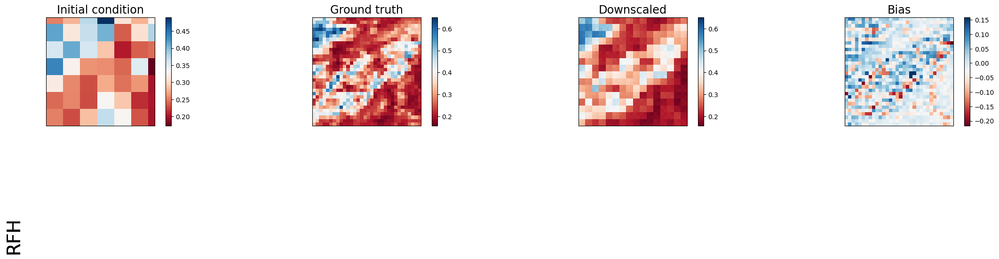

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+----------------------+------------------------+-------------------------+-----------------------+
|                      | Coarse               | ClimaX                 | Bilinear Interpolation  | Weighted Mask         |
+----------------------+----------------------+------------------------+-------------------------+-----------------------+
| lat_weighted_mse_val | 0.015913117676973343 | 0.003007157240062952   | 0.01576845906674862     | 0.00874179694801569   |
| lat_weighted_rmse    | 0.016449283808469772 | 0.007150681689381599   | 0.01637434773147106     | 0.012191854417324066  |
| spearman             | 0.04854275405522295  | 0.8515185742411276     | -0.11912944664476126    | 0.5561658639841981    |
| mean_bias            | 0.002630174160003662 | -0.0007523894309997559 | -0.00012427568435668945 | -0.001565694808959961 |

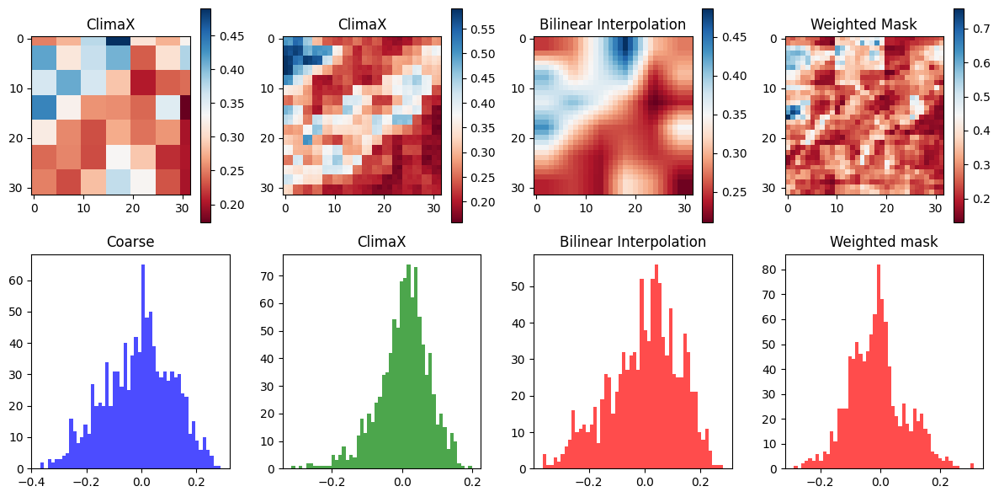

Time step 67
tensor(0.1435, device='cuda:0')


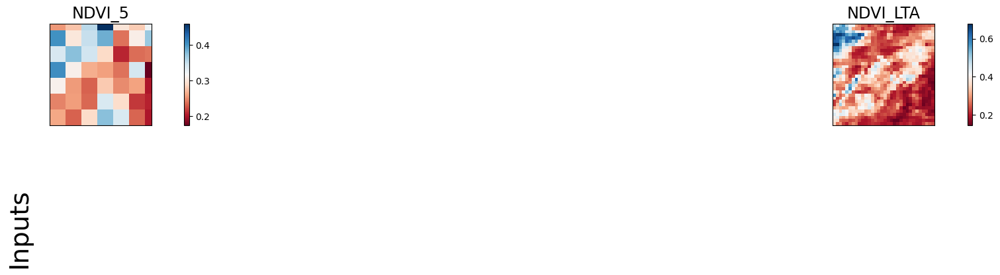

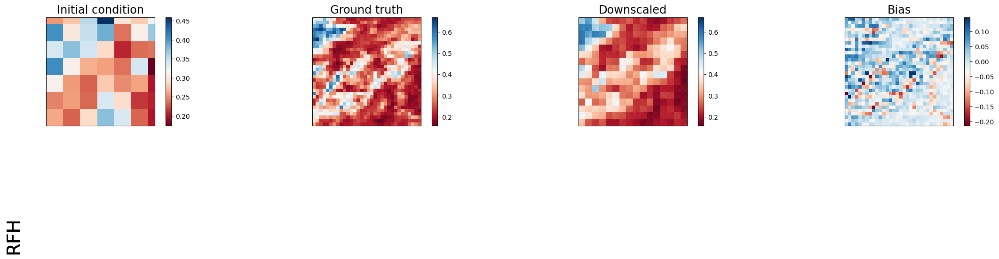

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+-----------------------+------------------------+------------------------+-----------------------+
|                      | Coarse                | ClimaX                 | Bilinear Interpolation | Weighted Mask         |
+----------------------+-----------------------+------------------------+------------------------+-----------------------+
| lat_weighted_mse_val | 0.015360115095973015  | 0.002682800404727459   | 0.013411600142717361   | 0.0074135735630989075 |
| lat_weighted_rmse    | 0.016160940751433372  | 0.006754038855433464   | 0.01510113850235939    | 0.01122750248759985   |
| spearman             | 0.05173823888270288   | 0.842115830550288      | -0.09997753780210208   | 0.5535121213662739    |
| mean_bias            | 0.0030713677406311035 | -0.0005047321319580078 | -0.0003883838653564453 | -0.001445382833480835 |

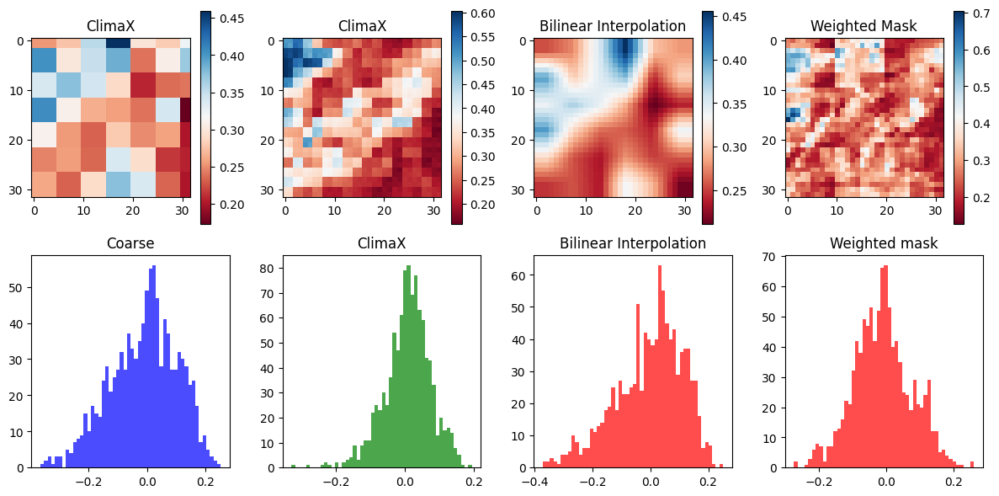

Time step 68
tensor(0.1490, device='cuda:0')


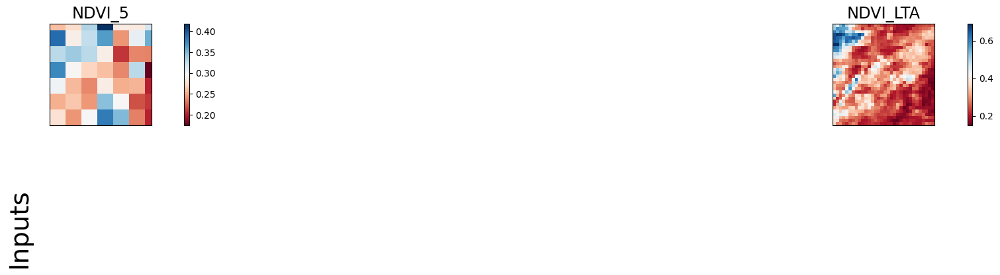

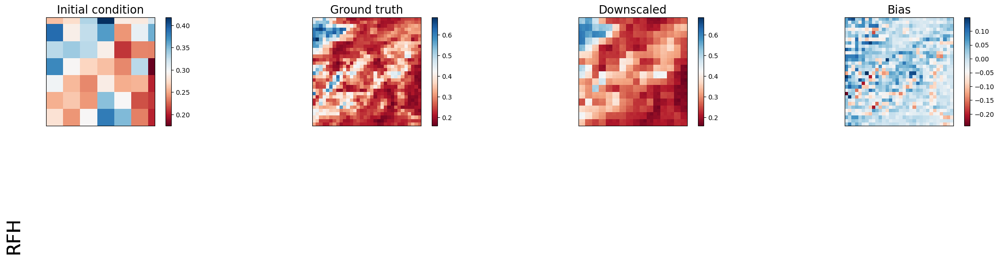

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+-----------------------+------------------------+------------------------+-----------------------+
|                      | Coarse                | ClimaX                 | Bilinear Interpolation | Weighted Mask         |
+----------------------+-----------------------+------------------------+------------------------+-----------------------+
| lat_weighted_mse_val | 0.014781905338168144  | 0.0024106749333441257  | 0.011492110788822174   | 0.006437875796109438  |
| lat_weighted_rmse    | 0.015853844583034515  | 0.006402338854968548   | 0.013978779315948486   | 0.01046262588351965   |
| spearman             | 0.06284214479184931   | 0.8307107807003509     | -0.07054490827084194   | 0.5484959497491082    |
| mean_bias            | 0.0034498274326324463 | -0.0004545450210571289 | -0.0006734132766723633 | -0.001291424036026001 |

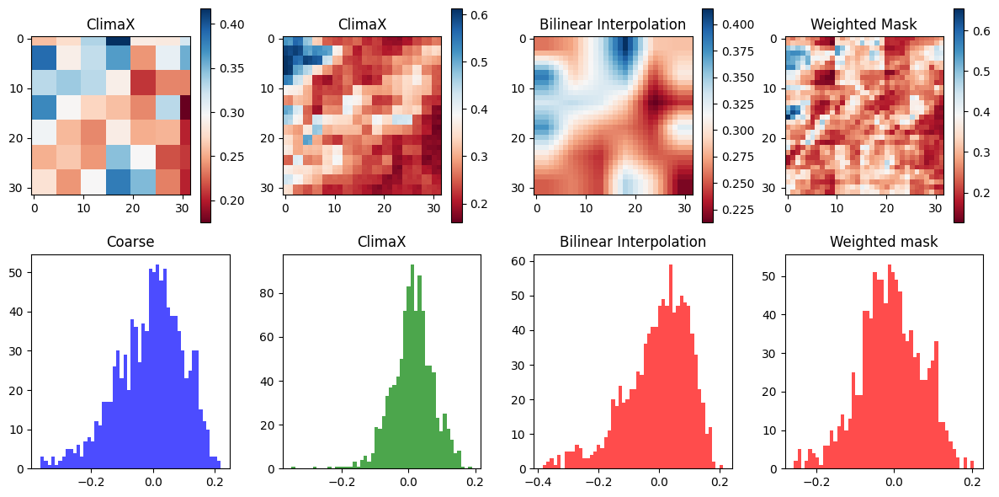

Time step 69
tensor(0.1521, device='cuda:0')


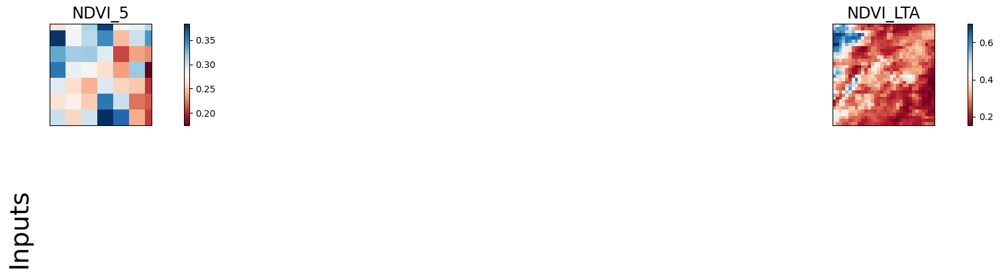

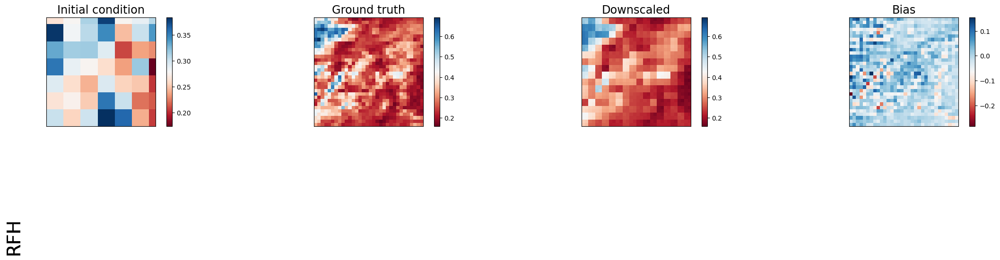

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+-----------------------+-----------------------+------------------------+------------------------+
|                      | Coarse                | ClimaX                | Bilinear Interpolation | Weighted Mask          |
+----------------------+-----------------------+-----------------------+------------------------+------------------------+
| lat_weighted_mse_val | 0.014218101277947426  | 0.0022864961065351963 | 0.01045691967010498    | 0.00599849596619606    |
| lat_weighted_rmse    | 0.01554855890572071   | 0.006235260050743818  | 0.013334331102669239   | 0.01009928248822689    |
| spearman             | 0.078248607706263     | 0.817263244909233     | -0.03499199276262233   | 0.5516267976684888     |
| mean_bias            | 0.0035707056522369385 | -0.000503242015838623 | -0.0008775591850280762 | -0.0010790824890136719 |

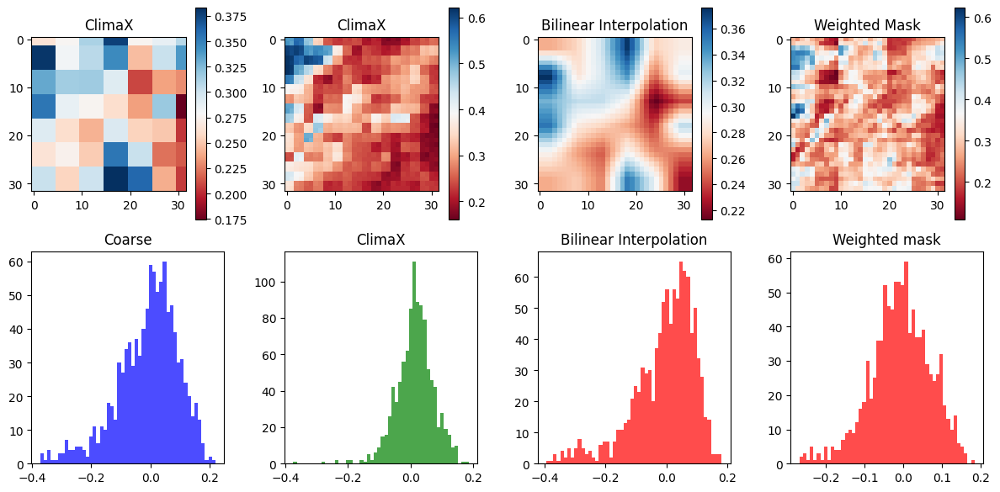

Time step 70
tensor(0.1373, device='cuda:0')


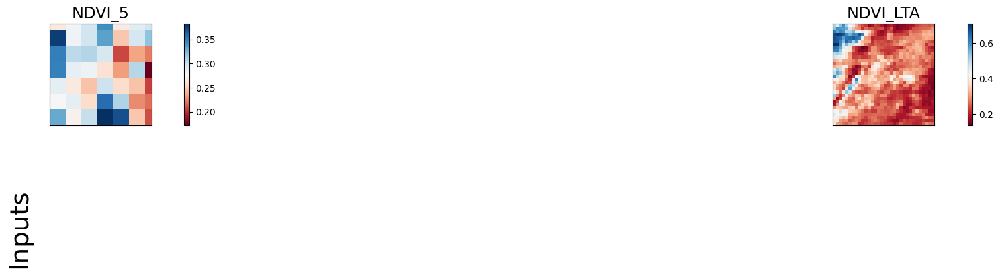

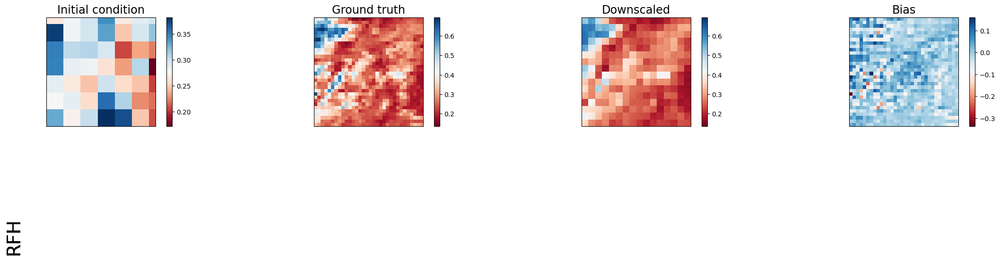

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+-----------------------+-----------------------+------------------------+------------------------+
|                      | Coarse                | ClimaX                | Bilinear Interpolation | Weighted Mask          |
+----------------------+-----------------------+-----------------------+------------------------+------------------------+
| lat_weighted_mse_val | 0.01364361122250557   | 0.0023442073725163937 | 0.010099559091031551   | 0.0058523821644485     |
| lat_weighted_rmse    | 0.015231197699904442  | 0.006313459016382694  | 0.013104503974318504   | 0.009975522756576538   |
| spearman             | 0.10928114173460944   | 0.8021147589473782    | 0.015004778879254619   | 0.5701896968513788     |
| mean_bias            | 0.0034433305263519287 | -0.000471651554107666 | -0.0009420514106750488 | -0.0008188188076019287 |

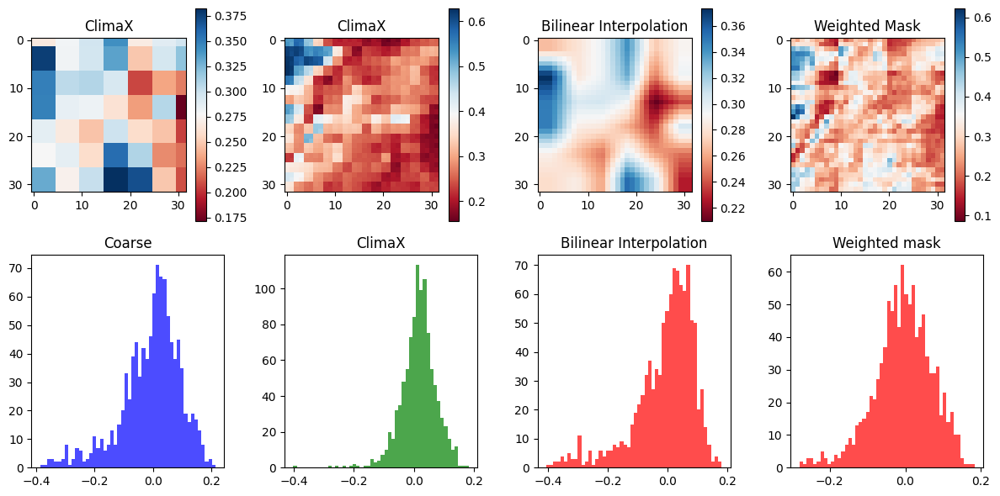

Time step 71
tensor(0.1023, device='cuda:0')


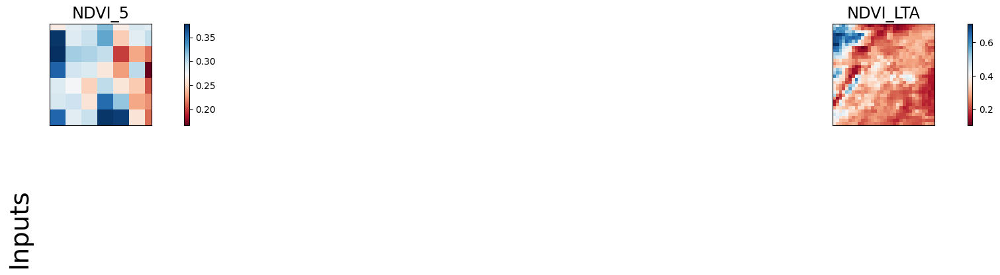

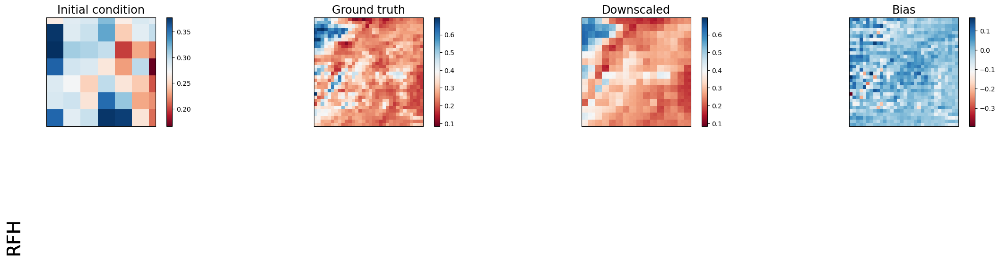

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+-----------------------+-------------------------+------------------------+------------------------+
|                      | Coarse                | ClimaX                  | Bilinear Interpolation | Weighted Mask          |
+----------------------+-----------------------+-------------------------+------------------------+------------------------+
| lat_weighted_mse_val | 0.013121805153787136  | 0.0025573247112333775   | 0.01017282996326685    | 0.00582895427942276    |
| lat_weighted_rmse    | 0.014937097206711769  | 0.006594203878194094    | 0.013151953928172588   | 0.009955537505447865   |
| spearman             | 0.14913233456660605   | 0.7873848682110207      | 0.07569998332871256    | 0.6004849051298696     |
| mean_bias            | 0.0032920539379119873 | -0.00020650029182434082 | -0.0008752942085266113 | -0.0005823

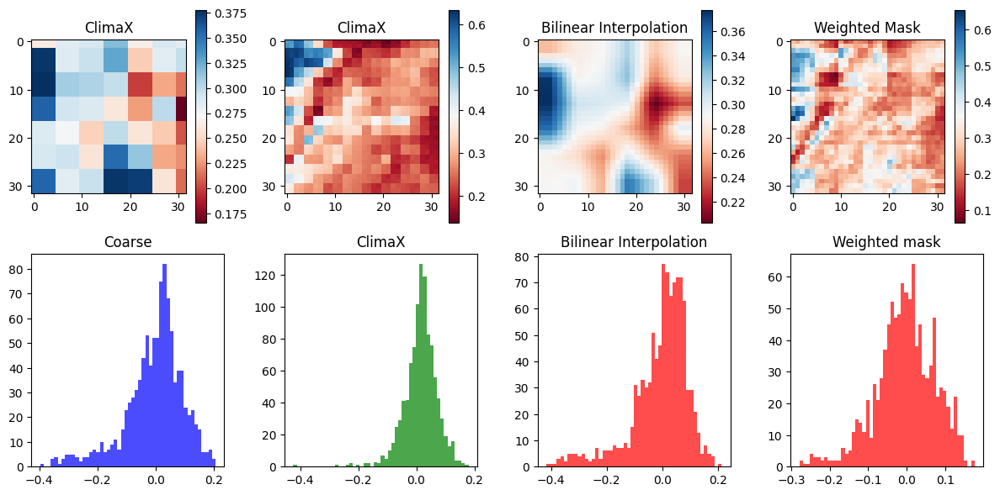

Time step 72
tensor(0.0602, device='cuda:0')


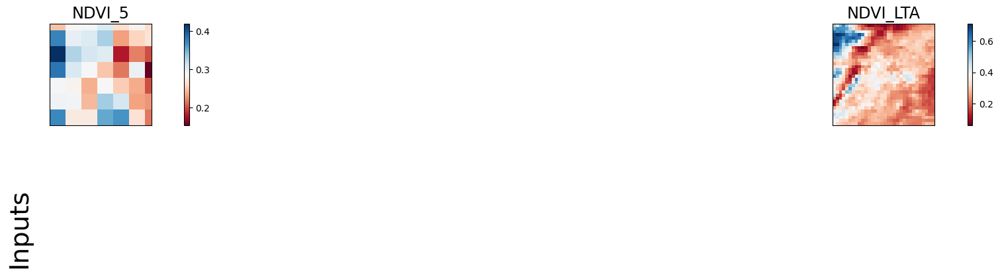

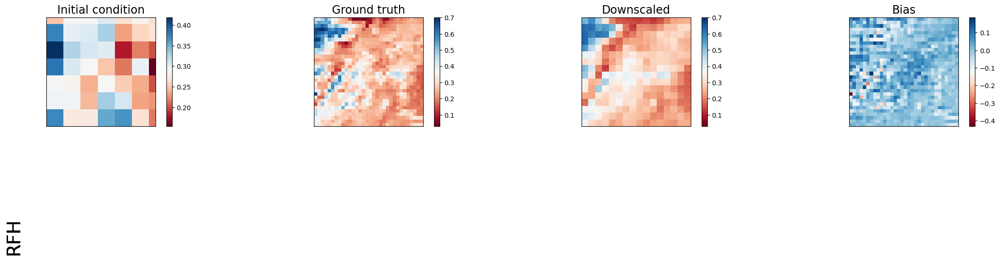

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+----------------------+------------------------+------------------------+------------------------+
|                      | Coarse               | ClimaX                 | Bilinear Interpolation | Weighted Mask          |
+----------------------+----------------------+------------------------+------------------------+------------------------+
| lat_weighted_mse_val | 0.012968352064490318 | 0.0028135175816714764  | 0.011138238944113255   | 0.006359936203807592   |
| lat_weighted_rmse    | 0.014849500730633736 | 0.0069166249595582485  | 0.013761875219643116   | 0.010399100370705128   |
| spearman             | 0.1974444566540301   | 0.7955358683958905     | 0.06980268089078247    | 0.6160577963322331     |
| mean_bias            | 0.003628462553024292 | 0.00034987926483154297 | -0.0007478296756744385 | -0.0005266666412353516 |

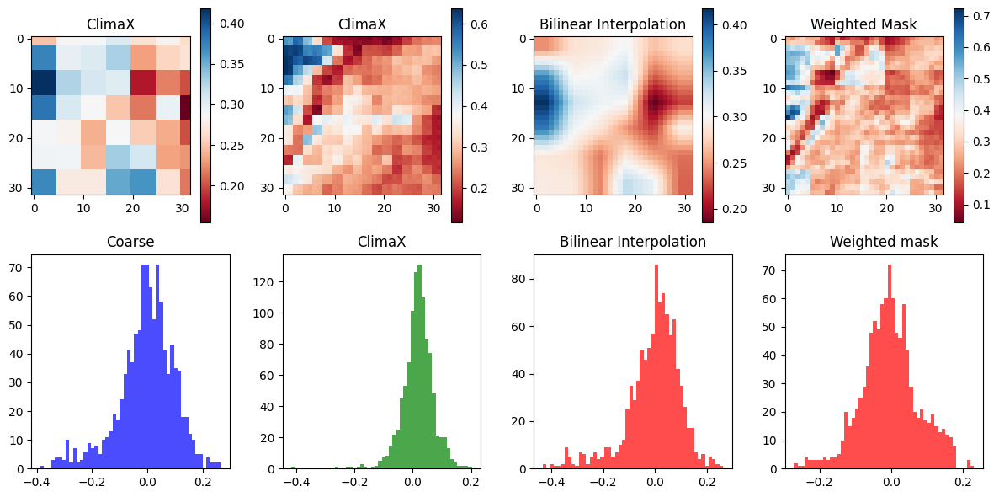

Time step 73
tensor(0.0255, device='cuda:0')


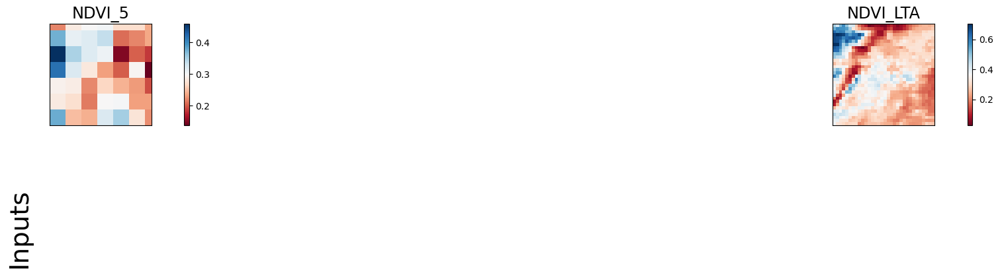

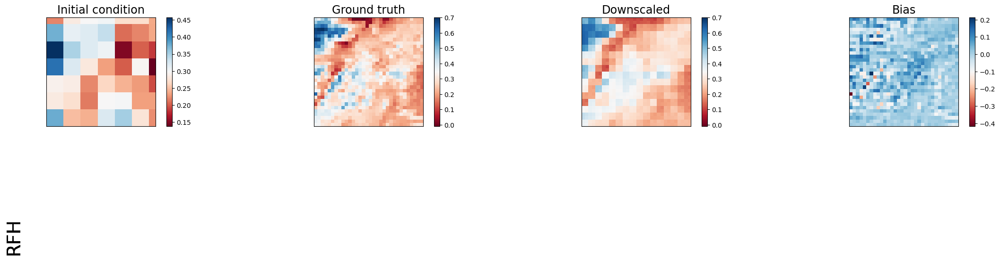

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+----------------------+-----------------------+------------------------+------------------------+
|                      | Coarse               | ClimaX                | Bilinear Interpolation | Weighted Mask          |
+----------------------+----------------------+-----------------------+------------------------+------------------------+
| lat_weighted_mse_val | 0.013753946870565414 | 0.002948356093838811  | 0.014261947944760323   | 0.00870823860168457    |
| lat_weighted_rmse    | 0.015292661264538765 | 0.007080425042659044  | 0.015572517178952694   | 0.012168429791927338   |
| spearman             | 0.18428811226114256  | 0.8364288299429828    | -0.05116627265843508   | 0.5829617944183914     |
| mean_bias            | 0.004501938819885254 | 0.0010135769844055176 | -0.0005240440368652344 | -0.0005635619163513184 |
| pear

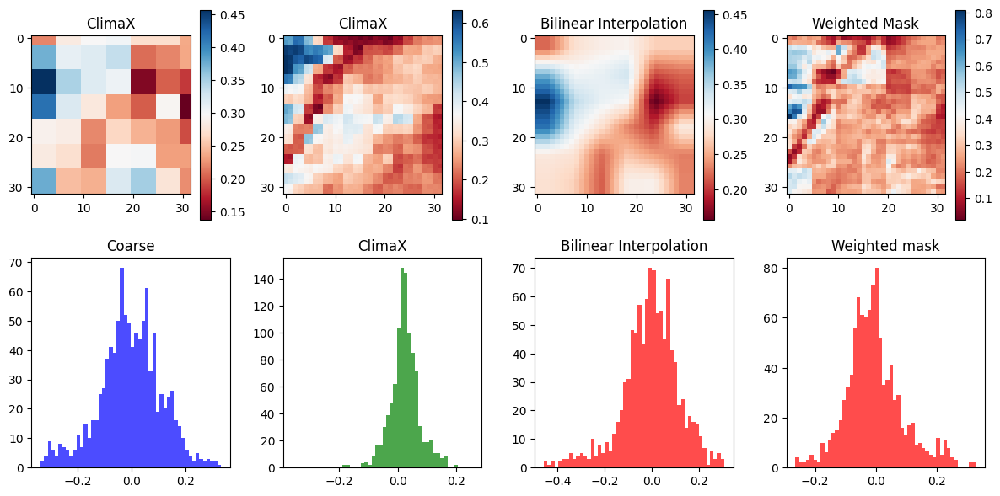

Time step 74
tensor(0.0046, device='cuda:0')


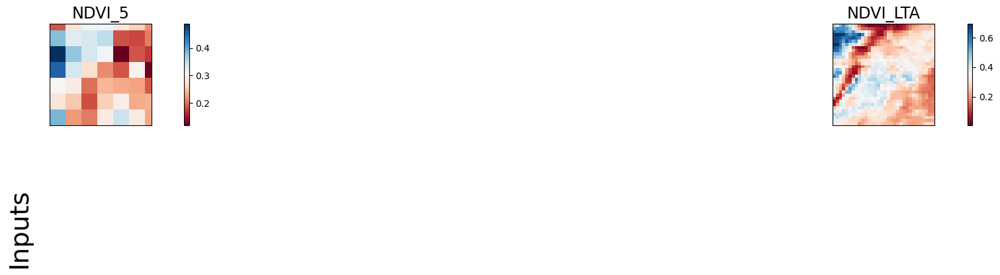

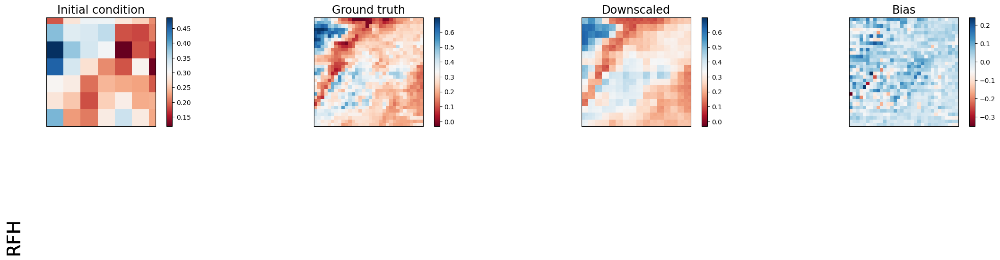

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+----------------------+-----------------------+------------------------+------------------------+
|                      | Coarse               | ClimaX                | Bilinear Interpolation | Weighted Mask          |
+----------------------+----------------------+-----------------------+------------------------+------------------------+
| lat_weighted_mse_val | 0.015363877639174461 | 0.003196720965206623  | 0.020173102617263794   | 0.013386992737650871   |
| lat_weighted_rmse    | 0.016162920743227005 | 0.0073726181872189045 | 0.018520629033446312   | 0.015087278559803963   |
| spearman             | 0.17524380495698033  | 0.8657754345868145    | -0.18063538802535467   | 0.4967751713123582     |
| mean_bias            | 0.005211144685745239 | 0.0019195973873138428 | 5.739927291870117e-05  | -0.0003058910369873047 |
| pear

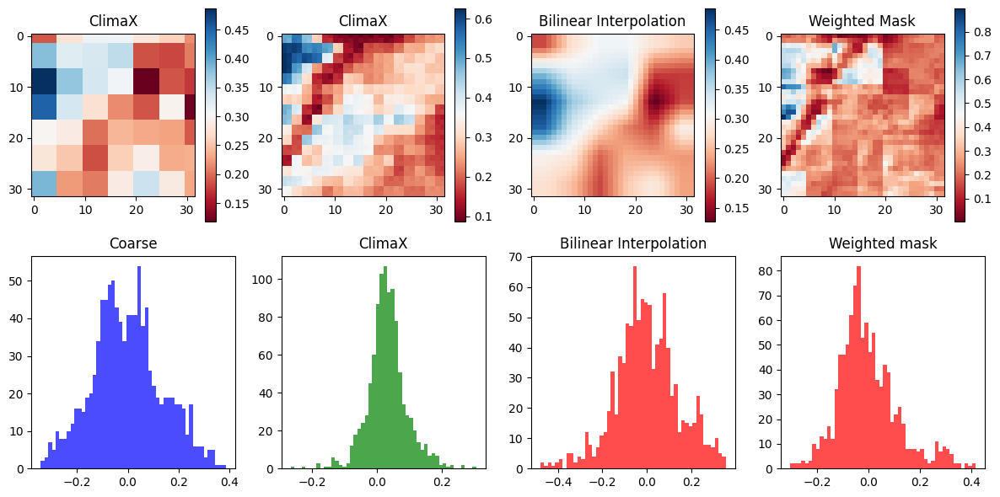

Time step 75
tensor(-0.0047, device='cuda:0')


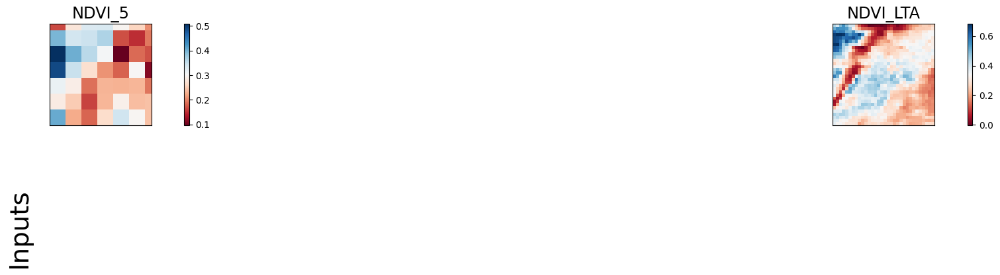

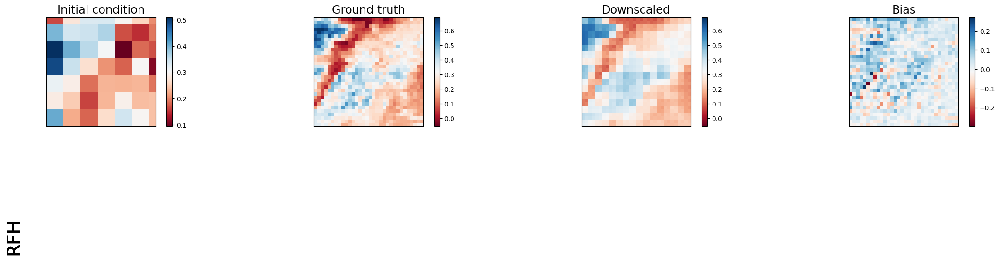

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+----------------------+-----------------------+------------------------+-----------------------+
|                      | Coarse               | ClimaX                | Bilinear Interpolation | Weighted Mask         |
+----------------------+----------------------+-----------------------+------------------------+-----------------------+
| lat_weighted_mse_val | 0.01683628000319004  | 0.003943797666579485  | 0.027750162407755852   | 0.019186878576874733  |
| lat_weighted_rmse    | 0.0169196929782629   | 0.00818892102688551   | 0.02172211743891239    | 0.01806223765015602   |
| spearman             | 0.17266238491427177  | 0.8832594651481398    | -0.2642450537155077    | 0.4261406050281614    |
| mean_bias            | 0.005059987306594849 | 0.0029602646827697754 | 0.0010665953159332275  | 0.0004404783248901367 |
| pearson    

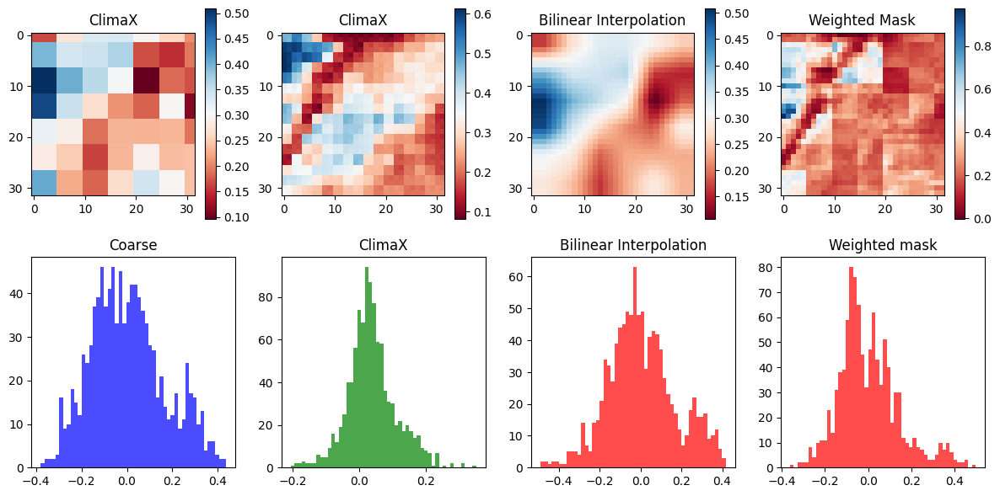

Time step 76
tensor(-0.0021, device='cuda:0')


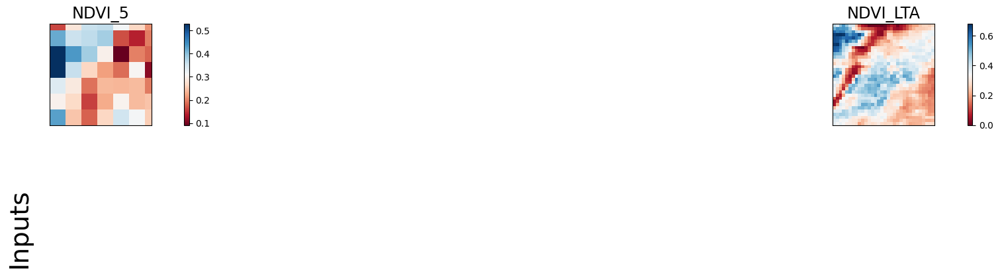

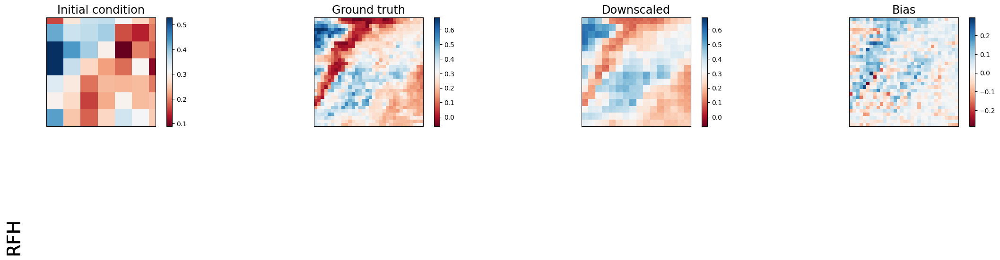

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+-----------------------+-----------------------+------------------------+-----------------------+
|                      | Coarse                | ClimaX                | Bilinear Interpolation | Weighted Mask         |
+----------------------+-----------------------+-----------------------+------------------------+-----------------------+
| lat_weighted_mse_val | 0.017357097938656807  | 0.004873789846897125  | 0.034394845366477966   | 0.023669665679335594  |
| lat_weighted_rmse    | 0.017179397866129875  | 0.009103382006287575  | 0.024183325469493866   | 0.020061593502759933  |
| spearman             | 0.17658250868002873   | 0.8931345001833112    | -0.30282336390051323   | 0.39869604019701593   |
| mean_bias            | 0.0037852823734283447 | 0.0036384761333465576 | 0.0023190975189208984  | 0.0015402436256408691 |
| pear

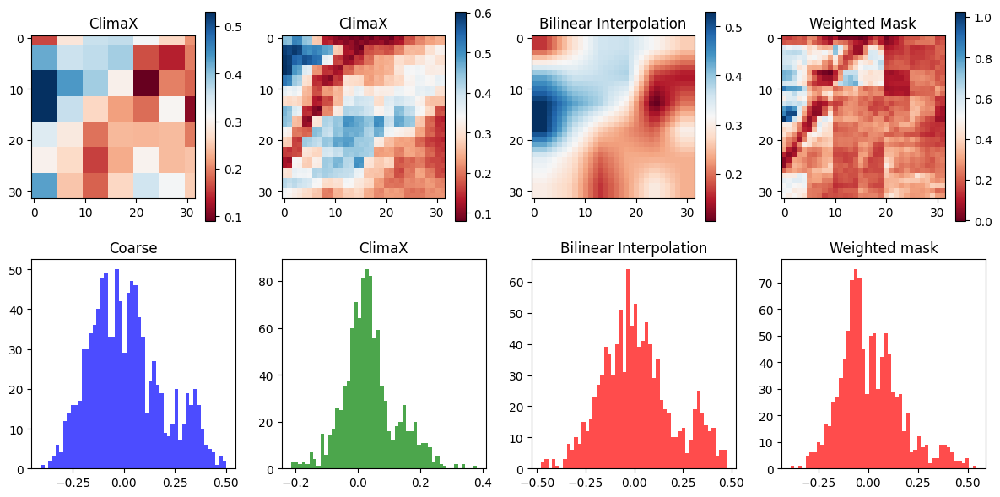

Time step 77
tensor(0.0097, device='cuda:0')


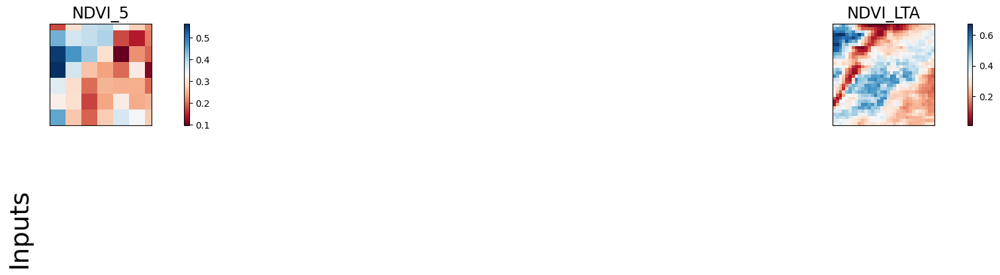

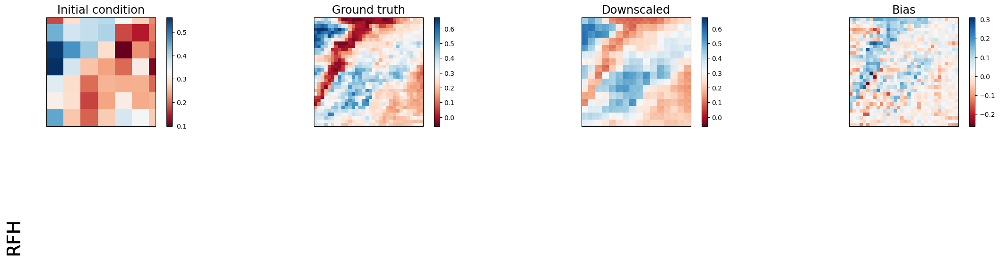

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+-----------------------+----------------------+------------------------+-----------------------+
|                      | Coarse                | ClimaX               | Bilinear Interpolation | Weighted Mask         |
+----------------------+-----------------------+----------------------+------------------------+-----------------------+
| lat_weighted_mse_val | 0.01746131107211113   | 0.005552495829761028 | 0.039081573486328125   | 0.0265408493578434    |
| lat_weighted_rmse    | 0.017230894416570663  | 0.009716582484543324 | 0.02577836625277996    | 0.021243534982204437  |
| spearman             | 0.18229031329365594   | 0.8995620081241972   | -0.3245546899474107    | 0.389931912205193     |
| mean_bias            | 0.0018624067306518555 | 0.003837287425994873 | 0.0035942792892456055  | 0.0027132630348205566 |
| pearson    

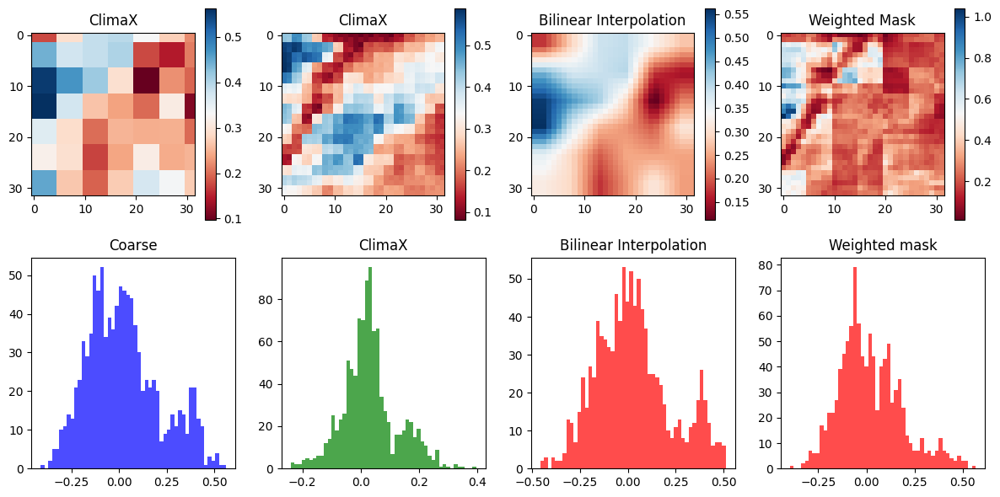

Time step 78
tensor(0.0333, device='cuda:0')


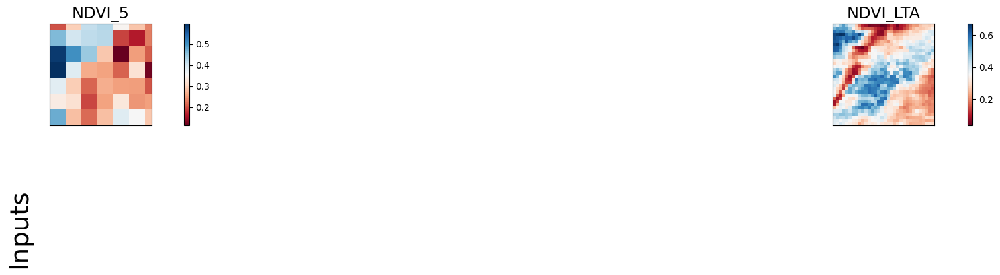

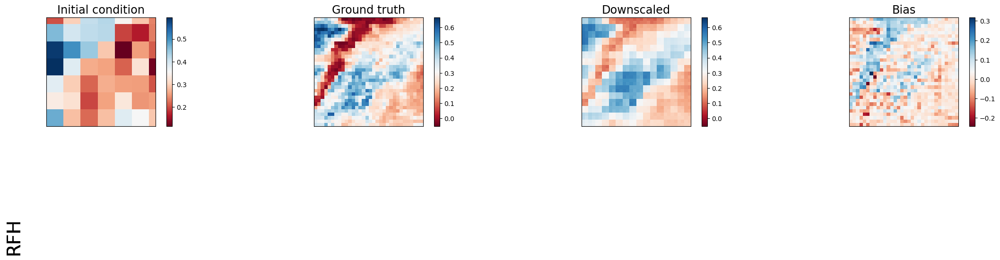

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+-------------------------+-----------------------+------------------------+-----------------------+
|                      | Coarse                  | ClimaX                | Bilinear Interpolation | Weighted Mask         |
+----------------------+-------------------------+-----------------------+------------------------+-----------------------+
| lat_weighted_mse_val | 0.01780916377902031     | 0.005804786924272776  | 0.042420562356710434   | 0.02868819236755371   |
| lat_weighted_rmse    | 0.0174016784876585      | 0.009934877045452595  | 0.026857007294893265   | 0.02208619937300682   |
| spearman             | 0.1890298888706355      | 0.9034471295438361    | -0.33840159988868257   | 0.380983773482994     |
| mean_bias            | -0.00044336915016174316 | 0.0035552680492401123 | 0.004814267158508301   | 0.00383785367012

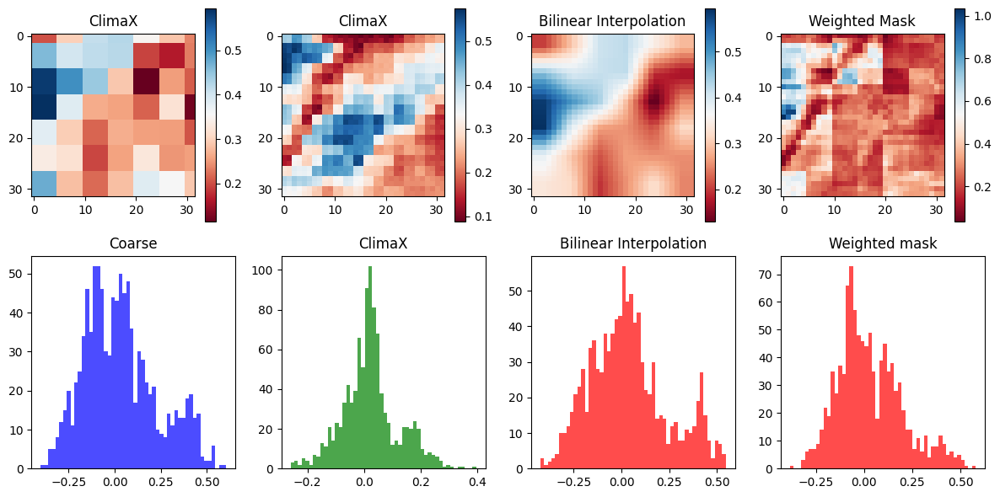

Time step 79
tensor(0.0645, device='cuda:0')


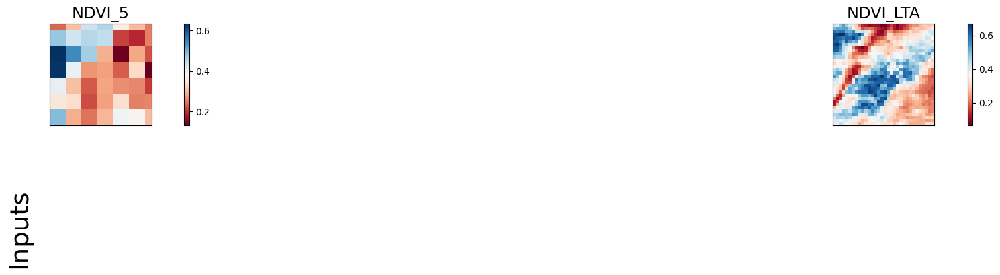

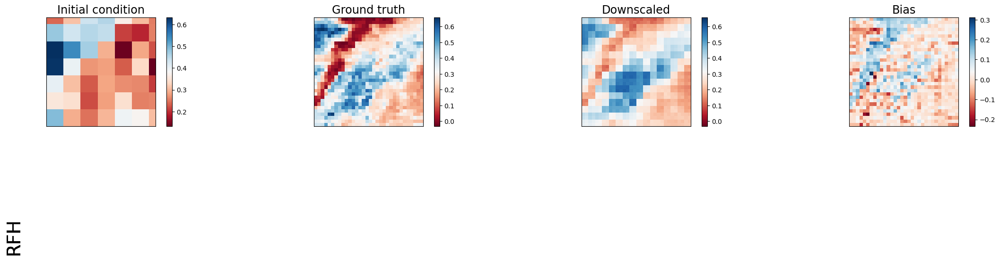

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+------------------------+----------------------+------------------------+----------------------+
|                      | Coarse                 | ClimaX               | Bilinear Interpolation | Weighted Mask        |
+----------------------+------------------------+----------------------+------------------------+----------------------+
| lat_weighted_mse_val | 0.01887817680835724    | 0.00562463141977787  | 0.04495623707771301    | 0.030687445774674416 |
| lat_weighted_rmse    | 0.017916345968842506   | 0.009779494255781174 | 0.027648039162158966   | 0.02284282259643078  |
| spearman             | 0.20051508658983563    | 0.9055443802140317   | -0.3442247100274363    | 0.3641681127446877   |
| mean_bias            | -0.0030670762062072754 | 0.002696514129638672 | 0.005852937698364258   | 0.004713833332061768 |
| pearson    

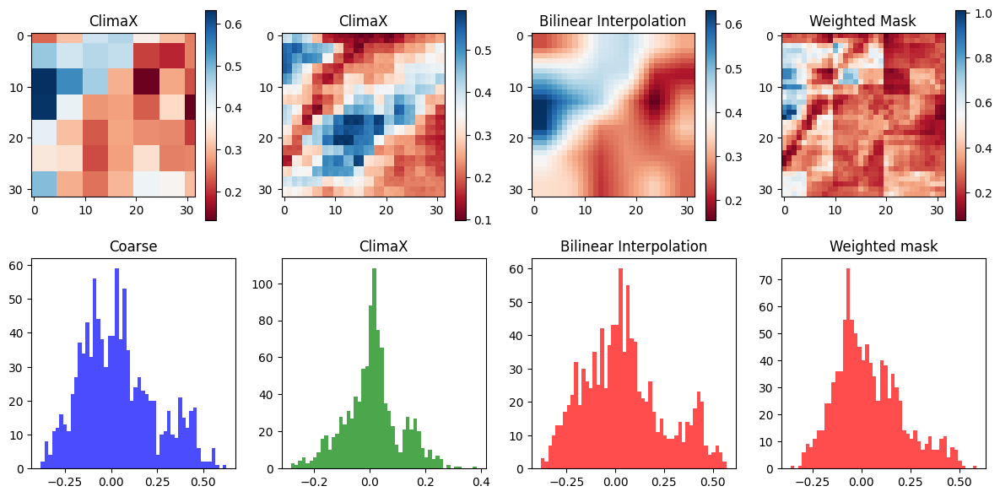

Time step 80
tensor(0.1015, device='cuda:0')


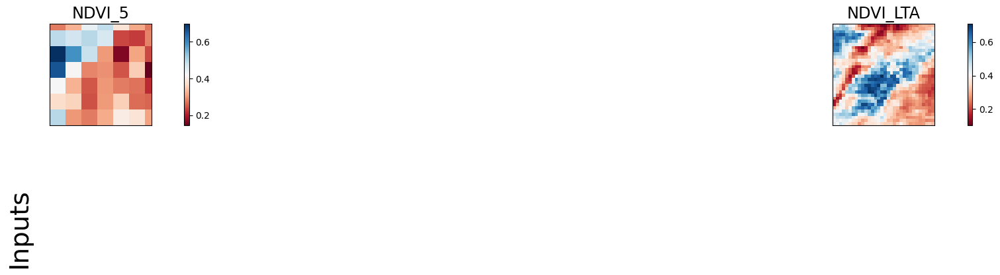

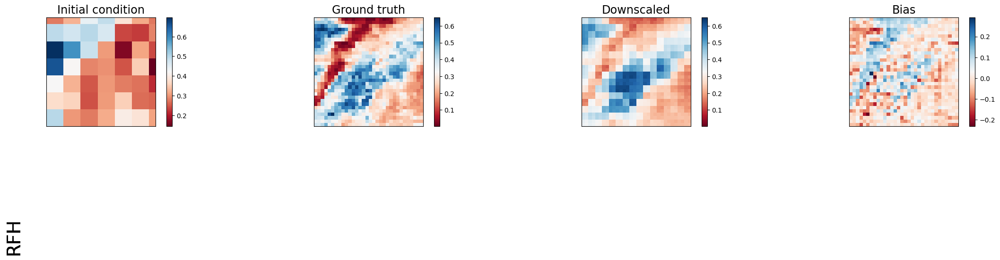

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+-----------------------+-----------------------+------------------------+----------------------+
|                      | Coarse                | ClimaX                | Bilinear Interpolation | Weighted Mask        |
+----------------------+-----------------------+-----------------------+------------------------+----------------------+
| lat_weighted_mse_val | 0.020769305527210236  | 0.005154070444405079  | 0.04604996368288994    | 0.03189290314912796  |
| lat_weighted_rmse    | 0.018792318180203438  | 0.009361480362713337  | 0.02798233926296234    | 0.023287152871489525 |
| spearman             | 0.20735228727527497   | 0.906260271860471     | -0.3366151084198698    | 0.3463915547526487   |
| mean_bias            | -0.005771070718765259 | 0.0016160309314727783 | 0.0064310431480407715  | 0.005045771598815918 |
| pearson    

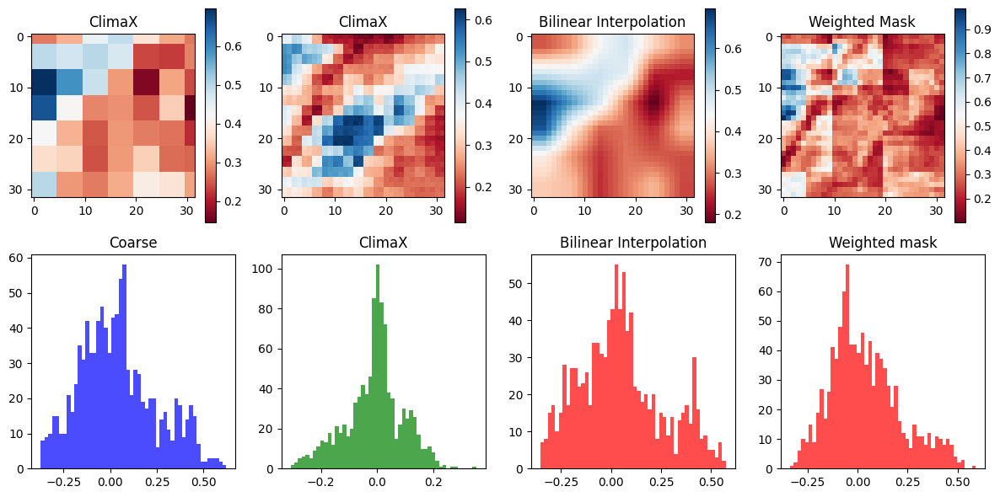

Time step 81
tensor(0.1401, device='cuda:0')


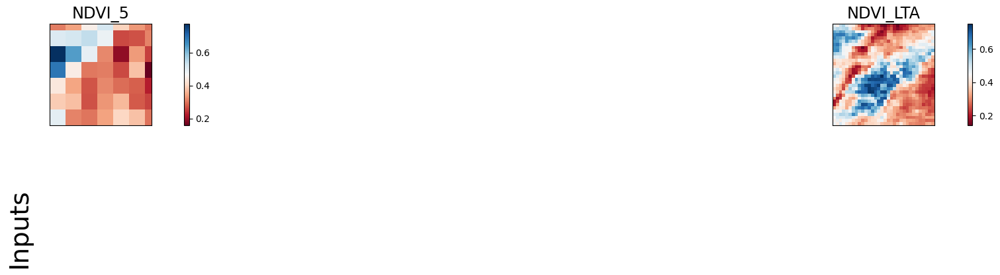

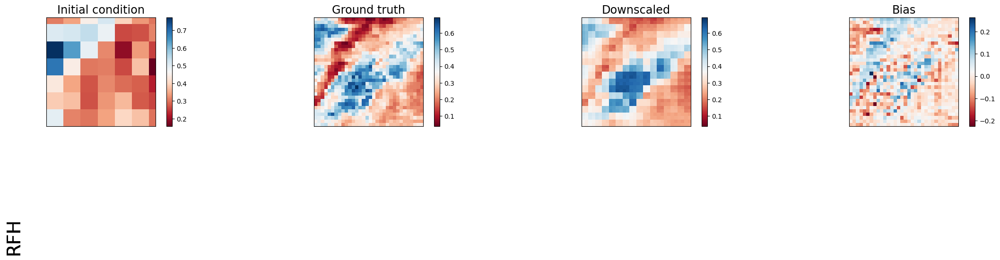

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+----------------------+-----------------------+------------------------+----------------------+
|                      | Coarse               | ClimaX                | Bilinear Interpolation | Weighted Mask        |
+----------------------+----------------------+-----------------------+------------------------+----------------------+
| lat_weighted_mse_val | 0.02367834746837616  | 0.00456997100263834   | 0.04605777561664581    | 0.03229783475399017  |
| lat_weighted_rmse    | 0.020065272226929665 | 0.00881507620215416   | 0.02798471227288246    | 0.02343452163040638  |
| spearman             | 0.21315762197693117  | 0.9041899354650103    | -0.31591298915124527   | 0.34613473624968266  |
| mean_bias            | -0.00836077332496643 | 0.0006136596202850342 | 0.00657200813293457    | 0.004863917827606201 |
| pearson           

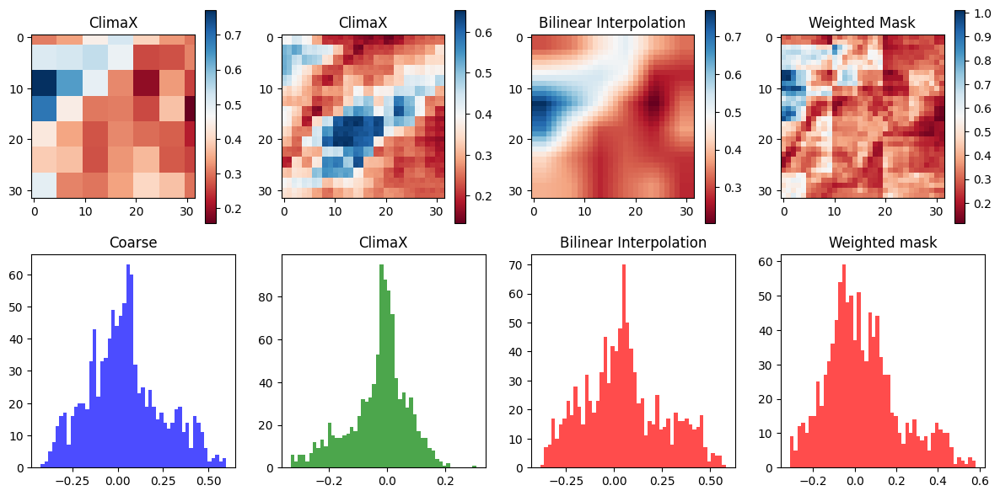

Time step 82
tensor(0.1766, device='cuda:0')


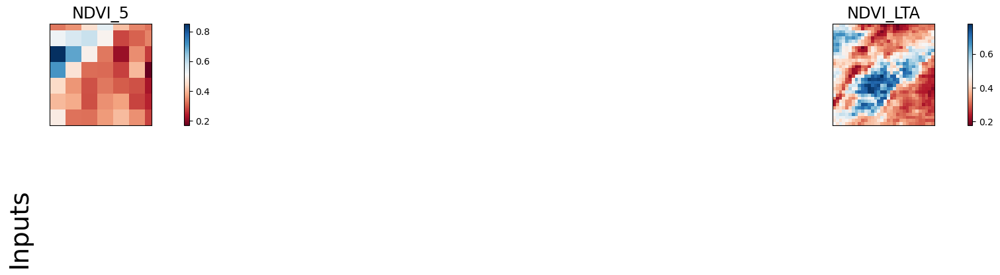

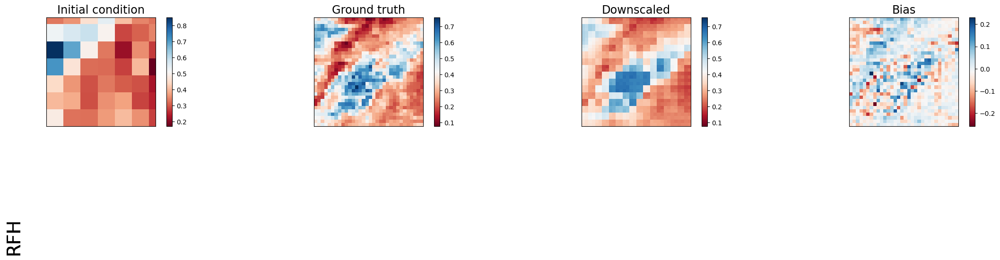

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+-----------------------+------------------------+------------------------+----------------------+
|                      | Coarse                | ClimaX                 | Bilinear Interpolation | Weighted Mask        |
+----------------------+-----------------------+------------------------+------------------------+----------------------+
| lat_weighted_mse_val | 0.027615271508693695  | 0.00413192342966795    | 0.04622418433427811    | 0.03268463537096977  |
| lat_weighted_rmse    | 0.021669255569577217  | 0.008381959050893784   | 0.028035223484039307   | 0.023574430495500565 |
| spearman             | 0.21272203155397354   | 0.9006982746436446     | -0.27845591778142886   | 0.3693164173934949   |
| mean_bias            | -0.010680615901947021 | -0.0002722740173339844 | 0.006467580795288086   | 0.00439453125        |
| pear

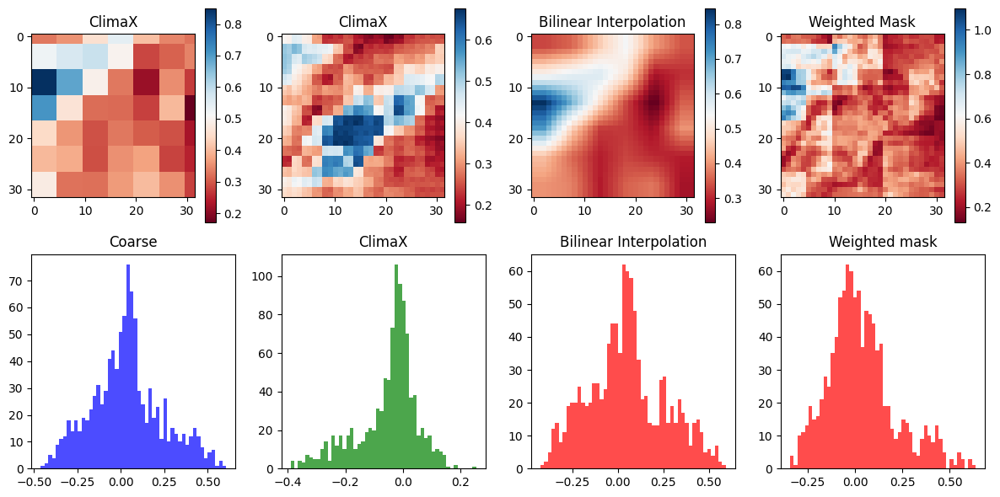

Time step 83
tensor(0.2105, device='cuda:0')


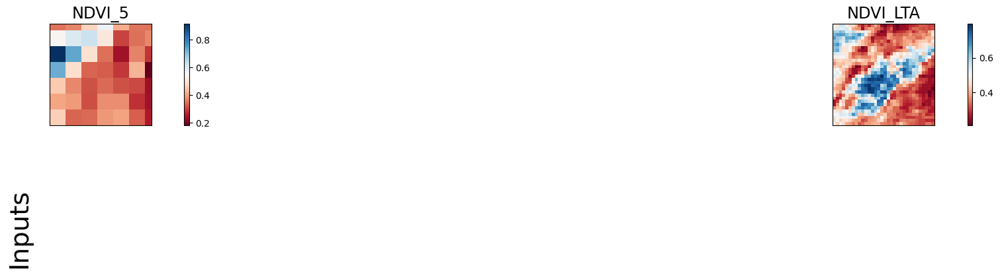

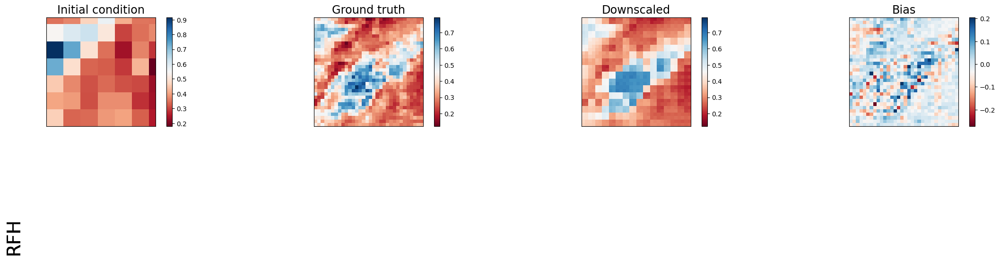

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+----------------------+------------------------+------------------------+-----------------------+
|                      | Coarse               | ClimaX                 | Bilinear Interpolation | Weighted Mask         |
+----------------------+----------------------+------------------------+------------------------+-----------------------+
| lat_weighted_mse_val | 0.03200063854455948  | 0.003960670903325081   | 0.04697418585419655    | 0.03321458399295807   |
| lat_weighted_rmse    | 0.023326450958848    | 0.008206420578062534   | 0.02826174721121788    | 0.023764779791235924  |
| spearman             | 0.20557718266088887  | 0.894854632564765      | -0.2243618317577533    | 0.42071339107863426   |
| mean_bias            | -0.01253405213356018 | -0.0009619295597076416 | 0.006280958652496338   | 0.0038222670555114746 |
| pear

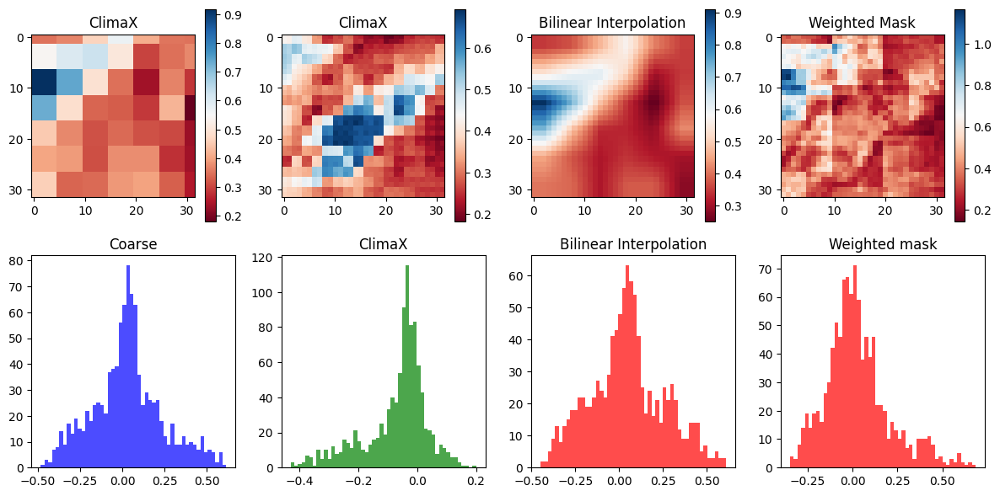

Time step 84
tensor(0.2204, device='cuda:0')


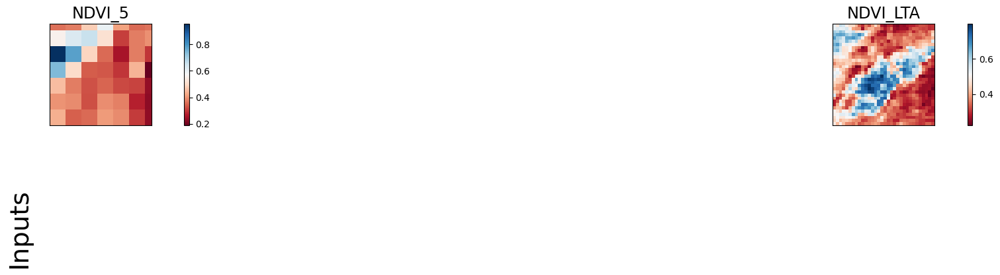

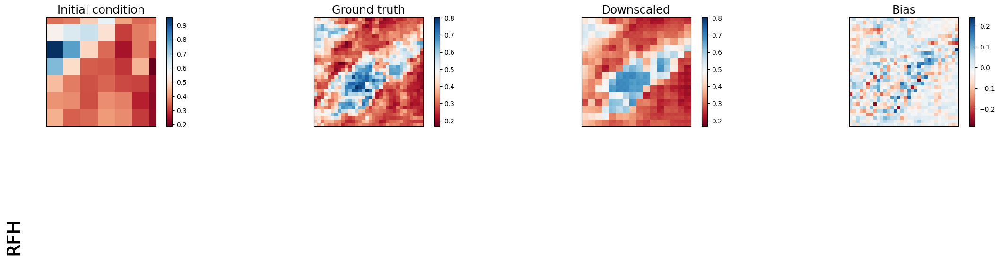

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+-----------------------+------------------------+------------------------+-----------------------+
|                      | Coarse                | ClimaX                 | Bilinear Interpolation | Weighted Mask         |
+----------------------+-----------------------+------------------------+------------------------+-----------------------+
| lat_weighted_mse_val | 0.03551327437162399   | 0.003940572962164879   | 0.04755732789635658    | 0.03323297202587128   |
| lat_weighted_rmse    | 0.024573368951678276  | 0.008185571990907192   | 0.028436629101634026   | 0.02377135679125786   |
| spearman             | 0.19360602810098632   | 0.8891047511213707     | -0.15956526284729694   | 0.4864163744161222    |
| mean_bias            | -0.013613224029541016 | -0.0013180375099182129 | 0.005986332893371582   | 0.0031761527061462402 |

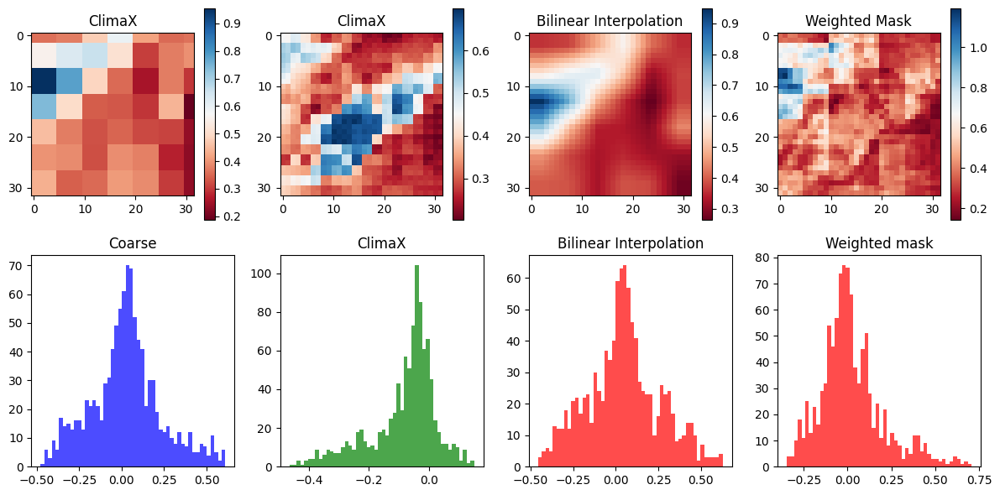

Time step 85
tensor(0.2211, device='cuda:0')


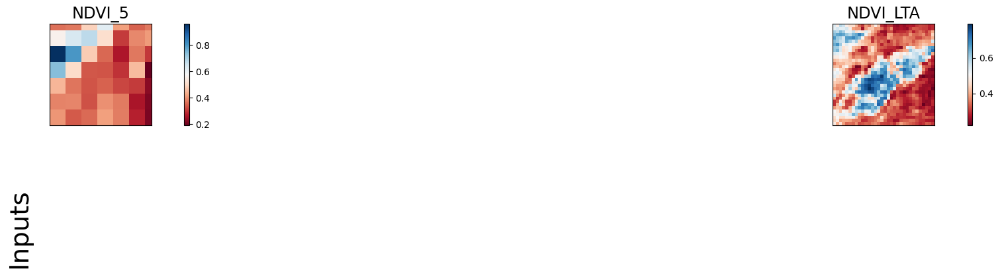

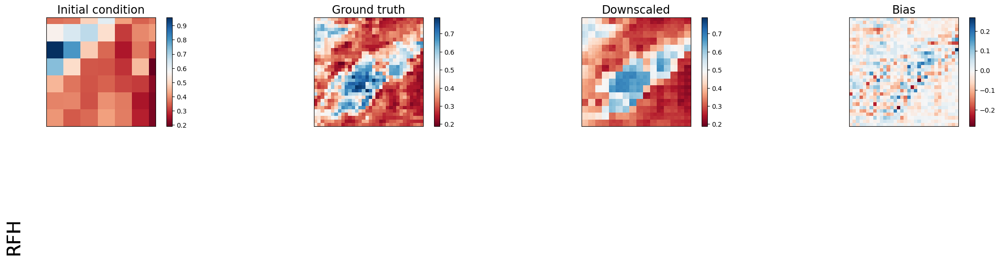

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+----------------------+-----------------------+------------------------+----------------------+
|                      | Coarse               | ClimaX                | Bilinear Interpolation | Weighted Mask        |
+----------------------+----------------------+-----------------------+------------------------+----------------------+
| lat_weighted_mse_val | 0.03657853230834007  | 0.0038445638492703438 | 0.04646914079785347    | 0.031768798828125    |
| lat_weighted_rmse    | 0.024939198046922684 | 0.008085240609943867  | 0.028109408915042877   | 0.0232418030500412   |
| spearman             | 0.18955923651157686  | 0.886962714929561     | -0.1060774317809163    | 0.5427724365826347   |
| mean_bias            | -0.01363798975944519 | -0.001287311315536499 | 0.005485415458679199   | 0.002411186695098877 |
| pearson           

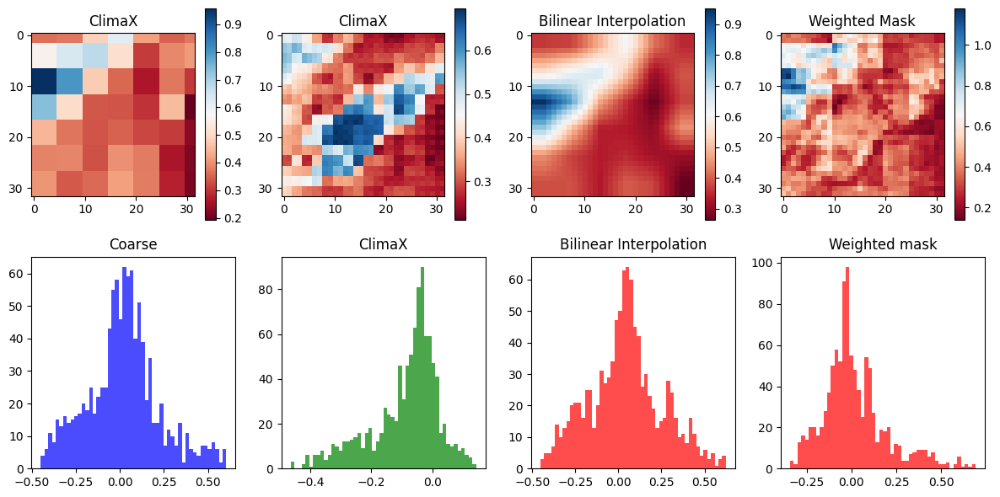

Time step 86
tensor(0.2117, device='cuda:0')


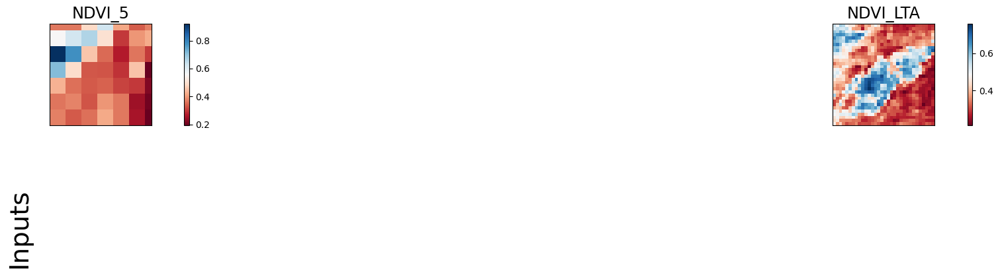

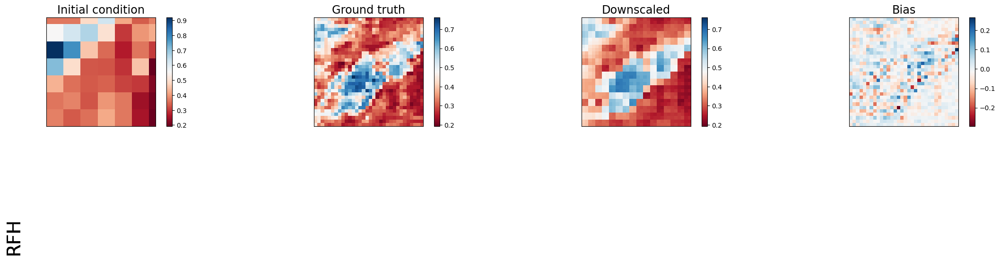

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+-----------------------+------------------------+------------------------+-----------------------+
|                      | Coarse                | ClimaX                 | Bilinear Interpolation | Weighted Mask         |
+----------------------+-----------------------+------------------------+------------------------+-----------------------+
| lat_weighted_mse_val | 0.03387022390961647   | 0.0035282629542052746  | 0.042062900960445404   | 0.027774181216955185  |
| lat_weighted_rmse    | 0.023998182266950607  | 0.007745507173240185   | 0.02674354426562786    | 0.02173151634633541   |
| spearman             | 0.18757406601124402   | 0.8893766244448792     | -0.061779938621114666  | 0.5885023294376       |
| mean_bias            | -0.012356966733932495 | -0.0008406341075897217 | 0.004627019166946411   | 0.0014387667179107666 |

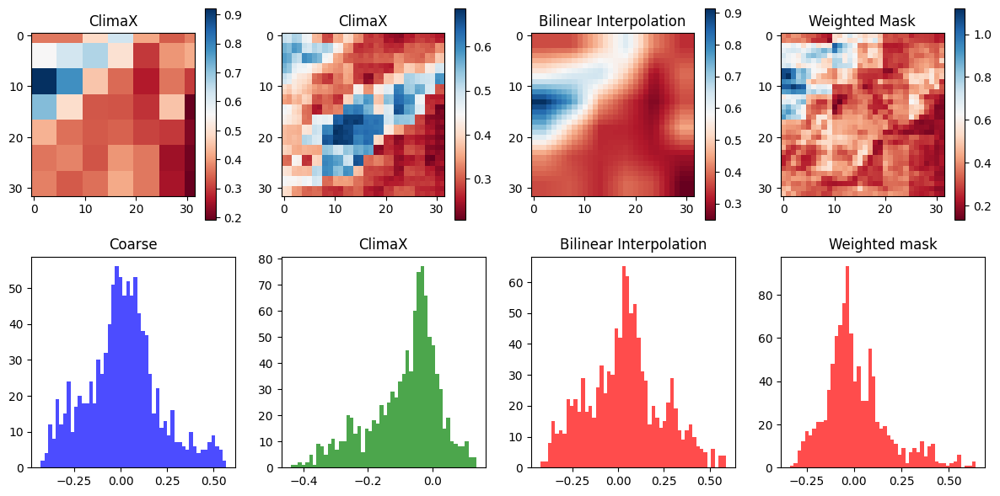

Time step 87
tensor(0.1942, device='cuda:0')


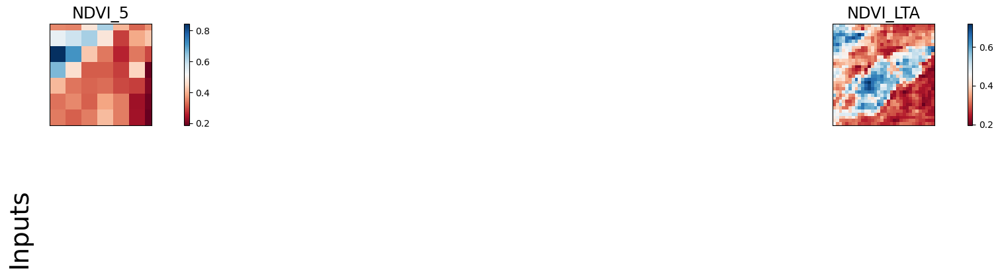

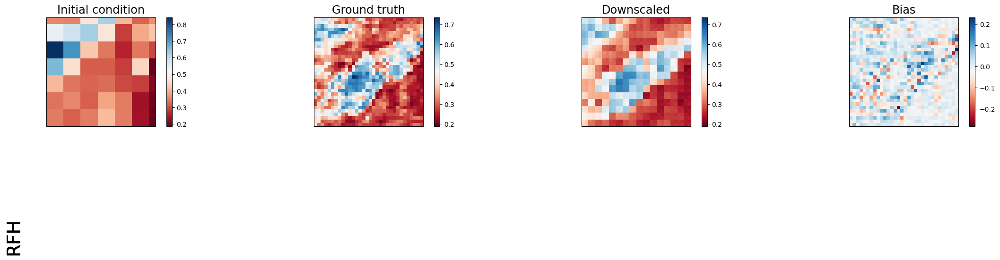

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+-----------------------+-----------------------+------------------------+-----------------------+
|                      | Coarse                | ClimaX                | Bilinear Interpolation | Weighted Mask         |
+----------------------+-----------------------+-----------------------+------------------------+-----------------------+
| lat_weighted_mse_val | 0.027932921424508095  | 0.00317761255428195   | 0.03442583233118057    | 0.021570025011897087  |
| lat_weighted_rmse    | 0.021793529391288757  | 0.007350550964474678  | 0.02419421821832657    | 0.019151143729686737  |
| spearman             | 0.17427217633686778   | 0.8909279181114924    | -0.020164852442413058  | 0.6248404362869696    |
| mean_bias            | -0.009893566370010376 | -0.000264585018157959 | 0.0034304261207580566  | 0.0003336668014526367 |
| pear

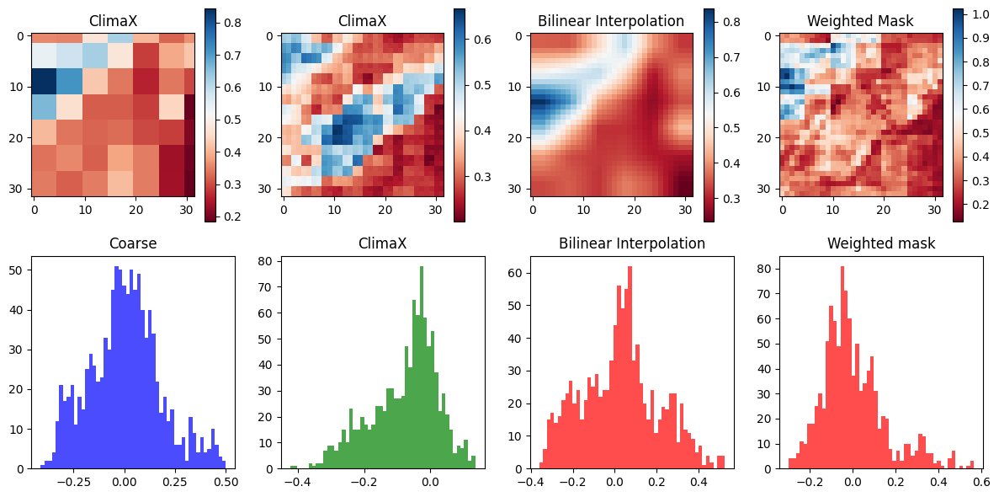

Time step 88
tensor(0.1779, device='cuda:0')


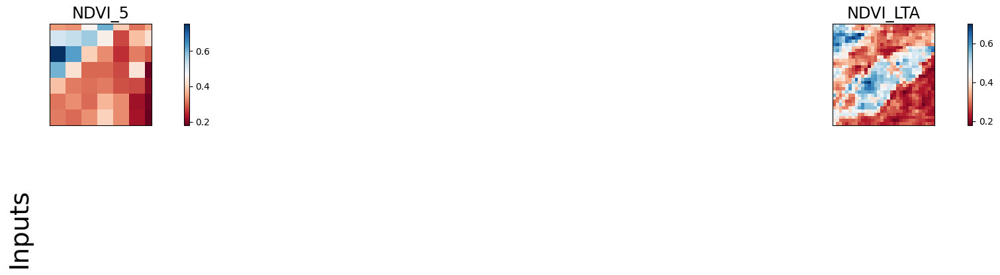

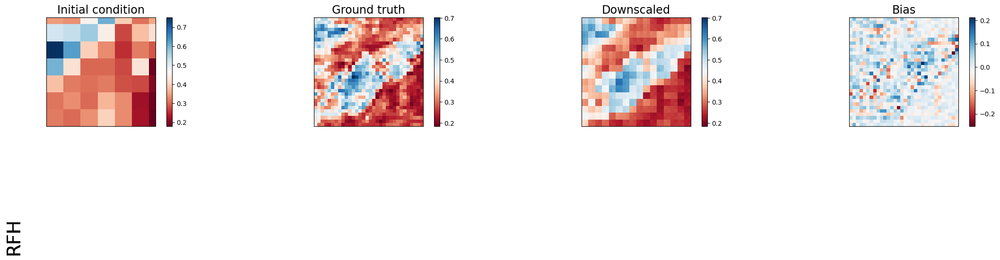

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+-----------------------+------------------------+------------------------+------------------------+
|                      | Coarse                | ClimaX                 | Bilinear Interpolation | Weighted Mask          |
+----------------------+-----------------------+------------------------+------------------------+------------------------+
| lat_weighted_mse_val | 0.021785026416182518  | 0.002920233877375722   | 0.02671046182513237    | 0.015759728848934174   |
| lat_weighted_rmse    | 0.019246352836489677  | 0.007046577986329794   | 0.021311307325959206   | 0.016369814053177834   |
| spearman             | 0.15859040601533014   | 0.8908387382395083     | 0.015206372811154882   | 0.6548913007187918     |
| mean_bias            | -0.006934702396392822 | 0.00014224648475646973 | 0.002124875783920288   | -0.00071981549263

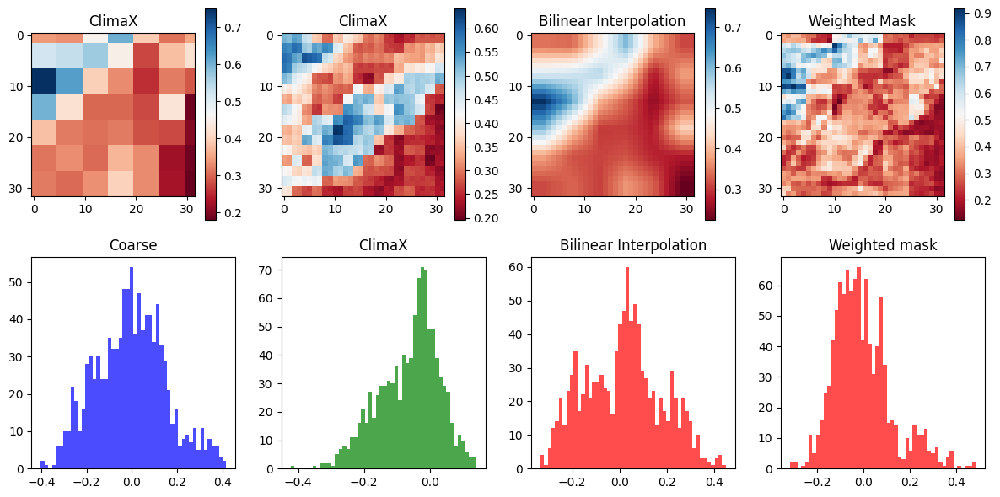

Time step 89
tensor(0.1652, device='cuda:0')


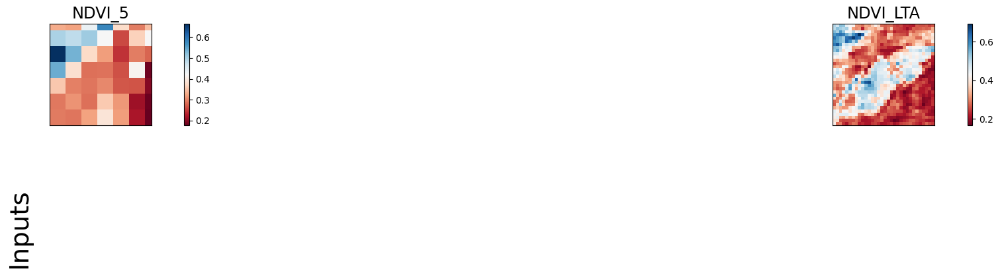

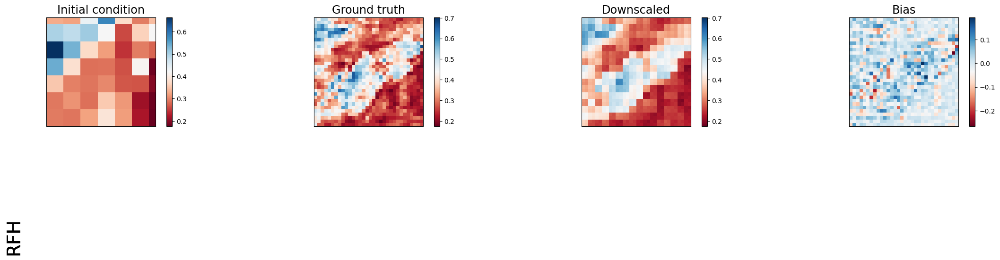

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+-----------------------+------------------------+------------------------+------------------------+
|                      | Coarse                | ClimaX                 | Bilinear Interpolation | Weighted Mask          |
+----------------------+-----------------------+------------------------+------------------------+------------------------+
| lat_weighted_mse_val | 0.01737881638109684   | 0.002818502951413393   | 0.020995989441871643   | 0.011853808537125587   |
| lat_weighted_rmse    | 0.017190145328640938  | 0.00692274933680892    | 0.01889459230005741    | 0.014197058044373989   |
| spearman             | 0.14786621716029819   | 0.8874955877602572     | 0.05218586068329879    | 0.6745493655722408     |
| mean_bias            | -0.003966182470321655 | 3.8743019104003906e-07 | 0.0008875429630279541  | -0.00163477659225

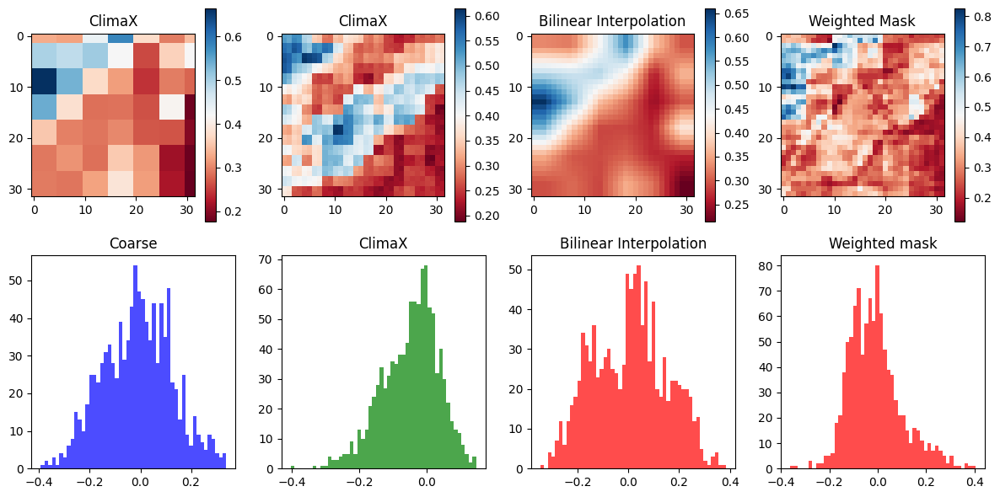

Time step 90
tensor(0.1560, device='cuda:0')


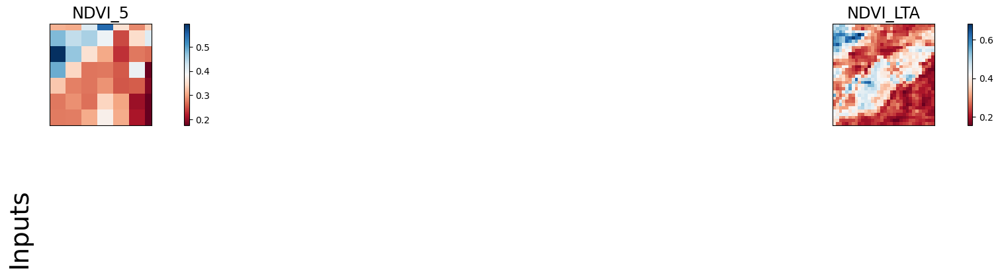

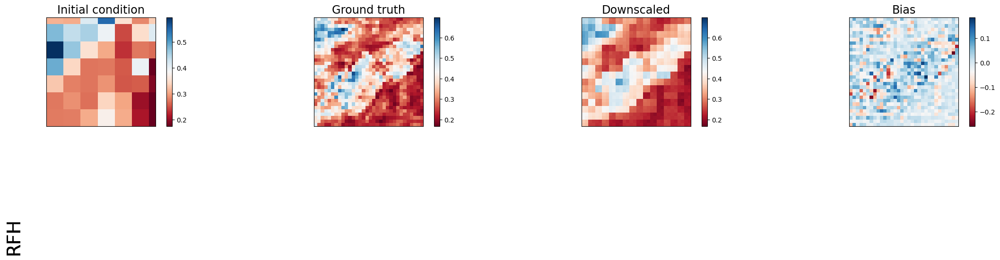

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+------------------------+------------------------+------------------------+------------------------+
|                      | Coarse                 | ClimaX                 | Bilinear Interpolation | Weighted Mask          |
+----------------------+------------------------+------------------------+------------------------+------------------------+
| lat_weighted_mse_val | 0.014972999691963196   | 0.0028245444409549236  | 0.017501629889011383   | 0.009826401248574257   |
| lat_weighted_rmse    | 0.01595599390566349    | 0.006930164992809296   | 0.017250778153538704   | 0.012926074676215649   |
| spearman             | 0.154262326993714      | 0.8826920504428295     | 0.07901703473417028    | 0.6778926594036686     |
| mean_bias            | -0.0012913048267364502 | -0.0004202723503112793 | -0.0001550614833831787 | -0.0023404

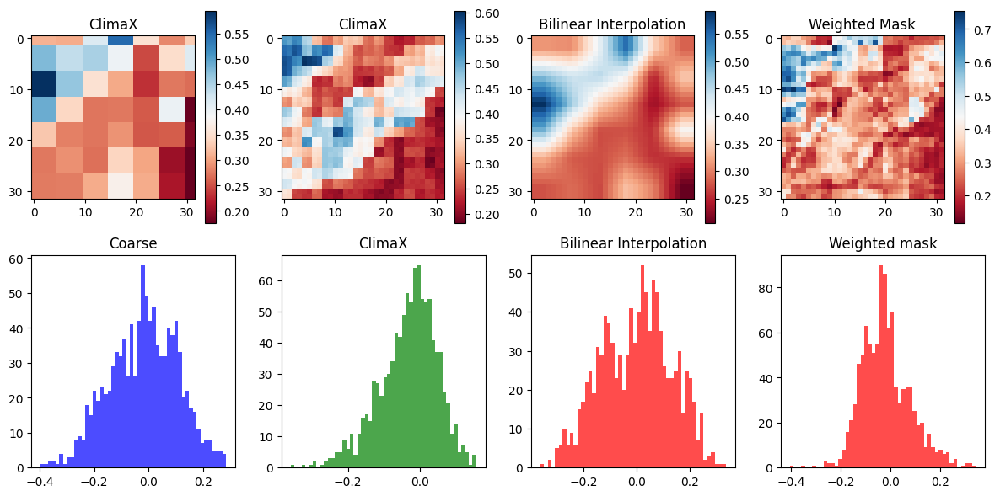

Time step 91
tensor(0.1480, device='cuda:0')


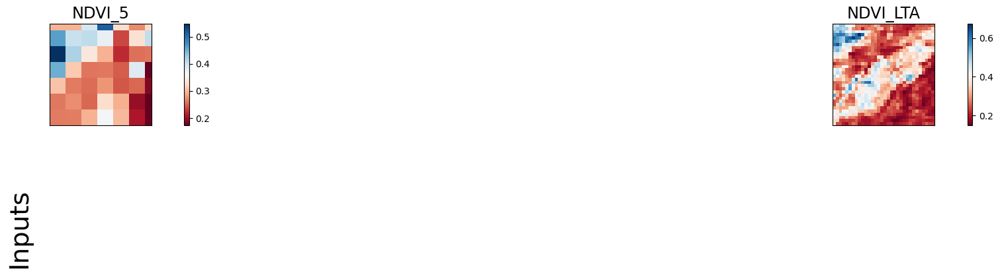

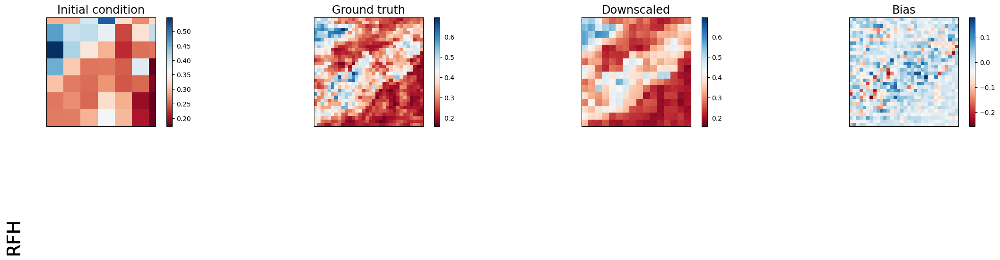

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+-----------------------+------------------------+------------------------+-----------------------+
|                      | Coarse                | ClimaX                 | Bilinear Interpolation | Weighted Mask         |
+----------------------+-----------------------+------------------------+------------------------+-----------------------+
| lat_weighted_mse_val | 0.014021912589669228  | 0.00288418959826231    | 0.015617961063981056   | 0.008940480649471283  |
| lat_weighted_rmse    | 0.01544091384857893   | 0.007002954371273518   | 0.0162960197776556     | 0.01232962403446436   |
| spearman             | 0.15188937606347044   | 0.8780256815664574     | 0.08880154005458388    | 0.6660885492459382    |
| mean_bias            | 0.0009489953517913818 | -0.0008143484592437744 | -0.0009602904319763184 | -0.002840399742126465 |

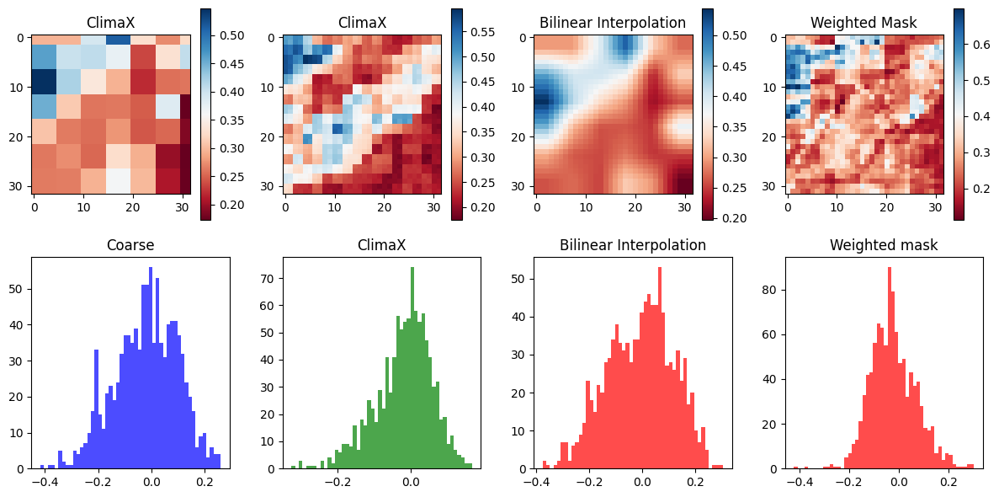

Time step 92
tensor(0.1405, device='cuda:0')


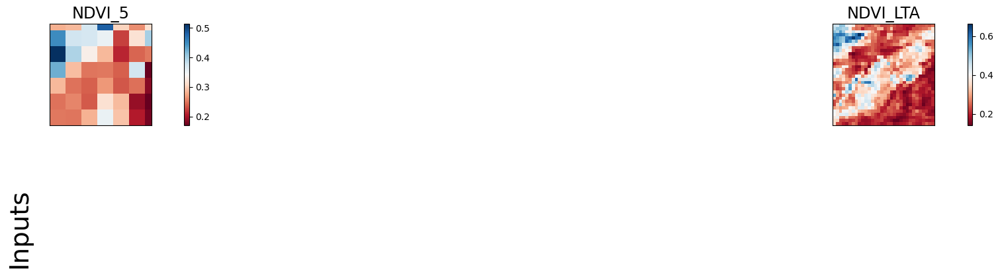

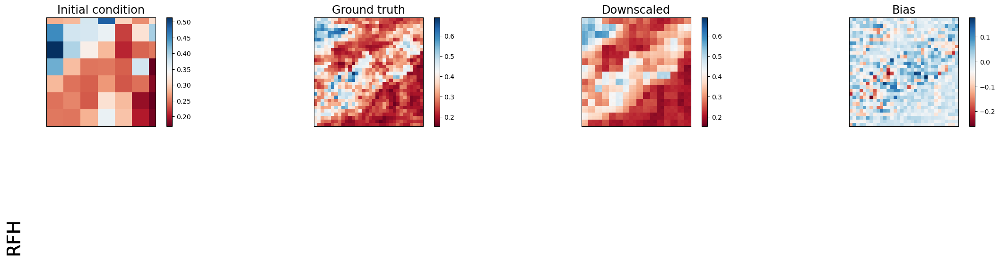

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+-----------------------+------------------------+------------------------+------------------------+
|                      | Coarse                | ClimaX                 | Bilinear Interpolation | Weighted Mask          |
+----------------------+-----------------------+------------------------+------------------------+------------------------+
| lat_weighted_mse_val | 0.013913188129663467  | 0.002964310348033905   | 0.014771834015846252   | 0.008675632998347282   |
| lat_weighted_rmse    | 0.01538093201816082   | 0.007099556736648083   | 0.015848441049456596   | 0.012145627290010452   |
| spearman             | 0.13718945830935886   | 0.8749261088739804     | 0.07850065325476882    | 0.6431397489218724     |
| mean_bias            | 0.0027714669704437256 | -0.0010921359062194824 | -0.0015387535095214844 | -0.00316163897514

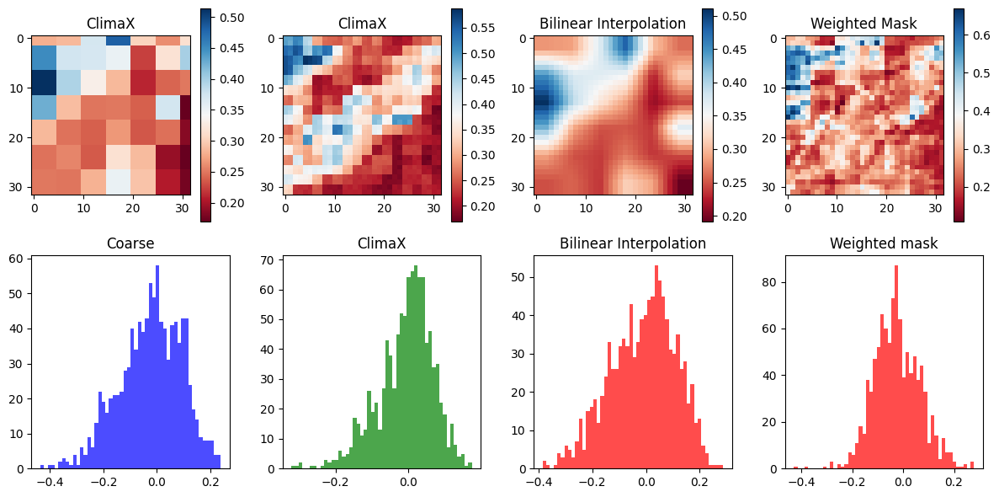

Time step 93
tensor(0.1351, device='cuda:0')


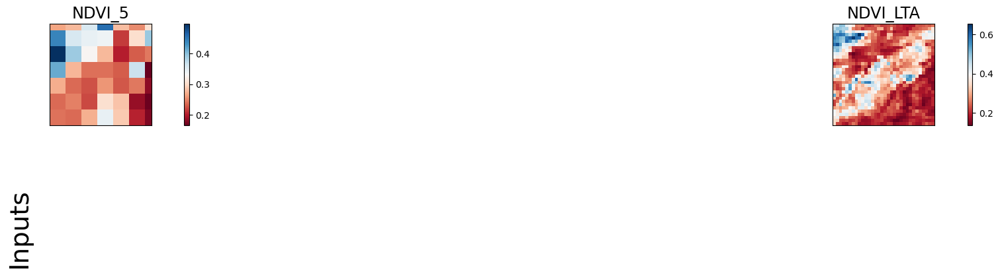

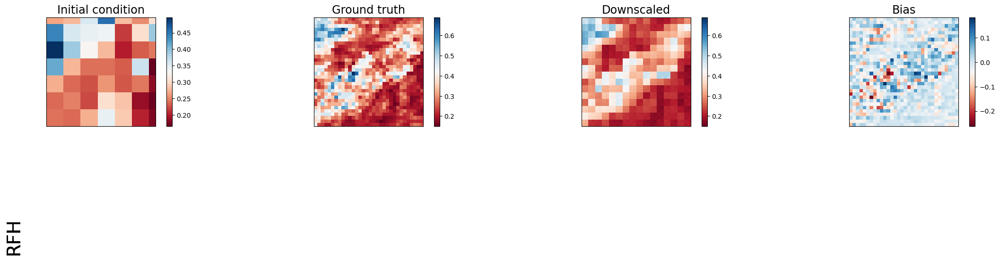

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+----------------------+-----------------------+------------------------+-----------------------+
|                      | Coarse               | ClimaX                | Bilinear Interpolation | Weighted Mask         |
+----------------------+----------------------+-----------------------+------------------------+-----------------------+
| lat_weighted_mse_val | 0.01424501370638609  | 0.003088857978582382  | 0.01480778120458126    | 0.00885717011988163   |
| lat_weighted_rmse    | 0.015563269145786762 | 0.007247168570756912  | 0.01586771383881569    | 0.012272043153643608  |
| spearman             | 0.12197370258378644  | 0.8726013021893626    | 0.05722296626355339    | 0.6216599645056855    |
| mean_bias            | 0.004039943218231201 | -0.001221776008605957 | -0.0018598735332489014 | -0.003311246633529663 |
| pearson    

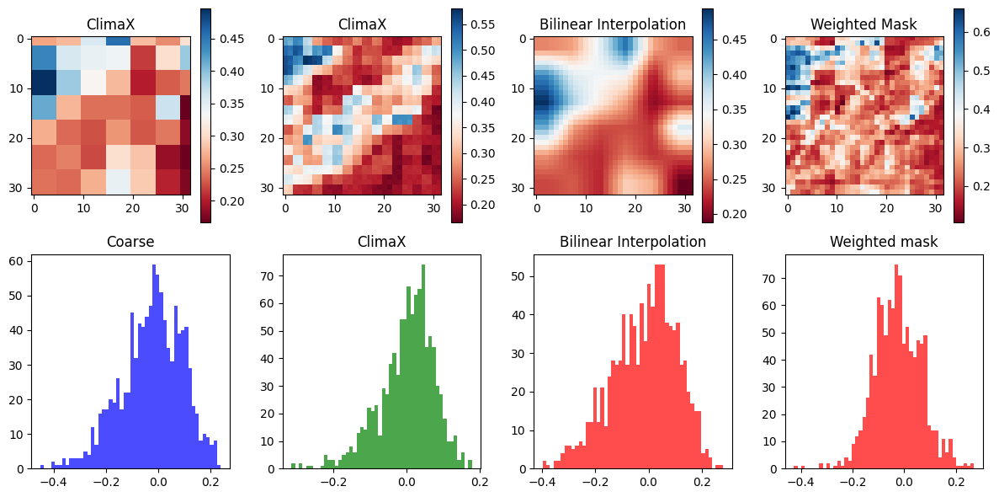

Time step 94
tensor(0.1316, device='cuda:0')


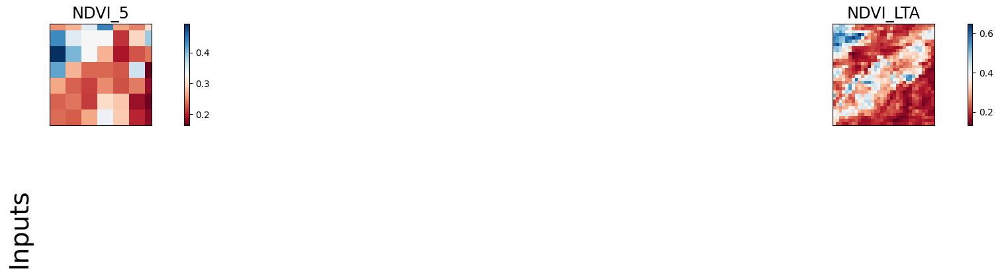

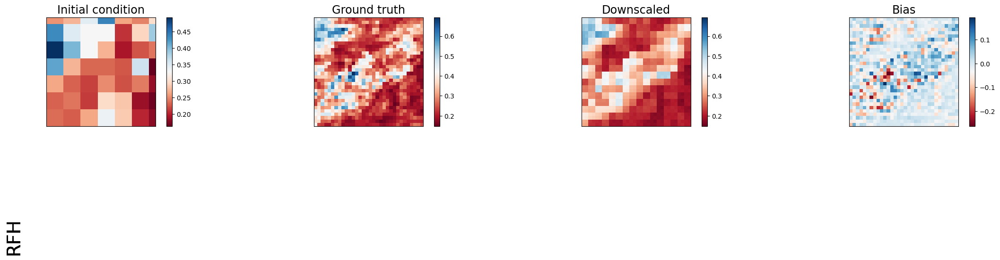

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+-----------------------+-----------------------+------------------------+------------------------+
|                      | Coarse                | ClimaX                | Bilinear Interpolation | Weighted Mask          |
+----------------------+-----------------------+-----------------------+------------------------+------------------------+
| lat_weighted_mse_val | 0.014729415066540241  | 0.0032689902000129223 | 0.01548224501311779    | 0.009351586923003197   |
| lat_weighted_rmse    | 0.0158256683498621    | 0.007455489132553339  | 0.016225062310695648   | 0.012609911151230335   |
| spearman             | 0.12646121437585628   | 0.8706504762442259    | 0.02929813185944785    | 0.6058747852547046     |
| mean_bias            | 0.0047757625579833984 | -0.001245349645614624 | -0.0019495189189910889 | -0.0033318400382995605 |

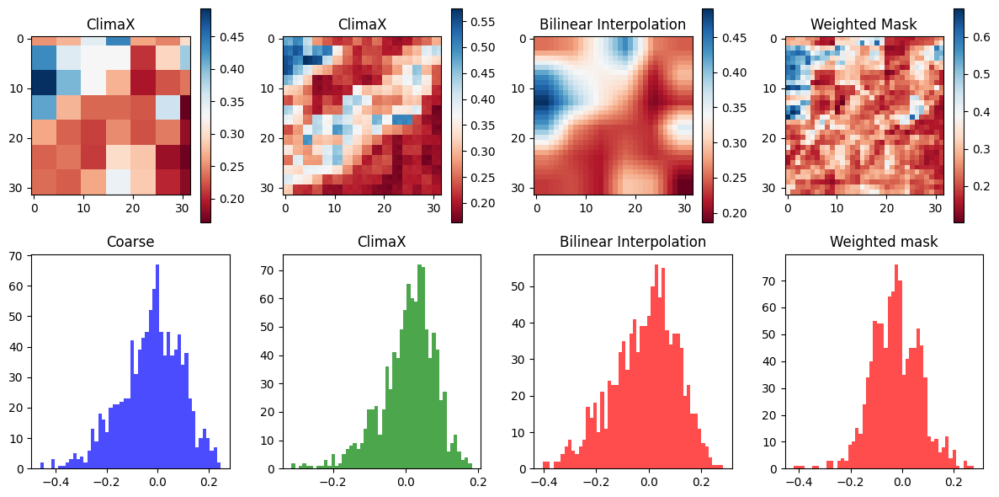

Time step 95
tensor(0.1292, device='cuda:0')


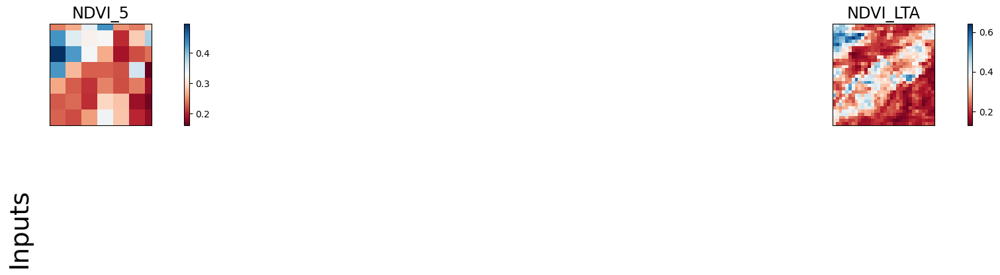

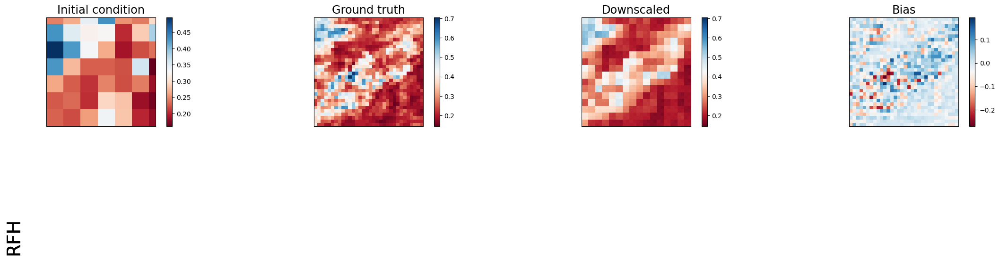

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+----------------------+------------------------+------------------------+-----------------------+
|                      | Coarse               | ClimaX                 | Bilinear Interpolation | Weighted Mask         |
+----------------------+----------------------+------------------------+------------------------+-----------------------+
| lat_weighted_mse_val | 0.015289461240172386 | 0.003480826038867235   | 0.016622276976704597   | 0.01010652631521225   |
| lat_weighted_rmse    | 0.016123726963996887 | 0.007693261839449406   | 0.01681181788444519    | 0.013109023682773113  |
| spearman             | 0.12423348883159238  | 0.8695368177597872     | -0.006437070459101406  | 0.5926838497191901    |
| mean_bias            | 0.00517687201499939  | -0.0012147724628448486 | -0.0018932521343231201 | -0.003287792205810547 |
| pear

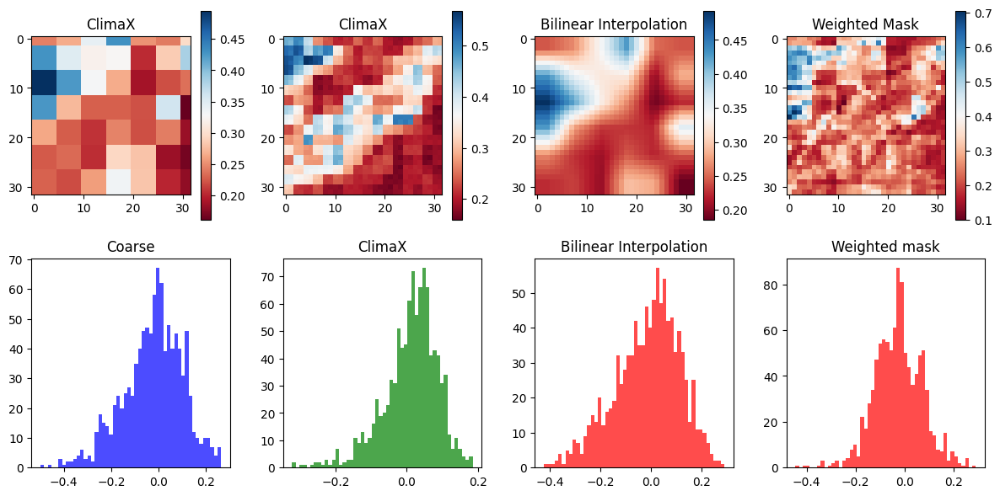

Time step 96
tensor(0.1275, device='cuda:0')


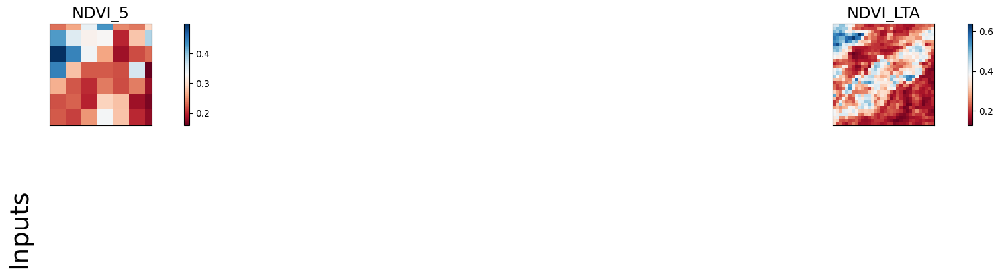

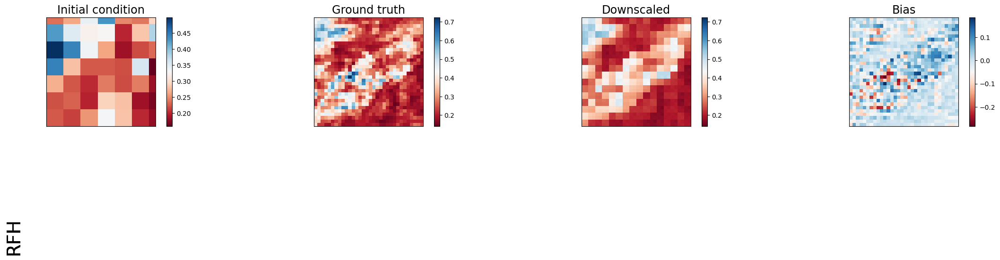

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+----------------------+------------------------+------------------------+------------------------+
|                      | Coarse               | ClimaX                 | Bilinear Interpolation | Weighted Mask          |
+----------------------+----------------------+------------------------+------------------------+------------------------+
| lat_weighted_mse_val | 0.015810513868927956 | 0.003666090313345194   | 0.017971588298678398   | 0.011030120775103569   |
| lat_weighted_rmse    | 0.016396168619394302 | 0.007895342074334621   | 0.017480848357081413   | 0.013694919645786285   |
| spearman             | 0.11914555919786698  | 0.8688177826595669     | -0.04047218206054306   | 0.5810708031518276     |
| mean_bias            | 0.005292415618896484 | -0.0011547505855560303 | -0.0017473399639129639 | -0.0032139718532562256 |

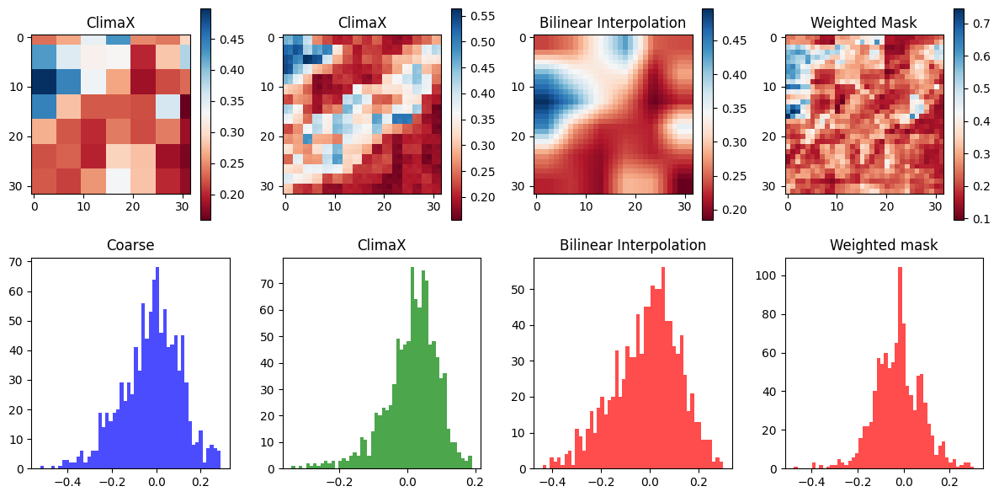

Time step 97
tensor(0.1264, device='cuda:0')


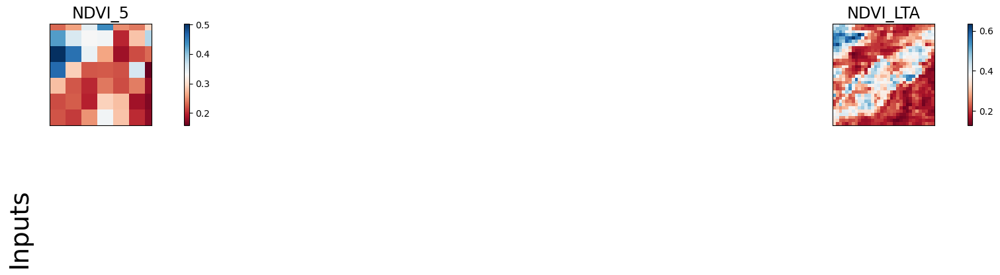

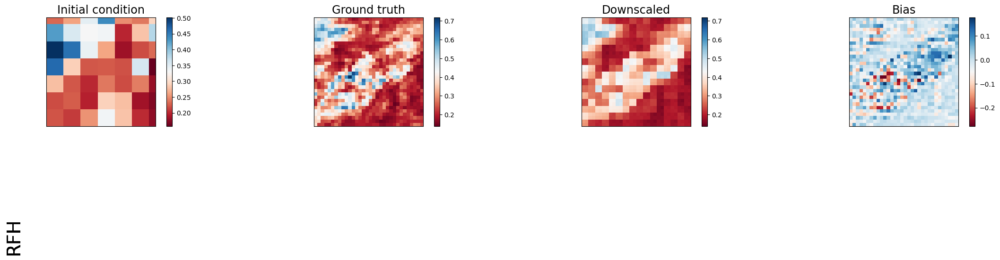

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+----------------------+------------------------+------------------------+------------------------+
|                      | Coarse               | ClimaX                 | Bilinear Interpolation | Weighted Mask          |
+----------------------+----------------------+------------------------+------------------------+------------------------+
| lat_weighted_mse_val | 0.016224931925535202 | 0.003792625619098544   | 0.019387265667319298   | 0.01198703795671463    |
| lat_weighted_rmse    | 0.016609661281108856 | 0.008030439727008343   | 0.01815631240606308    | 0.014276616275310516   |
| spearman             | 0.11685051205323499  | 0.8697693262711866     | -0.071698269027366     | 0.5699717186340117     |
| mean_bias            | 0.005113869905471802 | -0.0011419057846069336 | -0.001541823148727417  | -0.0031166374683380127 |

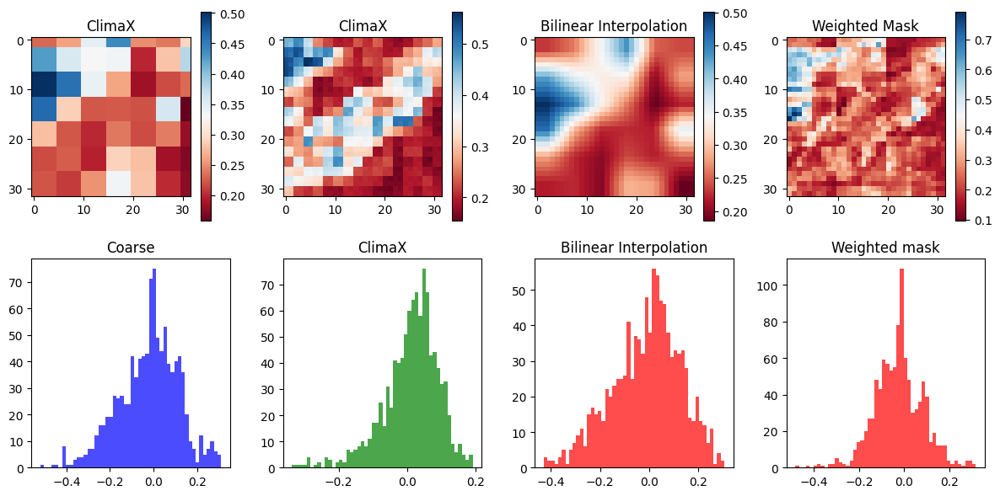

Time step 98
tensor(0.1261, device='cuda:0')


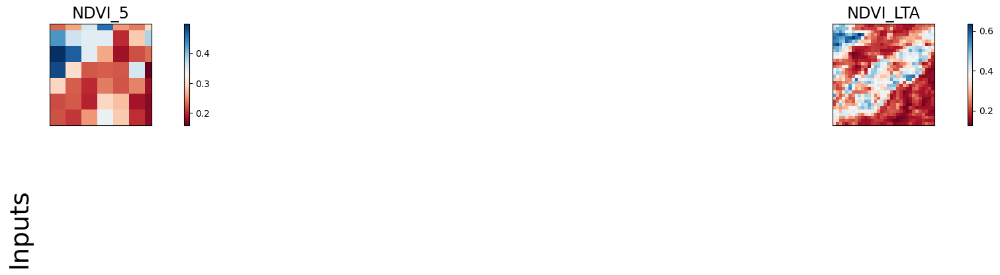

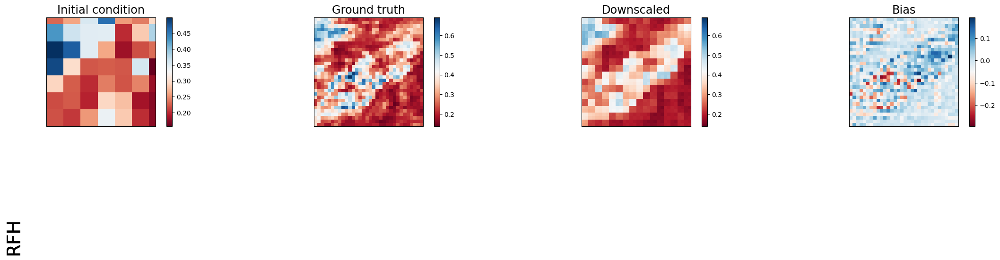

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+-----------------------+------------------------+------------------------+------------------------+
|                      | Coarse                | ClimaX                 | Bilinear Interpolation | Weighted Mask          |
+----------------------+-----------------------+------------------------+------------------------+------------------------+
| lat_weighted_mse_val | 0.016548365354537964  | 0.0038379563484340906  | 0.020752808079123497   | 0.012841366231441498   |
| lat_weighted_rmse    | 0.01677439734339714   | 0.008078289218246937   | 0.01878485456109047    | 0.014776617288589478   |
| spearman             | 0.11282493428958618   | 0.8712966314825743     | -0.09535774193932157   | 0.559888661774449      |
| mean_bias            | 0.0046758949756622314 | -0.0012180805206298828 | -0.0012954771518707275 | -0.00299793481826

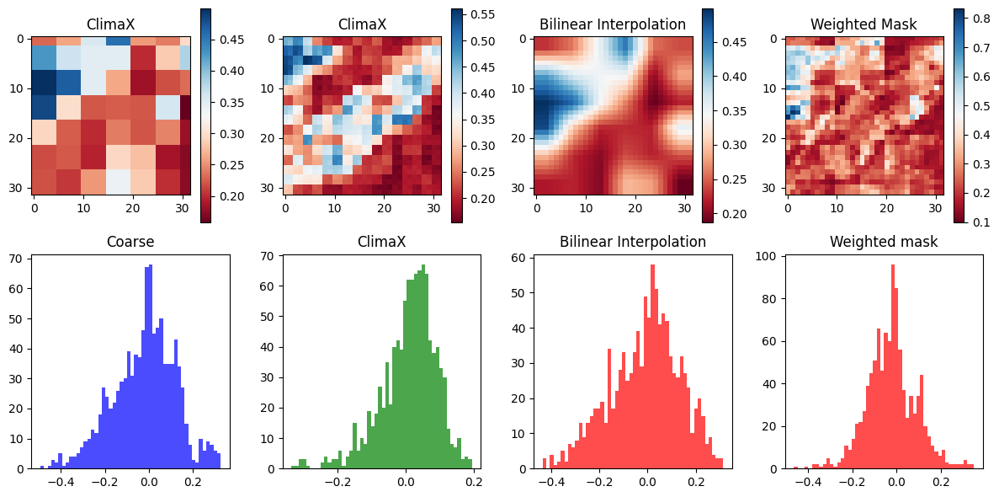

Time step 99
tensor(0.1266, device='cuda:0')


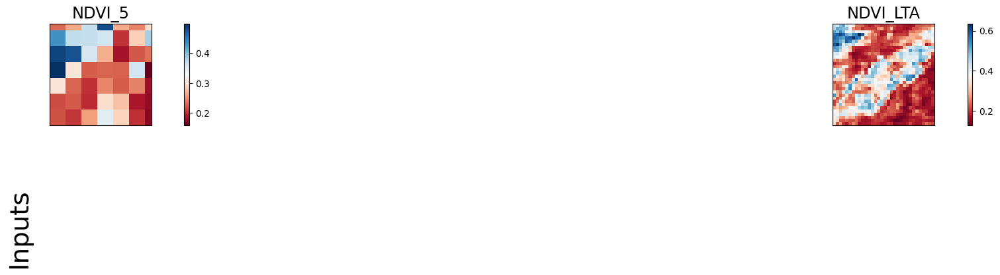

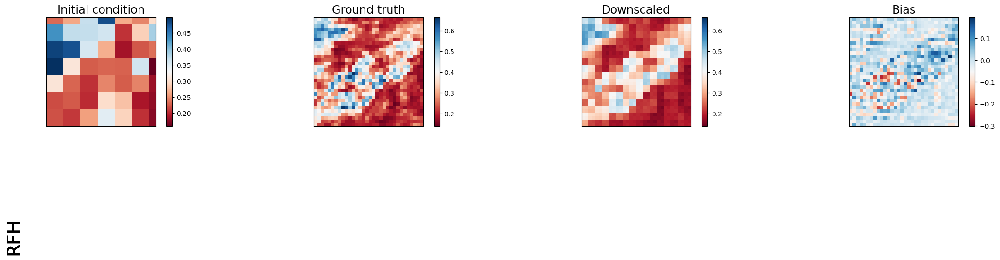

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+----------------------+------------------------+------------------------+-----------------------+
|                      | Coarse               | ClimaX                 | Bilinear Interpolation | Weighted Mask         |
+----------------------+----------------------+------------------------+------------------------+-----------------------+
| lat_weighted_mse_val | 0.01672949641942978  | 0.0037470778916031122  | 0.0216694138944149     | 0.013288851827383041  |
| lat_weighted_rmse    | 0.01686594821512699  | 0.007982073351740837   | 0.01919521391391754    | 0.015031874179840088  |
| spearman             | 0.09862643934864398  | 0.8725335282380019     | -0.11343957353081592   | 0.5525016443923798    |
| mean_bias            | 0.004024893045425415 | -0.0013047456741333008 | -0.0010296404361724854 | -0.002834111452102661 |
| pear

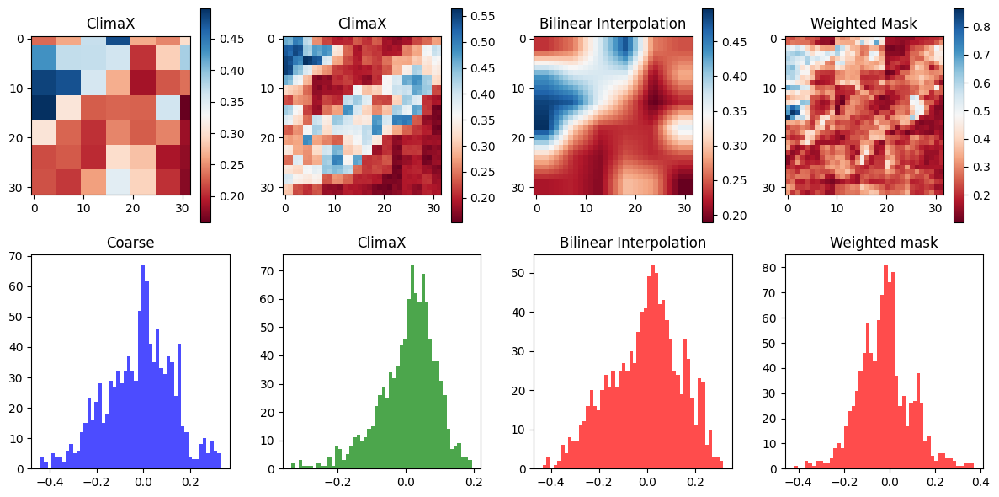

Time step 100
tensor(0.1284, device='cuda:0')


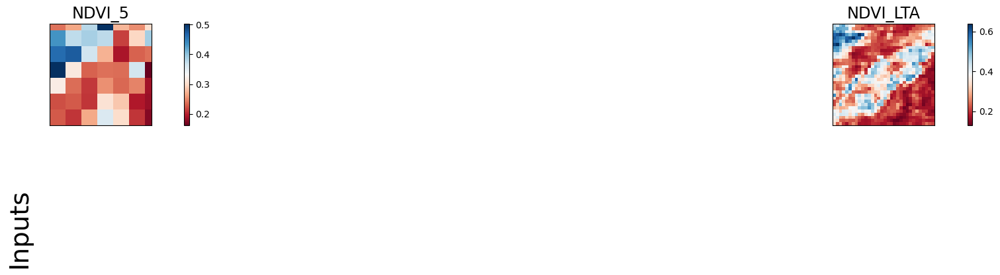

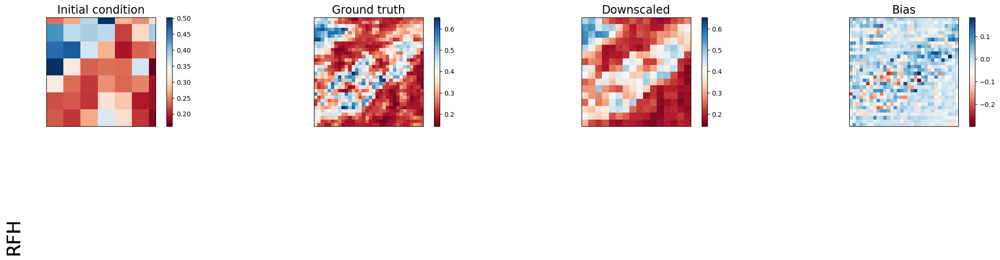

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+-----------------------+-----------------------+------------------------+-----------------------+
|                      | Coarse                | ClimaX                | Bilinear Interpolation | Weighted Mask         |
+----------------------+-----------------------+-----------------------+------------------------+-----------------------+
| lat_weighted_mse_val | 0.016654184088110924  | 0.0035134993959218264 | 0.021634086966514587   | 0.01302627008408308   |
| lat_weighted_rmse    | 0.016827944666147232  | 0.007729285396635532  | 0.019179562106728554   | 0.014882620424032211  |
| spearman             | 0.08252093400054848   | 0.8729450351429644    | -0.1277608935314341    | 0.5494919683327308    |
| mean_bias            | 0.0031901001930236816 | -0.00128096342086792  | -0.0007591843605041504 | -0.002588808536529541 |
| pear

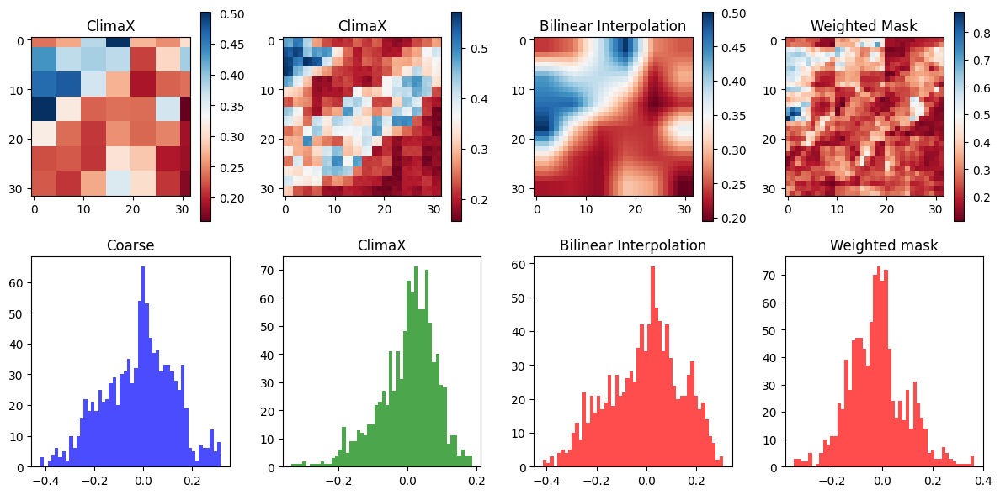

Time step 101
tensor(0.1318, device='cuda:0')


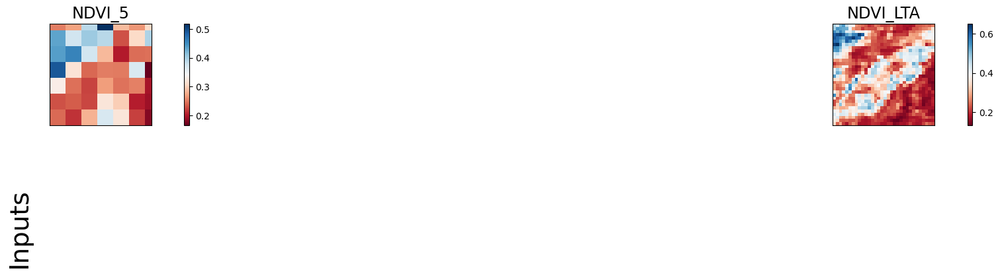

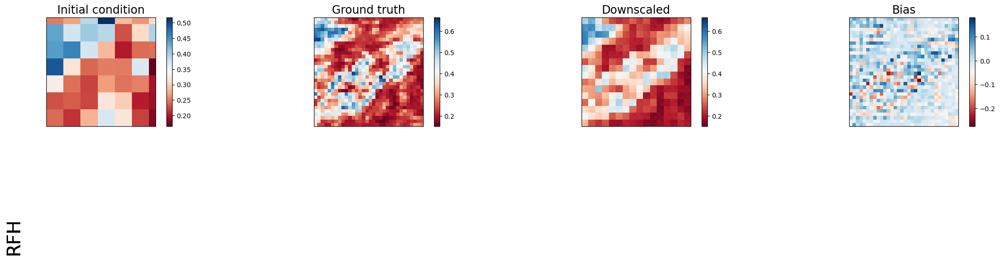

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+----------------------+------------------------+------------------------+-----------------------+
|                      | Coarse               | ClimaX                 | Bilinear Interpolation | Weighted Mask         |
+----------------------+----------------------+------------------------+------------------------+-----------------------+
| lat_weighted_mse_val | 0.016226688399910927 | 0.0032356816809624434  | 0.0203353650867939     | 0.011907542124390602  |
| lat_weighted_rmse    | 0.016610562801361084 | 0.007417408749461174   | 0.01859496533870697    | 0.01422919798642397   |
| spearman             | 0.07598258441530084  | 0.8690123607838548     | -0.13644712312428417   | 0.5529690076863869    |
| mean_bias            | 0.002106219530105591 | -0.0011702775955200195 | -0.0004737973213195801 | -0.002203017473220825 |
| pear

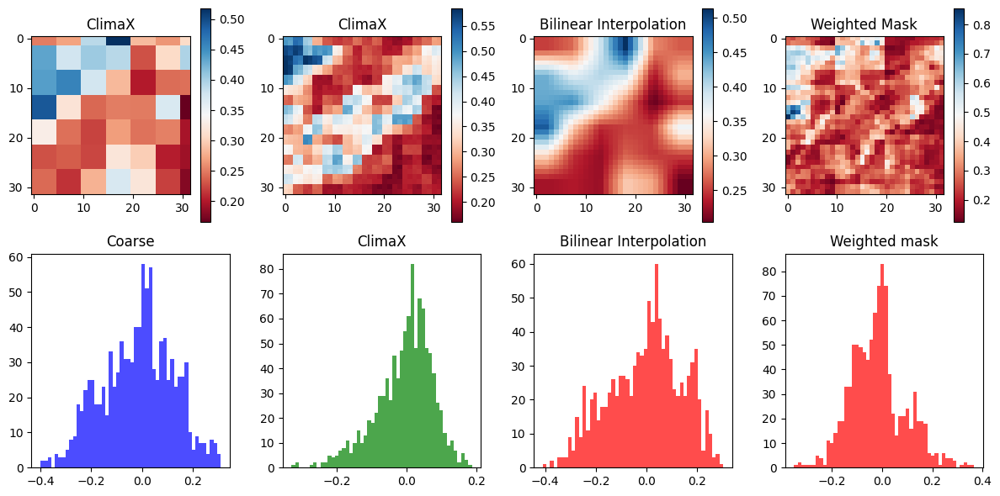

Time step 102
tensor(0.1370, device='cuda:0')


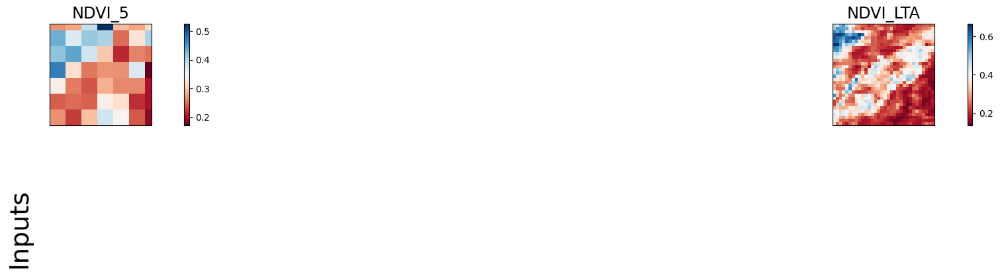

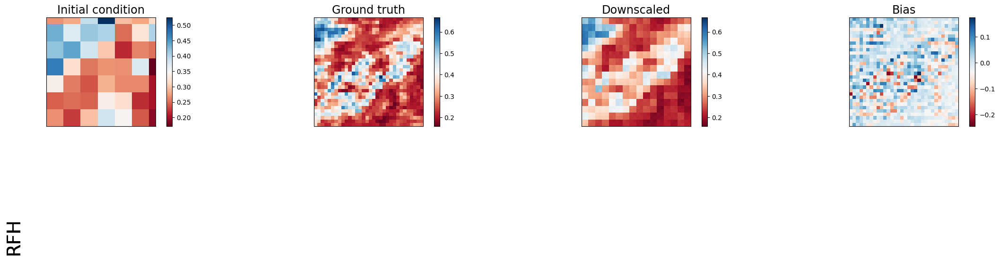

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+-----------------------+------------------------+------------------------+------------------------+
|                      | Coarse                | ClimaX                 | Bilinear Interpolation | Weighted Mask          |
+----------------------+-----------------------+------------------------+------------------------+------------------------+
| lat_weighted_mse_val | 0.015592465177178383  | 0.0030831648036837578  | 0.018137924373149872   | 0.010329870507121086   |
| lat_weighted_rmse    | 0.016282709315419197  | 0.0072404853999614716  | 0.01756156049668789    | 0.01325307972729206    |
| spearman             | 0.07712362887403786   | 0.8617169481938927     | -0.13439327426300468   | 0.5594818241768873     |
| mean_bias            | 0.0007138252258300781 | -0.0011943578720092773 | -0.0001315474510192871 | -0.00163698196411

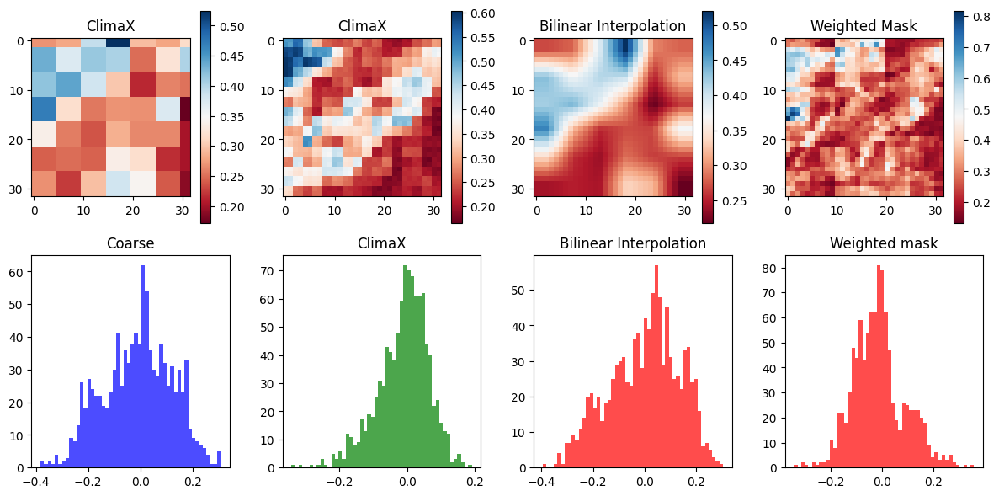

Time step 103
tensor(0.1435, device='cuda:0')


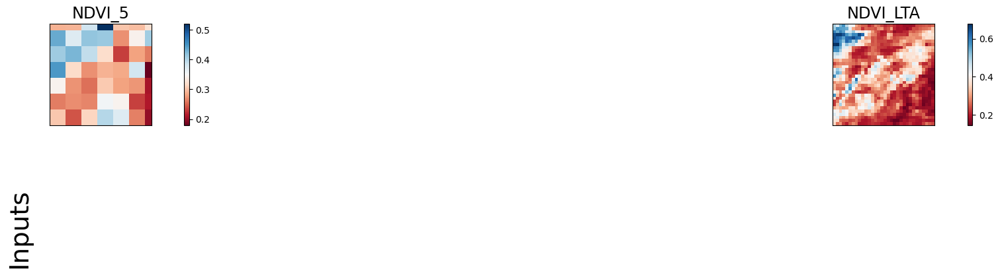

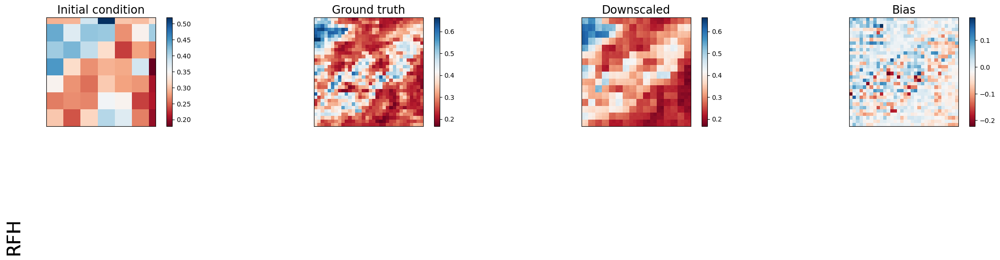

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+------------------------+-----------------------+------------------------+------------------------+
|                      | Coarse                 | ClimaX                | Bilinear Interpolation | Weighted Mask          |
+----------------------+------------------------+-----------------------+------------------------+------------------------+
| lat_weighted_mse_val | 0.014994396828114986   | 0.0029976884834468365 | 0.015447091311216354   | 0.008669160306453705   |
| lat_weighted_rmse    | 0.015967385843396187   | 0.007139414548873901  | 0.016206631436944008   | 0.012141096405684948   |
| spearman             | 0.08172200847462578    | 0.8491969568691755    | -0.12409714406065167   | 0.5633254478957879     |
| mean_bias            | -0.0009050369262695312 | -0.001425236463546753 | 0.00031512975692749023 | -0.00087469816207

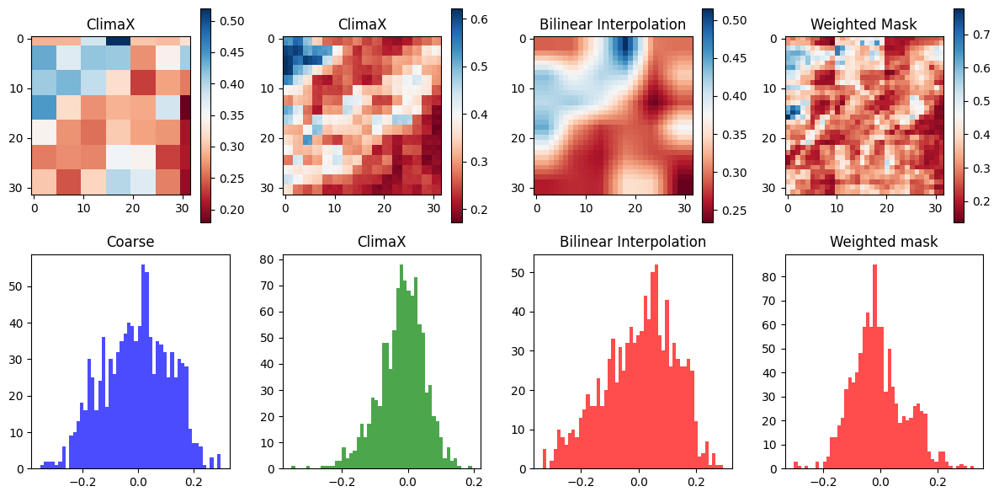

Time step 104
tensor(0.1490, device='cuda:0')


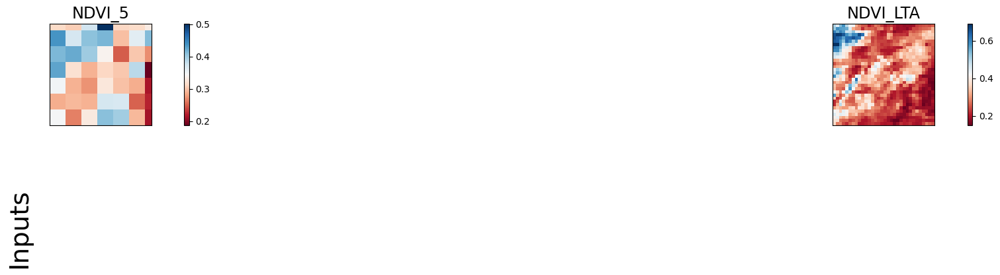

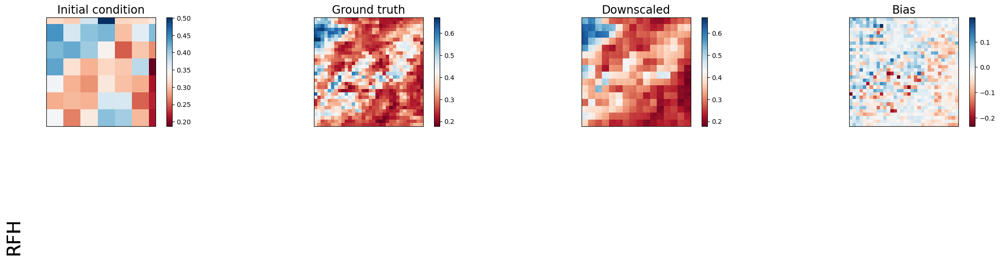

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+------------------------+------------------------+------------------------+------------------------+
|                      | Coarse                 | ClimaX                 | Bilinear Interpolation | Weighted Mask          |
+----------------------+------------------------+------------------------+------------------------+------------------------+
| lat_weighted_mse_val | 0.014717320911586285   | 0.002932615578174591   | 0.012890337035059929   | 0.0073529137298464775  |
| lat_weighted_rmse    | 0.01581917330622673    | 0.007061499636620283   | 0.014804764650762081   | 0.011181475594639778   |
| spearman             | 0.0983378901713458     | 0.8318527372947924     | -0.10283012267037259   | 0.5626641496929181     |
| mean_bias            | -0.0027330219745635986 | -0.0017836987972259521 | 0.0008796155452728271  | 4.67598438

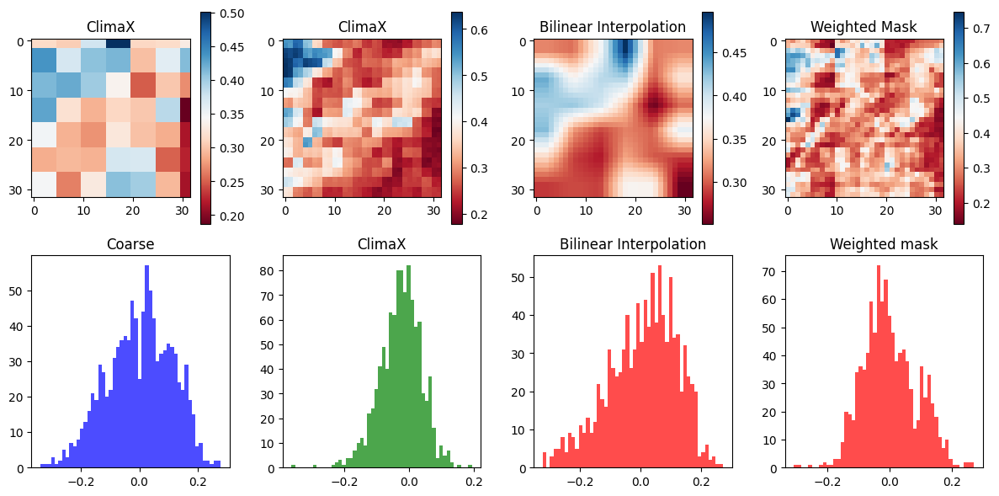

Time step 105
tensor(0.1521, device='cuda:0')


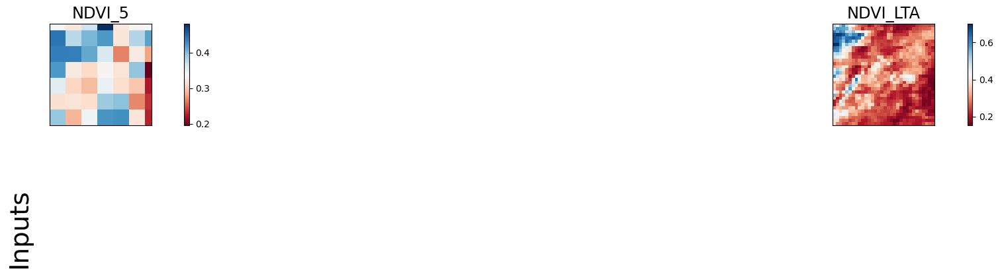

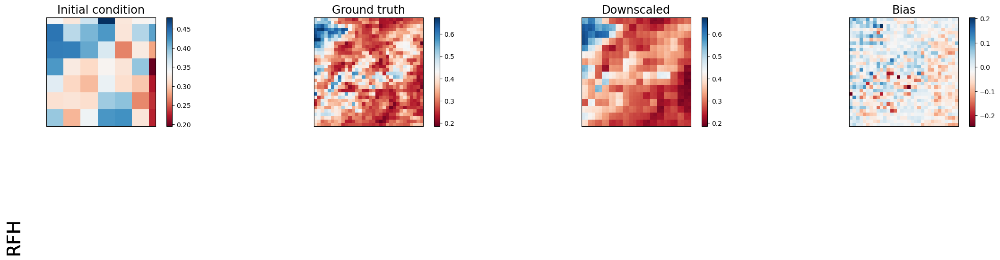

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+-----------------------+------------------------+------------------------+-----------------------+
|                      | Coarse                | ClimaX                 | Bilinear Interpolation | Weighted Mask         |
+----------------------+-----------------------+------------------------+------------------------+-----------------------+
| lat_weighted_mse_val | 0.015098566189408302  | 0.0029383108485490084  | 0.011159617453813553   | 0.006767602171748877  |
| lat_weighted_rmse    | 0.016022754833102226  | 0.007068353705108166   | 0.01377507857978344    | 0.010727209970355034  |
| spearman             | 0.1044958547631015    | 0.8118761145419345     | -0.07821703987751791   | 0.5649375941695693    |
| mean_bias            | -0.004765957593917847 | -0.0021722912788391113 | 0.0015716254711151123  | 0.0010391771793365479 |

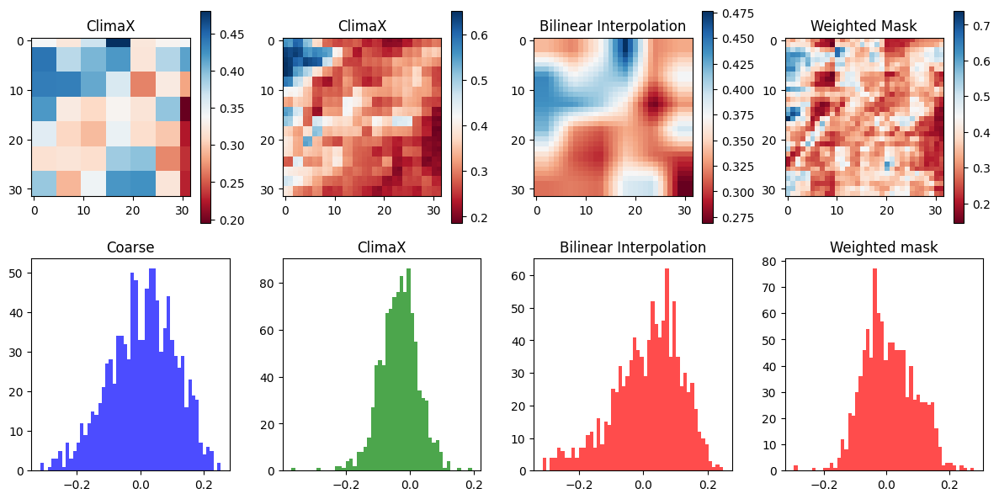

Time step 106
tensor(0.1373, device='cuda:0')


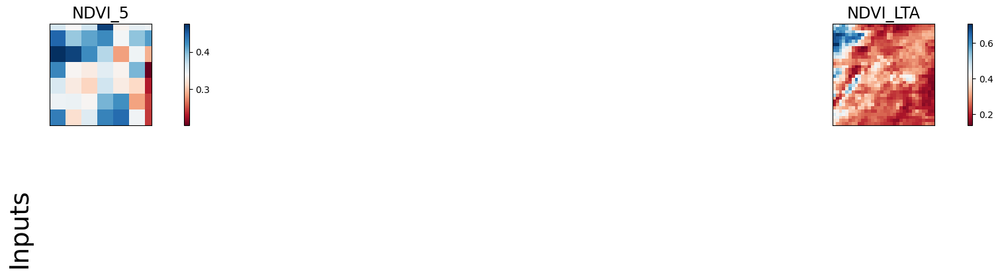

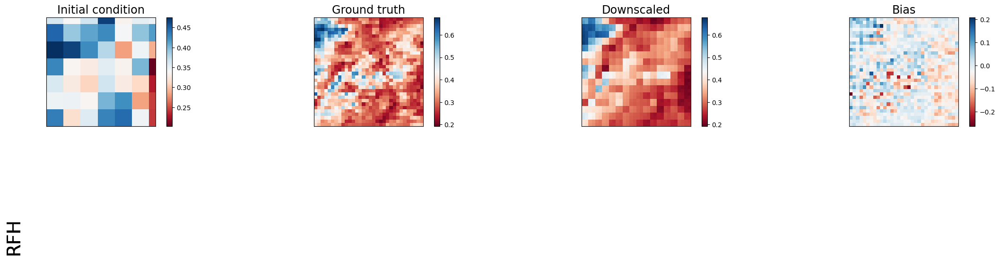

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+-----------------------+------------------------+------------------------+----------------------+
|                      | Coarse                | ClimaX                 | Bilinear Interpolation | Weighted Mask        |
+----------------------+-----------------------+------------------------+------------------------+----------------------+
| lat_weighted_mse_val | 0.016286808997392654  | 0.0030555441044270992  | 0.010440809652209282   | 0.006970851682126522 |
| lat_weighted_rmse    | 0.01664130389690399   | 0.0072079808451235294  | 0.013324055820703506   | 0.010887102223932743 |
| spearman             | 0.1471284444530218    | 0.7946255970066471     | -0.05037096402689984   | 0.5739658596567182   |
| mean_bias            | -0.006964594125747681 | -0.0024150311946868896 | 0.0024337470531463623  | 0.002058744430541992 |
| pear

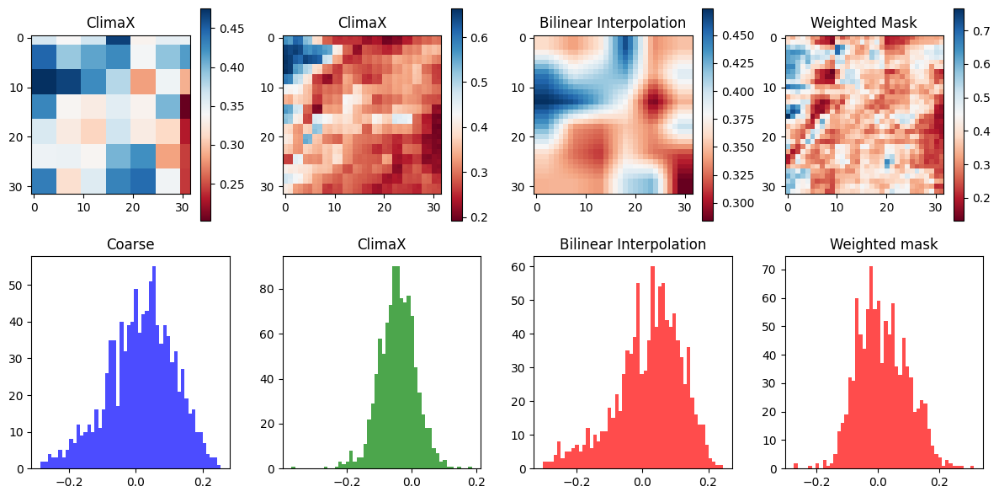

Time step 107
tensor(0.1023, device='cuda:0')


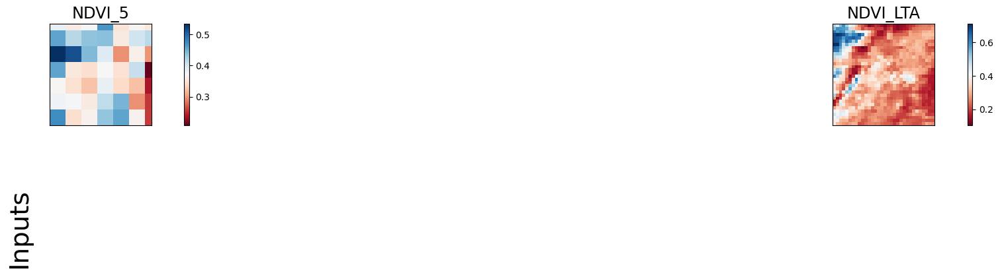

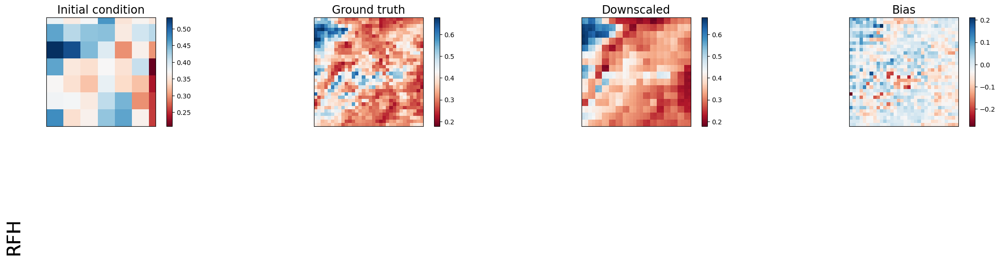

pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
pred.device cuda:0
y.device cuda:0
+----------------------+-----------------------+-----------------------+------------------------+-----------------------+
|                      | Coarse                | ClimaX                | Bilinear Interpolation | Weighted Mask         |
+----------------------+-----------------------+-----------------------+------------------------+-----------------------+
| lat_weighted_mse_val | 0.018427621573209763  | 0.0033358782529830933 | 0.010862861759960651   | 0.008253549225628376  |
| lat_weighted_rmse    | 0.017701253294944763  | 0.007531377952545881  | 0.01359068974852562    | 0.011846491135656834  |
| spearman             | 0.1811988137398       | 0.7841343307837834    | -0.029298224131817985  | 0.5899253705166577    |
| mean_bias            | -0.009310781955718994 | -0.002447843551635742 | 0.0034033358097076416  | 0.0030243098735809326 |
| pear

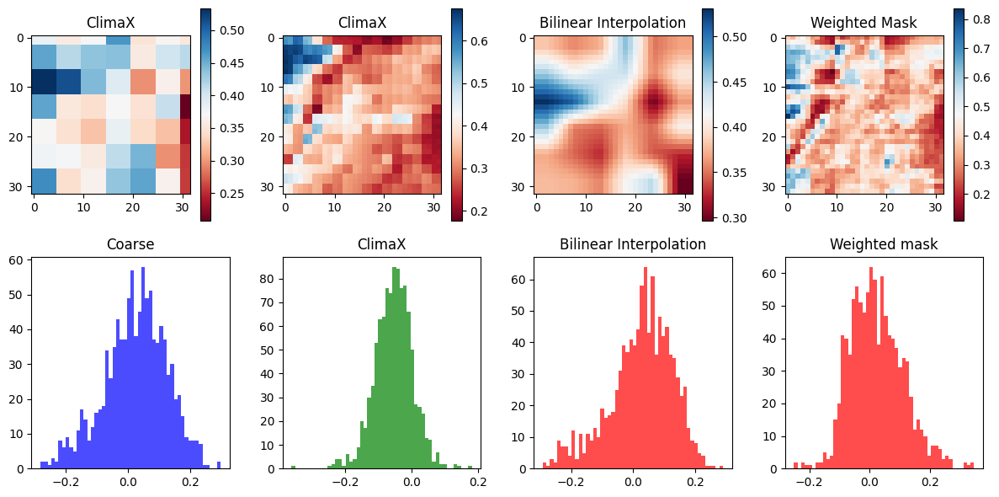

In [15]:
task = "10 days"
pred_range = TASK_TO_RANGE[task]

net_args = {
    'default_vars': [
        'ndvi_1', 'ndvi_5', 'ndvi_lta']
    ,"img_size" :  [32, 32],
      "patch_size" :   2,
      "embed_dim":   1024,
      "depth" : 8,
      "decoder_depth" :  2,
      "num_heads": 8,
    "mlp_ratio": 2,
    "drop_path": 0.1,
    "drop_rate": 0.1,
    
}
net = ClimaX(**net_args)
model = ClimateDownscalingModule(net=net, pretrained_path='ClimaX/exps/downscale/checkpoints/epoch_027-v1.ckpt')

datamodule = ClimateDownscalingDataModule(root_dir=f'Data/Downscaling/NDVI/Jordan/data_npz',
    variables=['ndvi_5', 'ndvi_lta'],
    out_variables=['ndvi_1'],
    buffer_size= 1000,
    batch_size= 128
)

normalization = datamodule.output_transforms
mean_norm, std_norm = normalization.mean, normalization.std
mean_denorm, std_denorm = -mean_norm / std_norm, 1 / std_norm
model.set_denormalization(mean_denorm, std_denorm)
model.set_lat_lon(*datamodule.get_lat_lon())

datamodule.setup()


gt,pred,tensors,var_name, pred_task,tensors_pred = visualize_downscale(model, datamodule,mean_norm, std_norm, pred_range, var_name = "RFH", var_id = 1,desired_batch_index=1)
forecast, rfh_lta = tensors[0], tensors[1]
timesteps=gt.shape[0]



for t in range(timesteps):
    print("Time step",t)
    print(rfh_lta[t].min())
    plot_inputs(tensors, var_name, pred_task,t)
    plot_pred(tensors_pred, var_name, pred_task,t)
    

    bilinear_inter = bilinear_interpolate(forecast[t].unsqueeze(dim=0))
    weighted_mask = Downscale_Weight(rfh_lta[t].cpu().numpy(),forecast[t].cpu().numpy(), verbose=False)
    
    compare_results(gt, forecast, pred , bilinear_inter, weighted_mask, model,t)
    plot_compare(gt, forecast, pred, bilinear_inter, weighted_mask,t)
    
    
    
    
    



    



In [23]:
gt,pred,tensors,var_name, pred_task,tensors_pred = visualize_downscale(model, datamodule,mean_norm, std_norm, pred_range, var_name = "RFH", var_id = 1,desired_batch_index=1)
forecast, rfh_lta = tensors[0], tensors[1]
timesteps=gt.shape[0]


In [ ]:
print(gt[0].shape, forecast[0].unsqueeze(0).shape)


In [ ]:
 for method in [lat_weighted_mse_val, lat_weighted_rmse, lat_weighted_acc, spearman,mean_bias, pearson]:
    print(method(gt[0],forecast[0].unsqueeze(0),model.denormalization, model.lat))